### (Bundesliga) game prediction

Simple model for the predictions of soccer games: How many goals a team scores.

As data only the results from prior games are used. 

#### Loading and processing of data 

In [3]:
%matplotlib inline
from IPython.core.pylabtools import figsize
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd

In [6]:
# some simple preprocessing of the data
clubs = pd.read_csv("bundesliga_Verein.csv", sep=';')
del(clubs["Unnamed: 3"])
# for convinience the club id should start with 0
clubs.V_ID = clubs.V_ID - 1
clubs = clubs.set_index("V_ID")
#clubs

In [7]:
top_club_ids = clubs[clubs.Liga==1].index
top_club_ids

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17], dtype='int64', name=u'V_ID')

In [8]:
games = pd.read_csv("bundesliga_Spiel.csv", sep=';')
del(games["Unnamed: 8"])
# for convinience the club id should start with 0
games.Heim = games.Heim-1
games.Gast = games.Gast-1

In [9]:
top_games = games[games.Heim.isin(top_club_ids)]

In [10]:
#top_games

In [11]:
# todo: automatically 
actual_date = "2015-12-30"
top_games = top_games[games.Datum < actual_date]
len(top_games)

/home/benni/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  app.launch_new_instance()


153

In [12]:
import pymc
import numpy as np

In [13]:
#c = [[i,j] for i in top_club_ids if i!=j for j in top_club_ids]

In [14]:
def get_toto_results():
    results_ = list()
    toto_result = list()
    for i in top_games.iterrows():
        r = i[1]
        gg = r.Tore_Heim
        ag = r.Tore_Gast
        re = (1 if gg>ag else 2 if gg<ag else 0)
        rr = (1 if gg>ag else -1 if gg<ag else 0)
        toto_result.append((r.Heim, r.Gast, re))
        results_.append((r.Heim, r.Gast, rr))
    return toto_result, results_
toto_results_, results_ = get_toto_results()

In [15]:
def get_goal_results(gh="Tore_Gast"):
    result = list()
    for i in top_games.iterrows():
        r = i[1]
        result.append((r.Heim, r.Gast, r[gh]))
    return result

away_goals_ = get_goal_results("Tore_Gast")
home_goals_ = get_goal_results("Tore_Heim")

In [16]:
#away_goals_

In [17]:

low = 0.0000000001

Idea: The number of goals a team scores can be modeled with a Poisson distribution.

#### Poisson distribution

Probability for outcome $k \in \{0, 1, 2, \dots\}$
 
$$
P_\lambda (k) = \frac{\lambda^k}{k!}\, \mathrm{e}^{-\lambda}
$$

with parameter $\lambda>0$
- $\lambda$ is also the expectation and variance of the distribution

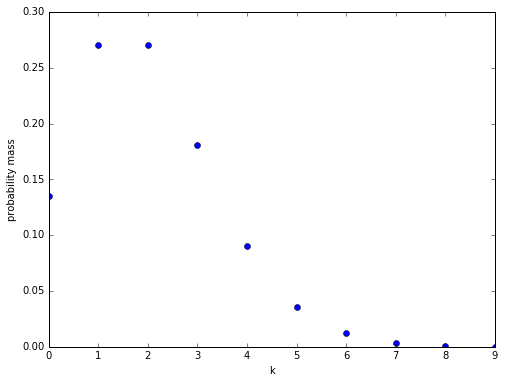

In [18]:
import scipy.stats
k=np.arange(0,10)
lambda_= 2

plt.figure(figsize=(8,6))
plt.plot(k, scipy.stats.poisson.pmf(k, lambda_), 'bo', ms=6, label='poisson pmf')
plt.xlabel("k")
plt.ylabel("probability mass")

#### Probabilistic Model

Each team $i$ has a offence and defence strength (distribution). (Note that the average goals per game $\approx 3 \Rightarrow \Delta \mu=1.5$):

$$
 offence_i \sim \mathcal N(\mu=1.5, \tau=1) 
$$
$$
 defence_i \sim \mathcal N(\mu=0, \tau=1) 
$$

$\mathcal N$ is the Gaussian distribution with parameters 
- mean: $\mu$
- precision: $\tau=1/\sigma^2$ (variance: $\sigma^2$)

Model: The number of goals that team $i$ scores against team $j$ is Poisson distributed with 

$$
 goals_{ij} = Poisson \left(\lambda = (offence_i-defence_j) \right)
$$


In [19]:
import daft
def plot_model():
    pgm = daft.PGM([6.3, 4.05], origin=[-1., -1.], aspect=1.)
    pgm.add_node(daft.Node("mu_o", r"$\mu_o$", .5, .5, fixed=True))
    pgm.add_node(daft.Node("tau_o", r"$\tau_o$", .5, 1.5, fixed=True))    
    pgm.add_node(daft.Node("o_i", r"o$_i$", 1.5, 1))
    
    pgm.add_node(daft.Node("tau_d", r"$\tau_d$", 2., 3., fixed=True))
    pgm.add_node(daft.Node("mu_d", r"$\mu_d$", 3., 3., fixed=True))
    pgm.add_node(daft.Node("d_j", r"d$_j$", 2.5, 2.2))
    
    #pgm.add_node(daft.Node("Delta", r"$\Delta_{ij}$", 2.5, 1))
    pgm.add_node(daft.Node("g", r"g$_{ij}$", 2.5, 1., observed=True))

    
    # Add in the edges.
    pgm.add_edge("mu_o", "o_i")
    pgm.add_edge("tau_o", "o_i")
    pgm.add_edge("mu_d", "d_j")
    pgm.add_edge("tau_d", "d_j")
    pgm.add_edge("o_i", "g")
    pgm.add_edge("d_j", "g")
    #pgm.add_edge("Delta", "g")
    # And plates.
    pgm.add_plate(daft.Plate([2., 0.2, 1., 2.5], label=r"$j$", shift=0.))
    pgm.add_plate(daft.Plate([1., 0.5, 2.2, 1.1], label=r"$i$", shift=0.))
    pgm.render()

ImportError: No module named daft

### Graphical representation of the model

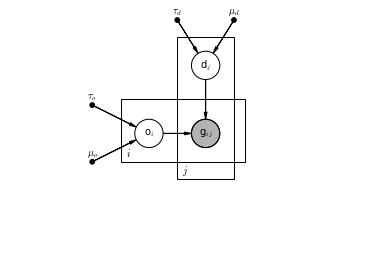

In [15]:
plot_model()

In [25]:
#top_club_ids
#home_goals_ # (home_team_id, away_team_id, goals_of_home_team)
#away_goals_ # (home_team_id, away_team_id, goals_of_away_team)

### Implementation with pymc

In [20]:
offence = [pymc.Normal("offence%i"%i, tau=1., mu=1.5) for i in top_club_ids]
defence = [pymc.Normal("defence%i"%i, tau=1., mu=0.) for i in top_club_ids]

 
home_goals = [pymc.Poisson("home_goals_%i_%i" % (heim,gast), 
                 observed=True, value=goals,
                 mu = pymc.Lambda("home_rate_%i_%i" % (heim, gast),
                 lambda o=offence[heim], d=defence[gast]: low if o-d<0. else o-d))  
              for i,(heim, gast, goals) in enumerate(home_goals_)]

away_goals = [pymc.Poisson("away_goals_%i_%i" % (heim,gast), 
                 observed=True, value=goals,
                 mu = pymc.Lambda("away_rate_%i_%i" % (heim, gast),
                 lambda o=offence[gast], d=defence[heim]: low if o-d<0. else o-d))  
              for i,(heim, gast, goals) in enumerate(away_goals_)]


In [21]:
#home_goals_

#### Sampling with pymc

In [22]:
mcmc = pymc.MCMC([offence, defence, home_goals, away_goals])
nb_samples=12000
burn=4000
mcmc.sample(nb_samples, burn=burn)#, thin=50)

 [-----------------100%-----------------] 12000 of 12000 complete in 83.7 sec

In [29]:
#plt.hist(mcmc.trace("noise_prior")[:])

In [23]:
id_2_club = dict()
for i in top_club_ids: 
    id_2_club[i] = clubs["Name"][i]

In [24]:
id_2_club[6]

'Borussia Dortmund'

In [25]:
#np.random.normal?

In [26]:
import scipy.stats
def print_sample_results(most_probable=True):
    for i in top_club_ids: 
        for j in top_club_ids:
            if i!=j:
                if most_probable:
                    k=0
                    h=nb_samples-burn
                else:
                    k = np.random.randint(low=0, high=nb_samples - burn)
                    h=k+1
                
                goals_home = np.random.poisson(diff)
                goals_away = np.random.poisson(d)
        
                print clubs[clubs.index==i]["Name"][i].decode('latin'), "-",
                print clubs[clubs.index==j]["Name"][j].decode('latin'), " : ",
                print scipy.stats.mode(goals_home).mode[0], "-",
                print scipy.stats.mode(goals_away).mode[0]

In [54]:
def get_diff1(h,k,i,j):
    diff = mcmc.trace("offence%i"%i)[k:h] - mcmc.trace("defence%i"%j)[k:h]
    d = mcmc.trace("offence%i"%j)[k:h] - mcmc.trace("defence%i"%i)[k:h]
    return diff, d                   
             
#TODO clean code    
def print_sample_results(most_probable=True, diff_func=get_diff1, print_hook=None):
    p=0
    pp=0
    nb_p=0
    for i in top_club_ids: 
        for j in top_club_ids:
            if i!=j:
                if most_probable:
                    k=0
                    h=nb_samples - burn
                else:
                    k = np.random.randint(low=0, high=nb_samples - burn)
                    h = k+1
                    
                diff, d = get_diff1(h,k,i,j)
                diff[diff<0.]=low
                d[d<0.]=low
                
                goals_home = np.random.poisson(diff)
                goals_away = np.random.poisson(d)
        
                print clubs[clubs.index==i]["Name"][i].decode('latin'), "-",
                print clubs[clubs.index==j]["Name"][j].decode('latin'), "/ prediction: ",
                
                h_goals = scipy.stats.mode(goals_home).mode[0]
                
                print h_goals, #" (%2.1f)"%(diff.mean()), 
                print "-",
                a_goals = scipy.stats.mode(goals_away).mode[0]
                print a_goals, #" (%2.1f)"%(d.mean()), d.mean()
                
                print "goals_home:"
                print goals_home
                count, bins, ignored = plt.hist(goals_home, 14, normed=True)
                plt.show()
                printscip stats.itemfreq(goals_home)
                
                game=top_games[((top_games['Heim']==i) & (top_games['Gast']==j))]
                predicted = (1 if h_goals>a_goals else 2 if h_goals<a_goals else 0)
                if not game.empty:
                    hg = game.Tore_Heim.values[0]
                    ag = game.Tore_Gast.values[0]
                    print " / result : ",hg, ":", ag,
                    result = (1 if hg>ag else 2 if hg<ag else 0)
                    nb_p +=1
                    if result == predicted:
                        p+=1  
                if print_hook:
                    pr = print_hook(k,h,i,j)
                    if result is not None and result == pr:
                        pp+=1
                print
                result=None
    return nb_p, p, pp

FC Bayern München - VfL Wolfsburg / prediction:  2 - 0 goals_home:
[2 5 1 ..., 5 4 2]


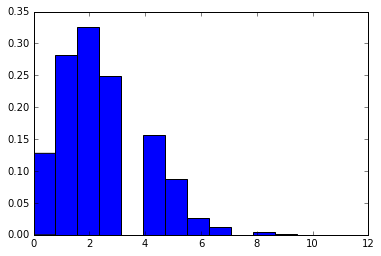

2
5
1
4
2
3
5
3
2
2
3
1
3
5
2
3
2
2
2
5
1
3
4
3
4
5
6
2
2
3
2
1
2
5
2
2
0
5
1
3
2
1
2
3
5
3
4
5
1
1
2
3
0
1
4
2
2
3
1
3
1
0
3
2
2
1
3
5
2
2
2
1
6
0
2
1
4
1
2
1
3
2
5
2
2
0
4
1
1
3
3
5
6
4
5
5
2
2
4
0
2
3
1
5
4
4
1
1
1
2
3
2
4
4
4
2
3
0
1
2
4
2
5
2
1
3
4
3
2
3
1
0
3
5
0
4
1
1
2
2
1
3
5
1
2
1
0
2
0
1
1
4
3
3
3
2
1
4
8
4
2
4
2
7
4
1
2
1
3
3
0
3
5
2
2
0
1
2
3
2
2
4
5
3
4
4
2
5
3
0
2
1
4
3
6
1
1
4
7
0
1
2
3
3
3
3
1
2
1
3
1
2
1
3
1
3
0
0
1
3
3
0
5
1
2
2
1
2
4
4
3
3
2
5
5
1
3
0
5
2
2
5
2
0
1
1
1
4
5
4
5
1
7
5
3
0
0
3
2
1
2
2
1
4
2
0
1
4
2
6
4
2
4
2
1
1
3
5
1
7
3
5
1
1
2
3
2
1
4
1
0
2
1
4
4
2
3
1
9
0
2
4
4
4
2
0
3
5
0
5
2
5
3
4
1
4
0
1
4
1
2
2
1
2
2
2
2
2
1
8
2
2
4
3
2
2
1
0
3
0
1
2
2
3
3
2
1
1
7
0
3
0
0
2
4
2
2
1
2
0
3
2
3
3
1
3
3
2
2
3
3
2
3
3
1
4
1
0
4
4
1
1
4
2
2
4
1
1
1
5
2
2
1
10
3
5
2
1
2
1
2
5
6
5
1
2
1
0
2
0
2
1
2
2
4
3
2
2
6
2
3
1
4
1
3
5
2
4
1
2
3
5
1
1
2
1
0
2
4
1
1
1
2
3
1
1
4
4
4
3
4
1
3
1
4
2
1
2
3
5
2
4
1
0
1
4
0
2
4
4
3
1
2
0
3
2
3
1
1
2
1
1
3
0
3
2
3
1
1
0
2
4
0
3
2
0
2
4
5
1

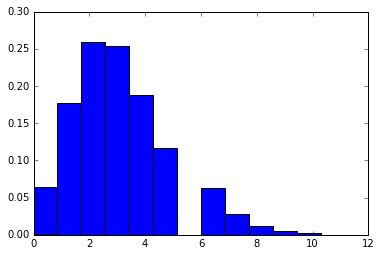

1
2
4
1
5
2
1
1
4
2
2
3
2
6
4
2
3
2
4
2
3
3
2
2
4
4
6
4
3
2
3
6
4
3
6
1
3
3
1
2
2
4
4
1
2
3
4
3
4
2
2
2
3
1
3
2
3
1
3
2
3
1
3
4
5
1
3
3
6
4
5
4
2
5
4
4
3
2
2
5
2
2
4
3
2
9
2
1
6
1
1
5
3
2
2
4
2
5
6
5
4
2
2
3
1
1
2
3
3
5
4
2
4
3
2
3
8
2
3
0
4
3
2
0
5
2
0
2
4
3
3
2
6
3
6
5
3
6
5
2
5
1
5
1
4
6
3
0
5
4
0
2
0
3
4
1
2
4
6
6
2
2
2
0
1
3
2
2
6
3
2
5
0
3
3
1
5
2
1
4
4
5
6
3
3
3
9
3
5
9
3
0
6
3
1
2
2
1
3
1
4
6
1
0
4
3
0
6
2
1
1
2
4
3
1
2
4
3
2
3
2
1
1
2
1
4
2
3
1
6
7
0
4
1
4
1
2
3
4
2
2
5
3
1
6
6
4
1
4
1
4
1
0
1
3
4
2
3
4
3
5
4
2
1
4
2
2
4
1
6
7
3
1
2
5
2
3
2
3
3
7
4
5
4
6
6
2
1
2
2
1
6
4
6
6
3
3
1
3
0
5
3
3
1
5
1
3
4
0
4
4
2
1
3
1
4
3
4
2
3
4
5
4
6
3
0
5
5
2
7
8
3
1
1
4
1
1
0
4
3
0
2
1
2
7
1
1
3
9
4
2
3
3
6
1
1
3
3
2
4
5
3
5
2
3
2
3
1
2
1
1
3
0
4
2
5
7
5
4
2
3
4
3
5
2
1
4
3
2
2
4
3
3
4
2
1
3
6
1
4
4
5
5
1
1
4
2
3
5
1
2
6
7
2
3
2
5
4
4
0
7
3
6
4
8
3
4
4
7
4
5
3
2
3
8
1
2
2
1
2
1
1
4
4
2
2
4
1
0
1
2
2
2
8
4
8
2
5
2
4
5
2
2
2
2
1
1
2
3
5
2
6
1
2
2
1
3
4
3
5
1
7
1
3
5
1
2
2
3
6
2
4
6
2
4
4
3
4
3
3


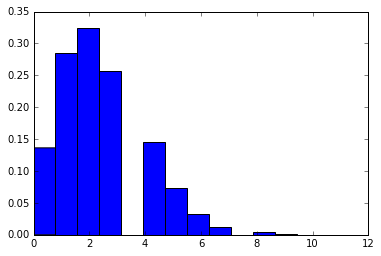

1
2
0
4
4
3
0
5
2
1
2
2
3
3
4
2
4
2
3
5
5
0
2
4
3
2
1
1
3
3
1
1
7
0
4
3
5
4
2
3
4
3
2
3
3
2
1
2
3
3
1
0
1
2
1
2
1
3
0
2
2
2
2
3
4
1
1
2
2
5
0
2
3
2
1
1
5
1
2
0
1
4
2
3
4
5
1
1
3
1
3
4
1
1
1
2
2
0
3
2
1
1
1
4
3
5
1
1
1
2
3
1
2
1
2
3
2
1
1
5
4
2
1
1
3
3
1
2
3
4
2
1
3
1
2
4
4
3
3
0
2
2
0
0
0
2
2
6
1
2
2
2
2
0
0
3
0
2
1
1
1
2
0
3
1
0
4
2
4
8
2
4
2
2
2
3
3
0
3
3
3
2
4
6
3
7
2
1
5
3
4
5
3
4
2
2
1
2
1
2
2
4
3
0
5
2
2
4
5
2
4
4
2
2
1
1
3
1
1
4
5
6
2
4
1
0
1
4
4
2
1
2
2
1
2
2
3
2
3
0
3
6
1
1
1
1
0
1
8
1
5
2
0
7
3
3
1
3
2
5
5
0
2
1
4
1
5
0
4
3
1
1
1
2
2
2
2
4
2
7
4
2
1
1
3
4
2
3
1
3
0
4
3
5
3
6
2
2
2
3
2
0
1
2
5
3
3
2
3
2
6
2
2
4
1
3
2
2
1
2
0
1
3
2
2
1
3
2
3
2
5
1
1
5
4
1
3
1
2
3
1
3
2
2
1
2
2
3
1
3
2
1
2
1
1
2
2
2
2
3
3
4
7
1
2
2
3
6
1
2
2
1
2
3
3
0
5
6
2
2
1
1
3
2
0
0
1
3
2
1
3
1
1
2
1
3
4
2
0
1
4
4
2
2
3
5
2
1
3
2
1
1
2
1
1
3
2
3
4
5
2
4
3
3
3
6
0
6
1
4
3
4
3
1
3
5
3
1
0
4
0
1
3
2
1
4
1
2
0
2
1
0
3
1
0
1
0
3
1
3
3
1
3
2
2
4
2
0
5
5
1
2
0
2
3
2
1
3
3
5
1
3
4
0
4
4
2
1
1
0
1
3
2
2
1
0
2
2
4
3


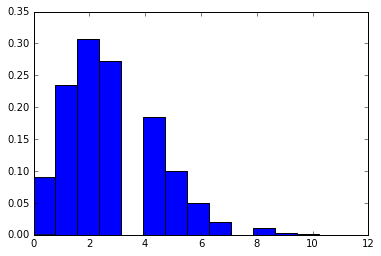

3
2
5
1
2
1
1
1
6
1
4
0
3
4
3
3
1
4
4
1
1
3
3
6
7
3
3
0
1
3
3
2
0
3
4
4
2
5
6
5
5
3
4
2
3
3
2
2
4
1
5
4
2
2
2
0
5
5
4
4
4
4
2
3
4
4
3
0
4
2
1
1
1
5
2
1
1
5
2
2
3
2
2
5
2
4
4
1
4
3
5
2
1
3
3
3
5
2
3
3
2
0
3
3
2
4
3
1
0
3
2
2
2
4
1
4
4
0
0
2
1
3
1
2
3
1
2
6
1
3
1
2
7
2
2
3
4
2
2
1
3
4
3
1
2
3
5
0
2
1
0
1
2
8
0
2
3
3
7
4
3
3
0
3
4
0
3
7
3
3
2
1
4
2
2
2
1
5
1
4
0
3
6
5
6
1
5
6
3
1
4
5
3
2
0
3
4
2
3
3
1
5
2
1
2
5
4
2
2
3
2
4
3
0
4
3
2
1
5
0
5
1
4
1
2
4
5
1
2
5
5
4
2
2
2
6
1
3
1
1
0
3
5
3
5
3
4
3
1
4
1
3
8
9
1
7
2
4
1
5
3
5
3
1
1
1
0
3
1
3
1
2
2
3
3
2
1
2
2
2
3
3
1
0
1
4
5
3
2
3
3
1
3
7
2
0
5
2
1
4
3
4
8
2
2
2
3
3
2
1
4
5
1
3
3
3
3
6
2
1
0
1
5
6
1
1
3
3
2
1
1
5
2
2
3
2
2
3
2
1
1
2
3
1
5
5
2
2
3
4
2
3
1
3
2
3
2
1
5
1
4
2
0
3
5
2
5
5
5
1
1
5
5
4
4
3
1
3
3
5
2
2
3
3
4
0
2
2
5
1
2
7
3
1
4
4
3
1
3
5
4
7
4
3
2
1
5
4
1
1
2
2
3
3
6
2
2
3
6
5
2
3
1
0
4
5
6
5
5
3
4
3
5
3
2
2
3
4
2
1
1
0
3
3
2
2
2
2
1
5
0
4
5
2
2
3
2
4
4
2
7
1
4
4
4
2
3
4
2
7
2
1
3
2
2
5
6
2
1
0
2
2
0
4
5
1
2
2
5
3
4
3
2
4
1
3
4
2
2
3


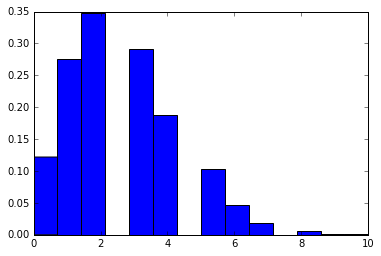

3
0
3
2
2
2
2
2
0
2
2
4
1
4
1
4
3
0
0
3
1
3
2
1
4
6
3
1
0
2
5
3
7
3
0
3
6
6
4
6
9
2
3
2
0
4
4
1
4
4
0
2
2
2
2
5
6
3
7
2
1
3
1
1
1
2
4
4
2
1
2
5
4
2
2
1
1
2
0
1
3
2
4
2
1
3
3
2
0
2
2
2
3
2
3
3
7
1
0
2
1
3
2
5
1
0
3
7
1
1
2
4
2
4
4
3
5
1
4
5
1
1
0
1
3
4
0
2
2
3
0
4
1
4
2
3
3
2
4
0
0
3
4
1
2
2
1
2
0
1
1
2
1
2
8
2
2
0
1
1
3
4
3
2
3
4
4
5
2
2
1
3
5
2
3
0
1
2
1
4
1
1
3
1
2
2
2
2
3
1
3
3
3
7
4
1
1
1
5
2
0
7
0
1
2
1
1
1
2
4
0
1
4
2
4
3
2
0
2
3
2
0
3
3
2
2
5
2
2
4
2
4
1
1
1
1
2
1
1
3
3
6
0
3
4
2
3
3
5
4
4
4
1
0
2
3
1
3
0
4
2
0
3
4
0
5
3
5
2
2
3
5
3
2
2
5
1
1
4
2
7
1
1
7
0
4
3
2
1
2
4
1
3
5
3
3
3
3
3
2
2
6
4
2
4
4
4
3
4
2
3
4
1
3
1
3
3
4
2
4
2
4
5
0
3
3
4
6
7
3
2
3
3
1
1
2
2
4
0
1
1
1
2
4
2
7
3
2
2
2
2
0
1
1
3
0
2
4
1
2
1
2
5
5
6
0
4
1
3
2
4
3
2
1
1
2
4
3
1
1
3
2
0
2
2
3
4
2
0
1
2
1
2
2
3
0
1
3
1
3
2
4
1
0
2
4
3
2
5
5
4
2
4
2
2
2
3
4
1
5
5
2
1
0
0
5
1
3
7
5
4
6
2
2
2
3
2
2
1
1
1
2
2
4
1
3
1
1
0
1
4
0
4
3
2
0
5
2
6
0
4
1
6
3
2
3
2
6
1
1
4
4
5
2
2
1
2
4
2
2
2
1
5
2
3
0
5
2
3
3
2
3
0
0
1
2
5
1
4
1


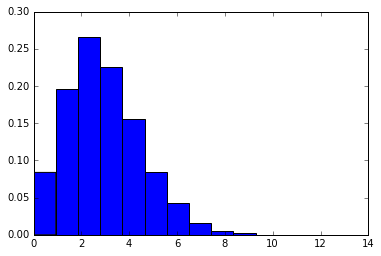

2
5
0
2
2
6
5
5
3
1
2
1
3
3
1
1
3
2
2
2
0
4
3
3
2
1
2
2
1
3
3
2
3
3
4
1
2
2
1
2
1
2
2
1
2
4
3
3
4
6
4
3
1
4
1
2
1
4
2
3
2
3
0
4
3
3
4
3
7
3
4
2
5
2
6
1
5
3
2
2
1
2
3
2
5
2
6
2
3
1
4
2
6
3
3
0
4
3
4
0
2
0
1
1
2
0
1
1
1
0
3
2
1
1
1
4
3
2
0
2
3
3
6
3
3
1
2
2
1
2
7
3
3
3
3
6
4
0
2
2
2
0
4
4
1
3
2
2
4
3
3
1
0
3
3
0
0
5
1
4
3
1
4
3
5
1
7
1
4
3
4
4
2
1
4
3
3
0
2
5
2
2
3
4
4
1
2
2
4
3
5
0
5
3
3
2
5
4
6
6
1
2
0
0
0
1
0
1
3
3
3
1
1
2
2
1
1
1
1
6
6
6
3
4
3
4
3
3
4
2
6
2
3
2
3
3
3
4
4
3
0
0
3
1
2
1
2
5
7
1
2
6
3
6
3
2
3
3
2
5
7
2
2
2
2
1
2
2
0
0
5
3
2
1
3
6
1
4
2
1
5
7
2
4
5
1
3
4
0
0
2
2
4
4
2
0
1
4
3
2
4
2
1
5
5
7
4
2
3
5
1
3
6
2
3
5
3
1
0
3
1
3
1
6
0
5
4
3
4
4
4
4
2
3
4
2
0
2
8
2
2
2
4
3
4
1
0
3
0
3
3
4
2
1
5
4
4
2
1
1
3
3
3
3
2
1
6
4
4
2
5
6
3
0
5
2
2
1
6
3
3
2
3
5
6
4
1
2
7
5
3
5
4
4
2
1
1
6
1
3
1
3
2
0
2
4
4
7
4
1
2
2
2
0
4
4
3
3
5
3
4
3
3
0
1
1
4
3
3
5
3
4
0
5
6
4
6
2
2
2
4
3
3
4
2
1
0
4
6
0
2
2
1
2
1
4
2
3
2
5
0
4
4
2
3
4
5
2
2
2
1
2
2
3
2
3
1
3
2
4
4
3
1
2
2
6
2
3
2
4
2
2
2
1
3
3
1
2
4
4


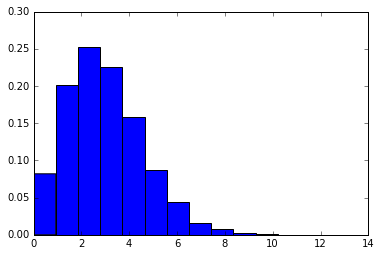

0
3
3
3
2
4
2
6
0
3
1
1
4
4
7
1
2
5
2
2
5
1
2
3
2
1
3
1
6
3
1
2
6
5
4
2
0
5
4
1
5
3
0
0
2
1
5
4
4
2
3
2
5
2
3
2
3
5
2
3
2
3
1
2
3
1
6
0
2
5
4
0
5
5
2
5
2
1
2
6
6
3
2
4
7
2
2
2
2
4
3
4
0
0
3
3
4
4
1
1
1
2
1
1
1
4
1
1
2
5
3
2
1
0
0
2
3
2
0
2
1
8
0
1
2
5
2
0
1
1
4
9
4
6
5
1
0
0
0
2
5
2
0
1
4
5
2
1
0
2
0
2
0
0
0
3
1
3
3
1
4
2
2
1
1
2
2
6
4
4
1
1
3
3
3
3
1
0
2
4
3
4
2
3
4
0
4
2
2
5
4
4
0
4
1
2
1
4
2
2
4
0
3
4
1
1
3
2
3
4
4
1
2
0
5
5
2
3
1
1
2
6
4
5
4
1
3
4
4
0
3
2
1
4
4
2
3
3
4
2
1
3
3
2
1
3
4
5
1
0
6
0
4
3
2
3
0
2
2
1
6
3
4
4
3
6
5
3
1
2
4
1
4
1
3
4
6
7
1
7
0
1
4
4
4
5
3
0
2
4
2
8
4
6
2
0
4
1
3
1
3
4
3
4
7
3
1
3
3
1
2
3
7
3
2
3
2
4
3
0
1
7
2
6
1
1
2
5
3
3
3
0
2
3
1
2
3
1
2
3
2
1
1
5
4
2
2
1
4
2
3
0
8
0
3
6
5
4
3
1
3
3
4
3
3
2
5
3
4
1
4
3
6
1
2
1
6
5
0
5
3
4
1
4
0
1
5
1
2
8
4
1
1
2
4
3
0
5
0
1
2
0
1
1
5
1
2
3
1
3
0
0
5
2
5
3
2
0
5
4
1
2
5
3
2
5
0
2
4
8
4
2
1
4
2
3
5
6
0
0
1
5
1
2
2
10
3
2
3
8
4
1
3
2
0
3
3
0
3
6
6
1
1
3
1
2
1
1
2
0
1
3
4
1
2
3
3
4
1
2
2
1
4
1
1
3
1
4
3
4
1
3
3
3
1
4
5
2
2
1

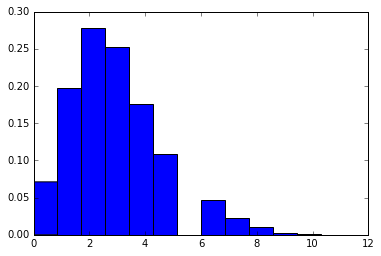

3
3
4
3
2
4
0
1
4
2
4
1
1
0
6
2
2
6
5
2
3
4
6
2
2
1
2
3
4
2
2
5
2
7
4
3
9
2
3
4
2
2
3
2
2
2
3
2
2
2
2
4
3
3
5
5
5
1
2
3
1
3
2
1
7
5
5
4
2
2
1
2
2
5
2
1
2
2
4
1
3
2
1
1
2
3
3
0
6
5
1
2
2
1
0
5
2
4
1
4
0
3
1
3
4
4
3
3
2
4
3
7
4
0
1
4
3
6
3
3
3
1
2
2
4
1
2
1
3
1
2
4
2
0
1
3
3
4
1
4
3
3
1
7
4
5
1
1
0
4
3
3
2
2
1
2
5
3
4
5
2
3
3
1
1
4
1
1
6
3
1
3
4
4
3
3
2
0
1
2
5
0
3
1
2
3
4
1
4
3
2
3
3
3
1
5
1
7
2
4
3
3
4
6
0
2
3
1
2
4
3
2
2
2
1
0
4
0
2
3
4
2
2
3
3
3
5
2
4
4
0
0
3
2
4
2
2
4
3
1
1
2
1
2
4
3
0
1
3
0
5
4
1
6
8
2
4
6
2
3
7
3
2
0
2
2
1
2
1
6
3
0
3
1
3
4
1
2
4
5
4
4
3
2
2
3
4
0
4
2
1
2
1
0
4
5
2
4
1
3
6
7
4
4
3
4
1
3
1
4
2
1
2
4
2
5
5
3
5
6
2
2
3
4
2
6
4
3
4
6
4
1
0
4
1
1
2
4
1
6
4
4
1
1
2
2
4
3
1
1
0
1
1
0
2
2
2
2
3
3
1
5
3
1
2
4
4
3
4
4
2
2
1
2
2
1
3
5
2
1
3
4
6
5
2
3
2
4
2
2
5
1
3
3
3
1
0
3
4
3
4
3
2
3
5
2
8
0
1
2
0
1
3
1
0
1
4
9
0
1
2
3
1
3
3
2
1
2
5
3
6
2
4
8
4
1
4
4
3
1
0
1
3
4
3
5
4
2
3
1
1
3
2
2
3
0
4
1
3
0
4
4
5
1
2
6
3
5
2
4
4
1
3
1
1
6
4
1
5
3
5
2
2
4
1
1
1
1
0
1
3
2
1
2
1
3
0
4
3
1


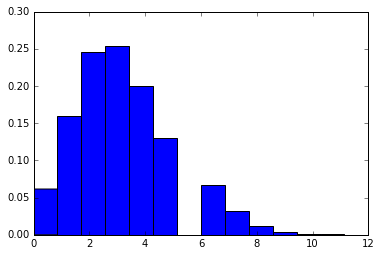

2
2
3
1
3
2
1
1
3
2
2
9
0
4
2
4
6
2
2
4
2
2
0
2
3
2
1
1
1
3
3
2
4
2
4
4
6
2
2
2
8
1
6
7
4
1
3
4
4
2
6
3
2
1
1
2
7
2
2
4
6
5
3
1
5
2
1
2
2
3
4
4
4
1
4
3
3
3
2
3
0
5
2
5
1
2
2
1
4
2
1
4
3
3
1
1
6
2
3
4
2
5
3
5
2
4
1
0
0
2
2
5
2
7
1
1
2
2
2
5
5
2
0
4
4
3
3
4
3
3
4
0
3
3
4
7
3
3
5
2
4
6
2
6
6
2
1
5
6
2
0
4
2
4
4
4
3
2
4
5
3
1
2
4
0
2
1
2
4
1
3
7
1
1
0
2
2
2
2
3
2
5
5
9
2
2
5
2
3
0
4
3
5
5
2
1
0
2
2
4
2
7
6
4
5
3
3
2
2
3
3
2
2
3
2
3
2
1
5
8
4
5
2
2
3
1
4
2
1
4
3
3
4
4
1
4
2
3
2
1
3
4
3
8
0
4
1
1
6
5
1
2
4
7
1
4
6
6
4
1
3
4
4
3
1
6
3
1
2
6
5
0
2
3
2
2
3
3
5
2
4
0
2
4
2
1
2
4
5
3
3
5
5
4
1
4
6
3
2
1
3
5
5
4
4
4
2
3
6
2
5
3
1
3
5
5
3
3
3
3
4
3
1
7
5
4
3
5
3
5
2
1
0
2
7
1
0
1
6
3
3
0
2
3
3
8
3
5
2
5
2
4
4
1
4
3
1
6
2
4
3
4
4
1
2
5
1
3
3
3
3
4
3
1
2
5
5
3
3
4
7
5
1
3
3
2
3
1
2
4
4
6
3
2
6
5
3
5
4
3
1
3
1
1
1
3
2
4
5
2
2
2
3
1
2
1
1
7
1
6
3
1
0
3
5
6
5
5
1
5
3
4
1
4
6
0
6
3
3
3
2
5
5
4
2
4
3
2
3
4
3
2
4
4
1
1
3
1
2
2
1
1
1
2
5
3
4
7
2
3
7
3
1
2
5
4
5
4
4
4
0
1
2
1
4
4
2
4
4
2
4
2
4
3
1
0
2
4
2
0


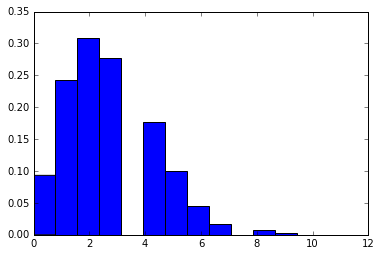

1
5
4
4
5
4
0
5
3
6
1
2
3
4
0
4
3
1
1
1
2
4
2
6
3
5
2
0
1
1
1
3
4
2
4
3
3
2
2
3
2
3
1
1
0
5
5
1
3
3
2
4
3
3
0
6
8
5
3
2
1
4
5
2
3
1
4
1
2
2
4
4
4
3
6
1
4
2
6
3
4
3
4
2
2
4
4
4
1
4
1
1
2
1
2
6
3
3
3
4
0
3
1
0
4
3
3
3
3
3
3
3
1
1
3
5
1
2
1
2
4
5
3
1
2
2
2
2
5
3
3
4
1
1
2
3
1
1
2
3
2
2
0
2
3
3
3
0
2
0
2
0
1
3
3
3
4
5
3
4
0
1
0
0
2
6
4
4
3
3
3
2
3
4
0
3
2
2
3
4
1
5
7
1
2
1
2
2
4
2
1
2
0
6
5
1
2
2
0
2
8
3
2
2
1
0
1
1
2
3
2
2
3
2
3
3
4
2
5
4
2
4
3
7
1
2
2
1
3
3
2
2
1
2
7
3
3
1
6
1
1
5
2
5
2
1
1
4
3
3
4
3
3
5
3
4
3
2
1
2
1
5
2
1
2
2
5
1
3
0
2
6
1
1
4
4
1
2
1
1
3
3
1
1
7
3
3
2
3
1
3
3
3
4
4
3
4
2
4
0
2
5
5
5
1
6
6
1
2
4
5
4
4
3
3
3
3
1
1
1
6
1
3
5
5
6
3
2
2
4
3
2
3
2
1
3
2
3
2
5
2
3
2
5
2
4
3
1
4
6
2
2
1
5
4
2
2
3
1
1
1
1
5
1
2
2
0
2
1
2
3
2
5
3
3
3
1
2
1
5
5
4
3
1
3
3
1
1
2
2
3
3
5
2
2
1
2
0
1
4
1
2
4
8
4
5
2
2
0
4
3
5
4
6
3
3
1
2
3
1
1
0
4
2
2
3
4
6
2
2
4
5
3
3
4
2
2
2
1
2
3
1
2
2
0
0
1
1
4
1
1
2
1
3
1
1
1
2
5
1
3
2
1
3
4
2
4
4
4
0
1
7
2
3
3
3
5
7
0
4
4
3
4
2
3
2
4
3
3
0
2
3
1
3
4
5
0
4
4
7


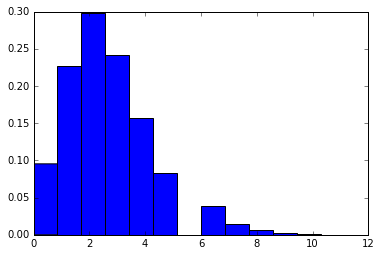

5
2
4
2
4
2
2
2
1
3
4
2
3
2
2
1
1
4
3
1
0
1
4
6
4
5
3
0
2
1
3
3
2
2
3
1
4
5
1
3
1
5
3
0
3
3
1
1
1
3
1
6
3
1
0
0
3
4
1
5
2
3
1
5
0
6
3
0
8
0
3
4
6
5
3
5
3
1
5
1
6
1
0
2
6
4
5
5
2
1
2
1
0
2
2
1
5
3
1
5
2
1
3
4
2
3
4
3
2
0
4
3
5
3
2
3
4
1
1
2
3
1
5
3
1
2
2
1
1
2
3
4
2
2
4
1
1
3
2
0
2
1
2
1
0
1
0
0
0
2
2
4
3
2
2
1
1
1
2
5
3
1
2
3
4
6
3
1
3
3
3
2
4
0
2
2
0
5
1
4
2
2
5
2
4
3
3
4
5
5
2
4
3
3
2
4
3
0
0
2
2
2
2
3
2
1
1
4
2
2
2
3
1
1
2
1
0
1
3
1
8
1
5
4
5
2
3
1
6
3
3
1
1
2
1
4
2
3
3
4
3
1
4
6
0
4
1
4
4
6
6
2
0
3
0
2
4
3
4
3
1
0
2
1
0
2
1
1
5
1
5
5
5
2
8
2
3
3
2
1
6
2
2
3
4
1
1
3
4
2
2
1
2
2
2
0
6
4
2
2
0
3
4
4
5
4
1
2
1
4
8
2
5
3
2
1
2
6
4
1
1
4
3
2
4
1
4
6
1
6
2
3
3
2
2
1
2
3
2
4
1
1
4
2
0
6
5
0
0
3
2
1
2
4
3
4
4
6
1
3
3
3
0
0
2
4
1
5
4
0
0
2
1
3
4
4
5
3
3
1
1
2
5
2
2
0
2
1
2
4
1
3
4
3
0
3
3
2
2
1
3
2
1
1
4
0
3
4
4
3
2
2
2
2
7
6
5
4
2
2
6
4
3
2
1
0
6
3
2
4
2
4
5
6
2
3
1
4
2
2
1
4
2
2
4
2
5
4
1
2
1
4
1
2
3
0
4
1
3
2
0
0
0
4
1
2
4
5
5
3
2
5
3
1
3
3
3
4
2
3
1
2
2
2
2
2
1
3
4
1
2
2
1
5
0
6
2
3
3
2


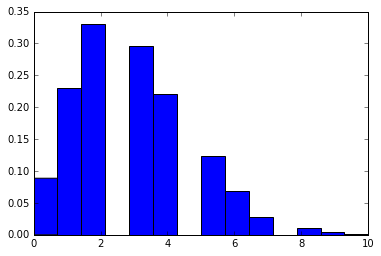

2
2
1
2
1
3
7
3
1
3
2
3
2
2
2
1
2
1
3
2
2
4
2
2
3
5
7
3
2
2
4
3
5
3
0
6
4
0
2
4
2
1
3
2
5
3
3
2
3
1
3
3
1
8
4
2
1
3
2
4
2
2
0
5
5
1
1
2
2
3
3
1
0
4
9
3
2
3
3
2
6
4
2
2
8
6
2
3
2
3
4
4
6
3
1
1
4
5
4
4
1
1
2
0
4
7
1
2
3
4
3
2
6
2
5
3
4
2
1
2
6
5
1
4
2
6
2
2
3
4
2
4
4
5
2
2
0
1
0
2
2
5
3
10
2
2
0
5
0
2
3
4
3
4
3
3
2
1
4
6
2
3
2
2
3
3
1
0
5
6
4
4
4
2
3
2
2
4
2
4
4
3
5
1
3
5
5
4
2
4
3
6
4
2
6
1
3
3
2
5
1
5
2
9
2
3
3
3
2
0
3
2
4
0
0
2
3
3
3
1
1
3
4
3
1
2
2
0
8
7
2
3
3
1
4
2
3
7
2
3
3
1
5
2
5
0
1
1
2
6
3
3
3
3
3
1
2
2
3
1
3
6
6
5
3
3
2
0
1
2
0
0
2
1
2
2
3
6
4
6
2
2
4
6
5
3
2
5
5
1
2
2
0
2
4
0
5
8
2
4
2
5
9
7
3
2
3
1
1
0
4
4
3
8
2
1
5
3
0
2
3
5
2
5
6
5
5
4
2
10
4
1
3
2
3
2
2
4
4
1
4
0
1
0
3
3
1
2
2
2
2
5
3
2
2
3
2
6
0
3
4
3
4
3
1
3
3
2
3
4
6
3
2
0
5
4
0
2
2
2
2
2
4
4
3
2
2
2
2
2
8
1
3
3
4
3
3
6
2
3
2
2
4
0
4
6
5
4
4
0
1
2
3
4
3
5
2
3
0
6
1
5
4
3
1
8
4
8
3
3
2
3
4
4
3
4
1
3
2
6
1
2
4
2
6
4
4
7
5
4
4
1
0
3
3
1
2
4
3
4
4
1
3
3
3
2
3
3
3
3
2
1
1
3
2
3
2
1
1
2
2
3
8
3
6
1
2
2
2
3
3
4
2
1
8
2
1
3
4


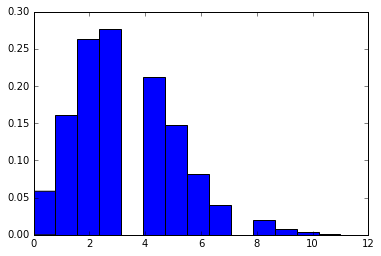

4
1
6
2
4
0
1
0
2
2
3
1
6
1
3
0
3
2
1
1
1
4
3
3
5
3
3
1
7
2
3
3
5
4
1
7
1
1
6
3
4
6
4
3
2
0
2
3
4
2
4
5
3
1
3
2
3
3
4
3
3
3
2
2
1
2
3
3
4
5
3
1
1
1
3
3
4
8
2
4
5
2
4
0
3
2
4
2
2
5
4
5
4
1
8
1
6
5
3
3
4
6
1
3
1
4
3
3
3
1
3
1
1
6
3
1
5
0
4
4
0
1
3
1
6
3
4
4
4
2
6
4
4
1
1
4
4
2
3
2
3
4
2
1
3
5
1
5
2
4
5
6
3
5
0
3
4
4
4
6
6
5
2
2
5
0
0
4
1
1
7
4
4
0
5
1
2
2
4
3
3
2
3
3
0
3
2
2
3
0
3
5
4
5
5
2
2
3
5
2
1
2
6
1
2
2
2
2
2
0
5
3
4
0
3
4
1
2
1
3
2
3
2
2
0
4
5
5
4
5
5
3
2
3
3
0
6
5
5
2
6
3
2
6
1
5
2
2
6
9
5
3
4
2
3
5
2
3
1
3
3
2
6
2
3
1
6
6
2
6
3
3
2
3
3
1
2
4
3
8
4
7
5
2
0
6
5
2
4
1
1
3
4
5
4
2
4
5
4
9
3
4
4
4
9
5
2
1
4
0
4
3
3
1
3
6
2
6
2
2
0
2
5
2
3
2
3
1
2
3
4
5
5
6
2
3
2
6
2
3
2
7
4
4
11
1
1
2
8
2
3
4
1
0
2
1
2
4
4
1
3
4
3
6
2
3
1
3
3
4
1
5
4
3
4
3
4
5
4
3
5
1
2
6
3
4
4
2
7
4
2
3
2
2
0
2
2
2
7
1
2
3
5
5
1
2
1
4
5
3
2
2
4
1
5
8
2
3
3
1
5
2
4
0
3
5
6
7
4
3
2
6
2
5
3
2
2
1
4
1
4
3
4
4
5
1
3
4
2
1
6
0
4
3
1
5
3
6
2
2
4
2
3
3
6
5
3
6
4
3
5
4
3
1
2
4
4
5
1
4
4
5
7
1
5
1
3
3
6
4
5
3
6
2
5
3
5
4
5
4

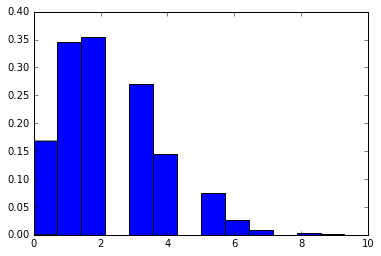

1
1
4
2
2
1
2
1
2
7
1
1
0
0
3
2
2
1
5
0
3
4
1
4
5
6
5
1
0
3
4
3
1
4
5
4
3
1
5
5
1
0
3
6
1
4
5
0
7
1
3
1
4
3
2
3
1
4
1
4
3
4
2
2
2
1
2
3
1
3
4
6
3
2
2
2
0
2
1
5
2
4
3
3
2
0
3
2
2
6
5
1
2
0
1
2
2
5
2
4
1
2
0
3
1
4
1
3
1
5
0
1
3
5
4
0
1
2
1
1
1
4
2
3
0
2
2
1
0
4
1
1
0
1
1
2
2
4
1
0
2
2
1
2
1
2
3
1
0
2
1
1
2
3
4
2
4
2
5
3
1
1
3
3
4
1
0
1
2
5
2
1
2
1
3
1
0
2
0
1
6
1
3
1
1
2
5
2
4
2
3
2
5
2
1
1
5
1
2
3
2
2
2
2
3
0
3
1
4
5
0
5
1
1
1
0
1
4
1
2
1
1
2
1
1
0
4
4
3
3
2
5
3
2
4
3
4
5
1
5
2
1
5
0
1
0
2
0
5
5
0
3
2
2
3
2
2
7
3
2
5
1
3
2
1
0
1
0
3
2
2
4
7
3
4
4
0
1
3
6
3
1
2
4
2
5
2
2
1
2
3
2
2
3
3
4
1
2
3
4
3
3
1
5
1
1
0
0
0
2
1
1
3
2
1
1
3
1
2
1
1
2
1
3
5
4
4
3
0
4
1
7
1
1
2
1
2
2
1
2
3
2
3
2
0
1
3
1
2
3
3
1
1
3
2
2
1
4
0
3
1
3
3
0
2
2
0
4
2
0
3
1
2
2
1
1
1
2
2
4
2
3
2
0
4
2
1
3
2
3
3
6
3
1
4
2
1
2
2
3
3
6
1
2
0
2
4
3
5
2
1
3
5
1
1
5
1
3
0
1
1
3
3
3
3
3
2
5
5
4
2
3
5
2
4
3
2
1
5
3
3
3
0
1
2
2
2
2
1
3
2
3
3
4
1
3
1
0
3
2
0
0
4
1
3
2
1
3
5
0
2
5
1
1
0
0
4
1
5
0
1
1
3
0
2
3
2
1
1
0
2
3
3
1
1
1
1
1
1
1


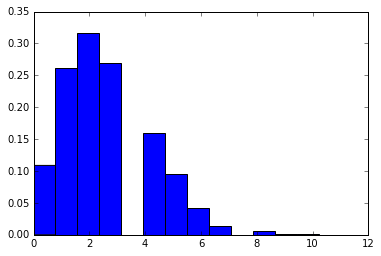

1
5
4
2
4
3
3
1
2
5
3
1
0
2
4
2
2
7
2
2
5
3
2
1
0
3
5
1
1
1
0
3
3
3
1
0
2
2
4
4
5
3
4
2
4
3
1
3
5
4
2
0
2
2
3
3
1
1
2
3
4
1
2
2
3
4
2
2
5
2
0
0
2
3
5
2
2
2
5
4
1
4
1
1
5
3
6
2
3
4
4
2
5
1
2
1
4
1
3
2
2
4
2
4
1
4
5
1
1
5
2
0
0
3
3
4
1
2
1
4
2
1
0
1
2
3
2
2
2
2
3
4
4
2
5
3
1
2
3
6
4
4
0
4
3
3
1
1
2
2
0
5
1
4
4
3
1
2
3
3
6
3
3
5
4
4
1
2
2
1
2
1
4
0
2
0
0
4
2
1
3
4
3
2
2
1
2
3
4
3
1
4
5
1
6
1
8
1
2
2
5
1
3
1
1
3
0
0
2
1
3
1
3
2
2
3
2
1
1
2
4
3
5
1
1
3
3
5
4
3
2
2
1
2
2
5
2
1
3
3
0
1
3
2
3
4
0
4
1
2
3
5
2
2
2
2
2
2
2
3
4
1
4
3
1
2
6
2
1
5
2
2
1
0
1
3
1
2
0
3
3
2
1
3
2
0
2
3
2
2
2
2
2
1
1
3
1
5
1
2
2
2
4
4
3
5
2
2
4
3
4
1
1
5
4
2
5
1
3
3
3
7
1
3
4
3
3
3
5
2
2
1
1
1
1
1
3
5
2
1
0
1
2
2
1
4
1
4
0
1
3
4
1
1
4
2
2
2
2
0
4
6
3
3
2
3
2
1
0
5
3
2
1
3
5
7
3
3
1
2
3
1
1
5
3
2
6
2
2
1
2
1
4
6
1
3
2
2
2
1
2
2
1
7
6
4
2
2
5
3
0
4
1
0
5
3
3
2
6
1
1
4
1
2
2
4
6
5
2
6
3
1
2
2
2
4
2
1
1
2
2
0
1
1
1
3
3
4
4
5
3
3
3
2
3
2
1
1
6
2
0
1
3
0
1
0
1
2
2
3
0
4
0
0
4
0
1
6
1
1
1
2
2
1
3
3
1
2
1
0
0
4
4
2
7
3
5
2
3
2


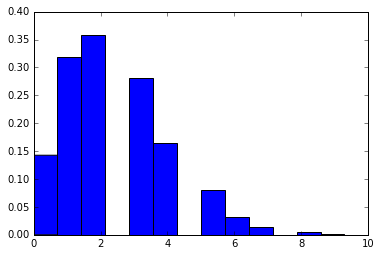

4
4
4
1
4
3
6
1
2
1
2
3
1
4
1
1
1
3
3
2
7
3
3
1
2
3
1
0
4
1
3
2
5
4
7
1
0
3
2
3
1
2
4
2
3
2
1
3
3
3
2
2
2
1
2
2
2
1
4
2
3
3
6
1
3
5
1
0
2
1
3
1
8
2
1
2
1
4
3
2
6
5
1
1
2
4
1
5
1
3
1
2
2
4
1
3
4
0
3
2
4
2
1
1
1
1
2
4
4
2
4
1
4
1
3
2
4
2
2
4
7
1
2
2
3
3
1
2
2
2
0
3
1
2
3
3
5
2
1
3
0
2
3
2
1
0
3
1
1
2
0
1
2
2
2
2
1
1
5
2
2
2
2
2
0
2
3
0
3
2
2
0
1
3
0
1
1
3
0
1
7
3
4
0
3
2
3
1
6
4
2
4
0
5
2
3
4
8
3
6
0
0
2
4
0
3
1
5
0
2
1
3
2
3
1
4
5
2
1
3
2
4
5
2
2
4
6
2
0
3
0
4
4
1
0
5
2
3
0
2
3
3
3
1
3
1
2
3
3
2
1
4
5
4
2
1
2
0
4
1
3
2
1
1
1
3
3
0
2
2
1
3
1
1
2
5
1
2
2
5
1
6
3
1
2
0
1
1
1
0
2
0
1
2
0
3
2
3
3
1
0
1
5
4
2
3
4
2
2
2
2
5
2
0
0
4
4
2
2
3
1
2
2
2
2
4
3
1
0
4
0
3
3
3
1
0
5
0
1
2
1
5
3
1
4
5
3
4
1
0
0
2
2
1
2
1
4
2
1
2
1
1
2
0
2
1
3
3
2
3
1
4
2
1
6
4
4
4
2
1
3
1
3
2
2
0
3
3
2
2
4
3
6
3
4
2
2
1
2
2
1
2
5
5
3
1
5
4
2
0
6
3
5
1
9
2
2
4
2
1
2
1
1
4
2
3
1
5
9
5
3
6
3
2
0
3
2
0
0
2
0
3
5
1
2
2
1
2
1
1
1
1
6
1
3
2
0
1
5
1
1
3
1
2
4
3
1
1
2
2
2
4
3
4
3
2
3
2
5
2
4
2
1
0
3
2
0
2
2
1
2
1
1
5
5
2
2
3
3
0


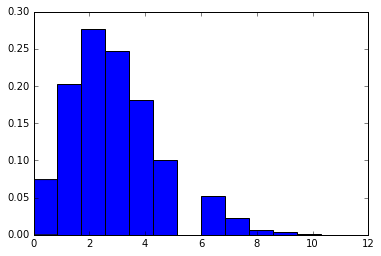

8
0
2
4
3
3
3
3
3
0
4
2
2
0
2
2
2
2
2
4
4
1
3
2
4
2
0
4
4
4
2
2
1
1
4
1
2
2
4
4
0
0
3
6
4
4
3
4
5
2
0
2
8
5
1
4
6
3
3
1
3
2
4
6
4
4
3
3
2
3
1
5
5
1
4
1
3
2
4
5
2
5
3
2
1
1
5
5
2
0
3
3
1
2
3
2
8
1
1
0
1
3
1
5
2
6
5
3
3
1
3
0
3
0
2
8
1
4
2
6
4
5
0
2
4
0
3
4
9
1
4
1
1
0
0
6
5
7
1
2
3
0
1
2
3
1
1
2
0
1
3
3
2
3
5
3
3
4
1
3
1
2
2
4
2
4
4
3
1
2
3
1
5
3
2
2
2
1
1
4
2
3
5
1
2
4
2
3
5
0
4
6
2
0
3
4
2
2
1
4
1
0
2
2
2
3
3
3
3
2
2
0
1
3
0
1
4
3
2
3
7
5
5
6
4
2
1
4
3
1
6
3
5
3
3
1
2
3
0
1
3
2
3
2
0
3
3
2
2
6
5
0
2
2
3
5
5
2
3
3
0
2
2
2
3
1
1
3
2
4
1
2
1
2
7
1
5
4
2
3
4
2
2
0
3
1
4
3
1
2
2
3
1
2
1
2
2
3
5
1
1
1
4
3
8
2
5
6
4
4
2
1
0
6
4
3
2
0
4
3
3
4
3
2
5
4
1
2
2
4
2
6
3
4
3
3
0
2
2
0
2
3
0
1
3
1
4
1
1
3
2
0
4
2
5
3
8
1
1
2
3
3
2
1
1
6
2
2
5
2
2
2
1
3
1
5
4
5
2
2
2
1
3
2
4
2
3
3
4
0
2
5
5
0
3
1
4
1
2
1
5
2
0
5
3
6
3
0
1
2
3
3
4
4
3
6
1
7
6
0
4
4
4
5
2
2
3
4
7
4
3
6
3
7
3
6
3
4
0
3
1
1
3
2
4
6
4
2
2
2
3
3
1
4
4
0
3
3
0
1
2
1
3
2
1
3
3
3
1
4
3
7
2
3
1
2
0
4
6
3
5
2
4
2
4
4
2
8
6
3
5
6
3
2
3
2
1
3
2
4


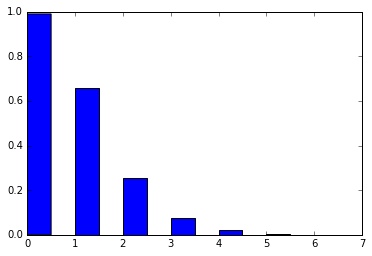

0
0
0
0
2
1
0
0
1
0
0
0
0
2
3
2
1
1
0
0
2
1
0
3
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
2
0
0
1
1
1
2
0
0
1
0
1
0
1
2
3
1
2
4
0
5
1
1
2
2
1
1
1
2
0
0
2
0
2
2
1
0
1
0
1
0
0
0
0
0
2
1
0
1
2
2
1
0
1
3
1
1
0
0
1
2
1
1
0
2
0
0
3
1
0
0
1
0
0
0
2
1
0
0
0
0
0
0
0
0
0
1
0
1
0
2
0
1
1
0
1
0
2
3
2
1
3
0
1
2
1
0
1
1
0
0
2
2
1
0
2
3
3
1
0
1
1
1
3
1
0
1
0
1
0
0
1
1
0
1
0
2
1
0
1
1
0
1
0
0
1
0
2
0
0
1
1
0
0
0
1
2
0
1
1
0
1
0
0
2
2
2
0
1
0
0
1
0
0
1
0
0
3
2
1
1
1
1
0
0
3
0
2
0
2
0
0
2
0
0
1
2
1
1
0
0
1
0
1
0
0
2
0
0
0
0
0
2
0
3
0
2
2
0
0
1
0
0
1
0
0
0
0
0
0
2
0
0
2
1
0
1
0
1
0
1
1
1
0
1
0
0
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
2
1
1
2
2
0
1
1
1
0
1
2
2
1
1
1
1
1
0
0
3
1
1
2
1
1
3
3
1
1
1
1
0
3
1
1
1
1
0
0
2
0
1
0
0
0
1
0
2
0
3
0
2
0
1
0
0
2
0
1
0
1
0
2
0
1
0
0
0
3
0
1
0
0
1
3
0
3
1
1
0
0
2
1
0
2
1
1
1
1
1
0
0
1
1
0
2
1
0
0
2
1
1
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
2
1
0
1
0
0
0
1
1
1
0
0
2
0
2
0
0
0
0
1
1
1
1
0
1
4
1
1
1
0
3
0
2
0
1
1
1
1
0
0
1
2
2
1
2
2
1


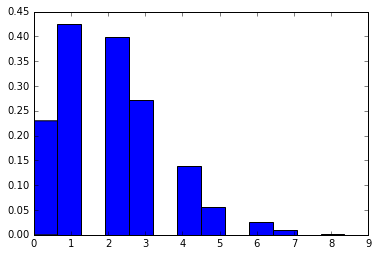

5
2
2
2
6
1
2
4
4
4
4
3
2
4
5
2
2
1
5
1
4
3
1
3
7
1
2
3
4
2
1
1
3
1
6
1
1
3
1
2
1
3
1
0
3
1
5
1
2
1
0
1
1
0
3
0
1
2
3
0
1
2
0
2
2
0
1
3
1
1
1
2
3
6
4
2
3
4
3
2
1
1
2
3
3
6
1
1
3
5
0
3
0
2
0
6
1
0
2
1
3
3
4
3
0
1
2
1
0
1
3
4
2
4
0
3
2
2
3
1
1
1
2
0
3
2
3
5
2
1
0
2
1
4
3
2
3
2
1
5
2
1
2
5
4
0
3
1
1
3
2
6
2
6
2
1
2
0
1
1
4
4
2
3
0
5
2
1
3
0
4
1
2
3
2
1
0
3
4
4
6
2
3
7
3
5
1
5
4
3
2
1
2
3
3
4
0
1
2
2
3
3
1
0
3
4
5
5
1
3
2
1
0
1
1
3
3
2
4
2
2
0
2
1
1
4
0
0
2
4
1
2
0
1
1
1
1
4
1
0
2
1
0
1
4
3
1
0
3
0
2
2
1
1
1
3
3
1
4
1
1
5
1
1
2
0
0
1
2
3
0
4
1
3
2
2
4
0
5
2
4
2
4
3
0
3
1
4
3
4
2
3
2
5
5
1
1
1
3
1
1
1
1
0
1
0
2
4
2
0
2
1
2
1
2
1
2
1
1
2
1
2
3
4
3
0
3
4
1
1
3
4
5
0
1
1
3
2
2
2
2
3
3
1
3
5
3
0
2
3
1
2
1
2
1
3
2
1
4
1
4
2
4
2
5
2
0
2
3
6
2
0
3
1
4
1
0
2
3
2
5
2
0
1
4
3
1
4
0
3
4
4
3
1
2
2
1
1
4
2
4
4
3
5
1
9
0
3
2
2
1
4
1
5
1
1
2
1
3
3
5
2
4
2
1
4
6
3
2
0
4
1
3
2
3
2
3
5
2
3
4
2
3
3
0
0
2
2
2
2
1
1
1
3
4
2
1
1
2
2
4
3
0
6
2
3
3
2
1
2
4
1
0
2
4
1
0
1
2
4
4
2
2
2
4
1
0
4
0
1
1
0
0
1
1
2
2
3
0
0


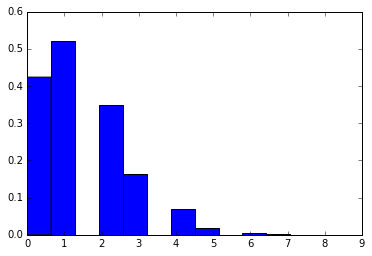

0
0
2
1
1
0
2
0
3
1
1
1
0
3
1
1
2
4
2
3
1
2
1
2
4
0
0
0
0
0
0
1
1
1
2
1
1
0
2
1
0
1
0
0
0
1
1
0
1
2
2
1
1
2
1
1
1
0
0
1
2
0
2
1
0
0
2
2
1
3
0
1
1
2
1
2
4
3
3
0
0
1
2
1
2
2
3
3
5
3
1
4
1
3
1
2
4
3
1
1
1
4
2
3
0
5
1
4
4
0
0
3
2
2
1
2
2
0
1
0
4
3
2
4
2
5
2
2
3
0
3
2
1
3
1
0
1
0
0
1
1
1
1
0
0
4
2
1
0
0
1
0
2
2
3
1
0
1
0
0
2
0
2
3
0
2
2
0
1
3
0
1
0
4
1
4
4
1
1
2
3
2
2
0
3
0
3
2
0
1
1
0
0
4
2
1
0
2
2
1
1
3
0
2
0
0
2
2
3
0
4
4
2
3
0
0
3
4
2
0
0
0
2
0
1
1
1
1
0
2
2
3
0
5
1
1
2
2
2
1
0
2
1
2
1
3
1
0
3
1
2
1
1
2
2
2
0
1
1
0
0
0
5
1
2
1
0
1
3
1
1
0
2
0
2
2
1
3
1
2
1
3
2
3
1
1
0
1
0
1
3
2
1
2
0
1
0
3
2
0
0
1
2
1
2
1
0
2
0
0
1
0
5
0
2
3
0
1
0
0
3
0
2
2
0
2
0
0
0
0
3
3
2
2
3
1
0
2
1
0
2
1
1
2
1
1
2
2
1
3
0
1
1
1
1
4
1
4
0
1
0
2
4
3
3
7
2
2
1
1
2
0
1
1
2
0
1
2
0
1
0
1
1
2
2
0
4
2
0
2
1
1
2
0
3
2
2
0
1
2
2
1
0
1
1
2
4
4
3
0
2
2
2
0
4
1
2
5
1
3
3
5
1
0
1
1
2
0
1
3
2
0
0
0
1
2
3
1
1
1
2
2
3
2
1
1
1
1
2
2
0
0
2
0
0
0
1
0
1
1
2
5
1
3
2
0
2
2
2
0
2
0
0
1
3
0
1
2
2
0
1
0
0
4
2
0
1
1
0
3
2
3
3
0
2
0
1
0
0
0


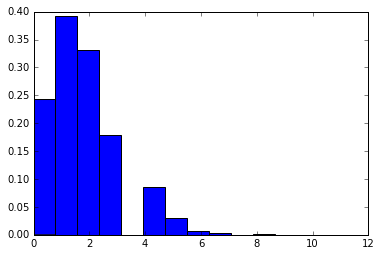

4
2
3
1
1
3
3
1
3
0
1
2
1
2
0
0
2
2
1
1
2
1
1
3
4
1
1
0
1
1
0
0
1
0
1
1
3
1
1
4
3
1
3
3
2
2
2
1
3
1
0
0
3
3
2
2
3
2
1
1
3
0
0
3
2
1
0
2
1
1
2
0
0
2
1
0
2
0
0
0
1
0
0
2
4
3
1
3
2
1
1
3
2
1
1
0
3
4
1
2
1
2
1
1
4
2
1
1
0
0
3
0
1
2
0
2
0
1
1
2
1
3
0
1
1
3
2
3
0
1
2
2
2
3
1
0
2
0
3
3
0
2
1
1
2
2
1
2
1
1
2
0
1
0
1
2
1
2
2
1
4
3
4
2
3
2
5
2
3
4
3
3
3
0
2
2
1
1
1
3
3
0
2
1
4
2
0
3
3
2
0
2
0
3
3
1
0
0
2
0
0
3
0
2
1
3
1
1
2
1
2
0
1
0
2
1
0
2
3
2
1
0
3
0
0
2
4
0
2
0
2
4
0
2
3
1
0
2
2
2
1
2
1
4
1
0
1
2
0
6
5
2
6
2
3
5
4
1
1
2
2
0
4
0
0
1
2
2
0
1
0
2
0
1
1
0
3
4
3
4
2
3
1
5
1
3
0
1
2
2
1
4
1
0
0
2
1
0
5
2
5
3
1
0
4
3
1
4
0
2
4
2
1
1
4
2
1
1
3
1
2
1
4
2
3
2
2
1
0
0
3
0
1
3
4
0
5
2
1
2
1
1
2
3
0
2
3
1
2
2
2
0
2
4
1
2
2
1
1
0
2
2
1
2
1
3
1
0
2
1
3
1
4
1
0
1
1
0
1
0
1
0
2
1
2
1
3
0
2
0
0
2
1
1
2
2
0
2
2
0
1
4
2
3
0
2
4
1
1
4
1
1
3
3
1
3
1
2
0
2
5
2
0
0
5
3
1
2
3
1
1
0
1
4
1
4
3
1
0
0
1
4
1
1
4
1
4
4
1
4
0
4
0
2
3
2
6
3
4
3
2
1
2
2
3
2
2
1
3
1
2
3
0
1
0
1
2
0
0
3
1
1
3
0
1
1
1
3
1
1
0
1
4
1
0
1
3
3
1
3


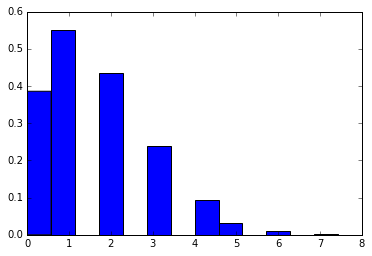

3
3
2
1
2
0
3
2
5
2
2
1
1
0
3
0
0
0
3
0
3
0
1
2
2
3
0
1
1
2
0
1
1
0
1
0
0
2
0
1
4
0
0
1
1
2
2
3
0
0
3
3
1
2
0
1
0
0
1
3
0
1
1
0
0
2
3
2
2
0
2
3
1
3
0
0
1
1
0
1
2
1
1
0
2
1
3
2
1
2
3
2
2
3
2
1
0
0
1
2
3
3
0
2
1
1
0
0
1
2
0
3
2
0
2
2
1
2
2
1
1
3
2
3
0
1
1
2
0
3
3
0
2
2
0
3
2
3
2
3
1
1
1
3
1
4
1
1
1
1
1
1
2
2
2
0
1
2
2
1
1
4
2
1
5
1
5
1
2
2
1
0
2
4
1
1
0
0
2
1
0
1
2
1
2
2
4
0
2
4
1
5
0
1
1
0
3
4
1
2
0
2
2
1
2
2
3
5
6
6
0
1
1
3
2
4
2
0
1
3
0
0
2
1
0
0
1
4
2
1
5
1
1
2
2
4
5
1
0
1
5
3
2
2
2
1
2
2
0
0
0
3
1
0
0
4
3
3
1
3
3
0
1
1
2
2
3
3
2
4
2
1
2
3
2
2
0
2
1
0
1
2
2
1
4
2
2
1
1
0
0
0
1
0
0
0
1
2
1
0
2
3
2
1
2
3
3
0
1
2
2
2
3
1
1
5
1
1
1
1
1
2
0
1
0
0
1
1
3
1
3
2
3
2
1
3
0
0
1
2
0
6
1
2
1
1
1
2
0
0
1
1
0
2
0
2
4
1
1
3
3
0
1
1
4
5
2
2
1
2
3
0
4
2
2
0
1
0
0
1
1
2
0
5
2
3
2
0
3
0
5
2
6
5
0
1
2
1
1
1
0
2
1
3
1
1
3
3
5
3
1
2
5
2
2
4
0
3
1
2
2
0
1
1
0
2
1
1
0
2
0
0
2
2
4
1
0
2
3
1
5
2
2
0
1
2
2
3
0
1
1
3
4
1
1
5
2
1
2
1
1
0
2
3
0
3
3
3
4
1
2
1
1
1
3
1
2
0
1
2
1
1
4
2
2
5
2
0
3
4
1
2
0
1
2
0
1
1
2
0


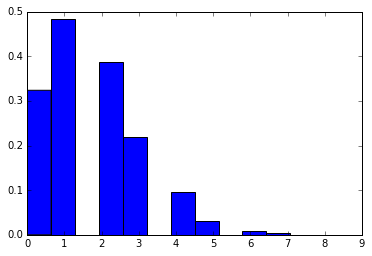

5
1
2
0
0
1
1
3
2
2
0
1
3
2
3
1
0
2
2
2
4
2
2
0
1
2
0
1
1
2
2
4
2
1
2
0
0
1
3
2
0
0
2
2
2
5
0
3
2
2
4
3
2
0
4
1
3
1
2
1
2
2
0
3
2
0
2
1
1
2
3
1
1
6
0
0
0
2
1
3
0
0
4
1
6
1
3
1
2
4
1
2
2
2
2
3
1
2
0
3
2
3
0
3
4
2
2
2
2
2
3
2
0
1
1
2
3
4
0
0
2
1
1
2
2
1
2
1
3
5
3
4
6
1
3
2
4
2
3
3
4
4
1
4
2
6
4
3
0
2
2
2
1
0
0
2
4
2
2
1
1
3
2
2
2
1
1
4
4
1
5
4
1
1
2
1
0
2
2
1
1
1
0
1
0
1
2
0
1
0
3
2
2
1
0
5
2
2
1
0
0
4
0
3
4
0
0
1
2
0
1
1
2
0
1
0
0
2
1
1
3
1
4
2
0
3
2
3
4
5
0
3
0
0
1
2
3
1
1
0
2
1
0
1
2
2
1
2
2
2
0
2
1
3
3
0
1
4
0
3
0
1
0
2
3
2
2
0
0
0
3
0
1
0
4
4
1
2
2
1
1
1
3
3
3
2
0
1
1
0
0
2
1
1
1
1
2
0
2
3
3
1
1
2
2
0
5
1
4
5
1
4
4
1
3
5
1
2
3
0
0
1
1
0
1
4
0
1
1
0
2
3
1
2
2
3
0
1
4
3
2
4
2
2
2
1
3
1
2
3
1
0
1
1
0
1
1
0
4
1
0
5
0
2
3
2
1
5
5
5
1
1
3
1
2
3
4
0
2
2
3
0
1
3
2
3
1
1
1
3
0
2
1
3
3
2
0
5
1
0
1
2
1
5
0
0
2
2
4
3
4
0
2
1
1
2
2
1
0
1
5
2
2
4
6
2
4
0
0
2
1
2
2
2
1
0
3
1
2
4
2
2
3
1
2
0
1
1
0
2
1
0
2
0
2
1
2
1
4
1
0
2
3
1
3
2
1
1
2
1
2
1
2
0
2
4
1
4
2
1
2
2
1
0
0
3
0
2
1
2
0
3
1
1
2
3
2
0
0
1


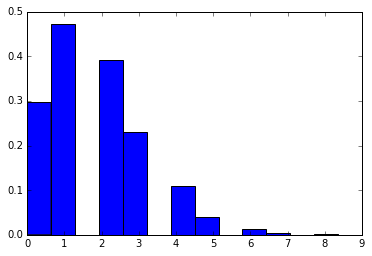

0
0
1
2
2
0
1
2
1
1
3
2
2
1
1
2
1
1
4
3
1
5
2
3
1
1
1
2
2
2
2
2
0
0
0
0
2
1
0
3
2
0
1
2
1
0
6
3
0
0
4
0
0
3
2
0
1
1
0
1
2
1
1
0
0
0
2
0
3
0
3
1
3
4
2
1
0
1
3
1
2
2
0
3
2
4
1
4
3
1
0
1
1
1
2
2
1
5
1
5
1
2
4
0
2
0
3
1
1
0
1
2
0
0
2
1
1
1
2
1
0
3
0
3
4
2
2
0
0
2
3
5
4
1
1
3
1
0
3
2
1
2
6
4
2
2
4
1
1
3
1
0
0
0
2
0
1
1
2
4
2
3
2
2
2
1
3
2
5
2
2
2
1
4
2
3
1
1
2
2
1
2
2
0
0
1
2
0
1
2
2
1
0
2
1
3
2
2
1
2
1
2
2
1
1
0
1
1
1
0
1
2
1
0
1
2
1
2
4
1
1
1
0
3
2
0
3
3
3
1
2
2
1
1
2
2
3
4
5
1
1
1
0
4
2
1
5
2
1
1
3
0
2
4
3
1
5
1
1
1
2
0
1
2
0
2
1
2
3
1
3
3
4
2
3
1
3
2
0
1
5
1
0
3
1
1
5
2
0
2
0
3
1
1
4
3
1
1
1
5
2
2
5
0
3
3
0
1
4
5
3
0
1
0
3
1
0
1
4
1
2
1
2
1
3
1
1
2
2
2
4
2
2
5
4
3
2
5
2
2
2
4
3
2
1
0
3
2
0
1
0
0
0
4
3
2
1
3
1
0
1
2
3
4
4
1
5
4
1
1
3
3
3
4
1
1
2
2
1
0
0
0
4
1
3
0
2
2
2
4
3
4
2
3
0
4
0
3
1
1
2
4
1
2
1
3
2
1
2
2
4
3
3
5
0
1
1
1
3
1
3
0
1
2
2
1
2
0
2
0
2
1
4
3
6
2
2
0
1
0
2
1
1
3
5
3
0
3
0
2
2
1
2
4
1
2
5
2
3
0
4
0
0
1
1
1
3
2
0
2
1
0
1
1
2
2
2
4
2
0
1
3
2
1
2
0
1
0
1
0
0
2
1
1
2
0
1
0
2
2


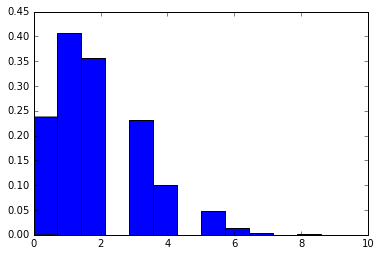

1
1
0
1
4
2
1
3
1
1
0
2
1
5
1
2
0
2
3
0
1
1
4
3
4
1
1
2
1
2
1
0
0
0
0
1
2
0
0
1
1
2
1
5
2
3
2
1
2
4
0
0
0
3
6
2
1
3
3
0
1
1
3
1
3
3
0
3
2
3
3
1
3
1
1
0
2
4
4
3
4
3
1
1
4
1
4
3
0
5
2
4
3
1
1
2
1
3
0
4
0
3
2
3
3
0
0
0
1
2
2
4
1
1
3
1
1
3
1
2
1
1
0
0
3
1
1
1
2
2
0
3
4
2
2
2
1
0
4
8
4
2
1
2
4
1
1
2
2
2
1
0
2
3
4
5
2
2
3
4
0
2
2
1
1
5
4
4
3
2
1
2
0
2
1
3
0
1
2
1
2
3
0
4
1
4
2
1
1
1
3
3
2
2
2
0
2
2
1
0
2
6
7
0
0
1
0
1
1
1
3
2
4
3
0
3
4
3
0
3
2
3
1
0
1
5
5
0
0
2
4
2
1
5
1
2
2
3
1
1
2
5
2
1
2
3
2
1
3
1
2
1
1
2
1
0
4
1
2
5
4
1
0
0
2
2
1
1
3
3
3
0
2
1
2
1
1
3
1
1
1
0
1
1
3
1
2
2
0
2
1
2
0
3
1
1
0
1
1
1
0
1
2
6
3
2
0
1
2
2
3
0
2
2
4
2
0
2
1
0
1
1
1
2
3
3
2
0
2
3
1
3
5
7
3
1
2
3
1
2
3
1
1
4
3
1
1
2
2
1
4
3
1
0
3
1
2
1
1
3
1
5
5
2
2
3
5
2
2
1
3
3
1
1
2
1
3
3
1
0
2
1
1
1
3
4
1
0
3
1
0
1
3
1
1
1
1
1
2
4
3
2
0
4
3
7
2
0
3
2
2
3
4
0
3
2
4
4
3
3
3
3
1
1
2
6
1
0
0
3
1
0
1
1
2
6
0
3
2
3
1
6
4
1
3
2
2
5
1
0
1
2
0
0
2
0
0
1
3
4
2
3
3
5
2
1
4
4
1
1
1
3
1
0
1
2
2
2
4
2
3
3
0
4
2
3
4
1
1
2
2
2
1
2
0
0
3
2
0
1


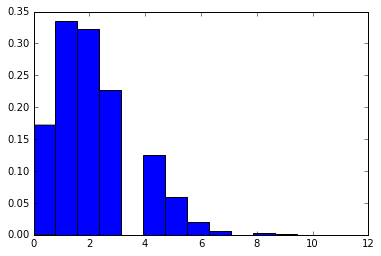

4
3
3
5
1
3
1
3
1
0
0
5
2
2
4
3
2
3
3
3
1
3
2
4
3
0
0
1
0
3
1
0
2
5
4
2
1
4
1
4
2
3
5
1
1
4
0
2
1
6
1
2
4
0
4
0
3
1
2
2
2
1
4
3
0
1
0
2
0
3
4
1
2
1
0
1
0
2
1
3
1
3
2
2
4
1
1
3
5
1
6
3
3
2
2
4
1
1
0
2
2
1
1
2
5
4
1
2
2
1
3
2
2
2
1
2
1
0
2
1
3
1
1
4
2
2
3
2
4
1
5
3
1
1
2
2
4
3
2
3
7
2
3
6
5
2
4
1
0
2
2
1
2
2
1
1
4
1
0
0
3
4
3
5
2
3
1
1
2
1
1
3
0
0
3
4
3
1
2
1
3
3
1
3
1
3
4
3
2
0
4
2
1
0
1
1
0
3
1
3
1
2
1
2
2
2
4
5
4
1
2
3
1
4
4
5
5
2
2
1
1
0
1
2
1
2
0
2
0
2
0
0
1
1
6
1
1
3
3
3
1
1
3
3
2
0
3
1
0
2
0
5
3
2
2
1
1
8
1
2
7
0
2
6
3
3
5
0
2
3
1
1
3
2
4
5
4
3
3
0
1
2
4
2
3
1
1
3
2
0
1
2
2
4
2
2
1
1
4
0
1
1
3
3
3
4
4
1
3
4
1
3
3
2
2
1
1
0
3
3
1
4
1
4
2
4
2
1
0
2
3
3
3
1
2
3
1
5
3
2
2
4
2
2
4
1
1
1
1
1
2
0
1
1
2
2
1
4
2
3
3
2
7
2
3
1
2
2
2
1
2
4
2
2
3
2
1
3
1
0
3
3
2
4
4
1
1
3
0
1
4
2
1
2
2
2
0
1
1
9
1
3
0
2
7
1
4
2
6
3
4
5
2
3
1
5
4
0
3
4
2
5
1
4
1
4
4
3
2
2
3
4
2
3
0
2
1
3
1
2
1
2
2
4
1
1
1
1
1
2
1
1
0
2
3
4
3
0
3
1
3
6
2
1
2
3
3
2
1
0
5
1
4
2
0
2
3
3
1
3
1
0
2
4
4
2
2
3
2
5
4
3
3
0
1
1
1
3
3
4


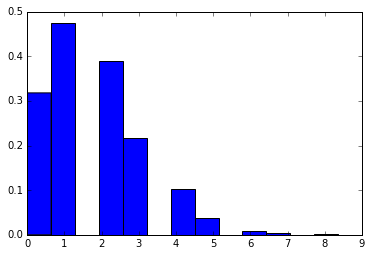

1
1
2
0
2
1
2
3
1
0
2
0
2
2
0
0
2
5
1
0
1
2
2
2
0
2
1
0
0
1
0
0
0
0
1
2
3
1
1
1
2
0
0
0
1
3
1
1
0
0
4
1
2
0
0
1
3
4
0
1
1
1
0
1
0
0
2
2
1
1
4
3
1
4
6
0
3
2
1
1
0
3
1
2
7
3
1
2
2
1
3
3
1
1
1
2
4
3
1
2
2
4
3
1
3
2
1
2
1
2
3
2
1
3
2
1
1
2
0
2
3
1
1
1
1
2
3
2
2
2
2
4
0
1
1
2
1
3
1
2
1
3
2
1
1
3
2
2
1
0
0
1
1
0
5
2
1
1
1
2
3
2
0
4
3
2
3
6
2
4
4
4
3
1
2
1
0
2
1
2
0
0
2
2
1
1
1
0
4
1
1
1
2
3
3
0
0
0
0
1
7
0
1
2
1
4
1
1
0
0
0
2
0
0
3
5
6
1
3
8
4
0
1
3
1
0
1
1
1
3
2
0
1
3
2
1
1
3
2
1
1
1
3
1
2
1
2
2
3
4
2
2
5
4
2
4
2
1
0
1
4
2
3
3
1
3
5
0
2
0
2
3
0
0
5
2
4
2
4
2
0
2
0
2
2
2
4
5
2
4
0
1
2
2
4
0
2
1
2
3
2
1
1
0
2
2
2
2
0
2
5
3
2
3
1
2
1
1
2
2
4
1
3
1
3
1
2
0
1
4
3
3
2
2
3
4
1
3
3
3
0
1
2
0
3
1
0
1
4
2
4
2
1
1
4
0
2
3
0
3
0
1
1
1
1
2
3
1
0
2
2
2
2
3
2
1
1
1
0
1
3
3
0
1
0
3
2
1
2
5
1
2
0
0
0
4
2
2
1
1
3
1
1
1
3
3
1
0
1
2
1
1
0
0
3
1
1
2
1
3
1
3
1
4
0
3
2
0
1
1
0
3
1
2
2
2
1
1
0
1
2
1
2
4
1
1
2
2
0
3
1
4
2
1
3
2
1
2
1
2
6
4
0
3
1
3
3
1
3
1
2
1
1
3
2
4
0
2
0
3
3
2
0
1
1
1
0
4
1
1
3
0
1
1
0
0
3
1
2
0


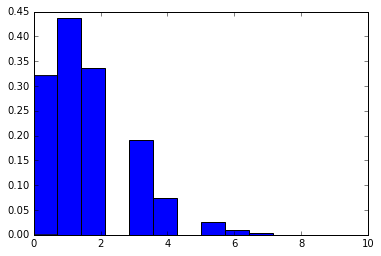

4
3
0
4
1
2
2
3
2
0
0
2
0
2
3
1
1
1
0
1
0
3
1
0
3
1
1
0
0
0
0
1
0
1
0
2
1
1
1
2
1
1
1
0
1
3
2
3
1
2
1
1
4
2
0
0
0
3
1
1
2
2
1
2
0
1
0
2
3
0
0
2
1
1
0
2
1
0
0
1
0
0
0
2
1
1
2
1
3
1
1
2
0
3
5
3
2
2
0
2
1
2
5
1
0
0
0
0
1
0
1
0
1
2
1
0
2
7
1
3
5
1
1
2
3
1
2
2
1
0
3
3
0
1
3
2
0
3
2
0
3
3
1
2
1
1
2
0
1
0
2
0
1
0
2
2
3
1
4
2
3
7
0
0
2
3
0
3
1
1
3
3
0
2
2
1
0
1
0
1
0
0
1
2
1
1
3
0
0
1
5
2
3
1
0
0
0
2
2
5
3
1
2
2
0
1
1
2
2
1
2
0
3
4
0
0
0
2
3
4
1
0
1
1
2
3
2
1
1
1
2
1
0
1
0
0
2
0
4
2
1
3
1
1
1
1
1
0
2
0
0
0
1
2
2
1
1
5
0
2
0
1
0
0
0
0
1
2
2
0
2
3
2
0
3
3
3
0
2
3
2
1
2
1
2
1
1
3
2
1
2
2
2
2
2
0
2
2
1
3
1
0
2
0
0
5
0
0
2
1
0
1
1
1
0
3
0
2
3
2
0
3
0
1
1
0
1
0
1
1
6
2
3
5
1
2
5
2
3
1
2
4
4
2
2
1
3
1
1
2
2
2
0
1
2
1
3
2
2
1
0
6
6
2
2
5
4
1
3
4
2
1
0
2
2
3
4
0
2
0
4
0
1
3
0
2
1
6
3
3
2
0
1
2
1
4
5
4
2
1
1
2
0
1
4
3
1
0
1
1
1
2
1
3
3
0
1
1
1
2
3
3
2
3
1
0
2
2
2
0
1
1
0
0
1
0
3
3
1
3
3
4
3
3
5
2
1
2
2
2
2
2
1
3
0
1
1
2
2
2
2
2
1
2
1
0
3
2
2
1
0
0
0
0
2
1
0
1
2
1
0
2
1
0
1
1
2
1
1
0
0
0
0
0
1
2
2
1
1
0


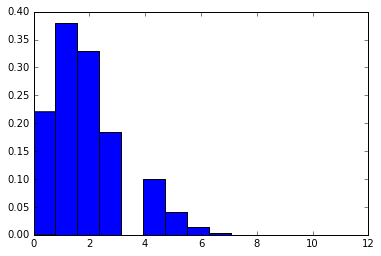

5
1
1
0
0
1
1
2
3
2
0
5
2
3
2
2
2
2
2
3
2
2
4
0
4
0
3
3
2
2
1
2
0
1
2
2
0
2
1
1
1
0
3
0
1
3
3
1
1
1
1
1
2
2
2
2
0
0
0
2
3
0
2
1
2
3
2
1
2
2
1
1
3
0
1
4
0
0
2
1
1
0
0
1
1
4
1
1
0
2
2
2
3
1
6
5
2
4
0
2
1
1
2
3
4
1
1
1
1
2
0
0
2
3
3
0
1
2
2
0
0
1
4
2
3
3
2
2
4
4
3
6
1
2
1
1
1
5
3
3
5
3
2
3
7
2
5
0
4
1
1
2
0
1
0
1
2
3
3
3
0
0
1
0
2
1
5
2
3
0
4
4
0
2
1
1
0
5
4
2
1
0
1
3
2
2
3
2
2
0
0
0
0
1
0
1
1
3
1
0
0
2
1
0
4
0
1
2
1
1
1
2
0
2
1
1
4
2
0
2
3
4
0
1
2
6
1
3
2
2
1
1
1
2
2
1
3
1
1
0
3
3
2
2
1
2
3
3
3
2
1
2
3
2
1
4
4
3
1
1
3
2
1
3
0
2
2
0
4
1
1
2
1
0
3
0
4
6
2
2
4
1
1
3
3
2
1
2
4
5
3
1
3
1
0
1
2
1
2
3
2
3
0
3
3
0
0
3
3
1
3
4
2
2
2
0
1
1
2
1
2
0
1
0
1
1
1
3
2
3
6
2
2
5
2
3
2
2
2
3
1
3
1
2
2
1
2
1
3
4
1
4
2
0
2
2
4
4
4
1
1
4
2
2
4
4
6
3
1
1
0
3
1
0
1
2
1
0
2
4
2
3
1
5
2
1
1
4
0
4
0
1
0
3
0
4
4
1
1
1
1
2
2
4
2
2
1
0
0
3
1
3
2
5
2
0
3
3
2
3
1
0
6
1
2
2
3
2
1
2
0
0
1
2
1
4
0
1
2
2
1
2
0
1
2
3
4
4
2
0
0
2
1
1
1
3
0
0
1
0
2
1
0
3
1
2
5
1
1
0
1
1
1
1
0
3
3
1
2
2
2
1
3
1
1
4
1
2
0
2
0
1
1
4
0
2
2
3
1
0


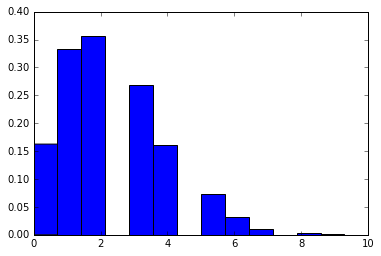

3
6
0
3
0
3
1
0
1
0
0
5
1
0
1
2
1
0
2
1
4
1
3
0
1
0
1
0
2
0
2
1
0
0
0
1
2
5
2
0
2
0
1
4
2
4
6
1
2
0
4
2
1
1
4
1
2
2
2
2
0
2
1
3
2
2
2
4
3
3
2
2
3
1
2
0
0
1
3
2
3
1
1
2
4
3
6
2
4
4
5
1
4
5
2
3
2
5
3
3
2
4
3
2
2
4
1
3
1
2
3
1
3
2
2
1
3
3
3
4
3
1
4
2
1
1
3
2
2
7
4
7
2
3
3
4
2
0
1
2
1
1
3
2
6
2
3
0
7
1
2
1
2
4
3
3
0
1
4
0
6
1
1
3
1
1
2
2
1
0
3
3
1
7
2
2
0
2
0
2
2
2
2
1
2
3
2
1
2
2
1
0
2
2
2
1
2
1
1
3
1
1
0
2
4
0
4
3
2
3
2
1
3
2
0
0
1
5
3
1
1
0
2
2
4
0
1
2
1
2
3
1
0
2
4
3
1
1
1
2
1
2
3
2
2
4
4
3
2
5
1
3
2
1
2
3
5
3
2
1
6
0
4
3
1
4
1
2
1
2
4
2
3
2
2
2
5
7
1
3
5
3
3
2
4
2
5
4
1
7
1
1
1
7
0
3
2
1
2
5
0
4
2
6
6
0
3
1
3
1
0
2
5
1
1
1
5
0
2
1
0
4
5
3
2
2
2
0
3
2
4
6
2
6
3
3
5
5
5
0
3
6
6
1
6
3
1
4
2
2
8
2
4
3
2
1
3
1
2
4
3
2
4
0
1
2
5
2
3
4
4
2
3
2
1
0
0
1
2
2
4
4
1
1
4
3
4
3
0
1
1
0
2
0
0
2
2
4
1
1
2
1
1
2
4
1
3
3
1
3
2
3
3
2
5
3
4
3
3
3
1
4
0
2
2
5
4
2
1
1
1
1
1
1
3
3
0
3
3
2
4
1
2
5
3
2
1
2
2
2
2
1
1
1
2
1
2
2
2
2
3
1
1
3
3
2
1
4
2
0
2
0
2
1
1
2
4
2
3
3
1
1
2
0
3
2
1
1
0
2
2
0
2
1
3
1
1
2
1
2


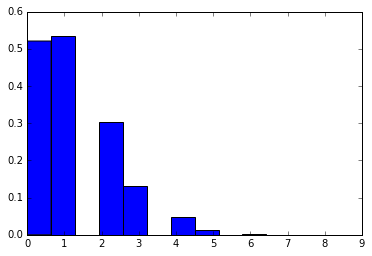

1
1
1
0
2
0
0
2
0
0
0
2
3
0
4
2
3
2
1
1
1
0
0
2
1
2
3
2
2
0
2
1
1
0
3
3
0
2
1
1
1
1
1
3
3
3
1
4
0
0
1
2
1
1
1
0
3
1
2
1
3
2
1
0
2
1
0
1
1
1
0
0
3
3
0
1
0
0
0
1
0
0
0
1
0
3
1
0
0
3
0
1
2
3
1
1
2
2
3
0
1
3
0
1
1
3
4
1
0
3
1
1
0
1
1
0
0
3
0
0
2
0
2
1
2
2
1
2
2
0
2
3
1
0
1
0
0
1
1
1
2
1
1
5
1
1
2
0
2
3
3
0
2
1
2
3
0
0
2
2
0
0
1
1
2
2
3
3
2
3
1
2
1
1
0
2
1
3
1
1
0
1
0
0
1
3
1
1
0
0
0
4
2
2
0
0
1
0
1
1
1
0
2
2
1
1
4
1
5
3
1
0
2
1
0
0
2
0
2
1
2
1
1
2
0
1
0
0
2
3
5
4
2
1
1
4
3
2
1
1
3
2
0
1
1
2
2
0
0
0
1
2
2
4
3
1
1
1
4
4
1
0
0
0
0
0
0
2
2
0
0
1
3
0
1
1
1
2
2
0
1
1
2
1
3
2
3
1
0
1
1
1
2
4
0
1
0
1
2
0
0
0
1
2
1
0
0
1
1
0
3
0
2
0
3
2
0
1
0
1
1
1
1
2
4
2
2
1
1
0
1
0
5
1
1
4
3
3
4
0
1
0
3
0
2
0
0
1
0
2
1
0
2
2
1
0
0
3
0
1
1
3
1
2
2
3
0
0
4
0
2
0
2
1
2
3
0
0
1
1
0
4
1
1
0
2
0
2
0
0
2
2
2
1
2
2
1
1
0
1
1
0
0
0
2
3
2
2
1
1
2
2
1
3
0
2
0
2
3
0
1
2
1
0
1
1
2
0
2
0
1
0
0
1
2
2
0
2
1
3
1
0
3
0
1
2
1
2
0
1
0
1
0
1
3
6
1
2
2
1
3
0
0
0
1
2
0
0
0
1
0
1
0
0
1
2
4
0
1
0
1
1
0
1
2
1
5
1
2
0
2
0
0
0
0
1
0
0
1
0


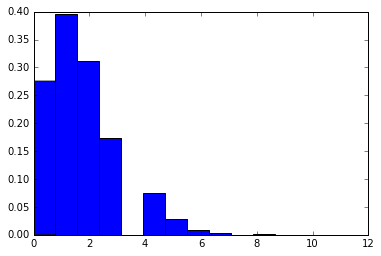

3
3
3
1
0
0
3
2
0
0
3
2
1
2
2
3
0
1
0
0
1
2
0
2
0
3
0
0
0
0
2
0
1
0
1
0
1
2
3
0
0
1
0
2
0
2
0
0
2
2
2
1
0
0
1
1
0
2
2
0
0
1
1
0
2
1
0
4
1
2
0
1
4
1
0
0
2
0
0
1
3
2
0
3
3
1
1
0
0
3
0
1
3
0
3
3
4
0
0
1
0
2
2
1
2
2
1
1
2
2
0
1
1
5
1
0
0
2
4
2
1
1
4
4
1
3
3
4
1
1
2
7
3
2
1
1
1
1
2
0
3
4
6
5
1
0
4
4
1
0
3
2
1
0
2
1
1
3
0
0
5
1
3
2
2
6
1
2
6
1
0
2
0
0
0
2
2
0
0
0
2
0
2
0
1
4
1
1
2
0
3
2
6
2
1
1
2
2
1
3
4
1
2
0
1
4
0
2
1
0
5
5
3
1
3
1
0
2
2
3
3
0
3
1
0
4
1
1
3
1
4
1
1
3
0
1
2
2
0
1
0
1
0
5
1
2
2
1
0
2
0
1
1
3
2
4
0
1
2
1
1
1
0
2
1
1
4
0
0
2
0
1
2
0
1
0
2
0
1
3
0
4
1
4
2
4
1
3
0
2
0
0
0
1
1
3
3
1
1
0
3
0
2
0
1
4
0
1
1
1
0
2
1
1
3
2
3
1
2
2
1
3
2
0
2
0
2
0
2
0
2
3
2
4
3
2
0
2
3
1
0
3
2
0
0
1
2
1
3
2
1
1
1
2
3
2
0
0
0
2
1
3
0
1
0
2
3
2
3
0
2
2
3
4
2
2
3
1
1
4
2
2
3
2
2
1
3
0
0
1
2
1
2
3
1
1
1
0
1
2
2
0
4
1
0
0
3
2
2
4
0
1
4
3
1
1
0
2
3
1
2
1
2
2
2
3
1
1
1
1
0
2
1
0
0
2
0
1
1
3
0
2
3
1
3
0
2
2
1
4
2
1
1
2
0
0
2
1
1
3
2
0
3
2
2
3
0
1
0
1
2
3
1
0
1
0
4
0
3
0
2
1
1
2
1
2
1
1
1
2
0
2
0
2
0
2
1
0
3
1


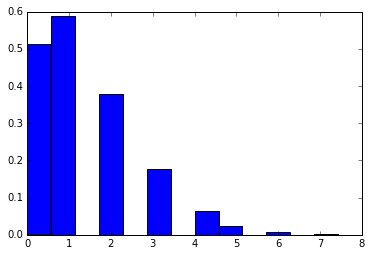

1
1
1
1
0
0
0
0
1
2
3
1
1
3
2
0
1
3
3
1
2
1
0
2
1
0
0
1
3
0
1
2
1
0
2
2
1
5
2
0
1
3
3
3
2
0
1
1
2
3
1
1
1
0
0
0
2
0
1
1
0
2
2
1
0
1
1
2
1
0
0
1
1
2
1
1
1
1
0
0
1
1
3
2
6
0
0
1
0
1
2
1
4
1
2
2
1
0
0
2
6
2
1
4
2
0
5
0
5
2
0
0
0
0
0
1
2
1
0
4
3
3
0
1
1
3
1
2
1
2
2
3
1
0
2
4
2
3
2
1
1
1
1
1
3
1
1
1
1
1
2
0
0
1
0
0
0
0
1
2
3
0
1
2
2
2
3
1
1
2
0
0
1
2
1
3
2
5
0
0
2
5
4
0
0
1
3
0
1
1
1
0
1
1
2
3
1
3
0
0
0
3
1
3
0
4
4
3
4
2
0
1
2
0
4
2
2
1
4
2
4
0
1
5
2
1
6
3
1
2
3
0
1
1
1
1
4
3
2
3
0
3
2
4
1
2
0
2
0
4
2
4
1
1
2
1
3
2
0
2
4
0
1
1
0
0
1
0
0
2
2
0
0
1
2
2
1
1
0
1
0
2
1
0
1
1
0
0
1
0
1
1
0
0
0
2
1
3
2
0
1
1
0
0
1
0
0
1
0
1
2
2
1
2
2
3
2
0
0
1
1
1
0
0
0
1
2
0
2
1
2
3
3
1
1
5
1
3
1
1
4
1
0
3
0
2
1
2
1
2
1
2
1
1
0
1
3
0
5
2
1
4
2
4
0
1
4
1
3
2
0
3
0
1
0
1
0
1
0
0
0
0
3
1
0
3
4
1
1
0
0
2
0
2
0
1
3
0
0
3
1
3
1
2
4
0
1
1
3
2
1
3
3
5
0
0
1
1
0
3
3
2
3
1
2
2
1
4
0
0
3
0
1
0
1
0
0
1
1
1
0
0
0
2
2
2
2
0
0
0
0
2
1
0
2
1
0
0
3
4
1
0
0
2
0
2
0
1
0
2
1
2
2
2
0
1
0
2
0
0
2
1
0
0
0
0
2
1
3
1
1
0
2
0
1
2
0
1
0
1


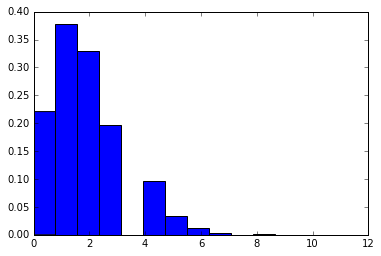

1
3
2
3
2
3
2
1
2
1
0
1
1
0
0
1
1
1
0
0
0
7
2
1
1
1
2
4
0
1
0
2
3
1
0
2
4
1
1
2
1
2
3
1
1
1
5
1
2
0
2
2
4
1
1
3
0
2
2
0
0
0
1
0
1
5
0
4
1
0
4
0
4
3
1
1
1
1
0
0
1
4
0
1
2
0
0
2
0
1
1
5
0
2
2
4
3
3
0
1
4
3
1
1
1
0
0
2
3
1
0
0
0
0
1
2
0
3
2
1
0
1
2
3
0
1
1
3
3
1
5
4
1
3
3
0
2
1
2
1
3
2
5
6
1
3
4
1
1
1
1
3
1
1
0
3
4
2
1
0
3
1
5
2
2
1
1
1
2
2
6
2
3
3
1
1
1
4
2
4
2
1
2
1
0
0
0
0
1
1
3
1
0
2
2
0
0
1
1
2
1
3
0
2
0
3
2
2
5
0
4
0
2
0
3
1
4
3
1
4
3
1
2
3
0
3
1
5
0
2
1
2
2
2
5
0
1
3
4
0
0
2
2
2
1
1
2
0
1
2
3
3
2
1
3
3
1
1
0
1
4
2
2
0
1
1
0
3
3
2
0
3
1
2
0
2
1
1
1
2
3
4
0
1
2
4
2
3
1
4
2
3
4
2
1
1
0
3
1
1
1
0
1
4
1
3
1
1
1
5
3
0
3
0
1
0
2
0
1
1
1
1
1
0
1
0
2
1
0
1
0
3
5
4
3
2
6
2
4
0
3
1
2
0
1
1
2
2
2
2
3
3
0
1
1
1
3
2
2
2
3
6
3
3
3
2
2
2
1
2
0
3
1
2
3
1
4
1
2
2
11
1
3
1
4
1
6
0
7
4
3
1
2
1
2
1
1
0
3
4
1
7
1
0
4
2
0
0
0
5
2
3
2
2
1
1
2
1
1
0
2
1
1
2
2
4
2
1
2
2
2
1
2
2
1
4
2
0
3
2
1
4
2
3
4
5
2
3
1
1
1
2
1
2
2
0
0
2
1
3
2
4
1
1
1
1
2
3
2
2
3
5
3
1
0
2
0
1
1
3
2
1
0
2
2
1
2
1
4
1
1
2
1
2
3
2
1
3
0
2

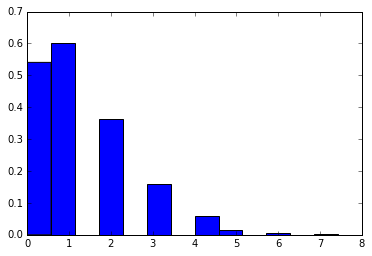

1
4
1
0
0
4
0
1
2
0
3
3
0
0
2
2
1
3
0
3
0
0
0
0
0
1
3
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
2
0
3
1
2
2
2
0
0
1
4
0
0
0
1
1
0
0
0
3
0
2
0
5
1
2
0
0
1
1
0
0
0
0
0
1
1
2
2
1
2
0
1
2
1
1
0
2
1
0
2
3
1
0
1
1
1
3
1
2
0
0
1
2
1
0
2
2
0
3
1
0
0
6
2
2
1
2
1
4
1
1
1
3
3
2
2
1
1
0
0
2
1
1
0
1
2
0
0
0
1
0
0
1
0
1
0
1
2
1
0
2
0
0
1
0
0
1
2
2
2
1
1
1
1
1
1
1
0
1
0
1
0
2
0
3
2
1
2
3
1
1
1
2
0
0
0
3
3
3
0
0
0
3
0
1
3
2
2
2
2
6
3
0
0
2
1
0
1
0
1
2
1
0
0
4
1
1
2
1
3
0
0
2
2
0
2
2
1
0
2
1
0
0
2
0
1
1
3
0
1
1
0
0
0
0
2
0
2
2
0
0
2
0
0
1
0
1
1
4
1
0
1
0
0
2
1
1
3
1
0
0
4
1
1
2
0
1
2
1
1
0
1
1
2
1
1
0
1
0
1
0
0
1
3
2
0
0
0
1
3
0
3
6
1
1
2
0
4
2
3
3
4
2
1
2
0
1
0
0
3
1
0
2
1
1
0
4
3
4
2
1
3
1
1
1
2
1
1
0
2
2
0
1
5
1
3
8
2
3
0
3
2
0
0
1
2
1
0
0
0
1
1
0
1
2
1
0
1
3
0
0
1
3
1
0
0
0
1
1
0
2
0
3
0
2
1
1
3
1
2
0
4
1
3
2
0
0
3
2
2
1
0
0
1
3
0
0
1
2
1
1
2
0
0
0
0
3
3
3
1
1
6
0
1
0
1
0
0
1
0
1
1
1
0
0
2
1
1
1
3
1
0
2
0
0
5
1
0
0
1
1
1
4
0
0
1
3
1
1
2
0
0
1
2
2
3
2
0
3
0
5
1
4
2
1
2
1
2
3
1
0
1
1
0
0
0
1
0
1
1
0
0
0
2
0
2
2


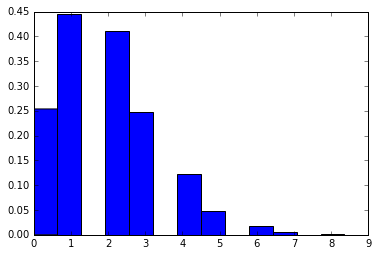

1
3
3
1
3
3
1
2
5
1
3
2
2
3
2
4
2
4
0
1
0
2
3
3
0
4
4
1
2
0
1
1
1
1
1
1
0
1
1
2
2
1
1
2
2
2
1
2
5
1
1
2
1
0
1
1
2
1
2
1
1
0
0
2
2
1
4
1
1
2
2
1
2
3
0
3
4
2
1
2
2
4
5
7
3
3
2
2
3
2
2
0
0
3
4
0
2
1
1
4
0
3
1
1
2
1
3
4
1
2
1
3
3
2
2
0
2
0
2
3
3
1
3
1
2
2
0
1
1
0
1
2
2
3
3
1
2
1
4
1
4
2
2
1
1
1
0
2
1
0
3
3
0
0
1
0
0
1
0
2
1
1
1
0
1
1
1
1
1
1
1
2
3
0
1
4
2
2
2
1
1
1
2
4
2
1
2
1
2
3
4
1
4
6
2
2
2
3
1
5
4
3
1
2
2
1
3
0
2
2
4
2
0
0
2
2
4
1
1
3
1
2
3
4
4
0
4
3
4
2
2
2
0
2
2
1
1
2
1
2
4
2
2
0
5
1
0
2
1
0
2
0
0
3
1
3
2
1
1
1
1
6
4
1
1
1
1
1
3
4
2
3
3
2
2
3
3
1
1
0
0
3
1
1
2
2
2
0
0
1
4
3
3
1
2
3
3
2
1
1
1
2
2
2
5
0
2
4
0
1
1
0
0
2
1
0
2
1
3
1
2
3
3
0
1
4
4
0
1
3
3
4
3
0
1
0
1
4
3
3
1
2
3
1
2
4
3
2
3
5
3
4
4
4
3
3
1
0
1
0
1
3
2
3
1
1
0
2
0
0
1
2
3
0
2
3
3
3
5
4
3
1
1
2
2
2
3
4
1
2
1
2
3
0
1
5
3
2
2
2
3
2
3
0
1
1
0
1
1
1
3
3
0
1
1
3
1
4
1
2
1
2
1
5
4
0
2
1
1
2
1
2
0
0
2
3
0
1
3
0
1
1
1
0
0
1
0
0
2
2
1
4
1
0
3
3
6
1
1
2
4
2
1
1
2
2
1
1
2
2
2
1
2
0
2
0
1
2
1
3
2
3
2
1
1
1
2
2
2
1
2
1
1
2
0
2
2
1
3
2


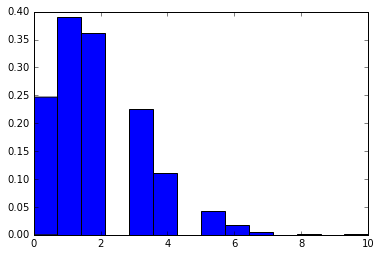

1
2
2
0
0
2
0
1
1
1
0
1
2
2
5
2
4
4
2
7
3
3
2
1
2
2
1
1
2
2
2
1
1
3
0
3
3
0
0
2
0
2
1
4
0
0
1
0
1
1
1
2
0
3
2
1
0
1
1
2
3
0
0
2
2
4
0
2
0
3
0
1
0
3
3
3
4
1
1
1
1
0
3
3
3
1
2
3
2
2
0
2
0
1
4
0
1
2
1
3
1
2
4
2
4
3
4
3
4
3
3
3
2
3
6
0
1
0
5
2
5
3
3
4
1
1
0
6
2
0
1
3
1
0
5
4
3
2
2
3
0
0
0
2
0
2
0
0
2
1
2
1
1
1
3
0
1
1
1
3
1
4
2
3
0
0
2
2
1
3
1
1
3
2
3
1
0
2
2
1
1
2
2
2
4
1
0
1
1
0
2
3
3
5
0
4
2
1
5
7
3
4
5
2
2
1
3
2
4
4
3
3
3
0
3
2
1
0
2
2
2
3
1
2
3
2
4
0
3
3
2
5
0
1
0
2
1
1
2
1
2
6
2
0
1
0
1
0
4
2
1
2
3
4
1
0
0
1
0
1
0
1
3
3
1
1
3
1
1
0
2
1
2
3
3
2
1
2
0
1
1
3
2
2
1
3
3
0
1
0
6
1
2
3
3
1
1
4
2
2
2
1
0
4
3
1
0
0
2
4
1
3
2
1
2
5
0
3
3
3
2
2
3
1
1
1
2
2
1
1
4
5
2
0
4
1
3
2
3
0
2
3
2
6
2
2
2
4
4
5
4
5
2
4
4
1
3
0
2
2
1
2
4
2
1
1
2
5
3
1
0
1
0
3
1
1
2
0
4
3
0
2
2
0
2
0
1
1
4
3
2
1
4
1
0
0
5
2
3
1
1
2
2
1
0
2
1
0
1
4
1
3
1
2
1
1
2
3
0
6
3
4
0
0
5
0
4
0
2
2
1
5
3
0
1
2
2
2
1
2
4
1
3
2
2
0
2
2
1
1
2
1
2
2
2
1
2
2
5
2
2
5
1
1
3
1
3
3
1
1
2
1
2
2
2
2
1
0
0
1
0
2
2
0
3
0
0
0
1
1
2
2
2
2
3
2
2
2
0
0


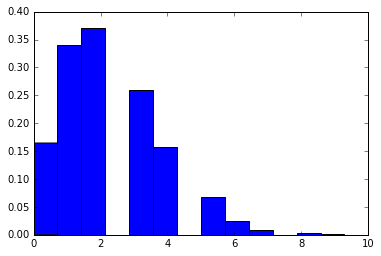

3
4
2
1
3
4
6
0
4
2
4
3
1
1
0
4
1
2
2
3
2
7
2
1
0
1
1
1
2
0
1
1
1
0
2
1
0
5
1
3
0
2
4
0
3
3
4
1
0
2
3
1
0
0
2
5
3
1
1
4
1
2
3
3
4
0
3
2
0
2
1
4
1
2
1
3
0
1
1
2
1
1
2
5
3
3
2
1
3
4
3
5
3
1
4
0
2
1
2
2
3
2
4
1
0
3
1
4
3
4
5
1
1
4
2
5
3
5
2
0
3
2
0
2
3
2
2
2
5
3
2
3
2
1
2
1
8
0
4
3
1
2
3
4
3
0
2
1
4
2
1
2
1
2
3
2
3
1
2
0
1
1
2
2
1
0
5
5
7
6
1
0
2
1
2
1
4
2
1
0
1
2
4
1
1
1
4
2
0
3
2
3
4
2
6
2
0
3
1
6
5
1
2
1
4
3
3
2
4
4
2
2
0
1
2
1
1
4
3
1
2
0
2
5
3
6
2
2
4
3
1
0
2
0
2
1
1
2
0
1
4
2
4
1
0
2
5
2
3
2
4
1
5
3
4
2
2
2
7
0
2
3
0
2
0
3
1
2
2
0
1
2
4
4
1
2
5
2
4
1
1
2
2
2
4
1
2
1
0
0
2
2
0
2
2
2
2
3
4
2
4
1
5
2
1
1
1
1
3
2
3
5
1
1
2
1
3
1
2
2
1
2
3
5
1
2
1
1
2
2
3
2
5
4
4
2
3
4
5
1
1
1
4
1
2
2
4
3
5
3
4
2
3
5
0
0
6
0
3
2
3
2
1
1
5
1
5
2
4
0
2
0
1
1
3
2
0
0
2
3
3
4
1
3
3
2
1
2
5
1
4
1
0
0
1
1
1
2
3
1
3
3
3
6
2
1
0
2
2
0
2
2
1
3
2
1
3
4
3
3
1
2
2
5
3
3
1
4
1
4
1
4
4
2
1
2
3
3
1
3
2
3
0
4
1
0
2
3
2
2
5
1
0
1
0
0
2
4
2
1
2
2
1
1
1
2
2
3
2
3
1
3
7
0
6
2
3
4
1
3
1
1
0
0
0
1
1
2
2
2
4
2
1
1
4
0
1
3
2
1


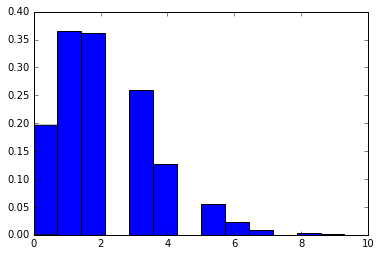

0
1
1
3
3
2
1
2
7
1
5
1
2
5
2
3
3
3
2
3
1
3
3
2
2
2
2
1
3
1
2
4
1
1
1
1
2
1
3
1
2
1
2
2
0
1
2
2
1
2
0
1
2
2
1
3
1
1
2
1
1
1
2
1
0
1
3
4
2
2
3
2
3
1
2
0
0
3
2
1
1
4
2
2
1
1
1
2
3
4
4
0
3
2
4
0
0
2
2
5
3
3
4
0
5
4
3
0
1
2
2
3
1
0
2
2
2
1
5
2
0
1
3
1
2
0
3
1
0
2
0
2
2
1
0
1
1
3
4
2
3
3
0
3
0
1
1
4
0
4
3
4
2
0
1
4
4
2
1
2
2
3
2
1
0
0
3
2
1
3
0
1
1
1
3
3
1
2
1
6
0
0
2
5
4
1
0
0
1
3
1
7
7
2
1
7
3
1
6
2
2
2
7
4
3
4
3
6
3
1
2
1
2
3
2
0
1
1
1
2
4
4
3
1
1
2
2
4
3
2
3
2
4
3
0
0
4
3
2
1
2
3
2
1
2
5
1
3
3
1
0
3
2
0
1
2
1
3
3
2
0
2
0
3
2
3
2
3
1
2
1
4
0
2
1
4
2
0
2
3
5
1
3
0
0
4
3
3
1
1
2
2
1
1
3
2
6
3
0
2
0
2
2
1
4
4
0
4
1
1
5
2
3
1
3
0
1
0
1
2
1
1
3
1
0
0
2
1
3
3
5
4
3
2
1
2
2
3
3
0
1
3
1
1
2
3
4
2
6
6
1
2
4
2
3
2
1
4
3
2
1
2
2
0
1
2
2
2
2
3
1
3
1
3
3
4
2
4
4
2
3
4
3
6
3
1
1
1
1
7
2
3
2
1
0
2
1
3
1
2
0
2
1
0
1
1
2
3
2
0
2
2
3
4
4
2
3
0
2
4
4
4
2
2
0
0
0
3
0
5
1
2
3
3
2
10
5
1
2
3
4
2
1
0
2
3
0
3
2
4
0
7
2
3
3
2
3
3
0
1
2
3
4
0
1
1
0
2
3
3
4
1
2
2
1
3
0
2
3
1
2
0
1
2
2
2
3
3
1
0
0
3
0
3
0
1
2
3
2
0

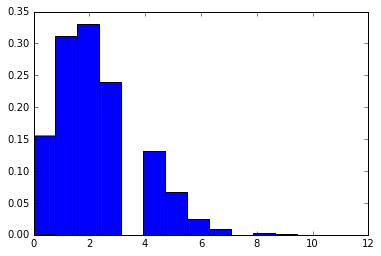

1
2
4
1
3
1
2
2
2
1
2
2
2
1
2
3
3
1
8
1
3
2
5
4
2
3
2
2
2
4
7
1
1
1
3
1
0
0
1
0
0
3
0
2
2
1
1
2
1
3
1
1
3
1
4
0
5
2
2
0
2
1
2
4
4
1
1
6
2
1
2
3
2
3
1
3
3
2
2
2
4
3
2
0
2
3
1
5
1
3
3
4
1
0
2
5
2
3
3
2
4
6
0
4
4
10
1
1
4
4
1
2
1
2
5
3
2
1
0
0
3
0
0
3
3
2
5
5
5
0
2
1
4
1
5
3
3
2
1
4
0
3
1
1
3
4
2
1
1
4
4
0
2
1
1
5
3
1
0
4
4
1
2
1
3
2
1
0
8
0
2
1
3
2
2
4
7
3
3
2
2
2
3
3
0
4
0
2
1
0
1
1
3
3
0
2
2
4
6
0
2
4
2
1
1
3
2
0
2
0
3
1
0
3
1
1
1
2
5
1
3
6
3
4
1
2
1
3
3
3
3
1
2
4
3
2
3
1
0
2
0
2
0
0
1
0
0
0
3
1
1
1
1
3
1
3
2
2
4
1
1
1
2
6
8
0
3
1
2
0
0
1
2
1
4
6
1
2
4
6
5
2
2
3
1
0
4
0
1
0
2
2
2
3
1
6
5
3
0
1
3
2
3
3
1
1
2
3
3
6
2
3
3
3
1
1
3
1
2
1
1
3
3
3
1
4
1
3
3
0
1
1
1
2
4
1
3
4
0
2
2
2
1
6
2
0
2
2
5
4
2
2
3
3
5
2
1
2
2
1
3
3
0
2
2
1
1
3
1
0
3
0
4
4
1
1
4
2
4
3
0
2
4
2
3
3
0
2
4
3
2
3
2
3
0
0
5
1
0
2
2
4
2
1
0
4
1
2
1
1
2
1
1
1
2
2
3
2
2
1
3
2
5
2
1
1
2
2
1
2
4
1
0
3
1
3
3
2
0
2
4
4
1
0
3
2
0
2
5
1
2
0
2
0
1
2
3
4
1
1
3
4
2
2
2
4
6
2
2
0
1
3
7
4
5
5
2
1
1
6
5
6
5
1
2
0
3
1
1
0
3
1
2
2
0
3
0
1
4
0

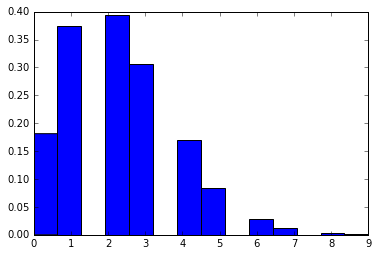

3
3
3
1
4
4
2
0
1
3
1
5
4
0
1
5
1
2
2
0
0
3
7
0
2
2
1
3
3
4
4
2
3
3
2
2
2
2
1
3
0
0
4
1
2
2
4
1
2
2
3
1
3
0
1
1
3
2
5
0
3
4
2
0
1
0
0
2
3
3
2
1
3
3
1
0
3
2
1
1
4
1
2
3
1
3
0
2
1
1
0
2
1
3
0
0
2
4
1
1
0
4
0
4
4
1
4
4
1
2
1
2
0
0
1
4
6
1
1
1
6
2
3
3
4
0
1
3
2
2
1
4
1
3
2
9
5
3
5
1
3
3
1
3
6
3
3
3
2
2
2
4
2
1
1
1
2
1
0
2
2
2
3
3
5
6
5
1
6
1
4
1
2
0
5
2
3
0
2
3
3
5
4
6
2
3
1
2
4
2
2
2
2
2
3
0
2
3
3
4
2
3
1
7
4
2
3
2
1
2
0
0
2
3
1
4
3
2
2
2
3
5
3
3
1
6
3
4
3
4
3
2
2
2
0
1
1
4
3
2
1
1
0
1
2
3
3
5
4
2
4
1
5
0
4
0
3
1
3
3
4
2
3
2
2
5
1
1
1
3
3
6
5
0
2
0
5
4
4
1
2
5
2
2
3
2
4
1
1
5
4
1
1
3
1
6
3
2
1
2
2
1
1
1
1
3
4
3
3
3
3
5
1
2
3
0
2
3
3
5
4
2
2
2
0
2
3
1
0
0
0
3
2
4
3
3
4
3
3
2
1
3
2
3
2
2
3
2
5
3
5
4
2
3
2
3
0
4
1
1
1
5
2
1
0
4
1
2
2
3
2
3
5
1
2
1
2
4
0
4
1
3
1
5
4
1
2
5
5
5
2
2
1
1
0
4
7
2
1
5
3
2
0
3
1
0
2
3
1
3
1
3
3
2
1
2
3
1
3
1
3
4
7
3
4
1
0
2
4
1
1
1
6
2
2
0
0
2
4
4
1
3
3
2
2
0
2
0
3
5
1
3
5
3
1
6
6
1
1
0
3
4
1
0
1
1
1
3
1
2
5
3
0
3
0
3
2
2
0
2
4
0
1
0
1
0
1
2
2
1
6
1
1
0
2
5
3
1
0
1


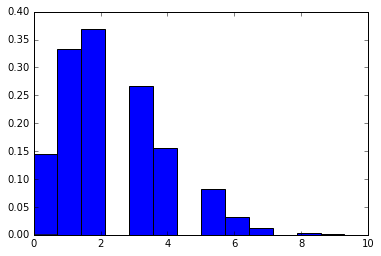

3
4
2
3
1
3
3
3
2
3
0
3
1
1
0
4
3
3
5
2
4
2
4
3
0
2
1
4
1
3
2
1
0
0
5
1
1
1
3
2
3
0
2
3
3
2
6
1
2
3
1
2
2
1
7
1
3
0
0
1
2
1
3
2
1
3
3
2
0
3
1
0
3
0
2
5
1
2
1
3
2
6
2
2
0
5
1
1
1
3
1
2
2
2
2
0
2
1
2
3
4
2
1
5
2
2
3
1
4
1
4
2
2
3
2
0
2
3
1
1
1
5
2
3
2
1
1
3
3
2
1
4
2
0
3
6
1
1
3
1
2
2
1
1
3
0
2
2
2
2
0
1
1
1
1
2
1
4
6
2
0
1
2
1
1
3
4
2
3
1
2
1
1
0
3
6
1
1
4
3
3
6
4
1
4
4
2
2
1
1
4
4
7
1
3
4
2
1
2
4
1
4
2
2
3
2
2
4
2
2
2
3
3
2
3
3
1
3
3
5
2
2
2
2
4
3
2
4
3
4
2
2
0
1
2
3
1
3
5
2
2
1
5
2
3
3
1
2
2
0
1
5
3
4
1
5
1
4
2
1
1
2
3
2
2
0
1
3
5
3
1
4
1
2
2
1
4
2
2
3
2
3
5
0
1
4
3
3
1
1
2
2
3
1
5
3
2
3
1
1
3
1
2
1
4
2
1
0
0
1
0
4
2
0
1
0
2
3
1
1
5
3
4
1
2
2
1
1
2
1
1
7
5
1
3
1
5
1
7
4
2
0
4
1
2
2
1
5
5
3
5
2
1
1
3
4
4
1
2
1
0
2
1
0
0
1
2
1
2
1
1
4
1
4
2
1
3
1
2
1
1
2
5
2
6
3
3
2
3
5
3
4
4
3
3
3
1
2
1
2
3
2
3
3
2
6
1
1
3
5
0
1
4
3
4
2
2
4
7
1
6
1
3
5
4
1
3
2
2
1
2
2
7
1
4
1
2
1
2
3
2
1
2
1
3
4
7
2
3
4
1
1
5
1
1
1
3
1
2
2
1
3
3
5
3
4
5
2
0
4
2
3
2
3
2
1
3
1
1
0
5
1
3
0
1
2
3
1
1
2
1
1
2
2
3
1
1
3
2
3


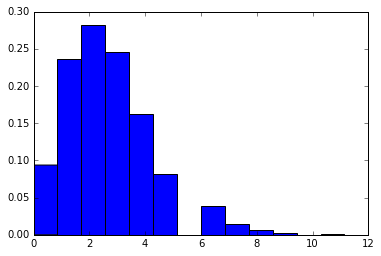

2
5
3
1
1
4
3
3
5
2
2
3
2
4
6
1
2
3
4
2
5
1
3
2
3
1
4
3
2
1
0
1
2
0
3
2
3
2
0
2
5
0
4
1
4
4
1
3
2
4
1
1
2
1
2
5
0
3
3
5
3
3
1
2
3
2
4
1
4
1
2
1
0
1
4
3
1
3
1
2
2
1
4
2
0
4
0
1
1
3
4
2
2
4
3
3
1
5
3
3
5
6
1
3
2
1
1
8
2
2
5
4
4
4
4
0
2
2
6
1
5
3
1
5
5
2
3
3
2
2
6
4
3
1
1
2
2
2
0
2
5
5
1
1
3
1
0
3
3
2
2
3
1
3
2
7
2
0
2
1
4
5
2
5
3
2
2
2
3
4
3
4
4
7
0
4
1
3
4
2
2
0
4
3
5
2
2
4
7
3
2
3
5
3
2
5
1
2
8
0
5
4
3
2
2
6
2
3
2
0
2
1
2
2
4
6
2
2
2
3
3
3
2
3
1
2
4
0
1
2
1
1
4
0
2
1
0
1
1
1
1
3
2
0
2
0
1
0
1
2
1
4
4
4
3
5
4
1
0
3
0
4
2
4
2
0
2
3
2
4
5
1
3
3
1
1
5
2
1
5
1
1
1
2
3
3
5
5
0
2
2
0
1
2
3
6
3
1
1
3
2
3
1
1
2
2
2
2
0
1
1
4
5
3
4
4
2
1
0
1
4
3
4
1
7
2
0
2
3
1
1
2
3
4
2
6
3
6
3
0
2
2
5
1
1
5
3
4
3
4
5
5
4
5
6
5
6
3
2
2
1
2
2
3
0
4
2
1
3
2
0
2
2
3
9
4
5
2
4
5
4
0
3
6
1
2
5
4
3
7
4
1
3
7
2
2
4
2
2
0
4
1
6
3
2
3
3
2
1
4
2
4
2
1
0
0
4
3
3
6
5
1
4
2
1
3
5
4
1
1
1
3
11
6
4
1
0
3
1
0
5
2
3
6
2
2
3
3
4
2
2
5
2
2
2
0
2
4
3
6
3
1
3
4
1
1
4
1
4
4
4
1
5
2
2
1
5
3
0
0
1
2
4
2
3
4
5
5
2
2
2
2
7
2
2
1
1
6
0
1

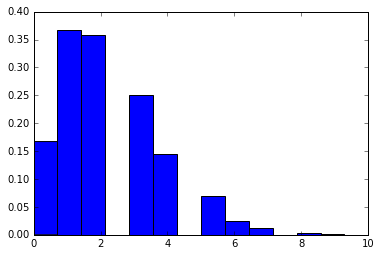

1
4
2
4
4
1
1
3
3
0
4
2
3
3
0
3
1
2
1
2
1
4
2
2
1
4
1
0
2
1
0
1
2
1
0
1
4
0
2
3
2
1
5
0
4
4
2
3
1
0
5
2
4
2
3
2
2
3
3
2
4
1
1
1
2
0
0
1
2
2
1
2
3
0
1
3
3
1
0
2
1
2
1
3
2
2
2
4
1
1
2
0
1
4
2
4
3
2
2
0
1
2
4
1
2
0
4
0
0
2
1
0
1
2
1
4
3
1
2
1
5
1
2
1
0
0
2
1
2
4
1
3
2
0
2
2
3
2
4
2
4
3
1
1
0
2
1
1
1
1
3
3
2
3
4
2
1
3
3
1
1
1
1
2
4
3
4
1
2
3
7
5
2
2
6
3
5
2
1
0
0
2
1
5
1
0
1
1
1
1
0
1
0
0
2
3
5
1
3
5
7
1
8
4
1
2
1
2
3
0
3
2
1
2
7
3
3
2
0
1
3
2
0
0
0
3
1
1
2
1
4
1
4
1
2
0
1
2
2
3
1
1
1
1
1
2
2
2
1
4
3
4
4
1
1
2
1
3
1
1
2
3
2
1
2
2
5
2
2
6
3
3
2
3
6
4
1
4
2
4
3
2
1
1
3
5
1
3
2
2
3
3
3
2
1
1
1
1
2
2
3
3
0
1
4
0
2
3
1
4
1
4
2
1
4
1
3
3
2
4
2
3
2
1
5
4
3
2
2
4
2
4
2
1
2
3
2
2
4
1
0
4
1
1
4
3
2
3
5
5
3
10
4
2
5
1
3
3
2
1
3
2
2
3
1
1
3
1
2
2
1
3
3
2
0
2
2
7
1
3
2
1
4
2
1
1
2
1
1
6
2
2
3
5
0
4
0
0
0
4
1
1
2
6
3
1
0
0
1
2
1
0
0
2
3
1
1
4
3
6
4
1
2
5
2
0
1
4
2
4
4
2
3
4
3
1
0
2
5
1
1
3
6
1
1
0
2
2
2
4
1
1
4
2
2
3
2
2
1
1
2
2
4
2
4
0
5
4
7
1
2
1
4
5
3
4
2
3
2
0
1
1
1
0
1
2
5
3
2
2
2
2
1
3
4
2
2
4
0
3

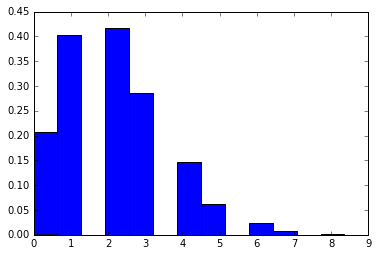

2
2
2
3
4
2
0
0
1
2
2
2
0
1
1
0
3
2
2
0
1
2
3
5
2
1
3
1
2
2
0
3
1
4
2
1
2
1
1
0
1
1
2
3
1
2
2
3
2
0
4
3
1
1
4
2
2
0
2
2
3
1
2
1
2
1
0
2
2
5
1
0
1
0
4
1
4
2
4
1
2
2
3
1
3
3
2
2
2
1
3
1
3
0
1
1
5
0
3
1
0
1
2
2
1
1
4
3
4
1
1
2
4
5
1
3
4
1
2
3
3
0
3
3
2
3
2
0
0
1
1
0
2
0
4
0
1
2
2
1
2
1
1
2
2
0
0
0
1
0
0
1
2
0
1
1
1
3
2
5
3
4
2
3
2
2
0
2
0
1
1
3
3
5
1
1
5
2
1
1
3
0
1
0
2
1
1
1
2
0
1
0
3
1
4
3
2
4
2
2
1
3
3
1
4
3
3
2
0
2
0
6
2
2
2
1
3
3
1
5
1
1
2
2
2
2
2
0
2
2
0
3
2
2
0
1
3
0
2
4
2
3
3
3
3
4
0
1
2
2
0
1
0
4
0
1
1
2
4
0
4
3
1
0
1
1
0
2
1
2
1
1
4
1
3
1
3
2
3
2
3
3
0
3
2
0
1
2
3
2
3
1
2
3
2
6
0
2
0
1
2
3
3
0
2
3
3
4
5
1
3
0
3
2
1
4
1
4
1
1
0
1
1
4
4
2
0
0
1
0
2
2
4
1
4
2
5
6
2
3
2
2
0
5
1
1
2
4
0
3
3
6
2
2
1
1
3
0
2
3
3
2
3
1
1
0
0
2
2
4
1
2
3
1
5
1
2
1
2
3
2
2
2
1
5
1
1
2
0
4
2
2
4
1
2
4
4
1
2
1
3
3
3
0
0
1
1
4
2
2
4
1
2
2
3
1
2
0
2
3
1
2
5
2
3
2
3
3
0
3
1
3
0
2
3
1
0
2
0
2
3
3
4
1
0
0
0
1
2
1
1
1
3
2
4
3
2
2
0
2
1
6
0
1
1
1
0
2
1
0
4
4
1
0
3
0
2
2
1
1
4
2
2
1
3
3
3
1
3
0
1
2
3
3
2
3
2
4
2
3


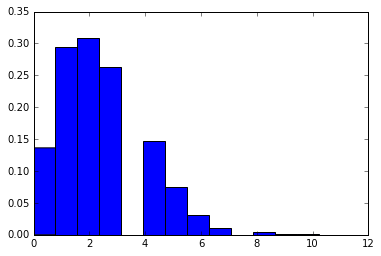

1
0
5
1
2
0
1
2
1
2
2
5
2
3
3
3
2
4
1
0
2
1
3
2
2
1
5
1
1
2
0
2
3
3
4
1
2
0
1
2
1
4
0
2
0
1
1
2
1
0
2
1
5
2
3
3
2
2
0
2
2
0
1
4
3
2
2
2
1
3
3
2
1
0
2
2
3
2
2
2
3
3
2
3
0
0
1
2
1
4
0
3
2
1
2
4
6
3
3
3
4
0
4
6
1
2
3
1
2
1
1
4
2
4
6
3
3
1
4
0
3
2
5
1
3
3
3
2
3
5
1
2
2
2
4
2
2
5
2
1
3
3
3
3
3
2
2
3
2
1
3
0
0
1
1
2
3
2
0
1
3
3
3
2
3
0
3
3
1
3
3
1
3
4
4
5
4
1
4
0
1
1
1
5
2
2
5
0
1
4
3
1
5
8
2
3
2
3
3
2
3
1
3
3
4
3
5
2
1
0
1
2
2
1
1
2
2
5
2
2
3
0
0
2
3
2
5
1
3
0
4
1
2
1
4
1
3
0
3
2
2
1
1
1
1
3
0
2
1
3
4
2
7
0
2
0
1
0
3
2
6
4
5
4
2
1
1
3
0
2
1
3
1
0
1
2
5
6
1
3
3
2
3
2
2
5
3
1
1
1
2
2
3
3
3
1
5
2
3
3
3
1
4
1
2
4
0
1
1
0
1
2
2
1
3
1
1
1
1
2
3
4
2
3
3
0
2
2
1
6
2
2
2
3
3
1
2
2
1
1
1
2
3
3
2
3
1
4
1
3
3
3
5
2
2
7
1
1
1
2
0
4
1
3
3
4
2
1
2
1
0
1
2
1
5
3
2
2
5
3
2
1
2
8
3
2
5
3
1
6
3
5
3
3
2
2
2
0
4
2
2
5
2
1
2
3
1
0
1
3
2
1
1
4
0
5
0
2
1
2
5
1
4
8
5
1
1
3
2
2
1
3
0
3
0
2
1
0
3
2
5
2
7
2
5
1
1
3
4
5
3
5
1
1
0
2
1
1
0
1
5
1
3
0
3
1
1
2
6
1
4
1
2
3
2
5
2
2
0
1
1
4
1
2
4
7
2
2
1
3
1
3
2
5
2
4
1
2
2
2


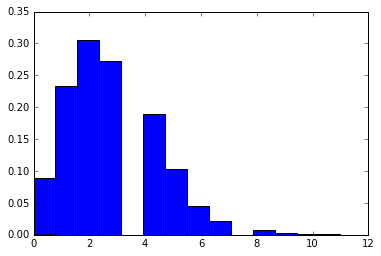

0
2
3
2
3
2
0
5
0
1
5
2
2
2
4
1
1
1
4
0
6
5
4
1
5
4
1
6
2
0
0
7
1
1
3
3
1
1
3
1
4
0
3
6
4
2
2
1
0
2
2
2
1
4
1
5
4
2
5
4
5
2
1
2
4
2
2
6
6
3
4
2
3
1
5
0
3
1
1
0
4
4
0
0
1
3
4
3
4
2
4
3
4
1
2
2
5
6
1
4
1
3
3
3
3
4
1
2
3
2
3
5
5
2
6
4
3
3
8
1
1
3
6
4
1
2
3
3
6
5
2
1
0
1
3
1
5
5
2
1
0
1
0
2
3
3
1
1
1
5
0
1
2
0
5
3
3
1
4
1
5
1
2
2
2
2
2
0
3
1
3
2
3
3
1
3
4
3
1
3
5
6
1
2
2
1
3
3
1
1
1
3
0
4
3
1
4
2
2
4
5
2
1
1
4
4
3
1
4
1
2
2
4
1
4
5
2
3
0
5
5
2
3
1
3
5
3
5
1
4
1
3
2
4
3
3
4
3
2
3
2
2
1
1
2
3
4
4
5
2
5
1
3
2
0
1
3
1
2
2
2
2
2
3
2
1
1
4
3
3
1
3
3
1
1
4
4
4
2
6
3
2
1
3
6
3
4
2
2
4
3
3
4
2
2
4
5
2
2
3
0
2
3
6
2
3
4
2
6
5
2
1
5
1
2
2
3
1
5
3
5
0
1
1
0
3
3
3
2
4
3
4
4
1
2
5
3
3
6
3
2
2
4
5
5
4
2
6
4
6
5
4
3
1
4
3
6
2
6
2
2
3
3
3
1
2
3
5
1
3
4
1
5
3
3
1
3
4
2
2
5
5
7
4
5
2
1
3
3
5
6
2
2
3
3
1
2
1
3
0
1
1
2
3
3
5
2
4
2
4
2
1
4
3
2
1
2
1
3
1
3
3
7
4
3
2
4
2
5
3
2
0
3
0
1
2
4
3
2
3
4
4
4
1
3
5
3
3
1
2
2
3
3
3
1
6
3
2
4
2
4
3
3
1
3
2
3
1
2
2
1
1
1
4
3
1
2
4
3
1
0
4
2
0
3
2
1
7
3
1
3
3
1
2
3
0
2
2
2
2


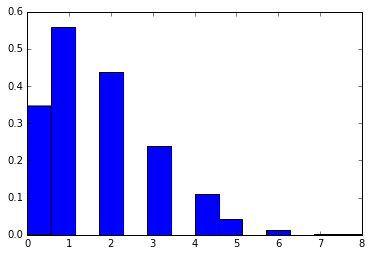

2
1
0
1
2
2
0
3
2
0
0
5
1
2
2
2
1
3
2
2
0
2
1
0
1
3
2
3
1
4
2
0
3
1
1
1
1
1
2
1
0
1
3
2
0
2
1
5
0
0
2
1
0
2
1
2
1
1
1
2
2
1
2
1
0
1
0
3
3
2
1
4
4
2
3
1
4
1
1
1
0
2
2
2
0
1
2
2
0
3
2
4
2
0
0
3
4
1
3
4
2
3
2
4
2
2
1
1
1
0
2
1
0
4
2
4
3
2
1
4
3
5
1
0
1
1
4
1
0
2
1
4
0
1
1
2
2
2
1
1
1
0
0
0
1
1
1
3
1
1
0
3
1
2
1
2
3
5
0
4
2
2
4
4
0
0
0
3
3
3
1
0
1
1
0
2
1
2
2
1
2
1
0
2
0
1
3
2
0
2
2
3
3
0
1
1
1
0
3
4
4
1
1
0
2
4
2
4
2
2
1
0
2
1
1
0
2
3
1
0
4
3
3
6
1
2
3
0
2
3
2
1
0
1
2
0
3
3
0
1
1
2
2
1
2
3
1
1
4
1
1
1
2
4
2
1
2
0
0
1
0
0
0
4
0
1
2
1
0
2
1
0
2
1
0
5
3
0
2
1
0
1
2
4
3
1
1
1
2
1
3
0
0
3
0
4
4
0
3
0
2
2
1
0
1
3
2
2
1
0
2
1
1
2
1
2
1
1
0
3
0
1
3
0
4
0
4
2
3
1
3
4
3
2
1
1
1
2
2
1
2
1
3
4
0
2
2
1
6
1
6
6
3
2
2
1
2
1
2
1
2
0
0
3
0
0
3
0
2
1
1
3
0
3
1
4
5
1
1
3
0
0
0
2
2
4
1
1
3
1
4
3
3
3
2
4
3
2
2
1
3
1
2
1
1
0
1
6
0
4
1
0
3
5
2
2
5
0
1
0
3
3
3
1
4
0
1
3
1
3
1
2
0
2
0
1
1
2
1
1
0
4
3
2
2
2
2
0
3
2
1
3
0
1
1
0
3
1
2
0
1
1
1
1
2
0
1
1
0
1
4
3
6
1
3
1
0
0
2
1
0
2
0
0
2
3
3
1
1
0
0
1
1
3
2
0
1
1
2
3


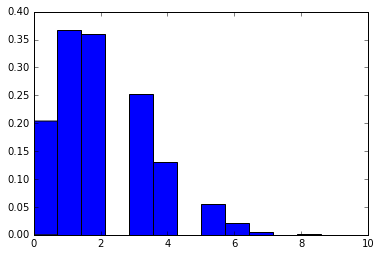

2
1
1
2
0
3
2
2
1
3
0
2
2
1
3
2
4
5
0
2
2
2
2
2
0
2
1
0
2
3
2
2
0
2
0
1
1
1
1
0
3
2
2
0
1
3
2
0
3
2
2
3
5
2
1
4
2
2
0
0
0
1
2
1
0
1
2
1
3
1
2
1
2
1
0
3
6
0
1
2
1
1
1
4
0
3
2
5
1
2
0
2
2
2
2
4
3
0
1
2
2
3
2
3
4
3
1
5
3
2
7
0
1
4
2
4
1
1
1
3
2
1
2
4
0
1
1
0
4
1
1
3
4
0
2
4
3
0
0
4
6
4
6
4
1
2
3
1
1
5
4
6
1
3
1
1
2
4
0
1
2
7
3
4
3
3
1
1
4
2
1
4
3
3
1
2
1
2
1
3
1
4
1
1
2
2
1
3
1
0
2
1
4
1
1
3
2
7
3
3
4
1
3
4
1
1
1
3
1
1
3
3
0
0
0
1
4
4
0
3
2
3
2
2
1
1
3
2
1
3
1
2
4
1
0
2
4
0
1
0
0
2
3
3
2
2
0
2
2
3
3
2
2
2
2
1
0
2
0
1
2
1
3
5
1
2
2
1
2
4
3
0
4
1
0
2
1
2
1
3
1
0
2
3
1
4
3
1
2
2
1
5
3
0
1
1
3
4
1
3
0
2
0
2
2
2
3
1
2
2
3
2
2
4
0
0
2
1
2
3
3
3
4
4
1
1
1
1
1
0
1
1
2
0
2
3
3
4
3
1
1
0
2
3
0
4
4
0
4
7
4
2
5
3
1
5
1
0
1
2
1
0
1
1
1
1
2
1
0
2
2
2
1
0
1
1
8
1
2
3
2
4
4
1
3
3
2
8
4
4
0
2
1
4
2
5
3
0
2
2
3
4
2
2
1
1
3
2
2
3
2
0
1
4
1
4
1
2
1
1
1
2
2
0
1
1
0
1
3
1
2
2
0
0
2
1
2
3
0
1
3
5
2
2
3
1
1
0
2
3
1
2
3
3
2
0
3
1
1
2
0
3
0
1
3
1
3
2
0
0
1
3
4
4
5
2
4
1
1
1
0
1
2
0
0
0
0
1
2
2
1
4
2
3
1
2
1
2
2
3


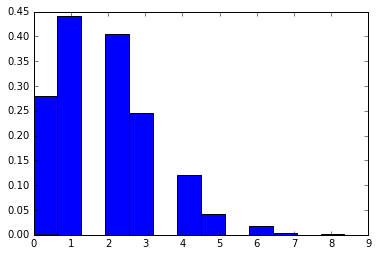

1
1
2
1
1
2
1
3
1
0
3
0
1
0
2
0
0
2
3
4
3
3
1
1
1
0
4
0
0
0
3
1
2
1
3
2
1
3
1
4
1
3
3
0
4
2
1
3
2
2
2
2
1
2
1
1
0
0
1
1
1
2
3
1
4
1
1
1
1
1
2
2
2
0
2
3
1
1
1
3
1
3
1
5
3
0
4
2
0
4
1
1
1
1
6
3
1
1
1
5
3
2
0
1
0
2
1
2
2
3
3
0
2
2
2
3
3
1
2
1
2
2
6
1
1
2
2
4
1
0
1
3
3
4
2
2
3
3
2
0
3
2
2
1
3
1
3
0
0
4
3
0
3
2
2
0
2
3
1
1
7
1
1
3
1
0
0
1
2
2
1
4
2
1
6
3
2
3
2
0
1
2
3
4
0
2
3
1
1
4
2
2
1
3
0
0
3
4
5
0
3
4
6
2
4
4
2
6
3
0
6
1
2
1
1
1
2
0
2
3
2
3
1
2
2
3
2
1
3
2
2
2
0
1
2
0
2
2
1
2
1
3
1
1
3
0
0
0
0
0
1
2
2
2
0
2
1
1
0
1
0
1
3
2
1
2
2
3
1
0
2
1
3
1
0
3
2
1
2
3
3
1
1
1
0
4
1
1
1
1
1
1
1
5
0
0
0
3
0
0
4
1
3
2
1
1
5
4
1
0
3
0
0
3
1
1
4
1
0
2
2
1
0
1
2
4
2
0
1
3
0
1
1
3
3
0
4
2
1
0
3
1
4
2
0
3
3
2
8
4
4
3
4
2
2
1
4
2
1
0
1
1
1
1
0
3
1
4
2
2
1
2
3
1
1
1
4
2
1
3
3
0
3
0
4
2
2
1
4
4
4
5
2
3
1
4
4
1
1
2
2
1
1
1
0
1
4
2
2
1
1
3
3
1
2
0
0
1
0
2
3
2
2
2
4
2
0
4
2
1
3
1
0
1
1
1
2
1
3
0
3
4
4
1
0
0
2
1
1
1
3
9
3
3
2
1
0
1
2
3
1
4
1
1
3
1
1
3
5
1
2
2
1
1
2
0
2
0
2
2
0
2
0
2
0
0
1
3
2
1
1
4
1
2
3
2
0
4
1
1


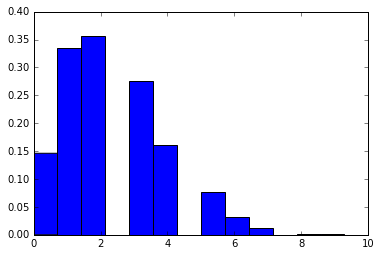

3
0
2
2
3
2
2
4
3
1
2
2
3
3
4
3
0
1
2
3
1
2
4
2
2
5
3
1
2
3
0
2
1
5
2
2
3
1
4
7
0
1
4
3
2
1
1
2
2
3
3
3
2
4
1
1
1
4
1
1
1
3
3
0
4
4
0
1
2
1
1
3
1
2
2
2
3
5
3
1
1
2
3
1
2
3
0
1
0
0
1
2
2
3
1
3
1
4
1
1
2
5
1
0
3
2
1
4
4
4
2
2
4
0
1
1
1
2
3
0
3
4
2
4
1
2
1
3
1
1
2
3
0
3
2
2
3
0
4
6
2
1
2
1
2
3
2
4
2
3
4
1
1
2
2
3
2
6
3
4
2
4
4
2
1
1
1
1
2
1
0
4
1
3
5
4
2
2
3
1
6
0
1
1
0
1
0
2
3
4
3
1
1
4
3
4
0
4
1
1
4
3
2
3
3
4
3
1
4
3
0
3
1
1
0
5
2
0
3
5
4
1
3
2
1
2
1
1
3
2
3
1
1
4
3
6
2
2
2
2
3
1
1
1
1
4
5
1
3
2
2
3
3
4
1
2
1
2
0
1
0
3
2
2
2
1
2
1
5
0
1
4
1
2
1
2
3
4
2
5
4
4
3
3
1
1
6
8
3
5
4
2
3
2
2
3
3
2
2
1
3
3
2
5
4
2
2
1
0
3
3
0
1
3
0
4
1
1
2
1
3
1
2
3
3
2
2
2
3
3
0
0
4
3
2
3
3
6
1
1
3
2
1
5
3
1
1
3
1
0
3
5
6
2
1
4
7
3
2
1
0
1
5
1
0
2
3
0
3
4
3
2
1
1
1
1
5
3
4
7
1
3
2
1
2
2
1
2
0
4
4
4
0
3
1
2
0
1
4
1
2
2
0
2
1
1
2
1
0
3
1
3
0
1
1
3
5
1
3
5
2
0
2
2
5
1
4
0
2
6
3
1
2
2
3
0
1
4
2
1
3
3
2
0
0
1
2
4
3
1
1
0
1
4
4
2
2
3
0
0
1
3
2
1
0
1
1
3
3
3
3
4
4
5
4
1
0
1
3
3
2
2
2
2
1
2
2
1
0
3
0
3
1
2
4
1
0
1
3
3


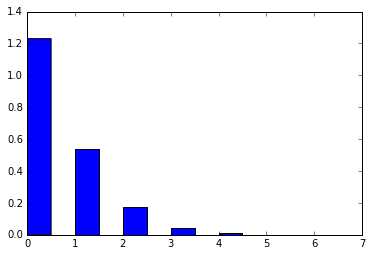

2
0
2
2
0
0
2
0
0
1
0
0
1
0
0
2
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
2
1
1
0
1
0
0
1
0
0
1
0
1
0
0
2
0
1
0
0
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
2
2
0
0
0
2
1
0
0
2
0
2
5
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
3
0
0
0
1
1
1
0
0
0
0
0
0
1
2
1
0
0
0
1
1
0
5
1
0
0
0
1
2
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
2
0
0
0
0
0
1
0
2
1
0
0
0
2
0
0
0
0
1
0
0
2
0
1
1
3
2
1
0
0
2
1
0
1
1
1
1
0
2
2
0
1
1
0
0
3
1
0
0
0
0
0
0
0
0
0
1
0
1
0
2
0
1
0
0
0
1
1
0
3
1
1
0
0
0
0
0
0
0
3
0
0
0
0
0
0
0
0
0
0
0
0
2
2
2
3
2
0
0
0
1
0
0
1
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
2
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
0
2
1
1
0
0
2
1
1
0
0
0
2
2
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
1
1
2
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
2
0
0
0
0
0
0
1
0
1
0
0
0
2
0
1
0
0
0
2
2
1
0
1
0
0
2
0
2
2
0
1
0
0
0
0
1
0
0
2
1
1
2
0
0
1
1
1
0
2
1
1
1
0
0
1
0
2
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
4
1
0
0
0
0
0
2
1
1
0
1
2
0
1
0
0
1
2
2
0
0
2
0
2
3
0
0
0
1
2
1
1
1
0
0
1
0
1
1
2
0
1
2
0
1
0
0


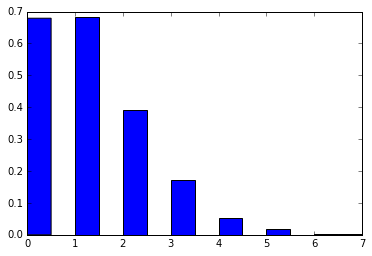

3
0
0
2
0
0
1
3
0
4
3
0
2
2
1
2
0
2
1
2
0
0
1
2
1
0
0
1
1
0
0
2
4
3
3
1
1
1
1
0
1
1
2
1
1
2
1
3
1
0
0
1
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
0
0
2
0
0
1
1
0
0
0
2
1
0
3
1
0
1
0
1
2
0
1
1
1
1
1
0
2
1
2
1
1
5
0
0
1
0
2
2
0
0
1
2
0
2
2
0
0
1
0
0
0
1
1
1
1
1
0
0
3
0
1
1
2
1
2
2
0
1
3
0
0
1
0
1
2
0
1
1
0
0
1
1
4
2
1
0
2
0
0
0
0
0
1
0
1
2
1
2
0
0
2
0
1
1
2
1
0
1
1
1
0
1
0
2
0
1
1
1
1
3
1
1
4
3
1
1
1
0
1
1
0
0
2
1
0
3
2
1
0
0
0
0
1
0
2
1
2
2
1
5
1
1
0
1
3
1
1
3
1
0
2
2
0
1
1
1
1
0
0
0
0
1
0
1
3
1
4
2
3
0
2
0
0
1
0
1
0
0
4
0
2
0
1
2
2
3
0
0
1
3
2
0
1
0
3
1
1
0
0
0
1
1
2
1
1
1
2
3
0
0
0
0
0
1
0
0
0
3
0
0
2
2
4
6
1
1
2
3
0
4
1
1
0
1
1
0
0
4
1
2
1
1
1
1
0
0
0
2
1
1
1
1
1
1
1
1
0
0
2
0
2
1
0
0
1
1
0
1
0
1
0
0
2
1
3
1
0
1
0
1
2
1
1
1
5
0
0
1
0
1
3
1
1
2
3
0
0
0
1
1
2
2
2
2
0
2
2
2
2
2
1
0
1
2
0
2
0
2
2
2
1
0
4
2
0
0
0
0
0
1
1
2
3
1
0
0
2
0
0
2
1
0
1
2
1
0
0
0
1
2
0
3
0
1
1
2
0
0
0
2
1
0
2
2
1
2
1
1
1
2
1
1
0
1
3
1
1
0
1
0
3
1
0
2
0
1
0
0
2
2
2
1
1
2
1
0
2
1
1
0
2
0
1
0
1
0
1
2
2
3
1
1
2
3
3
2
1
1
0
0
1
1


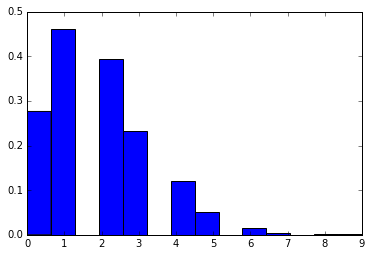

2
5
5
2
2
0
1
9
3
4
2
1
0
3
1
1
2
2
2
1
2
2
2
1
0
3
2
2
1
1
0
1
4
1
0
1
0
0
2
1
0
0
2
2
0
6
0
2
1
0
1
2
2
5
0
2
0
1
3
1
2
3
0
3
1
5
0
0
1
1
2
2
1
2
4
4
3
0
1
3
1
3
0
2
4
1
2
2
0
0
2
0
1
1
2
1
3
1
2
0
4
1
2
2
1
1
3
4
1
2
1
2
3
1
0
1
2
2
2
2
4
1
4
2
2
1
3
0
1
1
2
2
0
4
1
3
2
2
3
2
1
1
3
3
4
1
2
1
1
2
3
1
3
2
1
1
2
3
4
3
1
3
2
0
3
0
1
1
2
3
2
2
2
3
0
3
2
2
0
1
3
4
1
2
2
0
2
2
1
2
1
0
2
3
2
2
1
1
1
1
2
3
2
4
1
3
2
5
0
2
0
0
0
2
2
1
1
1
3
2
1
1
5
0
2
0
2
0
1
1
0
0
3
2
3
1
1
2
0
1
1
2
4
3
0
2
4
1
2
3
2
1
1
1
2
1
1
3
3
0
1
3
3
1
1
1
1
4
1
0
2
0
1
3
0
1
0
0
0
2
1
1
3
4
2
3
1
0
3
3
2
1
4
0
2
3
1
2
2
0
3
1
2
3
2
2
0
2
1
0
1
2
6
2
1
2
4
1
1
0
2
2
2
2
2
0
5
4
2
1
0
1
3
0
1
1
1
1
4
1
3
6
1
4
3
3
3
2
2
1
1
2
3
4
1
0
0
8
1
5
2
0
2
0
2
2
2
0
1
3
2
0
0
1
0
3
2
2
2
4
5
2
2
3
2
3
1
2
3
2
2
4
0
1
2
3
1
2
2
2
3
2
0
2
6
4
1
1
3
4
0
2
3
3
2
1
1
3
5
1
4
3
1
3
1
2
2
1
0
2
2
0
0
0
4
5
1
2
1
4
2
1
2
0
0
3
0
1
5
2
2
2
3
1
1
3
1
3
1
3
1
2
5
1
2
2
1
1
0
2
1
3
2
0
1
2
1
3
4
4
0
1
2
5
2
1
5
1
3
5
4
3
0
6
2
1
1
1
0
1


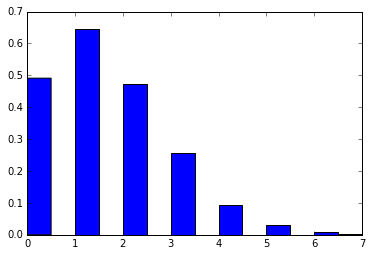

2
2
3
2
3
0
2
0
1
0
1
3
1
3
0
5
1
0
1
1
2
2
0
1
2
1
1
1
1
1
0
1
4
1
2
1
2
1
1
3
4
1
1
1
2
0
2
3
2
2
2
3
3
1
3
2
0
2
1
3
3
0
1
1
0
4
0
1
2
0
0
0
1
1
3
2
2
1
2
2
1
0
0
3
4
1
1
0
1
1
0
0
1
3
0
3
2
3
3
3
0
3
4
2
3
1
1
1
0
2
1
2
0
0
1
1
1
3
0
1
1
3
0
0
0
1
0
2
1
2
2
2
3
1
3
2
2
0
1
0
0
4
2
1
2
0
1
0
1
2
1
1
3
1
0
1
1
2
7
0
3
3
1
1
0
2
4
5
2
3
2
0
4
1
0
0
2
1
1
1
1
1
1
2
1
1
4
2
3
3
1
2
2
3
5
1
1
1
4
1
1
1
2
1
1
0
1
1
0
0
1
0
2
2
1
0
0
2
2
1
1
0
0
1
3
3
3
1
1
3
0
1
0
2
0
0
3
0
1
1
0
1
0
2
3
0
0
1
1
4
3
2
0
0
1
2
1
1
3
1
2
2
0
0
0
0
2
3
0
1
1
1
1
0
2
1
1
0
0
0
3
2
2
3
5
0
1
3
0
1
2
2
0
3
0
0
0
1
3
4
2
2
2
2
2
2
1
3
4
1
1
2
2
4
5
3
1
3
6
3
1
3
1
2
2
2
3
1
0
2
0
2
0
2
1
4
0
0
0
0
1
1
1
1
1
2
0
3
1
0
3
1
0
1
2
1
1
3
1
2
1
1
1
1
3
2
2
1
0
2
3
2
3
1
2
0
1
0
2
0
2
0
2
1
2
1
0
0
3
1
0
2
0
2
0
4
0
2
1
2
1
1
1
1
3
2
0
0
1
2
3
3
0
3
1
2
2
2
4
1
2
2
2
2
2
2
1
1
0
0
0
1
0
3
1
1
2
1
1
1
2
0
1
1
2
1
1
1
2
3
2
1
2
1
1
3
2
1
3
0
1
3
1
2
1
3
2
1
0
0
1
3
1
0
3
3
2
2
0
0
0
1
2
3
1
2
2
1
3
0
1
1
1
3
0
2
2
3
1
0


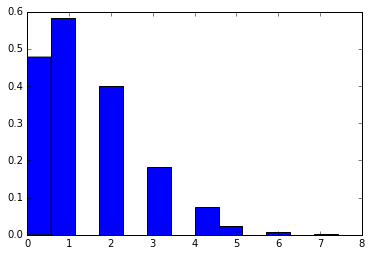

2
0
2
1
2
1
1
1
1
4
0
0
2
5
0
2
1
1
2
3
3
2
0
0
3
2
1
1
1
0
1
1
1
1
1
2
2
0
0
1
2
0
0
0
0
2
0
1
1
0
3
3
0
1
0
1
1
0
3
1
1
1
1
0
4
0
4
0
2
1
5
1
2
1
0
1
3
1
2
1
2
4
1
0
2
1
2
0
0
1
0
1
0
2
2
2
3
0
2
2
1
1
3
0
4
1
0
3
1
1
0
3
2
2
2
1
1
3
0
0
0
0
0
0
0
2
2
3
0
3
0
5
3
0
0
1
0
2
2
2
0
0
1
0
1
2
0
2
3
4
1
1
2
1
3
1
2
1
0
2
6
1
2
2
0
0
3
2
3
3
1
1
2
0
1
1
2
1
0
0
1
2
2
0
2
1
0
5
0
1
2
3
0
1
2
2
5
1
2
0
1
0
2
1
1
2
3
0
0
6
0
0
0
1
1
1
1
0
1
2
0
2
0
0
2
1
0
1
0
1
1
3
3
1
1
1
0
1
1
0
1
2
2
1
1
0
0
3
3
0
0
1
2
4
0
1
1
2
2
0
0
0
1
2
1
4
1
4
1
1
0
1
1
5
2
0
2
0
2
1
1
3
3
2
1
1
0
1
1
0
1
1
1
1
1
3
1
2
0
0
2
3
1
0
4
0
0
2
0
5
1
0
1
1
0
4
0
0
0
0
0
1
1
0
0
1
1
0
0
1
0
1
0
1
3
2
5
3
3
0
1
5
1
0
1
1
0
6
1
0
2
0
2
2
0
1
2
1
0
1
2
0
1
2
2
0
0
1
0
1
1
0
1
3
0
1
1
0
4
1
0
0
2
1
2
2
1
0
2
0
1
2
1
2
3
1
3
1
1
1
2
1
1
0
1
1
1
0
2
1
0
2
3
3
2
2
1
1
0
1
0
2
0
2
1
2
1
1
1
1
1
0
0
1
0
0
1
0
1
1
2
1
1
1
2
0
5
1
2
1
0
5
1
3
2
2
0
2
1
2
2
4
3
3
2
4
4
1
0
1
0
0
0
2
0
5
4
3
3
1
0
2
1
1
2
5
4
4
4
0
0
4
1
0
2
0
0
0
3
0


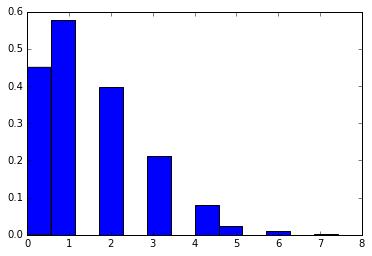

4
0
0
3
0
2
3
3
3
0
1
0
1
3
0
2
1
0
1
1
1
2
0
3
2
0
2
1
2
1
4
2
4
1
4
0
2
3
4
1
2
2
2
1
0
0
0
1
1
3
4
1
1
2
1
0
3
1
3
0
2
2
1
0
1
0
2
0
0
0
1
0
5
2
2
0
1
3
1
0
3
3
2
0
5
0
1
1
0
0
1
3
0
2
1
2
1
1
4
0
3
3
1
2
3
3
0
1
0
0
1
3
1
1
0
2
2
4
2
2
2
0
2
0
0
3
3
2
6
3
1
0
4
5
2
4
1
0
2
1
3
2
3
1
1
0
2
5
3
2
5
0
1
1
2
2
1
2
1
2
1
1
3
1
1
2
3
2
2
1
1
1
0
5
0
2
0
2
1
0
1
4
3
0
2
2
2
3
1
3
2
3
1
0
1
1
1
2
1
2
4
0
3
0
0
0
0
0
1
0
0
0
3
1
1
0
0
1
2
0
0
4
2
1
0
0
0
0
1
0
1
3
2
0
0
2
1
3
1
1
2
0
1
2
0
1
1
2
2
4
3
2
1
2
0
0
0
2
0
2
1
0
2
6
3
2
0
3
0
1
0
0
0
0
0
3
1
4
1
3
1
1
1
1
2
0
0
1
0
1
1
2
0
1
1
0
3
1
0
1
3
4
2
1
3
1
2
3
3
3
1
3
1
1
4
0
1
2
1
3
3
2
1
0
1
1
1
3
3
1
0
0
2
6
3
1
1
1
0
2
0
2
3
2
0
3
3
0
1
1
2
1
2
1
0
1
1
2
3
0
2
2
0
0
1
0
2
1
1
2
0
0
2
0
1
0
0
2
6
1
0
1
0
0
0
3
3
2
1
0
1
2
2
3
1
2
1
1
0
3
2
2
1
1
1
3
1
2
0
4
3
4
2
1
0
0
0
0
0
2
2
4
3
1
1
3
3
0
0
2
3
1
2
0
2
2
1
0
0
1
0
0
0
3
3
0
1
0
1
0
3
1
4
0
1
2
1
1
3
3
1
2
2
4
1
0
0
3
2
1
2
2
0
4
2
1
1
4
1
0
0
0
0
3
3
0
0
4
1
2
0
0
1
1
1
1
1
2
2
0


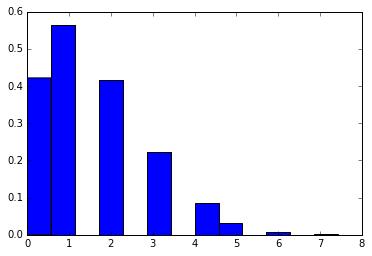

1
2
5
5
2
2
3
2
2
2
3
0
2
0
2
0
1
2
0
0
3
3
2
1
1
1
2
2
0
2
4
2
0
1
0
1
1
2
2
1
2
2
2
1
1
0
0
1
1
0
5
3
0
0
2
0
0
1
1
1
1
2
0
0
0
1
3
0
1
1
0
3
1
1
2
1
2
2
3
1
1
0
2
3
3
2
1
1
1
0
0
1
2
1
1
1
1
2
2
2
1
1
0
2
2
1
0
0
3
2
2
0
2
0
0
2
2
2
1
2
1
1
0
2
0
1
1
0
2
0
5
2
2
2
2
3
1
1
3
0
1
0
0
1
2
0
2
1
0
3
1
2
1
1
2
2
1
3
2
0
2
2
0
2
1
0
4
4
5
2
0
4
2
0
2
2
3
1
1
3
2
1
1
1
1
0
1
0
0
2
3
1
0
0
1
1
0
1
0
3
2
1
1
2
0
0
0
0
1
1
1
0
0
0
2
2
0
2
1
1
2
2
3
1
1
0
1
3
3
0
1
1
1
2
2
0
0
1
0
0
1
2
0
1
3
0
1
1
3
3
1
2
2
3
2
2
0
1
1
2
1
1
0
0
1
0
3
4
1
4
4
0
3
2
3
2
4
2
2
2
1
1
0
0
1
0
5
2
1
1
2
1
1
0
3
2
1
0
2
0
2
3
1
1
2
1
0
2
2
3
2
0
0
2
1
2
0
1
3
2
1
0
1
1
1
1
1
0
2
2
2
1
2
3
3
1
3
0
3
0
0
2
1
0
2
3
0
2
1
1
1
0
0
1
0
3
6
2
4
1
2
1
1
1
1
2
3
1
0
1
1
3
2
0
2
0
2
1
1
3
1
3
0
0
4
4
2
1
1
1
3
2
3
0
2
4
1
0
1
1
0
1
0
0
0
0
1
1
2
0
2
3
5
1
4
1
1
2
1
2
2
0
0
2
1
4
2
2
0
0
0
5
4
2
0
0
2
0
1
2
2
0
1
0
0
2
1
1
2
1
1
5
2
0
0
5
4
5
2
3
3
3
2
2
1
2
0
0
3
1
0
3
2
1
2
1
2
2
1
0
2
2
2
2
3
2
2
1
4
0
1
2
2
1
2
2
3
2
2
3


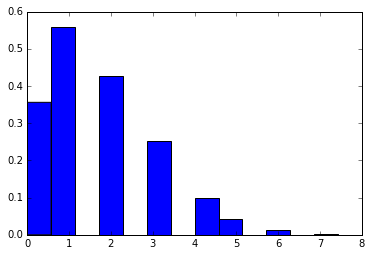

4
0
0
2
5
3
0
3
1
2
2
1
0
1
0
2
3
4
2
2
0
1
2
3
1
1
1
4
1
0
1
0
1
1
2
0
0
3
3
0
3
3
2
1
0
2
3
1
2
2
1
1
0
6
3
1
2
2
2
2
1
0
1
3
2
1
2
3
2
0
0
1
0
1
2
0
1
3
4
4
4
0
7
4
3
2
1
1
1
0
0
1
2
1
3
0
5
1
3
0
1
3
0
2
4
1
3
3
2
2
1
2
0
0
2
1
1
0
4
4
0
1
1
0
0
2
4
2
1
1
2
1
2
2
1
2
2
3
2
2
0
3
0
0
0
1
0
0
0
1
1
2
2
1
1
1
2
3
0
0
2
2
2
2
1
0
1
6
3
3
2
2
0
1
3
2
1
2
1
2
1
0
1
4
2
2
2
1
1
0
2
0
1
3
2
1
2
0
2
3
1
1
2
3
1
0
1
0
0
1
0
2
1
0
3
1
0
2
1
0
1
5
3
2
3
4
0
0
1
1
0
1
0
2
1
1
0
2
3
2
3
3
0
3
2
0
3
0
0
4
1
1
1
1
1
2
2
3
2
3
2
2
1
2
0
3
0
2
1
0
0
0
2
3
1
2
2
3
0
2
2
0
2
3
0
4
2
3
0
4
4
3
4
0
3
0
0
1
0
4
2
1
0
1
1
1
1
1
1
3
0
2
1
1
3
0
1
1
1
2
1
3
2
3
4
1
3
1
2
1
0
1
1
2
2
0
1
4
1
2
0
1
1
2
1
0
0
1
1
3
1
2
1
2
2
2
1
2
5
2
2
1
1
3
1
0
1
1
2
1
2
1
2
1
3
0
0
0
2
1
0
1
3
1
4
2
1
4
1
2
1
0
1
1
3
2
2
3
2
2
2
3
0
1
1
2
2
0
3
2
0
0
1
1
2
1
2
2
1
1
1
0
1
0
1
5
0
1
2
0
1
1
0
3
0
5
1
0
1
0
3
1
1
1
2
3
1
1
3
1
0
3
3
1
1
1
3
3
4
0
4
3
2
1
1
0
1
2
4
2
2
2
3
2
2
3
0
1
1
1
0
0
1
3
2
1
2
0
1
0
1
3
3
3
1
3
1
3
1
1


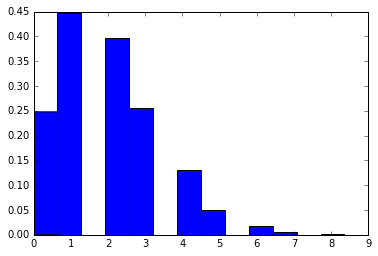

3
3
1
2
1
3
2
3
1
2
1
2
1
1
1
1
1
2
1
2
1
1
1
2
1
1
0
1
0
0
1
1
1
5
3
1
3
2
3
2
3
2
0
2
3
2
0
4
1
7
2
0
0
0
4
2
1
1
0
3
1
0
3
3
1
2
2
0
1
1
1
1
1
2
0
0
0
0
2
4
1
3
0
3
2
2
3
1
0
0
2
0
1
2
0
1
2
2
0
4
3
3
4
4
2
6
0
1
3
1
1
3
2
3
1
4
2
2
4
3
2
2
0
0
2
2
3
2
4
2
6
2
5
2
2
1
0
3
1
1
2
3
1
5
4
2
2
1
3
3
4
0
0
1
3
1
2
1
4
1
1
1
4
1
2
2
2
1
3
5
2
2
1
2
0
4
2
0
3
1
0
2
1
4
4
1
1
1
3
7
1
4
0
0
5
3
1
1
1
8
2
1
4
5
2
0
2
2
2
1
1
2
2
2
3
3
0
2
3
2
1
4
1
5
0
2
2
1
2
4
0
1
4
4
1
4
0
0
4
2
1
2
0
0
0
1
1
3
2
0
5
1
1
3
0
2
3
0
4
4
1
4
3
1
6
3
1
2
0
0
0
1
1
1
3
2
1
1
2
1
1
0
2
1
1
0
1
4
1
6
0
3
0
4
2
5
0
0
1
1
1
2
6
2
2
2
0
3
3
3
1
1
2
2
1
1
2
3
2
3
1
1
2
0
0
5
1
0
3
0
2
1
1
3
2
1
1
0
0
1
1
5
2
3
2
4
2
3
2
1
0
0
4
2
3
2
1
0
1
1
1
0
2
2
2
2
0
3
0
0
3
1
2
1
1
5
3
2
0
1
1
2
2
2
4
0
2
3
1
2
8
0
2
3
3
2
1
2
3
0
5
2
0
1
2
1
0
2
3
3
1
5
2
0
2
2
1
4
2
4
1
2
2
1
2
2
1
1
2
3
1
1
1
2
2
1
1
2
1
3
2
2
3
1
2
1
0
2
3
0
0
4
0
2
0
1
2
3
3
2
3
2
3
3
0
2
2
4
2
3
7
1
1
4
2
5
2
1
5
0
1
1
4
1
4
1
3
5
1
3
4
0
3
2
2
2
1
3
0
2


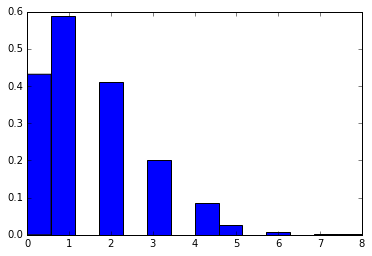

2
3
1
0
0
0
2
0
3
1
4
1
2
2
0
1
1
1
2
0
1
2
4
1
1
1
0
2
2
3
0
4
0
2
2
2
4
2
2
1
0
1
0
3
1
1
0
1
3
3
0
1
2
1
0
1
2
2
2
2
1
1
1
4
3
3
0
2
0
2
0
0
0
2
0
1
2
1
2
4
0
1
2
4
2
2
0
0
0
0
1
3
0
0
0
5
3
4
1
3
0
1
0
0
1
2
2
1
2
6
1
4
2
2
0
0
3
1
0
1
0
1
0
3
1
1
1
6
2
1
2
3
0
0
0
0
3
3
1
3
1
4
1
1
1
1
0
2
0
0
3
2
0
4
3
0
2
0
1
2
2
0
1
4
2
1
1
2
2
2
1
1
0
3
3
0
1
2
2
0
0
1
0
1
0
0
0
1
1
1
1
1
2
1
0
3
0
1
2
1
1
1
2
1
0
1
1
0
0
0
2
2
1
0
0
0
2
1
1
2
1
1
2
0
0
2
0
1
2
2
1
1
3
4
2
0
2
1
0
0
0
0
0
1
5
2
0
1
2
3
4
3
1
1
1
3
0
2
1
2
1
0
2
0
3
1
2
0
0
2
1
1
1
0
2
1
1
1
1
2
0
2
2
2
2
2
2
2
2
3
2
1
0
0
1
0
1
1
1
2
1
1
1
2
1
0
2
1
2
0
1
3
0
1
2
1
3
1
4
4
1
2
2
3
2
1
1
2
0
0
1
0
2
0
1
2
2
3
1
2
0
2
1
2
0
1
3
1
1
1
0
1
2
2
2
2
2
0
2
2
2
1
2
2
1
2
2
2
1
1
1
1
0
1
0
0
2
0
0
0
1
2
0
0
1
3
1
0
0
2
3
2
2
4
3
5
1
2
0
0
2
0
1
4
0
0
2
0
0
1
3
3
4
1
1
3
0
2
2
1
0
4
1
2
1
2
2
2
1
1
4
3
0
0
1
2
1
0
2
2
2
0
1
2
0
2
1
1
1
0
2
1
1
0
1
0
0
0
1
3
2
1
3
2
0
2
4
0
3
1
1
0
2
1
1
0
1
3
3
0
0
0
1
1
2
0
1
1
0
1
1
2
0
1
0
2
0
1
3
4


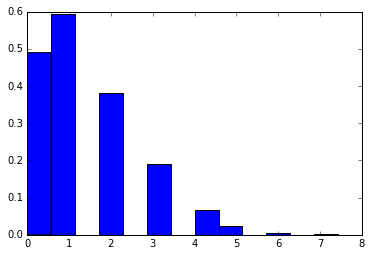

4
3
1
2
4
1
4
1
1
0
1
1
0
4
7
1
0
0
3
2
1
1
2
0
1
0
0
5
1
0
2
2
4
2
0
3
1
0
1
0
4
1
1
3
0
0
1
2
1
1
4
2
2
1
3
2
3
3
0
5
1
1
2
1
0
0
2
0
1
0
0
2
0
0
0
0
1
1
3
1
1
1
0
0
2
1
0
0
2
0
3
2
0
0
0
2
2
2
1
3
1
1
3
0
0
0
3
4
1
0
1
2
1
4
1
1
5
1
1
2
0
0
3
1
0
0
4
1
0
1
0
2
3
1
2
1
1
0
2
1
3
1
0
2
2
0
3
0
1
2
2
1
2
3
0
3
2
3
3
2
0
1
4
0
0
0
0
0
2
1
0
1
1
2
0
0
0
1
1
1
0
1
0
1
0
2
1
1
1
0
2
0
2
1
1
0
1
1
0
1
3
2
1
0
1
0
0
0
0
1
3
2
1
3
3
0
1
3
0
5
0
1
1
1
2
3
0
1
1
0
1
3
4
0
1
0
0
0
0
3
2
0
0
2
0
0
0
1
1
5
1
1
0
2
1
1
2
2
1
0
1
0
1
2
1
1
0
1
1
1
1
0
1
0
3
3
1
2
2
0
1
0
2
5
2
1
2
1
1
0
0
1
0
0
0
4
1
0
2
0
0
0
5
0
1
2
0
2
1
0
1
1
3
1
0
1
3
3
0
1
3
2
2
1
1
1
3
2
1
1
0
0
3
2
1
2
3
0
4
1
2
3
1
1
1
0
0
0
1
1
0
0
0
1
1
1
2
1
2
0
1
0
2
2
0
1
2
0
4
1
0
1
1
2
1
0
1
1
1
1
4
2
0
1
2
3
1
0
0
0
0
4
3
1
0
1
1
0
4
0
0
0
3
2
1
1
0
0
2
1
1
1
0
0
0
0
3
1
0
2
3
0
1
1
3
2
3
1
1
1
0
3
1
1
0
2
1
1
2
1
0
1
1
2
1
3
2
3
2
1
0
3
1
2
3
1
1
0
0
0
1
3
1
2
1
3
1
1
1
5
1
2
3
1
1
1
3
1
1
1
1
0
2
0
2
1
1
0
2
0
0
3
0
0
2
3
5
1
0
1


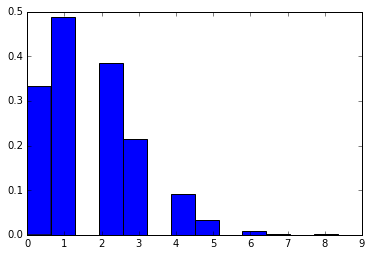

1
5
0
2
0
1
1
0
3
0
0
1
1
2
2
1
1
0
2
4
4
0
3
2
2
3
4
3
3
0
1
1
0
0
2
2
2
0
1
1
2
1
0
2
5
0
3
2
1
1
3
0
1
2
3
1
1
1
3
2
1
3
0
1
1
3
2
1
3
2
2
4
1
2
3
0
2
1
2
1
1
1
2
1
1
1
0
0
1
4
2
2
1
1
3
1
7
1
3
3
2
5
6
2
1
2
1
3
2
0
1
0
1
1
4
0
2
0
1
1
3
1
2
2
3
3
4
1
2
4
2
0
3
2
1
3
0
3
0
5
2
0
1
2
1
3
1
0
1
2
2
2
0
0
4
2
0
1
1
1
2
1
2
2
2
1
3
2
2
0
2
1
2
3
1
1
2
2
1
2
4
3
1
2
0
0
5
0
2
0
3
2
1
1
1
0
2
2
2
1
2
0
1
2
1
1
1
3
0
3
0
2
1
2
1
2
0
0
4
0
2
5
1
5
1
3
2
1
3
3
5
1
1
0
3
0
1
0
2
1
1
1
0
0
2
3
1
5
1
2
3
1
0
0
3
2
2
1
5
0
3
0
2
3
1
4
0
2
0
1
1
0
0
1
1
2
3
1
2
2
2
2
0
0
1
0
2
3
2
1
2
2
3
1
3
1
0
1
4
0
2
2
0
1
1
1
2
2
2
2
1
1
1
1
3
2
3
1
2
2
1
0
2
2
2
1
0
1
0
1
0
0
1
0
1
2
5
1
1
2
1
2
2
2
0
3
0
1
3
1
3
4
1
3
1
2
3
0
2
2
0
1
0
1
2
0
1
0
0
1
0
3
1
0
0
1
3
0
2
2
4
2
3
2
1
1
1
5
2
1
3
4
3
2
2
1
0
1
3
2
4
1
2
3
1
1
3
2
2
1
1
0
2
4
0
3
1
5
0
0
0
1
1
3
0
3
2
0
2
1
1
2
0
2
2
3
2
2
0
3
0
1
2
6
3
1
2
2
2
2
0
0
1
0
1
2
0
2
1
1
3
5
1
1
0
2
0
0
1
1
1
1
2
2
2
2
0
0
0
3
1
2
3
0
3
1
0
3
2
2
1
1
0
1
5
1
1
3
2
2


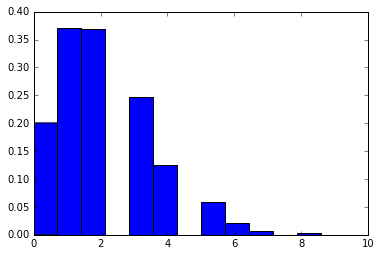

1
1
1
1
4
2
2
2
3
3
2
0
1
1
2
1
0
1
1
4
1
2
3
1
3
3
2
0
1
1
0
2
2
0
2
0
6
3
3
3
1
3
1
1
3
1
2
2
1
3
2
1
3
1
3
1
1
3
4
0
2
1
0
1
3
1
1
4
2
2
3
1
1
1
0
2
2
1
1
3
6
3
0
3
5
1
3
2
2
1
5
0
1
3
1
2
2
1
3
3
1
1
3
1
5
4
3
1
2
0
1
5
2
1
0
2
2
3
2
1
3
2
0
3
2
1
2
6
0
3
2
4
2
4
2
1
0
6
2
3
2
4
0
0
1
4
4
1
5
0
2
0
4
0
4
2
1
0
4
1
0
2
1
3
3
0
1
1
2
2
2
1
2
1
0
1
1
1
1
0
3
1
1
2
4
3
2
3
3
1
1
0
1
1
1
5
1
0
0
2
3
2
0
1
2
2
4
0
2
2
3
3
2
2
1
0
0
1
1
0
1
0
2
2
1
0
1
1
0
2
1
3
1
2
3
1
1
0
1
1
5
2
3
3
2
3
4
0
4
2
0
1
0
2
2
1
1
2
3
1
1
0
2
3
0
2
1
1
0
3
1
2
1
0
2
2
2
2
2
0
2
3
0
2
1
3
3
1
1
1
4
2
1
2
3
2
3
3
1
2
0
3
2
4
1
1
2
2
3
0
1
0
1
1
1
3
4
2
2
1
2
3
2
2
0
4
2
0
1
2
0
4
1
3
0
2
4
1
2
2
2
3
5
3
4
1
0
1
1
1
1
4
1
0
0
0
1
1
3
3
1
0
1
0
1
4
3
2
2
1
2
3
6
6
2
1
2
2
2
5
4
2
1
3
5
3
5
3
4
4
1
3
1
4
1
1
1
4
2
1
0
6
1
5
3
1
2
2
2
5
3
0
3
2
0
2
5
2
3
1
1
1
1
2
5
3
0
2
0
2
2
0
2
3
1
2
0
3
2
5
2
3
2
3
2
1
3
1
2
0
0
2
0
2
2
2
3
1
0
1
1
6
1
3
0
3
3
4
2
5
2
2
2
6
1
1
1
4
4
3
1
2
1
0
1
2
5
2
1
3
2
2
3
5
1
3
2
3
2
2


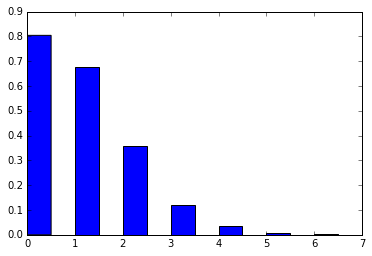

1
3
0
1
3
1
3
1
0
1
0
0
0
0
0
2
2
1
0
0
0
0
1
2
1
0
2
1
1
3
1
4
2
2
2
1
1
0
0
0
0
0
0
0
0
0
2
2
1
1
0
1
0
1
1
1
1
3
2
1
1
0
1
0
0
1
0
1
0
3
0
1
2
0
0
0
4
1
0
0
0
1
1
0
1
0
1
1
0
0
0
1
0
0
0
1
0
1
1
1
0
0
1
0
1
1
1
0
1
1
0
1
0
0
2
3
1
2
1
1
1
1
0
2
4
2
0
0
1
1
3
1
0
1
0
1
1
2
2
1
1
0
1
0
0
1
1
1
1
0
0
0
1
1
1
4
2
0
1
0
0
1
2
1
1
0
2
1
2
0
2
1
0
1
0
0
0
0
0
0
0
0
0
1
3
1
2
3
2
0
4
1
0
1
1
1
4
0
2
1
1
4
1
2
1
0
0
0
1
1
2
1
0
0
0
1
2
0
1
0
1
0
1
2
2
1
1
0
0
3
2
0
2
3
1
1
1
0
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
1
0
2
0
2
2
0
0
1
0
3
3
1
1
2
1
2
1
0
1
2
2
0
0
2
0
2
0
2
0
1
0
3
2
1
1
2
0
2
0
0
0
3
1
1
2
2
0
0
2
1
0
2
0
0
1
0
1
1
1
1
0
1
2
1
2
0
1
1
2
2
0
0
0
1
2
1
0
0
0
2
0
2
0
0
0
0
1
0
0
1
1
1
0
0
0
0
1
1
2
1
1
0
0
1
1
3
0
0
1
0
3
2
0
0
1
0
1
0
2
1
1
0
1
0
2
0
1
3
1
3
1
0
1
2
0
0
0
0
0
1
2
0
0
2
5
0
2
1
2
1
1
0
0
0
2
0
2
0
1
1
1
2
1
2
1
2
0
1
2
1
2
0
0
0
0
3
2
0
0
0
0
2
2
2
0
1
2
1
0
0
1
2
0
3
0
1
0
0
2
2
1
2
3
3
0
1
1
1
4
1
0
1
0
0
3
1
0
3
1
3
0
1
1
1
2
0
0
0
1
2
5
3
0
3
3
0
2
0
2
0
3
0
0
1
2
1


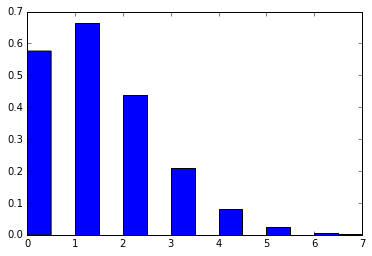

3
1
1
0
1
0
2
3
0
1
1
1
2
1
3
1
1
0
3
0
1
1
0
2
0
0
0
1
3
1
0
2
1
0
3
0
0
0
0
0
1
1
0
1
0
1
1
0
1
2
2
0
1
4
2
1
0
0
0
0
0
0
0
2
0
0
0
1
1
1
1
0
2
0
1
1
1
0
3
0
0
2
1
1
2
0
1
3
1
0
1
0
0
1
0
2
3
2
0
0
1
3
1
2
2
1
2
1
3
1
1
3
0
1
2
3
0
0
2
2
3
1
0
1
2
1
1
3
1
1
2
2
4
1
2
5
0
0
1
1
3
2
2
2
2
0
0
1
3
1
2
1
3
2
3
1
3
2
2
2
3
0
1
2
1
2
2
1
4
1
2
2
3
0
1
2
0
0
2
2
1
1
3
1
1
1
2
0
1
1
0
2
2
2
1
2
1
1
3
1
2
3
1
1
1
1
0
0
0
1
1
4
0
2
1
0
1
0
1
1
0
0
5
0
1
1
2
0
1
0
3
1
2
2
0
0
0
1
1
0
0
0
1
1
0
2
1
3
0
5
2
1
1
1
2
1
1
2
1
2
3
5
1
2
2
3
2
3
0
0
2
0
0
1
0
3
1
0
0
0
0
0
0
2
0
1
1
0
1
2
0
1
1
1
1
1
4
2
1
1
4
2
2
2
2
0
0
2
1
1
1
0
1
0
0
3
0
2
1
0
1
2
1
2
1
2
3
2
2
2
0
2
0
1
1
0
1
0
2
1
0
1
2
0
0
0
0
1
0
1
2
1
1
2
1
4
0
3
1
2
0
0
1
2
1
3
0
0
2
2
0
0
1
4
0
0
1
0
3
0
2
2
0
0
0
3
3
1
1
2
2
1
1
3
4
4
0
2
1
1
0
0
3
2
1
2
3
0
0
2
2
0
1
0
1
1
0
2
2
4
0
2
1
1
0
1
0
0
0
1
1
1
0
0
1
1
0
3
0
0
2
0
1
2
1
2
1
0
1
1
2
0
5
1
1
0
1
0
1
1
3
3
0
1
2
0
1
2
3
3
0
0
1
0
0
2
1
1
2
0
0
0
1
0
2
0
2
2
1
1
0
2
2
2
1
6
2
4
2
1


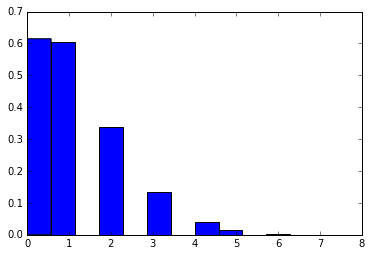

3
1
0
0
2
1
3
2
2
0
0
0
3
0
2
2
0
1
2
4
3
1
1
0
0
1
1
0
1
0
2
0
2
6
2
3
1
2
1
2
0
2
2
1
0
1
1
1
0
0
0
2
0
0
0
0
1
1
0
1
1
1
1
0
2
0
0
1
0
1
0
0
1
1
0
0
2
4
2
1
2
2
1
0
2
0
0
0
0
0
0
1
1
2
1
1
2
1
0
2
1
4
1
1
3
1
0
0
0
1
3
1
0
1
3
1
2
1
0
1
1
0
1
2
0
1
3
1
0
0
0
2
0
2
0
1
1
3
2
1
2
0
0
1
1
0
1
1
0
0
1
1
2
0
1
0
0
1
0
0
0
0
1
2
0
1
0
0
1
2
1
1
2
2
2
1
1
1
2
1
2
0
0
1
1
0
0
2
4
0
2
1
1
1
3
0
2
1
2
1
3
3
3
2
2
1
0
1
0
2
0
0
4
2
3
1
1
1
1
1
0
1
2
2
3
0
1
1
3
1
1
0
0
1
1
1
0
0
1
1
0
0
0
2
1
3
2
8
2
1
4
0
0
2
1
1
0
2
1
1
2
1
1
0
0
0
1
0
1
1
0
0
1
0
1
1
2
0
1
2
0
1
0
3
2
2
2
0
0
0
0
0
0
0
0
3
1
1
1
0
3
3
2
2
2
1
0
1
0
2
0
3
1
2
0
2
2
3
2
0
0
2
0
1
0
2
1
0
0
3
1
2
0
0
2
0
2
1
1
1
1
1
1
4
1
0
1
2
2
0
0
3
1
0
2
1
1
2
1
2
1
1
2
4
2
6
0
0
2
1
0
1
2
0
1
0
0
1
0
2
1
0
0
0
0
0
1
1
1
1
0
3
1
0
0
0
1
2
1
2
5
2
2
2
1
0
1
0
2
1
2
1
0
2
3
2
2
1
0
1
2
1
1
0
0
0
2
0
0
3
2
1
0
0
0
0
2
0
1
0
1
1
1
2
2
1
1
1
0
0
2
3
3
3
0
1
0
2
1
2
0
2
1
1
1
2
1
0
2
1
0
0
1
1
0
4
0
0
2
0
0
1
0
1
1
1
2
4
3
1
1
2
2
1
2
0
0
0
1
1


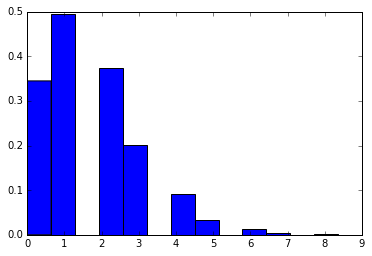

0
2
2
2
4
2
1
1
3
2
2
1
2
2
2
1
0
0
2
2
1
0
2
1
3
3
0
2
1
1
0
0
3
1
1
4
4
2
3
5
3
1
1
2
0
2
1
1
1
3
0
1
2
1
4
0
3
3
0
0
2
0
2
1
5
3
1
1
0
5
1
0
2
2
1
0
3
0
0
2
1
2
4
2
0
0
1
1
1
0
0
0
1
2
2
3
3
1
1
0
0
0
1
2
1
2
1
4
1
3
3
0
1
0
0
0
1
2
1
2
0
4
1
1
0
2
1
1
1
2
2
1
1
1
2
3
4
1
1
3
1
2
2
0
3
1
1
3
3
2
3
0
3
2
2
4
0
2
2
0
2
0
6
2
2
2
1
2
3
2
2
1
0
1
0
2
2
4
2
1
2
2
2
2
0
1
3
3
3
3
1
2
1
2
2
0
2
3
0
2
2
3
0
1
0
1
1
2
2
3
1
1
0
1
6
2
1
0
0
0
0
1
1
1
1
2
2
1
4
2
1
2
2
1
0
0
2
2
3
2
0
1
2
0
0
2
4
1
4
2
2
1
0
0
1
2
2
4
2
0
1
0
1
0
0
1
7
0
1
0
0
1
2
1
1
1
2
1
1
2
1
2
1
1
4
1
2
4
2
1
1
2
5
0
2
0
0
3
0
0
4
2
0
0
2
1
2
1
4
2
4
3
1
1
0
1
1
2
1
0
2
0
1
1
0
0
2
2
2
1
0
2
3
1
0
6
3
3
1
0
1
0
0
2
2
0
0
1
0
1
2
1
0
0
0
2
0
1
2
0
2
3
6
0
2
0
0
2
0
2
3
3
1
1
0
2
2
2
5
4
2
3
1
0
0
2
3
3
3
3
2
2
3
2
2
0
1
2
0
1
0
1
1
1
0
0
0
0
4
0
3
1
3
0
0
0
0
0
0
2
0
0
2
4
1
1
0
1
1
0
2
1
2
4
3
0
0
2
1
2
2
1
1
1
2
3
1
2
2
1
0
1
5
2
1
1
0
6
1
0
3
2
0
2
3
2
4
1
2
0
2
0
2
2
2
1
0
1
2
2
1
2
3
0
3
1
1
1
3
2
1
2
4
1
0
1
3
0
3
1


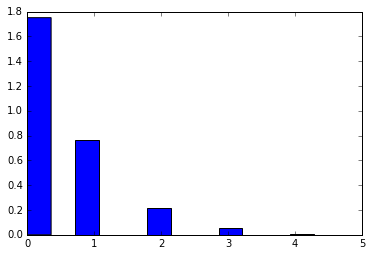

1
3
0
0
2
2
0
0
1
2
0
2
0
1
0
0
0
0
2
0
0
0
1
2
0
0
0
1
2
0
0
1
0
1
2
0
0
0
2
2
0
1
0
1
2
2
0
0
0
0
0
1
1
0
1
0
0
0
0
3
0
1
0
0
0
0
1
1
1
1
0
1
0
1
1
0
2
1
1
0
0
2
0
0
1
3
0
0
1
0
0
1
0
1
1
0
2
1
0
1
1
0
0
1
1
4
0
0
0
3
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
0
0
0
2
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
2
0
1
1
1
3
2
0
1
0
0
0
0
0
2
2
0
1
1
1
1
0
0
0
1
2
0
0
0
1
0
1
0
1
2
0
1
0
0
1
1
1
3
1
0
0
0
0
0
0
0
0
2
1
1
2
1
0
2
0
0
0
1
1
0
0
1
2
2
0
0
0
0
0
0
1
2
0
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
2
1
0
0
2
1
0
0
2
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
2
2
0
0
1
0
1
0
1
0
1
1
1
1
0
0
0
0
0
3
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
2
0
0
0
1
0
0
0
1
0
0
0
0
0
2
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
1
0
1
1
0
0
1
2
0
1
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
1
0
0
2
0
0
0
0
0
1
0
3
0
0
0
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
2
4
3
1
2
2
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1


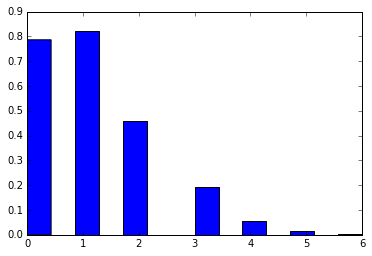

1
1
0
1
1
2
2
0
0
1
2
2
0
2
0
1
0
1
3
2
0
2
1
2
0
0
2
1
1
0
2
4
2
3
3
2
2
3
2
1
2
2
1
1
2
2
0
4
2
1
2
1
1
0
1
5
0
1
1
1
0
0
0
2
3
0
1
0
1
0
0
0
1
4
2
1
0
1
2
0
0
0
1
0
1
1
0
0
2
1
1
1
1
0
3
1
0
3
2
2
0
1
1
0
1
1
1
3
2
0
1
0
2
3
3
1
4
1
1
3
1
1
0
1
2
0
1
1
1
3
1
2
1
0
1
2
1
2
0
1
1
0
2
3
3
2
1
1
1
4
5
1
0
3
1
2
1
2
1
1
1
1
1
2
0
0
1
2
1
1
0
3
0
0
2
0
2
0
2
1
0
2
0
0
0
2
1
3
3
2
1
1
1
0
3
0
0
0
1
2
2
4
2
3
3
4
2
2
3
0
0
3
2
2
4
1
4
1
1
1
3
0
2
0
1
2
2
0
0
2
3
3
0
2
1
0
2
0
0
1
1
3
1
1
0
2
2
1
1
2
1
2
0
3
0
0
1
0
0
1
3
1
0
0
1
0
0
0
0
1
1
3
1
2
1
1
0
0
4
2
1
0
1
1
2
1
0
1
0
2
2
3
1
0
0
4
2
0
0
2
2
2
4
3
3
0
2
2
0
0
0
1
1
2
0
1
1
0
0
1
1
1
2
0
0
0
0
1
0
0
2
2
0
1
4
2
2
2
1
2
1
1
0
1
2
1
1
3
1
0
0
2
2
1
2
1
2
2
3
1
2
1
0
1
3
0
1
1
0
1
2
2
4
0
0
1
1
2
1
3
3
1
0
1
1
3
0
1
0
0
0
1
1
0
1
3
2
1
1
1
0
0
0
0
1
1
0
1
0
0
2
1
0
2
0
2
1
2
1
0
1
1
1
0
0
1
0
0
1
1
1
1
2
1
0
1
1
1
5
1
1
1
0
2
1
4
3
2
1
0
3
2
3
2
2
0
1
0
0
5
0
0
1
0
2
0
1
1
0
0
1
0
0
1
0
1
1
1
1
2
0
2
1
1
2
1
3
2
2
1
1
3
3
0
0
2
2
0
0
2


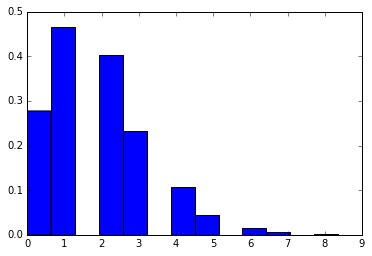

1
0
3
0
0
3
3
3
0
1
4
5
2
3
3
0
1
0
2
1
2
2
0
0
3
2
2
3
2
2
2
1
1
5
1
2
2
0
1
5
0
0
3
2
3
2
5
0
2
1
1
2
0
1
0
2
3
3
3
3
0
1
2
2
3
0
2
3
2
2
0
1
0
1
2
2
4
0
1
2
3
0
2
2
3
1
0
2
3
0
0
1
0
4
1
5
8
0
2
1
1
0
1
2
3
1
1
5
1
1
1
0
0
3
2
0
2
0
3
5
1
3
0
2
3
0
2
0
2
2
1
1
0
2
3
0
0
2
0
3
1
1
5
0
3
2
3
1
5
4
2
2
7
3
3
2
1
1
2
5
3
1
2
1
3
1
1
3
0
2
3
1
1
1
2
1
2
1
2
1
2
0
2
1
2
0
4
2
2
3
0
1
7
2
4
4
2
1
2
0
3
3
2
3
3
3
1
1
5
0
1
2
3
5
2
1
0
3
4
0
1
2
0
1
0
3
1
0
1
1
2
1
1
2
2
0
2
2
1
1
1
1
2
3
1
2
2
1
1
4
1
1
0
0
2
0
3
0
2
2
0
0
1
1
2
1
1
0
0
2
1
6
2
3
0
3
2
1
1
2
0
2
0
2
3
2
0
4
4
5
2
2
2
4
4
3
1
4
1
3
0
2
2
1
2
0
1
3
1
4
1
2
1
2
1
1
2
2
2
1
2
0
7
2
0
0
0
4
6
3
1
0
2
1
0
2
1
3
2
3
3
3
1
2
2
0
2
3
0
2
2
2
0
7
1
2
1
3
0
4
3
2
2
5
1
3
1
2
2
1
2
2
0
1
2
1
2
2
7
5
2
1
4
2
0
1
1
2
3
2
0
3
3
1
3
0
2
2
2
2
3
4
3
3
3
2
0
0
0
1
2
3
2
4
4
1
4
4
2
0
0
2
0
4
1
3
6
3
1
1
1
1
3
3
1
0
3
2
4
4
1
4
4
0
1
2
0
5
2
0
2
0
4
0
0
3
2
2
0
1
1
1
3
0
1
2
3
0
2
0
1
3
1
2
1
1
3
2
1
1
0
1
0
1
2
1
3
1
1
0
1
3
0
0
3
2
1
2
0
0


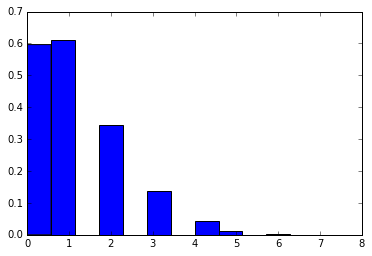

1
2
1
3
2
2
1
2
1
2
0
0
2
2
0
2
2
3
3
2
1
0
2
1
0
5
0
1
0
2
2
4
1
4
2
1
1
2
3
2
1
0
1
1
1
1
0
2
1
0
1
2
0
1
1
2
2
1
2
2
1
0
2
2
0
0
2
2
1
1
0
1
0
1
0
3
1
3
1
1
0
4
1
1
1
1
1
0
1
1
2
0
0
0
2
2
4
3
0
3
1
1
2
5
2
2
2
0
0
3
2
1
1
1
0
3
1
0
1
0
1
2
2
1
0
0
1
1
2
0
3
0
1
2
3
0
1
1
0
0
0
0
1
0
3
0
2
2
0
1
2
1
1
2
1
1
1
0
1
0
0
0
1
0
0
0
2
1
3
0
2
0
1
0
0
1
1
1
1
1
0
1
1
1
0
0
2
0
1
1
1
1
2
2
0
1
1
2
2
3
3
2
4
2
4
4
1
2
4
0
3
1
1
0
2
0
0
2
3
1
0
0
0
2
0
2
3
0
2
0
3
6
0
1
1
2
1
1
1
0
2
0
1
0
0
4
0
1
1
1
0
0
0
1
0
0
0
1
0
0
0
0
2
1
3
0
0
1
2
1
0
1
0
0
0
0
1
1
1
0
1
0
0
0
1
2
3
0
1
4
1
1
1
2
2
1
0
3
1
3
2
3
2
0
1
1
3
0
4
0
2
0
1
3
0
1
1
1
1
1
1
1
2
1
1
0
0
1
0
0
1
0
0
1
0
3
1
1
0
0
0
0
1
1
0
3
1
2
1
1
3
0
0
1
0
0
1
0
2
3
3
1
0
0
2
2
2
1
0
2
1
2
1
2
0
2
1
1
0
0
1
2
1
1
0
1
1
0
0
3
0
0
1
0
0
0
0
1
0
0
2
1
1
6
1
1
2
1
0
1
0
2
1
2
0
2
0
2
1
1
1
1
1
1
1
0
0
0
1
2
1
2
2
0
3
0
2
1
0
0
2
0
0
3
0
0
2
1
0
0
0
1
0
1
5
3
1
2
1
0
1
2
0
0
2
1
2
3
2
2
2
1
2
1
2
2
1
1
0
0
1
0
0
0
1
0
1
2
1
4
2
3
0
1
3
2
1
1
1
1


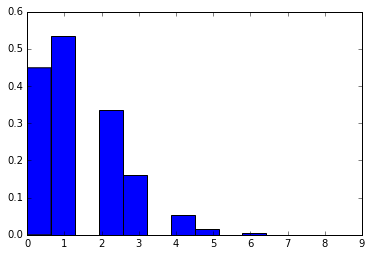

1
2
1
2
5
3
1
2
3
3
3
3
2
1
0
1
0
0
2
1
0
1
1
2
1
5
1
2
3
0
1
1
0
3
3
1
1
1
0
1
3
1
3
2
1
0
0
0
1
2
0
1
1
0
1
2
1
1
2
0
3
0
2
1
0
0
0
4
1
3
1
1
0
3
0
3
3
2
1
2
0
1
1
0
0
1
3
2
3
0
0
1
3
0
3
1
0
2
2
4
1
0
2
3
0
2
2
1
2
0
1
3
4
0
0
1
1
3
2
4
2
3
1
1
2
1
0
0
1
3
0
0
1
1
2
1
2
0
1
1
1
2
1
0
2
0
2
1
0
1
3
1
2
2
2
0
2
2
2
1
1
2
1
2
1
0
1
4
0
0
2
2
3
0
3
1
0
2
0
0
0
3
0
1
0
2
1
0
2
0
1
1
1
0
1
1
3
5
0
0
1
2
4
1
0
1
2
1
1
3
2
1
0
0
0
1
0
0
2
1
2
4
1
3
0
1
0
1
1
1
1
1
2
1
0
1
2
0
0
0
3
0
0
2
0
2
2
1
1
2
1
1
3
0
2
1
2
1
1
1
2
0
0
1
2
1
1
0
3
3
4
2
0
2
2
3
3
0
4
4
1
0
2
1
0
6
3
0
1
4
1
3
3
1
0
1
2
3
2
2
3
1
1
2
1
2
2
1
1
0
0
1
0
3
2
2
0
0
2
1
0
1
1
1
1
1
0
2
1
2
1
1
0
1
4
0
3
0
1
1
1
2
0
1
0
1
1
1
2
1
0
0
0
1
0
0
4
1
1
2
0
0
3
2
2
1
2
0
2
0
0
0
1
1
1
0
0
1
1
3
0
0
2
1
0
2
1
3
1
0
1
2
2
0
2
1
1
0
1
2
2
0
0
0
0
1
0
0
1
3
0
0
0
4
4
1
1
1
2
0
1
0
1
0
0
3
0
1
1
1
1
1
4
3
3
0
2
2
3
0
0
0
1
4
2
2
1
4
0
1
0
1
5
3
2
1
1
3
3
1
2
2
0
2
0
3
2
1
0
2
1
2
3
1
2
0
1
1
0
1
1
1
0
0
0
2
0
2
0
2
1
1
2
0
0
2
0
2
0
1


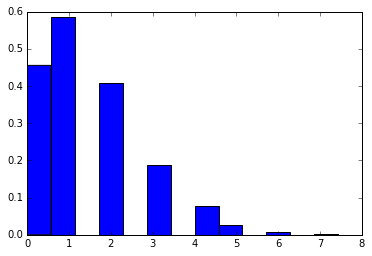

2
1
0
0
2
1
0
2
0
0
3
0
1
2
2
1
1
1
2
0
0
3
0
2
0
2
1
3
3
1
1
3
2
3
0
4
0
2
4
0
2
1
1
0
1
1
0
2
2
3
0
3
2
1
3
1
1
1
0
2
0
2
1
1
3
1
5
1
1
2
1
1
3
0
4
3
3
1
2
2
1
1
2
0
1
0
1
0
1
1
0
1
1
0
4
2
4
2
2
3
1
3
1
5
2
7
3
4
0
1
1
3
2
2
2
0
1
1
4
3
0
1
1
0
0
1
2
0
4
2
2
2
0
1
0
2
1
1
0
4
3
0
0
1
4
1
1
3
0
3
3
1
1
2
4
2
0
1
1
1
3
2
2
4
1
2
2
4
2
0
3
2
3
2
1
1
1
2
0
0
0
0
1
2
3
5
0
3
2
2
1
2
0
1
1
2
3
3
2
3
1
4
2
3
2
3
4
0
1
2
0
1
1
2
2
0
2
1
3
2
4
1
2
1
1
2
2
1
1
6
1
2
1
1
3
2
2
1
2
0
0
0
1
2
0
1
1
1
3
2
0
5
2
3
0
2
1
0
0
0
1
3
2
1
4
0
0
1
0
1
0
2
1
1
2
2
2
2
4
3
2
1
1
0
4
3
3
2
1
2
0
1
2
0
4
1
3
1
3
3
3
1
5
1
4
1
1
3
2
1
5
6
0
1
4
2
1
3
0
2
0
2
0
1
3
1
0
0
2
2
3
2
3
2
2
2
2
1
0
2
3
5
2
1
1
0
5
1
0
1
1
0
0
2
3
1
0
1
5
0
3
2
0
1
4
1
0
1
0
0
2
2
0
3
1
1
0
0
2
1
0
1
1
1
1
8
2
2
2
1
2
2
3
2
2
2
1
1
0
1
1
1
1
1
2
0
0
4
0
2
2
3
0
1
1
0
2
2
0
2
2
0
0
1
3
1
1
4
2
1
1
0
1
2
1
3
1
3
2
1
3
0
0
0
1
3
1
1
0
1
0
1
0
0
0
2
2
1
2
2
0
0
2
2
1
0
0
0
0
0
1
3
2
1
5
2
0
0
1
1
0
1
2
0
1
1
0
3
0
0
2
1
0
1
1
3
3
1
0
1


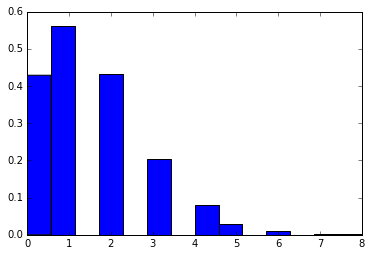

1
0
2
3
4
1
1
2
0
2
1
2
8
2
3
1
0
2
1
0
0
2
2
3
2
1
1
3
0
1
1
2
0
1
0
2
1
5
2
0
3
0
0
0
0
1
2
0
2
0
1
1
2
1
1
2
1
1
2
2
3
0
3
0
0
0
1
1
2
1
1
1
0
1
0
1
0
1
0
0
0
3
0
0
1
0
2
2
1
2
1
2
1
3
3
0
3
2
3
3
1
1
4
1
3
4
1
1
0
1
2
1
3
1
1
1
0
0
1
1
2
2
1
0
1
1
0
1
1
2
1
2
0
0
0
1
1
1
1
0
0
2
1
1
1
1
2
5
1
2
1
2
0
1
2
2
2
2
2
0
1
1
1
0
0
0
2
1
2
2
2
4
1
3
0
1
4
3
2
0
2
1
1
0
4
2
1
3
3
2
0
0
2
2
1
3
2
1
1
4
1
3
3
5
1
2
2
3
1
2
3
2
1
3
1
4
2
0
2
3
1
2
0
1
2
0
1
2
2
0
2
4
1
3
3
1
1
2
0
3
0
3
0
1
0
4
0
0
1
0
3
0
1
2
2
0
1
1
0
0
0
1
1
1
0
2
1
1
1
3
3
4
5
4
0
0
4
0
2
1
2
1
2
2
0
1
2
3
6
1
1
2
2
1
3
1
1
2
0
0
3
1
1
2
1
1
0
3
2
2
3
0
1
1
1
2
1
2
0
1
1
3
1
0
0
1
1
1
0
3
1
2
1
1
3
2
0
3
3
1
1
2
1
0
1
1
2
0
3
0
2
1
0
1
1
0
1
3
2
2
2
2
3
2
1
2
2
0
1
5
1
5
0
2
0
3
1
4
2
2
0
2
1
2
1
0
0
1
1
4
0
1
2
1
1
4
1
2
2
1
0
2
1
1
0
0
0
2
0
1
2
0
1
3
3
1
1
1
2
3
1
1
2
2
2
4
2
1
0
0
0
3
0
4
6
0
0
4
2
3
1
1
1
1
2
3
2
4
2
3
3
3
2
1
0
2
1
0
1
0
2
1
1
0
1
0
0
0
2
0
0
2
2
1
2
2
3
2
1
2
0
1
3
1
2
3
0
2
1
1
3
3
0
1
1
0
1
2
1
3


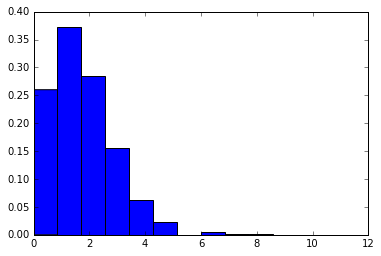

0
2
1
0
2
4
1
2
2
0
2
1
2
4
2
0
2
1
0
1
2
0
1
4
1
3
0
0
0
2
1
4
0
3
4
2
1
1
7
3
2
1
2
1
0
4
2
1
7
1
0
0
2
2
2
0
3
0
2
1
3
1
3
0
1
0
3
2
1
0
2
1
2
0
2
0
0
1
2
1
2
2
2
0
1
1
1
4
0
4
4
1
1
1
0
1
5
0
1
0
1
2
1
1
1
1
1
3
3
2
2
1
3
0
2
4
2
0
3
1
3
3
0
4
1
1
1
0
2
1
0
0
2
0
1
3
1
2
1
2
5
3
0
3
2
4
3
3
2
2
1
3
1
1
1
0
1
0
1
1
3
2
2
1
3
3
0
0
5
4
0
1
0
2
0
0
1
1
1
2
2
2
1
0
3
3
1
2
2
2
4
1
1
1
1
0
0
6
2
0
5
4
2
2
2
2
2
4
1
1
2
2
1
1
3
1
1
4
4
3
1
0
0
1
2
0
1
3
2
5
1
2
2
1
1
0
3
1
1
0
1
3
1
1
0
0
3
2
1
0
0
4
1
4
2
2
1
0
0
2
0
1
0
2
1
3
1
0
3
2
3
2
1
1
1
1
4
3
0
2
2
1
0
1
1
2
3
3
2
1
3
1
1
1
5
3
1
1
1
1
5
1
3
4
1
1
1
2
1
1
0
1
1
2
1
1
2
1
2
1
0
0
1
2
0
1
0
2
1
2
3
4
1
5
0
2
2
1
2
0
0
5
1
1
2
1
0
2
3
1
0
3
0
2
2
0
2
2
5
3
3
1
1
1
0
1
1
0
2
1
1
2
1
1
0
0
1
2
0
1
0
1
1
2
0
2
1
0
1
0
2
2
3
0
2
1
0
3
3
1
0
4
3
2
0
2
2
2
3
1
1
6
1
1
4
1
2
6
2
0
1
1
1
3
0
1
0
0
0
1
4
0
1
4
1
3
0
3
5
0
4
1
1
1
2
0
0
0
1
4
1
2
5
0
1
1
1
0
1
1
0
0
2
1
1
2
0
1
1
2
1
2
5
4
1
1
2
0
0
0
4
0
1
0
0
0
3
0
0
3
1
3
0
2
0
1
0
4
0
0


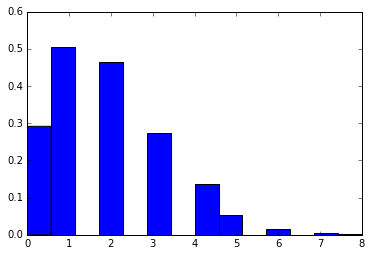

3
2
0
0
0
2
6
2
2
1
0
1
2
3
0
0
3
0
1
1
0
1
0
1
0
1
2
0
2
1
2
1
3
4
4
3
2
8
2
2
4
1
1
0
2
1
3
2
0
0
0
1
4
3
1
1
2
3
0
2
0
5
0
2
2
0
1
2
0
0
0
3
1
4
2
4
1
6
3
4
3
1
0
1
3
5
2
3
0
2
2
0
1
1
2
2
2
1
1
3
2
0
2
0
2
2
3
1
1
4
5
3
2
3
0
2
2
3
2
5
0
6
2
2
4
2
3
2
1
4
3
0
1
2
0
4
1
1
1
2
1
2
3
2
1
2
2
2
1
2
2
4
4
2
1
3
0
2
3
2
1
4
1
0
2
1
3
1
4
1
2
0
1
1
1
2
2
3
1
3
1
4
4
3
1
1
5
1
3
2
2
0
2
3
3
2
8
3
2
2
3
4
5
3
3
4
0
4
1
2
1
3
2
4
1
3
1
0
1
0
0
3
2
1
2
2
1
2
3
2
2
2
0
3
6
1
2
1
2
0
0
1
1
2
1
3
1
3
1
1
2
2
0
3
2
4
3
0
0
2
2
0
2
0
2
1
0
0
1
2
2
0
1
3
2
1
1
0
4
0
4
1
2
2
1
2
3
5
1
7
2
3
3
8
2
2
2
4
4
1
2
4
3
4
2
1
1
1
3
1
1
3
1
3
0
1
1
2
0
0
2
0
2
2
3
1
0
2
3
1
1
2
2
4
3
2
2
5
3
3
2
3
3
1
4
2
2
3
1
2
0
1
3
1
3
1
4
1
2
1
4
4
0
2
2
4
0
1
1
2
0
2
1
2
3
1
0
2
2
2
0
2
1
2
1
2
3
4
3
1
3
1
3
1
4
3
2
3
0
3
0
1
0
0
1
1
1
2
1
2
1
3
1
1
1
1
2
2
4
3
2
1
1
2
0
2
2
1
4
1
2
5
2
1
2
4
1
1
2
4
2
5
4
1
0
5
2
0
1
1
3
2
2
0
2
2
1
1
2
2
0
2
2
1
1
2
0
2
2
1
3
1
2
1
2
2
5
4
0
0
2
0
2
1
0
2
3
4
0
1
1
1
2
2
3
1
2
2
1
3


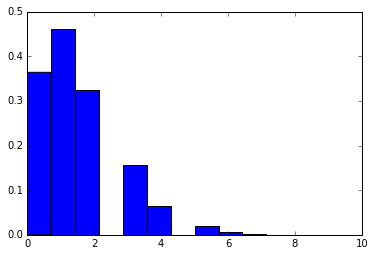

2
0
0
1
1
2
2
4
1
0
0
2
3
0
1
0
0
0
1
0
0
0
0
3
2
0
2
4
4
0
1
3
1
1
0
1
3
2
4
1
0
1
1
2
1
4
2
1
2
0
1
1
3
1
2
1
3
3
0
1
2
2
0
0
1
0
3
2
1
2
3
1
0
2
0
2
4
3
1
2
2
0
1
1
4
2
0
1
0
2
4
4
0
1
1
1
0
2
2
1
2
0
2
0
3
2
0
0
4
4
2
2
2
1
1
3
1
0
1
2
1
1
1
1
1
0
1
3
1
0
3
4
1
1
0
1
1
1
1
0
2
1
1
0
1
2
2
1
3
3
0
2
4
0
0
1
2
0
1
4
3
2
4
1
4
0
2
2
2
4
1
3
1
1
0
1
0
1
2
1
0
2
1
1
0
1
1
1
1
1
0
2
3
0
1
5
2
2
4
4
1
2
2
2
2
6
0
3
3
0
3
3
0
1
3
2
1
0
4
0
2
0
1
0
0
3
1
1
1
2
2
0
3
4
0
0
1
3
4
1
1
1
1
2
1
1
6
2
1
1
2
0
2
1
2
3
1
2
2
1
0
3
0
1
1
1
0
1
1
1
1
2
3
3
0
5
3
0
0
2
3
2
2
3
0
7
2
2
2
2
2
1
0
2
2
3
2
4
1
1
3
4
2
1
0
0
3
1
1
1
0
2
3
3
0
1
0
0
1
1
1
1
3
3
0
1
1
1
1
3
0
2
0
0
2
0
1
0
1
1
2
1
3
1
0
0
0
1
0
3
2
2
1
3
1
1
3
2
0
3
2
0
2
3
1
2
0
3
1
1
0
1
1
0
1
0
2
0
0
0
2
2
0
0
1
2
1
0
0
4
1
0
1
2
0
0
1
0
0
0
2
2
1
2
1
0
2
1
0
5
0
2
2
2
1
2
2
1
4
2
2
0
4
1
2
1
1
1
2
1
0
0
3
4
4
3
0
1
2
0
1
2
2
1
0
0
3
2
1
1
0
3
2
1
1
1
1
1
2
0
3
1
0
5
5
0
2
2
3
0
1
1
0
0
0
1
0
0
0
1
1
2
1
1
0
0
1
0
4
1
1
1
0
0
1
1
1
0
1
1


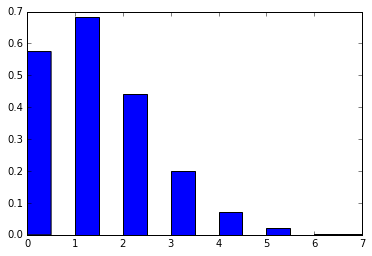

0
1
2
1
1
0
4
2
0
0
3
0
1
2
1
0
0
0
3
0
1
0
1
0
3
1
3
2
2
2
1
2
2
1
0
1
2
2
1
2
2
1
2
1
0
2
2
3
1
2
2
2
1
2
2
4
1
2
1
1
2
4
3
2
3
2
0
3
2
0
2
0
2
3
2
2
0
1
2
0
0
1
1
1
0
0
0
3
5
0
5
1
2
1
3
0
3
4
1
0
3
1
1
1
0
1
2
0
4
0
3
1
3
0
2
0
0
1
0
2
1
5
2
3
1
1
1
0
3
0
1
3
0
0
0
0
0
0
2
1
0
3
0
0
0
0
1
0
3
2
2
1
3
0
3
0
0
1
5
1
1
1
2
1
0
1
1
0
0
1
2
1
1
2
1
0
3
2
2
0
1
2
1
0
0
0
0
1
3
2
0
0
3
1
5
0
2
0
0
4
0
1
3
0
1
2
0
3
2
2
1
4
2
0
2
3
0
0
1
0
1
2
0
0
1
0
1
0
0
1
0
0
2
2
1
2
0
0
2
1
0
1
0
1
1
1
1
2
1
2
2
1
1
0
2
1
2
0
1
0
0
1
1
1
1
1
0
1
0
0
0
2
2
3
1
1
1
1
0
3
0
0
1
4
2
1
1
0
2
3
2
1
0
0
1
3
2
1
1
1
0
2
2
1
0
0
1
1
2
2
1
0
1
1
0
5
2
2
0
0
0
0
1
3
2
1
1
0
2
0
2
1
0
0
2
1
0
5
1
2
2
4
1
1
0
1
1
2
1
0
0
2
0
0
0
2
4
0
3
5
3
1
3
1
0
0
0
1
3
1
0
1
1
2
1
4
1
1
1
2
0
2
3
1
0
2
0
1
2
1
4
0
0
1
1
2
0
2
3
1
3
0
1
3
1
1
0
3
1
0
0
0
0
1
2
1
0
0
0
1
0
0
1
0
2
2
1
1
2
3
2
1
2
4
1
2
4
2
4
1
1
0
1
0
4
2
3
3
1
3
0
1
1
1
4
2
0
1
2
0
1
4
0
2
3
1
0
0
3
1
5
1
0
2
0
0
2
0
0
1
0
1
0
0
0
0
0
0
4
1
1
0
0
0
1
2
3
2
0
0


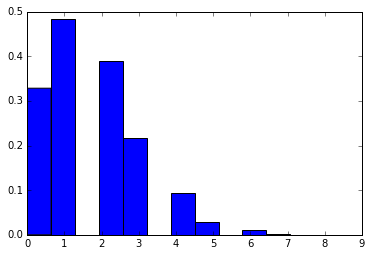

2
3
0
1
1
1
0
1
0
1
0
1
0
4
1
1
2
1
1
2
1
5
2
5
1
2
4
1
1
2
3
1
2
2
7
0
3
1
2
1
3
0
1
0
2
2
3
2
1
1
0
2
1
2
4
4
0
0
1
4
2
0
0
1
4
3
2
3
1
1
3
3
0
2
2
3
2
1
1
0
2
1
1
1
2
1
0
2
2
5
3
4
3
4
5
1
3
1
4
4
3
3
1
1
1
1
4
5
2
0
1
1
3
4
1
1
3
1
1
2
1
6
1
0
1
2
1
1
3
5
0
3
2
1
1
2
2
4
2
2
2
3
0
1
1
5
1
6
0
3
7
5
7
2
2
2
2
3
1
1
3
2
3
1
3
4
1
0
3
1
2
2
1
1
1
1
1
1
2
2
1
0
3
3
3
0
0
0
4
1
3
2
0
4
1
1
2
4
3
0
2
2
3
1
0
5
2
3
1
1
2
2
1
2
1
0
6
3
3
2
2
0
0
3
1
2
2
3
1
5
2
1
2
3
2
3
1
1
0
4
2
1
2
0
2
2
3
1
2
2
3
1
0
6
1
1
3
5
1
0
3
1
2
1
2
1
3
0
2
2
2
4
2
3
0
2
2
0
3
2
1
2
4
1
3
3
1
2
2
6
2
3
3
3
2
0
1
2
3
2
3
5
1
2
2
3
2
3
2
0
0
2
2
1
0
2
4
1
1
1
0
3
0
2
1
1
1
3
4
0
1
0
0
1
0
4
1
4
2
2
0
0
0
1
1
2
0
1
3
1
2
0
1
2
4
1
3
2
1
2
2
4
3
0
0
0
6
1
4
0
3
0
1
2
3
2
0
2
1
2
2
1
0
1
4
3
3
0
3
1
1
3
1
2
0
0
2
1
2
1
1
2
4
0
2
3
1
1
0
2
2
3
1
2
1
1
2
2
0
1
0
1
2
1
4
2
3
3
2
1
2
2
5
4
1
3
2
3
1
2
1
0
1
3
1
2
3
2
2
1
4
4
2
2
1
3
1
2
1
2
2
1
3
1
2
0
1
0
0
0
1
2
2
3
1
2
1
4
0
0
2
0
1
0
1
1
0
2
3
1
4
0
3
1
3
2
0
2
0
3


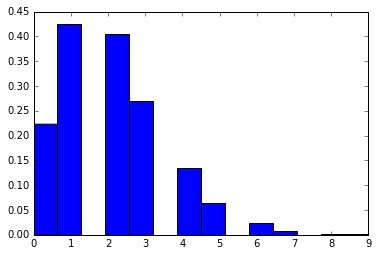

0
1
2
3
0
0
1
2
3
2
2
3
1
3
1
1
2
0
2
0
1
2
2
2
2
0
2
1
3
1
1
1
4
4
8
2
2
7
1
4
4
2
2
3
2
1
2
2
1
2
2
2
1
2
1
2
3
2
0
4
3
4
2
2
2
0
2
1
3
3
3
1
2
2
1
1
4
7
2
2
2
2
0
2
2
0
2
4
5
3
3
5
3
2
2
0
3
1
3
3
2
4
4
1
1
0
1
3
2
0
3
0
2
2
1
4
2
4
0
0
2
3
7
3
6
0
2
4
2
2
3
1
2
2
5
0
3
3
1
3
1
5
1
1
2
0
4
2
3
2
2
2
0
4
1
2
2
1
5
2
3
2
1
1
1
1
1
1
0
2
3
3
2
0
3
0
2
3
0
2
0
2
3
2
0
2
2
1
1
4
1
0
1
3
5
1
5
3
0
2
1
3
4
1
3
0
2
2
4
2
5
3
1
0
3
1
1
3
1
1
0
0
1
0
3
0
0
0
1
2
3
1
3
0
2
2
2
3
0
1
1
0
1
2
2
5
1
3
4
0
1
2
3
2
1
1
1
4
2
2
2
2
3
1
1
0
2
3
2
4
5
0
2
3
1
1
3
1
1
1
5
1
1
3
2
1
1
1
4
4
1
5
2
4
1
3
5
1
3
2
1
1
5
4
5
1
1
8
1
1
0
2
1
2
1
0
1
0
3
1
1
0
3
4
3
0
2
3
5
2
0
2
1
1
1
4
3
2
4
5
0
1
0
2
3
1
1
3
5
1
4
2
1
4
1
0
1
5
6
1
2
1
6
2
1
2
2
5
2
4
0
5
1
4
2
1
3
2
2
6
0
2
1
5
1
4
4
3
5
1
1
2
0
1
4
1
2
2
2
1
2
4
3
5
2
4
2
2
0
3
3
0
0
3
2
0
2
3
1
3
0
1
6
2
1
0
1
0
2
1
3
1
2
2
7
3
0
3
5
1
3
2
1
5
7
2
4
3
2
1
2
1
2
3
1
2
1
0
3
2
2
1
0
5
2
3
0
0
3
2
1
1
2
3
0
1
2
2
3
0
3
2
2
1
3
2
5
1
0
3
1
2
3
4
0
0
3
1
2
2


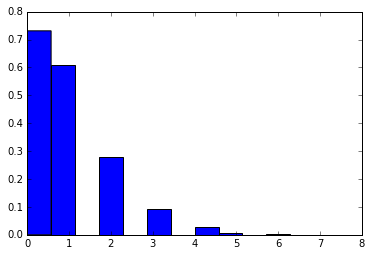

0
3
1
0
1
0
0
1
0
1
0
2
1
3
0
2
0
0
1
3
1
0
0
0
0
1
4
2
3
3
3
5
2
2
4
0
4
6
1
0
0
0
1
2
0
3
1
0
2
0
2
1
0
1
1
0
1
1
1
0
1
2
1
3
1
2
2
0
0
1
2
2
1
0
2
1
0
0
0
2
0
2
0
2
0
0
1
0
0
0
1
0
1
1
2
1
1
0
2
2
1
1
0
1
1
1
1
0
2
1
0
0
1
0
1
2
1
0
1
1
0
0
3
1
1
2
1
1
2
1
0
1
1
0
2
0
1
0
0
1
2
1
2
2
0
2
3
1
2
3
1
2
1
2
2
2
1
3
0
4
0
2
0
0
1
0
0
0
2
1
1
2
1
1
0
1
1
1
1
0
1
0
0
1
0
1
1
1
0
2
1
0
0
0
2
2
0
0
2
4
2
2
1
4
1
6
1
8
3
2
1
1
0
2
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
2
2
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
0
0
1
1
0
0
2
1
0
0
1
0
0
0
1
0
1
2
0
1
0
0
0
4
2
2
2
0
2
0
1
2
0
2
0
2
1
0
1
1
5
4
0
5
1
0
1
0
0
4
0
1
1
1
2
0
2
1
1
1
1
0
0
0
0
0
0
0
0
2
1
3
0
0
0
1
2
1
0
0
1
3
0
1
0
2
2
0
3
2
0
0
0
0
1
2
1
1
0
0
3
0
1
1
1
0
0
3
1
1
2
3
2
0
0
2
4
0
2
0
2
2
3
1
1
2
1
1
2
1
0
1
2
1
1
1
0
1
0
0
1
2
0
0
1
0
0
0
1
0
1
2
0
2
1
1
0
2
0
0
0
0
1
3
1
4
2
0
1
2
2
0
0
1
0
2
2
1
0
1
2
3
1
0
1
1
2
4
1
2
1
0
0
1
0
0
3
1
2
2
0
1
0
1
2
2
0
0
2
2
2
2
0
0
0
0
1
0
0
2
0
1
0
4
0
0
0
1
0
0
0
0
0
0
0
0
1
2
0
0
0
2
1
0
1
1
0
1
1
2
2
1
4


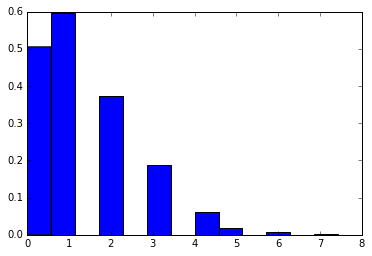

0
0
2
0
2
1
2
1
1
0
0
2
1
2
1
2
0
3
0
2
2
2
0
0
3
3
0
3
0
1
0
1
0
1
3
0
2
3
2
1
0
2
2
1
2
2
1
2
2
2
1
0
2
1
0
0
1
1
1
0
1
3
1
1
2
1
1
2
1
1
0
1
1
1
0
0
1
4
0
1
1
0
1
1
2
1
0
0
0
2
0
1
1
2
3
0
1
3
1
0
0
5
0
0
1
2
2
4
1
2
0
0
1
2
2
2
1
1
1
0
3
3
0
0
2
1
1
1
0
1
0
0
1
1
0
2
0
3
0
1
3
4
3
2
1
1
1
1
2
1
0
3
1
6
3
1
0
2
4
3
0
3
1
3
1
1
4
0
4
0
0
0
0
1
1
1
1
2
0
0
1
2
3
1
3
3
1
2
2
2
0
3
1
3
4
4
3
2
2
0
1
2
4
0
0
1
1
1
1
1
0
1
1
2
2
2
0
0
1
1
0
0
1
1
0
1
3
0
1
0
2
2
1
0
2
1
0
2
2
1
1
0
0
0
2
1
0
2
3
0
0
2
2
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
2
3
1
2
0
1
1
1
1
0
0
2
2
0
0
2
1
1
1
1
3
3
2
2
1
2
4
0
2
2
2
3
2
0
3
0
1
2
2
0
2
0
1
2
1
1
4
2
1
3
1
1
1
1
0
1
0
0
0
0
1
0
0
0
1
2
0
2
0
1
2
3
0
0
0
0
0
2
0
0
0
0
2
0
0
0
1
2
2
2
2
3
3
1
0
1
2
2
1
1
1
1
3
0
0
0
2
1
2
2
3
1
1
0
0
1
0
2
0
1
3
0
0
1
1
0
0
2
1
0
0
2
1
0
2
4
1
2
5
3
1
1
2
0
0
1
1
2
1
0
1
1
0
2
1
3
2
1
1
0
0
1
1
3
0
1
0
1
3
2
2
1
3
0
1
3
2
4
0
0
0
2
0
0
3
1
1
0
0
1
0
2
1
0
0
3
0
1
0
0
2
1
1
1
1
0
0
3
0
0
0
0
3
0
1
1
2
0
0
1
1
1
1
0
1
0
2
0
4
0
0
0


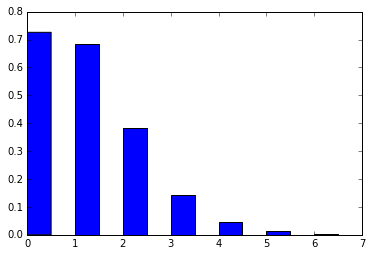

0
0
0
0
1
0
3
1
0
0
2
0
0
0
0
0
2
1
2
2
1
1
0
1
0
0
1
1
1
5
1
1
2
3
6
3
1
2
1
1
1
1
2
0
2
1
1
1
0
0
0
0
1
3
1
1
1
0
0
1
1
0
1
2
0
4
1
1
1
4
0
0
1
0
1
0
1
1
4
1
1
2
1
2
0
0
1
2
0
0
0
3
2
4
2
1
3
1
0
1
1
2
1
2
2
1
3
4
2
0
3
1
1
0
0
0
1
1
0
2
1
1
4
2
1
1
1
0
2
2
1
3
1
2
0
2
0
0
0
0
1
0
1
0
2
3
0
1
3
5
2
2
0
1
2
0
1
3
1
1
0
0
0
0
1
0
0
0
2
0
0
0
1
0
2
0
2
2
1
0
1
1
1
0
2
3
0
0
1
0
4
1
2
4
3
1
3
1
3
2
2
4
1
1
2
2
4
3
0
1
1
3
1
1
2
1
0
3
3
1
1
1
1
2
1
2
2
2
1
1
0
1
2
2
3
2
3
1
1
0
0
0
0
2
0
1
0
2
1
0
0
2
5
2
1
1
1
0
1
0
1
1
0
1
0
1
0
0
3
1
2
6
0
1
0
2
2
1
2
0
3
0
0
1
0
2
0
1
3
3
2
1
1
1
1
1
2
3
2
2
0
1
1
3
0
1
1
0
0
1
0
0
1
0
1
2
1
2
0
0
1
2
2
1
1
0
1
0
0
0
2
2
1
1
3
1
2
2
3
0
0
2
3
4
0
4
1
1
1
1
1
1
1
0
2
0
1
0
2
2
0
1
2
4
1
1
2
1
1
3
1
2
1
0
2
1
1
1
3
1
0
1
2
0
0
1
0
1
0
1
1
2
1
2
0
0
1
2
2
3
0
1
0
2
0
0
2
4
2
2
3
0
0
1
0
1
1
1
1
0
0
1
1
0
0
1
3
0
1
1
2
1
2
0
1
0
3
0
1
0
2
0
1
3
1
1
2
1
0
0
2
1
2
1
1
2
0
0
0
0
1
0
2
2
1
1
0
2
0
2
1
1
0
0
0
2
0
1
1
0
2
0
0
0
1
1
0
0
0
0
4
0
2
0
2
0
0
2
0
1


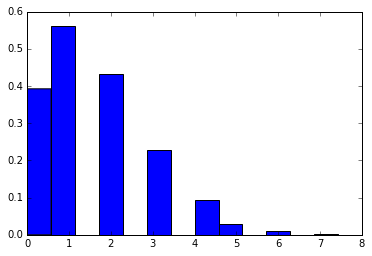

1
0
0
3
2
1
1
2
4
1
3
0
4
0
1
3
1
1
1
3
1
0
1
3
3
1
2
3
0
1
1
3
1
1
4
3
4
5
2
3
4
1
5
2
0
7
2
1
0
1
2
1
3
4
2
3
1
1
2
1
1
0
0
1
4
1
1
3
0
4
2
3
1
0
1
4
1
2
2
2
0
3
0
2
0
2
0
4
0
1
4
4
0
2
1
2
0
2
3
2
3
0
0
2
0
2
2
0
5
0
0
2
1
0
1
1
0
0
0
3
2
3
3
1
1
0
2
1
2
3
2
1
1
2
2
4
3
0
1
2
1
2
1
4
2
2
2
6
1
3
2
3
3
4
0
2
1
4
1
6
1
3
0
2
3
1
0
0
4
1
1
1
1
3
2
1
5
1
2
1
0
1
0
0
3
0
1
1
2
1
2
1
0
1
2
3
0
2
1
0
2
1
1
1
1
2
1
0
2
3
2
1
2
1
1
2
0
0
2
0
2
1
2
2
1
3
0
1
1
1
3
1
0
3
3
1
2
0
2
0
1
0
2
0
0
0
1
1
1
4
0
5
1
1
0
2
0
0
0
0
0
1
1
2
0
2
0
1
3
1
0
1
2
1
1
1
1
1
0
4
1
1
2
1
0
1
5
3
1
3
2
1
1
2
1
0
2
4
3
5
2
3
1
1
3
3
0
1
2
5
2
5
2
2
0
1
1
2
2
1
0
1
1
2
2
0
2
3
1
1
3
3
0
3
1
0
1
1
2
4
0
3
1
1
0
0
2
0
2
0
1
0
2
0
1
1
4
0
1
0
1
1
3
1
1
1
3
3
1
2
2
2
2
0
0
2
1
4
3
3
2
2
1
2
2
0
1
1
2
0
3
2
2
1
0
2
0
1
2
2
3
2
0
2
0
2
2
3
0
0
2
0
1
1
2
1
1
2
2
3
1
0
0
3
4
1
1
4
1
0
1
3
1
1
2
6
2
3
3
5
0
0
0
0
3
2
3
2
0
1
3
4
3
1
1
1
0
4
4
2
1
2
2
2
1
1
0
1
1
1
2
3
0
0
0
1
0
1
3
2
2
1
1
3
3
0
0
2
1
3
0
0
1
1
2
1
1
3
4
0


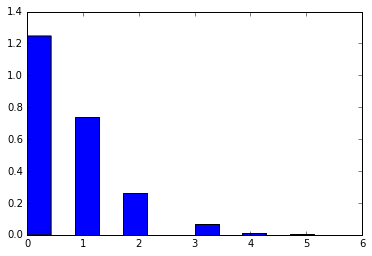

1
1
1
1
1
2
0
0
0
2
0
1
0
0
0
1
1
0
0
1
1
0
2
0
0
0
0
2
1
0
0
2
0
0
0
0
0
0
0
0
1
1
0
0
0
1
2
0
1
1
3
0
1
0
0
0
1
0
0
2
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
2
0
2
1
1
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
2
1
1
0
1
0
1
2
1
2
2
2
0
1
0
0
0
1
1
1
1
1
1
1
0
0
1
1
0
0
0
3
1
2
0
0
0
0
0
0
0
0
0
2
3
0
1
2
0
0
0
0
0
0
0
2
0
0
4
1
0
1
2
0
2
0
0
0
0
1
1
0
1
0
1
1
1
0
1
1
1
2
1
1
2
0
0
0
0
0
0
1
0
1
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
2
0
0
2
0
0
0
1
0
0
1
0
0
0
2
1
2
0
1
0
0
3
1
3
3
2
1
3
2
1
0
0
2
2
1
0
0
0
0
1
0
0
2
1
0
2
1
4
1
1
0
1
0
0
1
0
1
0
1
1
0
1
1
2
0
1
2
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
2
0
2
2
0
1
2
1
2
1
1
0
1
1
1
0
1
2
2
1
0
2
0
0
1
1
0
0
2
0
5
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
0
0
2
0
2
0
0
1
0
1
2
0
1
0
0
0
2
1
1
1
0
1
1
0
0
0
2
0
0
1
0
3
1
3
0
0
0
0
0
0
0
0
1
0
1
0
2
0
1
0
0
0
0
1
0
0
1
0
1
0
0
3
0
0
2
1
1
1
2
0
0
0
0
0
1
1
0
0
0
0
0
0
1
2
0
2
0
2
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
1
2
0
0
1
1
0
1
0
1
0
1
1
0
0
1
1
3
1
2
1
1
0
0


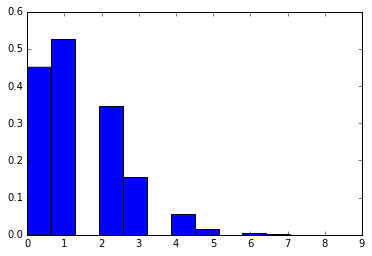

2
4
0
0
1
2
1
1
4
0
4
1
0
2
0
2
0
1
2
2
2
2
1
1
3
0
2
1
0
3
2
1
2
2
1
2
0
2
1
1
3
1
4
4
2
2
1
3
2
1
0
1
2
1
1
1
0
2
1
4
0
1
0
0
0
1
1
0
1
2
1
1
3
1
1
0
1
1
3
2
2
1
4
2
3
7
3
4
1
1
2
1
1
2
2
3
0
1
3
2
4
1
1
0
2
0
1
0
2
0
2
2
0
1
1
3
1
0
0
2
1
1
0
1
1
0
0
1
0
1
2
2
2
1
0
1
0
1
1
1
1
0
2
1
1
0
2
0
1
2
2
0
1
3
1
1
0
1
0
2
1
2
3
0
0
2
2
0
0
2
1
2
2
1
1
1
0
1
1
0
1
0
0
2
0
3
0
1
3
2
1
1
0
5
0
0
2
0
0
0
3
1
0
0
3
2
2
1
2
1
3
1
0
2
3
2
1
0
2
2
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
2
1
0
0
4
3
3
4
3
1
3
4
4
2
1
0
0
4
0
1
2
0
2
1
1
2
1
3
0
3
0
3
2
1
3
3
3
0
2
4
1
0
5
4
2
3
3
0
2
2
2
3
3
0
3
0
2
0
1
1
1
1
2
0
3
1
1
2
0
2
3
2
4
1
2
2
1
1
1
1
1
3
1
1
2
3
3
2
1
1
1
2
3
2
4
5
2
1
1
0
0
2
0
1
1
0
1
0
0
2
1
1
1
1
0
0
1
1
1
0
1
0
1
2
1
2
2
1
0
1
1
1
1
1
2
1
3
6
4
2
1
1
1
1
3
0
3
2
4
0
0
1
1
0
0
1
0
0
0
0
0
1
3
2
3
1
0
0
0
1
0
0
1
2
0
1
1
0
2
2
2
1
0
2
1
4
1
2
0
2
0
1
0
1
1
0
1
1
1
0
2
0
1
0
3
2
3
1
2
2
1
0
1
1
1
1
1
2
3
2
1
2
1
3
0
0
2
0
1
1
1
1
2
0
0
0
0
2
1
0
0
0
0
1
1
2
0
2
0
3
1
1
1
0
1
0
2
1
3
0
2
1
3
3
0


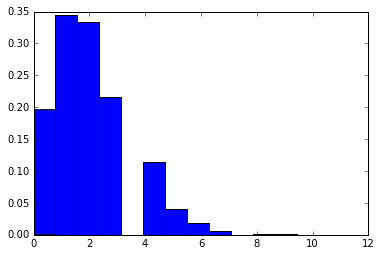

1
2
3
0
2
2
1
3
2
2
3
3
3
2
1
0
3
0
1
3
3
0
1
2
4
2
2
2
1
1
5
2
3
4
0
1
2
2
0
4
1
1
3
3
3
2
3
1
1
3
0
2
1
4
3
0
1
1
4
3
4
1
0
0
0
4
0
0
1
3
1
2
0
1
3
0
1
3
2
4
2
3
1
4
1
1
2
1
1
1
3
1
0
2
2
3
2
2
0
2
0
2
2
1
1
2
0
3
1
5
1
5
0
2
1
3
2
2
0
3
1
4
1
2
2
5
3
0
2
2
0
3
1
1
1
2
4
0
1
2
6
3
1
5
1
3
1
1
4
2
3
1
2
1
2
3
6
1
1
4
1
1
3
3
1
2
2
0
0
1
1
1
2
3
1
2
0
3
1
2
1
6
2
6
8
0
3
4
6
1
2
1
3
2
3
2
0
1
2
3
3
1
3
3
2
6
2
1
3
3
4
1
3
1
1
0
1
3
2
3
2
0
2
1
2
2
1
1
2
2
0
2
4
1
0
1
1
0
0
4
3
3
8
1
3
5
0
3
1
1
1
2
1
3
3
1
1
1
1
3
3
2
2
1
1
1
0
0
2
2
3
5
1
4
2
6
4
3
0
2
0
1
0
2
3
1
4
3
2
1
2
3
2
1
3
3
2
3
3
2
2
1
0
1
0
1
3
0
2
5
5
3
2
3
2
2
2
3
1
4
1
2
2
1
4
1
1
2
1
2
1
1
2
3
2
2
0
1
5
0
1
2
1
1
2
2
2
1
0
4
0
2
3
4
2
4
0
1
2
5
4
0
2
3
1
1
5
1
2
2
2
1
2
5
2
2
1
1
4
3
2
0
1
1
0
2
1
2
1
2
1
1
3
1
2
3
0
3
2
3
6
2
2
2
2
3
2
4
0
3
2
2
1
1
2
1
1
2
0
2
0
2
2
1
3
2
3
2
2
2
1
0
1
2
2
0
1
3
1
4
3
4
2
2
0
2
3
0
0
4
1
1
1
1
1
3
2
2
1
2
0
2
3
1
1
1
0
1
0
6
5
3
0
3
3
5
3
2
3
3
8
1
1
3
1
2
0
2
1
0
1
2
3
3
0
0
0
0
1
1


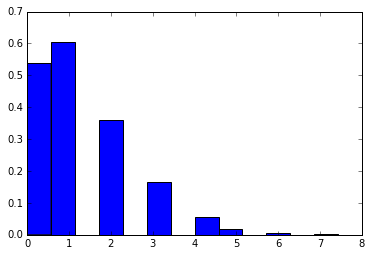

1
2
1
2
1
0
0
2
1
5
1
2
0
0
3
0
2
4
1
3
3
1
3
2
1
3
1
0
0
0
2
1
2
1
0
3
1
1
1
0
1
1
0
0
2
0
0
1
0
1
3
1
0
3
2
0
2
1
2
1
1
2
3
3
1
1
0
0
0
0
0
0
0
0
1
2
2
3
4
0
1
1
2
2
0
5
0
2
0
2
0
1
1
3
1
3
1
1
3
0
2
1
1
2
2
1
1
2
2
1
4
3
3
4
0
2
1
2
1
3
2
0
1
1
0
1
5
3
0
2
1
3
1
0
3
0
1
3
0
0
1
2
0
1
0
2
3
1
1
0
0
1
0
1
2
1
0
2
0
1
1
1
0
1
0
1
0
3
0
2
3
0
1
2
1
1
0
0
3
3
2
2
1
1
1
1
0
0
1
0
1
1
0
0
0
2
0
2
3
1
1
2
3
0
4
0
1
2
6
0
1
0
2
0
2
1
2
0
0
1
2
0
1
0
2
0
1
0
0
1
0
0
1
3
1
3
5
1
2
1
1
0
1
3
1
1
1
1
2
1
1
1
1
1
0
0
1
0
0
2
1
1
0
1
2
1
0
1
2
0
1
0
2
4
2
5
2
3
1
3
2
0
3
4
1
0
2
0
0
2
2
2
1
3
2
0
1
1
2
2
0
2
1
1
2
1
1
0
1
1
1
0
1
3
5
4
3
3
1
3
3
0
1
0
1
0
1
0
3
0
0
0
3
1
1
1
4
0
1
1
0
1
1
0
1
0
1
2
1
0
0
0
0
0
0
1
0
0
0
4
1
0
1
1
2
2
0
2
2
0
4
2
0
2
0
1
2
0
1
3
4
2
4
0
2
0
1
1
2
3
1
5
0
0
3
1
0
0
0
1
1
0
2
1
2
2
1
0
1
2
1
1
6
0
1
2
0
1
2
1
0
1
0
1
1
1
0
0
1
0
0
1
0
0
1
3
1
1
0
2
1
1
3
0
1
0
0
1
0
0
1
0
1
1
0
0
2
2
1
0
0
2
2
1
2
3
2
0
1
2
0
1
1
0
5
0
1
2
0
2
2
1
2
1
1
2
0
0
0
0
0
1
1
0
1
0
2
1
1
1


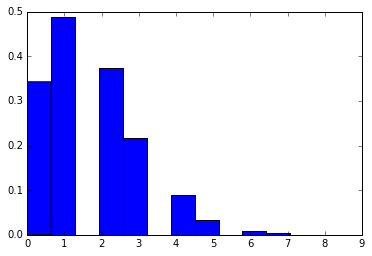

0
0
1
1
1
2
2
0
2
2
2
5
1
4
4
0
1
0
0
3
4
2
1
2
1
1
0
4
1
1
0
0
0
2
1
2
1
2
2
1
1
1
1
2
1
1
1
4
3
1
1
2
0
2
0
1
1
1
1
0
3
1
2
1
3
2
0
1
3
2
1
0
2
1
0
0
2
1
0
0
0
2
0
1
0
3
3
3
4
0
3
0
2
4
3
2
4
1
4
2
1
0
3
3
3
1
3
3
1
2
1
2
2
0
2
4
0
1
1
2
3
3
1
1
0
1
2
1
5
1
2
1
2
1
4
0
1
2
0
1
1
2
1
1
2
1
6
0
3
4
1
4
0
1
0
2
0
1
2
5
5
0
0
1
3
1
1
2
2
3
1
2
1
1
1
5
3
1
0
2
1
2
1
1
4
2
1
2
1
1
0
0
1
1
3
0
2
0
0
0
1
6
3
1
2
4
4
0
2
1
2
3
5
0
0
0
4
3
4
4
1
2
2
3
0
1
0
1
2
0
2
3
2
1
2
3
2
3
0
2
1
1
1
3
6
2
4
3
2
1
1
1
3
0
1
2
1
1
1
1
1
0
2
0
3
0
1
0
0
2
1
0
1
1
0
1
3
2
3
4
3
2
1
2
4
2
0
2
0
2
2
0
2
1
8
1
0
1
0
2
1
2
1
0
2
5
3
2
3
1
6
3
3
4
3
3
2
2
5
1
2
4
2
2
4
5
0
2
1
0
3
0
0
0
1
0
1
1
1
1
0
0
1
1
1
1
4
1
2
1
1
0
0
0
0
0
2
1
1
2
5
0
0
0
2
2
4
3
3
2
4
1
2
2
1
1
2
2
2
0
2
2
1
1
2
3
2
2
2
1
1
4
3
2
1
3
2
0
3
0
0
1
0
0
2
1
2
1
1
1
4
1
1
1
2
1
2
3
1
1
3
2
1
7
3
1
1
3
1
0
2
1
0
0
1
2
0
1
1
1
1
1
3
0
0
0
2
3
0
1
3
2
1
0
2
1
2
1
1
2
1
0
3
1
2
0
1
4
1
1
0
0
3
2
5
2
0
3
0
1
1
1
1
1
0
1
0
0
1
1
4
0
0
2
2
1
2
3
0
1


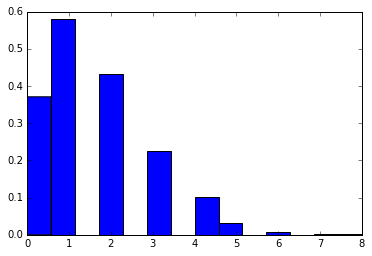

0
0
2
0
0
0
1
0
0
1
1
1
2
2
2
1
1
0
0
0
2
3
2
1
3
2
1
4
1
1
1
0
1
0
2
1
0
2
0
1
0
1
1
2
1
4
0
1
1
4
1
1
2
1
2
0
0
1
0
2
1
2
1
3
0
1
5
2
1
1
0
0
1
1
1
2
1
2
1
3
4
0
0
2
1
2
0
2
1
3
3
1
3
1
3
5
0
1
1
2
3
2
0
5
4
0
1
2
0
3
0
0
3
3
1
3
2
2
1
0
1
2
6
0
2
0
2
3
2
3
1
5
1
5
2
1
0
2
1
3
1
2
3
3
4
1
2
3
0
1
1
2
1
1
1
0
0
0
5
1
1
0
3
4
1
1
1
1
0
1
2
2
2
2
2
2
0
1
3
3
5
0
0
0
2
1
3
1
2
0
0
1
3
2
2
1
3
1
1
5
0
0
1
1
1
4
0
1
1
2
1
5
2
2
1
2
3
2
2
3
2
0
3
2
0
1
1
1
1
3
2
1
0
0
6
2
4
1
2
0
0
3
2
1
3
2
3
3
1
0
1
1
2
0
1
1
1
2
0
1
0
0
3
0
2
3
2
0
0
1
2
0
1
0
0
0
3
1
0
5
1
1
1
1
0
1
2
0
1
1
1
1
2
0
1
2
3
0
0
1
1
2
1
4
3
0
3
1
4
5
2
4
0
3
1
2
2
2
0
0
2
5
0
1
1
3
1
0
4
1
1
2
0
3
1
3
1
1
1
1
1
1
0
1
1
2
1
0
0
1
3
1
2
4
0
0
3
1
0
1
3
2
3
1
1
1
1
1
3
3
2
1
1
2
2
3
2
2
2
3
1
1
1
1
1
2
0
3
2
1
1
2
1
2
1
3
1
1
1
0
1
2
2
6
2
0
0
1
2
3
2
1
3
1
1
0
0
2
3
2
0
2
2
0
2
0
1
2
2
1
1
1
2
1
4
4
2
0
1
2
3
3
3
4
1
2
2
2
1
1
2
2
0
0
1
1
0
3
1
2
2
2
3
2
0
0
1
0
1
1
1
4
2
2
1
4
1
2
1
1
5
1
0
0
0
2
0
0
3
1
1
1
0
2
1
2
1
1
2
3


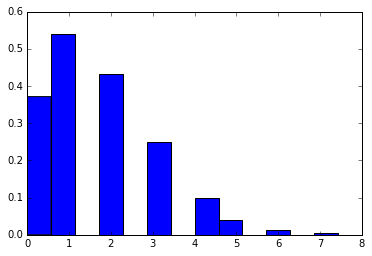

2
2
0
2
1
2
1
2
5
5
1
3
3
5
3
1
1
1
1
0
1
3
1
2
1
2
1
2
1
0
2
1
0
3
2
1
1
1
2
0
0
1
1
3
2
3
0
1
2
0
0
1
0
1
3
0
1
1
0
2
0
1
1
1
1
3
1
0
3
2
1
0
1
0
2
3
0
1
1
3
2
0
0
2
3
5
3
2
0
2
3
1
1
1
0
1
2
5
1
2
0
0
2
0
1
1
5
2
1
0
2
2
1
3
2
2
2
1
0
0
0
0
1
1
0
3
0
2
1
2
0
3
2
3
1
3
0
0
1
1
3
3
2
1
3
1
0
3
0
2
2
2
2
3
0
0
2
2
3
4
2
5
0
3
2
1
1
3
2
2
4
1
3
3
2
1
1
1
5
2
1
0
3
1
1
2
0
1
0
1
0
3
2
0
2
1
0
0
1
0
5
0
0
0
1
0
5
3
1
3
0
1
1
0
2
1
2
2
3
3
1
1
1
1
3
4
0
1
1
1
0
0
1
3
4
1
1
3
3
1
2
4
0
2
3
5
4
3
3
0
2
3
0
3
2
0
0
0
2
2
1
2
1
2
5
1
4
6
1
5
1
1
2
2
3
3
2
5
1
3
3
2
1
1
2
2
2
1
3
2
2
5
0
3
1
4
0
1
1
0
2
2
2
5
2
1
0
4
2
2
2
0
2
2
1
3
0
4
1
0
2
0
1
5
1
2
0
1
1
3
3
2
3
2
3
3
1
3
0
1
1
1
0
2
2
1
0
2
3
4
2
0
1
1
0
0
2
1
0
0
1
2
3
1
1
2
3
4
3
0
3
2
1
1
1
2
3
2
0
3
1
0
2
1
2
3
2
2
1
2
3
1
2
1
0
0
2
0
1
2
1
0
1
1
3
0
3
0
2
3
2
1
3
1
0
2
2
0
2
4
1
1
1
2
4
4
1
2
0
0
2
1
1
1
1
3
1
2
0
0
1
0
3
1
2
1
3
2
2
2
0
2
1
2
4
0
1
1
3
2
2
1
2
0
1
1
0
1
0
2
0
1
1
2
4
0
2
3
3
1
1
1
0
1
4
1
1
1
1
4
1
0
0
3
2
1
0
3
0
0


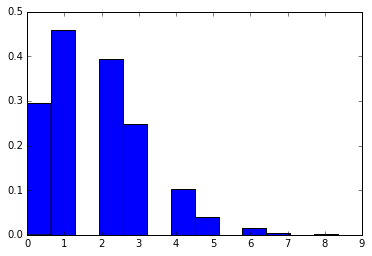

1
1
2
0
1
3
1
3
3
1
4
3
1
2
2
2
1
1
2
4
1
2
2
3
2
2
1
4
1
0
2
2
3
3
0
1
2
0
1
1
0
1
0
2
3
6
0
0
0
3
3
2
2
3
3
0
0
3
1
0
0
1
1
1
1
3
1
1
1
4
1
2
0
2
0
6
0
2
1
5
3
3
0
3
3
0
0
2
3
2
4
3
2
3
1
0
3
3
4
0
1
5
4
0
3
3
2
1
3
6
0
3
3
1
1
0
3
3
1
2
2
4
0
1
0
4
2
1
1
2
3
0
3
2
3
2
0
3
2
3
3
2
1
1
0
1
3
2
4
4
0
1
0
3
1
1
0
0
3
1
3
2
3
0
2
0
3
0
3
2
2
0
1
1
0
3
1
2
5
0
2
5
1
3
3
1
2
3
2
1
0
0
0
3
2
1
1
1
1
0
0
0
1
1
5
2
3
2
3
1
2
1
1
2
2
2
2
2
0
1
3
3
0
3
2
0
3
0
0
1
2
1
1
1
1
5
3
2
2
3
1
3
4
1
5
0
2
1
0
1
0
1
1
2
1
2
1
1
1
0
1
1
2
1
2
1
2
1
3
2
5
0
2
1
1
0
0
3
1
1
3
2
0
1
0
0
0
3
3
1
2
1
2
2
2
0
1
3
0
1
1
2
3
1
3
2
1
1
0
0
1
0
2
1
1
4
2
2
1
3
5
0
3
6
0
2
0
3
0
1
2
3
1
4
0
1
0
1
2
3
0
1
4
3
0
0
1
6
1
0
1
1
2
1
2
2
6
1
1
2
0
2
2
0
2
0
3
2
2
1
1
1
2
2
1
5
2
2
2
2
0
3
3
4
1
2
1
3
1
0
3
0
1
2
3
2
2
1
1
1
0
2
1
3
2
1
4
1
1
4
1
0
2
0
1
2
3
2
3
3
2
4
0
3
2
0
0
0
2
1
2
0
1
0
2
0
4
5
2
2
2
1
1
2
1
2
5
2
2
1
2
2
0
0
3
0
2
2
1
2
1
1
0
0
3
1
0
2
0
2
3
0
1
2
2
0
1
1
2
1
0
1
4
1
2
2
2
2
3
1
0
0
1
3
2
3
2
3
2
0


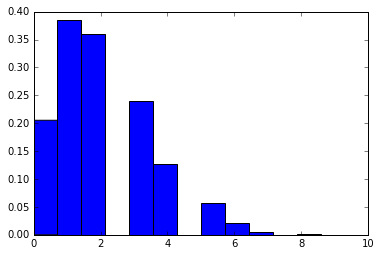

3
1
3
1
2
0
0
0
2
0
3
4
4
4
0
1
5
0
0
3
5
0
1
0
3
1
1
2
1
1
2
2
0
1
3
1
0
3
4
3
4
5
1
3
5
0
2
1
0
2
1
1
3
1
0
3
3
1
1
3
2
1
4
4
1
1
2
1
2
1
1
0
1
2
4
2
2
1
3
3
2
1
0
1
1
1
4
0
2
2
1
2
4
1
2
4
0
5
0
4
1
3
4
3
0
0
1
1
0
1
3
5
4
3
3
3
3
2
4
1
6
1
1
1
4
4
2
2
3
1
1
1
1
1
3
1
3
4
1
1
8
3
2
4
3
0
1
1
0
4
3
2
3
0
1
0
2
3
1
1
1
1
1
3
2
1
2
1
2
2
2
1
2
0
2
1
3
2
2
4
1
2
1
1
1
0
3
3
0
2
0
5
0
2
2
3
1
0
4
2
0
5
0
1
3
1
3
6
3
2
3
0
2
2
4
3
1
0
1
3
3
3
1
3
3
1
0
2
0
2
1
1
0
2
0
0
2
1
2
4
3
2
5
3
3
1
0
3
2
2
0
1
2
3
1
0
2
6
2
3
2
2
4
3
5
1
1
5
1
4
1
2
4
0
1
2
3
3
2
0
1
4
0
0
6
1
1
3
3
2
3
1
1
1
5
2
0
0
1
0
2
1
1
4
2
2
1
4
1
0
2
2
2
3
1
4
1
3
1
1
2
2
5
1
0
3
0
4
2
3
4
0
2
4
5
2
2
1
4
3
4
4
2
5
3
2
3
1
1
2
2
1
3
1
1
2
2
1
3
2
2
2
1
2
1
3
2
0
1
3
2
1
4
6
4
1
2
5
2
0
2
4
0
4
1
4
1
3
0
1
2
5
3
2
4
4
3
2
1
3
5
2
1
2
0
3
4
2
4
1
2
3
1
1
1
0
1
3
0
2
0
3
1
4
2
1
2
3
0
5
3
3
2
2
2
0
2
1
2
1
3
1
2
2
2
2
0
2
2
4
0
2
0
1
2
0
1
2
4
1
0
3
1
0
1
0
3
0
4
3
3
2
3
0
2
1
0
1
4
1
2
0
2
0
1
1
0
3
5
0
1
1
5
3
1
2
6
4
1
1


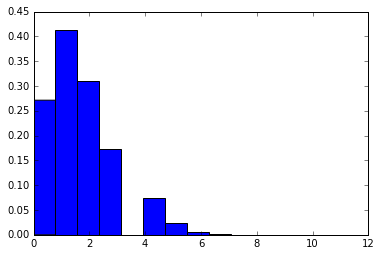

0
1
1
2
1
1
3
1
3
0
2
2
2
2
2
1
2
3
1
3
0
1
1
0
1
0
1
1
1
1
0
4
2
4
0
2
1
0
4
0
1
3
0
1
2
1
3
0
1
1
0
2
2
0
1
1
3
0
2
1
1
1
0
1
3
1
1
1
2
1
0
1
1
1
3
1
1
1
2
3
1
1
2
2
0
3
3
0
2
2
1
0
0
1
2
0
2
1
2
4
2
1
0
1
1
4
2
1
0
2
1
0
2
2
2
2
1
3
2
0
3
0
3
4
1
1
3
0
1
3
0
1
0
0
2
1
2
0
0
2
4
1
1
1
1
2
2
2
0
0
0
4
2
0
1
0
0
3
1
1
3
3
2
1
3
2
2
2
3
3
5
0
1
1
2
2
0
0
3
2
1
2
1
0
1
1
1
1
2
0
1
0
2
4
1
1
0
1
1
1
3
0
1
1
1
1
0
2
4
0
0
1
2
2
5
4
1
0
0
3
3
2
1
2
1
0
5
2
3
0
1
4
0
1
4
3
3
1
1
1
2
2
3
1
2
3
1
1
4
0
0
2
0
3
1
4
4
0
1
1
1
1
2
3
4
0
5
0
0
2
1
1
0
1
2
2
2
1
2
2
1
0
0
0
2
0
0
0
5
1
1
1
3
2
0
0
1
3
1
2
1
0
1
0
1
1
1
1
4
3
1
1
2
2
5
2
2
0
3
1
1
4
1
2
1
3
1
0
0
2
2
1
2
3
1
2
3
2
3
1
0
2
3
1
1
4
1
0
0
0
2
1
3
2
1
0
2
1
2
3
0
3
2
2
3
1
1
0
2
0
3
1
1
1
1
3
3
2
4
0
2
3
0
0
1
2
1
3
2
1
1
3
2
1
4
1
3
1
2
1
3
0
1
0
2
1
2
1
2
0
1
3
3
3
3
2
1
0
1
2
1
5
0
2
2
0
1
2
1
0
1
0
0
0
3
3
3
1
3
3
0
1
2
0
0
1
0
3
2
0
0
0
1
0
1
0
2
2
0
1
1
3
2
1
4
2
1
2
2
1
2
1
3
2
4
0
1
1
1
3
1
2
3
2
0
1
1
1
0
0
1
0
0
1
1
1
2
0
2
1


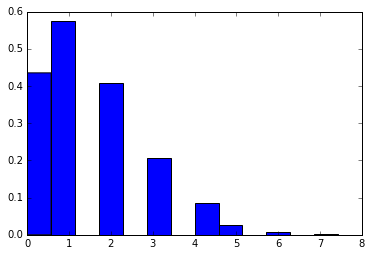

2
0
5
0
0
2
1
0
6
2
2
1
2
1
1
4
2
0
0
3
0
0
1
1
6
3
2
3
0
1
2
1
0
3
3
2
2
1
3
0
3
0
0
0
2
1
2
0
1
1
0
2
2
1
1
0
1
3
4
2
1
2
2
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
2
0
1
0
1
1
1
1
2
2
3
3
2
2
1
2
2
2
0
3
1
0
3
2
1
2
3
2
3
1
0
1
2
4
3
4
4
3
1
1
0
0
1
2
2
0
0
1
2
1
1
2
1
1
2
0
0
0
0
3
2
2
3
1
3
2
1
1
1
0
0
3
1
2
3
3
2
2
1
2
2
0
0
0
5
2
1
1
3
0
0
2
0
1
0
2
2
0
0
0
3
1
0
1
0
2
0
1
2
0
1
0
3
2
1
3
1
1
1
3
1
0
0
0
2
0
1
2
3
2
1
2
4
3
3
0
0
1
0
3
1
1
2
2
3
2
2
1
0
1
1
1
0
0
0
0
2
0
1
0
1
1
2
1
5
3
0
2
3
5
2
2
1
2
0
0
3
1
0
1
0
0
0
1
0
0
0
1
2
1
1
1
0
1
1
2
1
1
3
2
3
1
3
2
6
1
0
0
2
0
1
1
1
0
1
1
1
0
2
0
1
2
0
0
1
1
1
2
2
1
1
4
2
1
3
2
1
4
0
3
1
4
2
1
2
2
2
1
0
0
1
3
0
3
0
2
1
3
1
1
0
0
1
1
2
0
0
0
2
1
1
0
0
2
0
1
1
3
1
3
1
3
1
1
0
3
1
2
1
4
3
2
2
0
1
0
3
4
1
2
1
3
1
2
2
1
2
4
1
3
2
3
2
1
1
1
4
0
4
3
2
4
1
1
1
0
0
3
1
0
3
2
1
0
0
0
3
1
2
1
2
0
0
1
2
0
3
1
0
1
0
0
2
0
1
0
1
5
0
1
3
2
3
1
4
4
0
5
1
4
2
2
1
2
1
0
0
1
0
0
1
1
2
1
2
0
0
0
2
2
1
1
1
2
1
3
1
4
3
1
2
0
0
0
2
1
0
1
1
4
0
1
0
0
0
2
2
1
2
2
1
2


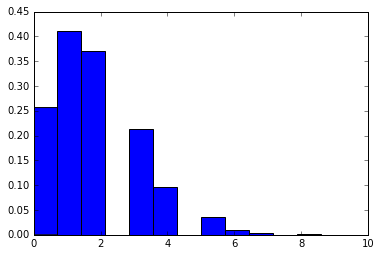

3
1
0
1
1
0
0
0
2
1
1
4
2
2
0
3
2
1
1
3
3
2
4
3
6
1
3
1
2
3
1
2
1
1
3
3
2
2
1
2
0
2
0
3
1
0
2
1
0
2
1
0
0
4
0
1
0
1
1
2
1
2
2
0
0
0
0
2
1
1
2
1
1
2
1
4
1
2
1
1
2
0
2
1
2
4
0
1
1
2
2
2
0
3
2
2
2
4
1
4
0
2
5
3
0
0
3
0
2
2
2
5
2
2
0
3
1
1
2
2
4
2
1
0
0
3
2
0
2
0
3
4
2
2
0
2
1
3
2
4
1
3
3
0
4
1
3
3
5
4
5
1
0
0
3
3
1
2
4
2
2
0
0
3
2
2
3
1
1
1
1
1
1
0
0
2
3
5
0
1
1
0
1
3
1
3
4
1
0
0
3
2
0
2
0
2
0
2
0
3
1
3
0
4
3
2
0
3
3
0
2
2
2
0
0
1
1
2
2
2
1
1
1
3
3
0
2
2
1
2
4
0
3
0
1
2
4
5
1
1
2
2
3
4
3
2
7
2
3
2
0
1
1
3
3
2
2
0
1
1
3
1
0
5
3
1
3
2
0
2
1
1
3
0
4
1
1
4
2
4
1
0
2
1
4
2
4
4
0
1
2
0
2
2
1
0
1
0
1
3
2
3
3
3
2
0
0
2
3
0
2
0
2
5
2
1
2
2
2
0
2
1
0
3
1
5
1
1
0
3
4
0
6
4
1
2
0
3
0
1
1
1
2
0
1
3
0
1
3
3
3
1
3
2
0
0
0
1
1
0
3
2
1
3
3
2
0
1
1
2
2
3
1
0
3
0
1
1
0
3
4
1
2
1
3
1
0
1
0
0
3
2
4
6
3
2
2
2
0
2
3
2
2
0
1
2
3
1
1
3
2
3
0
1
0
2
0
2
2
1
3
0
3
2
3
3
2
1
2
2
0
1
0
0
2
1
1
1
0
3
0
0
3
4
3
0
2
1
2
2
2
1
3
2
0
0
0
0
4
4
0
1
3
3
0
2
1
2
0
1
0
0
1
2
0
0
4
0
2
2
1
1
2
1
2
1
2
1
3
1
0
1
3
2
2
1
0
5
5
2


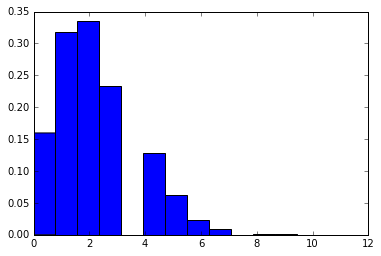

2
0
2
0
4
4
2
2
1
3
1
1
0
3
2
1
0
2
0
0
4
3
5
7
2
2
1
2
1
1
3
0
0
3
1
3
1
0
3
0
3
3
1
4
2
2
3
2
0
3
1
2
1
3
1
1
0
2
0
1
2
1
3
2
3
1
2
1
3
3
2
3
3
2
1
3
0
2
3
3
0
0
2
1
2
1
3
4
5
2
3
3
0
4
1
3
2
2
3
3
2
1
4
4
2
3
2
3
2
5
1
3
1
2
0
3
3
2
2
2
4
0
1
0
2
3
2
1
2
1
4
6
1
1
1
1
4
1
0
2
2
3
3
1
2
7
2
5
3
3
4
1
2
6
1
1
3
3
1
1
4
3
1
5
4
0
1
0
1
2
4
2
2
2
0
2
2
2
0
2
1
1
1
0
0
1
1
3
1
2
3
2
2
2
1
0
4
2
2
7
0
2
4
3
4
5
3
2
2
2
1
2
5
0
1
6
2
0
2
1
1
1
0
1
3
0
1
2
2
3
2
3
4
5
1
4
5
1
0
3
4
0
2
1
0
8
3
3
0
0
2
2
2
2
4
2
1
1
1
2
1
2
2
3
1
1
4
3
3
1
5
1
1
3
0
1
6
2
4
2
2
0
1
0
1
3
1
2
0
1
4
5
1
2
1
1
0
1
1
1
1
4
1
4
3
1
4
3
3
5
7
1
2
0
3
1
2
1
1
3
2
2
3
3
2
1
3
1
2
4
1
0
4
3
2
5
1
3
2
0
4
1
2
2
1
2
1
1
2
2
0
2
3
3
2
3
1
0
3
1
1
1
1
3
3
1
1
2
2
3
3
4
4
2
3
1
2
0
2
2
3
1
0
3
1
1
3
3
3
1
0
6
3
1
1
5
4
3
5
3
3
3
1
8
2
1
3
2
0
3
0
3
3
0
0
4
1
1
3
2
1
2
2
1
1
0
3
2
1
2
1
1
5
1
1
1
2
3
1
2
1
3
1
4
3
1
2
4
3
1
1
2
0
1
0
1
1
4
1
1
4
1
1
3
0
3
1
1
2
1
2
2
2
2
0
2
2
1
1
6
2
2
4
3
4
1
0
3
3
3
3
2
0
5
1
4
1
1
2
4


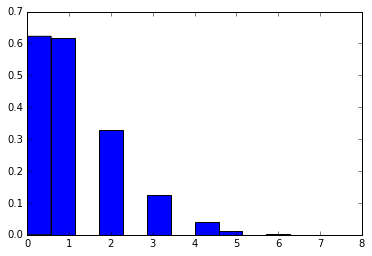

1
0
0
0
2
2
1
0
2
1
1
0
0
3
1
1
0
0
1
1
1
1
0
1
2
1
0
0
1
1
1
1
2
1
3
1
2
4
1
0
1
0
0
1
0
2
2
1
0
2
0
1
0
1
1
2
0
1
1
1
0
1
1
1
2
3
0
1
1
2
0
2
1
1
0
0
1
0
2
3
0
4
1
1
0
0
2
1
0
2
0
3
0
3
1
0
2
2
2
3
1
4
3
0
2
1
2
0
1
1
3
2
1
5
0
1
2
1
0
0
3
2
0
3
2
1
1
1
2
0
0
1
1
0
0
1
2
0
1
3
0
0
0
2
0
3
0
0
0
1
1
0
0
2
1
2
2
2
2
1
2
2
1
2
1
1
2
1
1
0
2
0
2
1
0
0
0
3
1
1
1
0
1
1
0
0
0
4
0
1
2
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
2
0
3
2
4
1
2
0
1
0
0
0
0
1
1
2
0
1
0
0
0
2
0
1
0
1
1
0
3
1
0
2
2
1
3
1
2
3
1
0
1
0
3
0
0
0
2
0
1
0
0
1
1
0
2
0
1
0
1
1
0
1
2
1
1
2
2
0
1
1
0
5
0
1
1
2
2
2
3
3
1
2
3
4
2
0
1
1
0
1
0
1
2
1
0
1
1
2
4
2
0
1
1
4
2
0
1
0
4
2
0
2
2
1
3
2
1
2
0
0
1
1
2
2
3
0
2
2
4
0
1
2
0
2
1
0
0
1
0
0
2
0
1
1
0
0
0
2
2
0
0
1
0
3
1
1
2
2
2
1
3
1
1
2
0
2
0
1
1
0
2
2
4
2
0
1
1
3
2
2
3
0
2
2
3
2
2
0
2
1
2
2
0
2
3
0
0
0
0
0
2
1
1
1
3
2
1
0
1
0
1
3
0
1
1
0
0
1
0
0
1
2
0
1
3
0
0
3
2
0
0
2
3
0
4
2
2
0
1
2
1
5
0
2
0
0
2
2
4
1
1
0
3
1
1
1
1
1
1
1
0
1
1
0
0
1
0
0
3
0
0
0
0
3
0
0
1
2
0
1
1
0
0
2
1
1
1
1
4
0
0
1
1
0


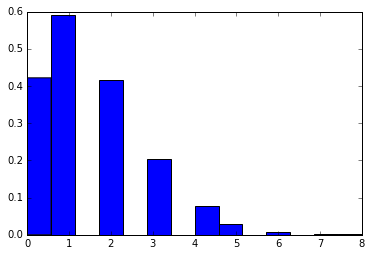

1
2
4
1
1
3
0
1
2
2
3
1
1
2
1
1
0
1
1
0
1
1
2
0
3
1
1
2
1
1
1
2
3
0
1
2
1
3
3
2
0
0
2
0
1
1
1
0
0
0
0
2
1
1
0
0
3
1
0
1
0
1
1
1
2
1
1
0
2
0
2
3
1
3
1
2
3
0
2
0
0
0
0
0
0
0
0
3
1
0
0
1
1
3
1
1
1
3
2
1
1
0
0
1
4
3
2
6
2
2
1
0
1
3
1
1
3
2
1
1
1
0
0
2
0
1
3
5
0
1
5
1
2
1
2
3
1
2
1
2
2
1
0
3
0
0
2
0
3
2
0
0
1
5
1
3
0
2
0
2
2
2
2
1
1
1
1
1
2
1
2
3
0
1
1
2
0
1
2
1
0
1
1
1
1
0
1
1
2
1
0
1
2
1
0
1
2
2
1
1
1
3
1
4
1
1
0
1
0
0
4
4
2
0
2
2
1
0
2
0
1
1
2
2
0
1
0
0
3
0
1
1
4
3
2
3
1
2
4
3
2
1
1
1
2
2
1
2
1
1
0
2
0
1
1
3
1
1
1
1
1
2
1
4
0
1
2
1
1
2
1
2
1
2
0
3
0
1
0
1
1
3
3
2
2
0
0
1
1
1
0
1
5
1
0
2
1
0
1
0
2
4
5
1
1
1
2
3
1
0
2
0
1
1
0
0
1
2
0
3
3
0
4
1
0
0
2
3
2
0
1
2
1
0
2
2
2
2
0
0
0
1
0
0
0
1
1
2
0
0
1
0
0
1
1
0
1
1
2
1
1
3
0
4
0
1
3
2
1
2
1
2
1
0
3
0
2
1
2
3
3
0
0
0
3
2
0
3
2
2
2
2
3
1
3
2
0
1
0
2
0
1
5
2
4
0
3
2
1
3
1
1
0
1
1
1
0
1
1
1
0
0
0
1
3
2
1
1
2
1
1
3
1
2
0
0
1
1
1
0
6
1
1
3
0
0
2
1
1
0
0
1
1
1
1
0
2
1
0
0
1
1
2
0
1
0
0
0
3
2
1
1
2
1
2
1
2
1
2
1
0
1
2
4
2
1
1
1
0
0
0
0
4
1
2
2
0
2
0
1


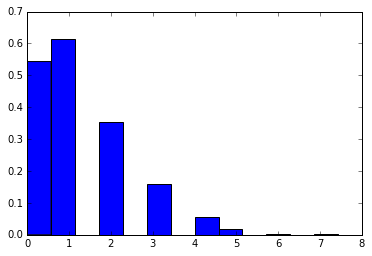

1
1
0
1
1
0
1
3
4
1
1
1
0
1
3
0
1
1
0
1
1
1
0
2
0
3
0
1
5
0
0
4
3
0
1
2
0
1
2
1
1
0
5
3
1
0
1
1
1
1
0
0
1
0
1
2
0
2
0
1
1
0
1
1
0
2
1
1
0
0
1
0
1
1
0
4
0
0
3
1
2
4
4
1
1
8
2
2
3
1
0
1
3
0
1
0
1
2
2
3
2
3
1
0
1
2
2
1
6
1
3
2
1
2
1
2
3
0
2
1
1
1
1
1
0
2
1
0
0
0
1
1
0
2
0
3
0
0
1
0
3
1
0
1
0
1
1
1
1
1
3
1
0
1
0
3
4
1
1
1
1
0
1
2
3
2
0
2
3
0
0
1
1
2
1
0
2
0
3
1
0
1
2
0
0
1
1
2
0
0
2
2
2
2
0
1
0
0
1
0
3
0
0
0
2
0
1
0
1
1
2
0
3
3
0
2
1
0
1
2
2
1
3
0
1
0
0
0
0
1
2
0
0
0
3
0
0
1
0
0
2
1
2
3
3
4
1
1
0
1
0
1
0
1
0
1
1
2
1
1
0
0
0
1
1
1
4
0
2
1
0
2
0
1
1
0
0
0
3
0
2
2
1
3
0
0
2
1
1
1
1
0
0
0
0
0
0
1
1
3
2
2
2
3
3
3
2
0
1
1
2
2
2
2
2
1
0
1
3
1
2
1
2
7
0
2
2
2
0
2
3
4
0
1
4
2
4
2
0
0
0
1
2
2
0
0
2
0
0
0
0
1
3
0
0
0
1
0
1
0
1
1
0
0
3
3
2
2
3
0
5
0
0
1
1
2
0
2
1
2
1
1
2
1
1
2
0
0
3
4
1
3
1
3
1
1
1
0
2
2
1
0
2
0
3
2
1
1
5
2
3
1
1
2
1
1
1
0
0
0
1
1
2
2
0
1
1
1
4
1
0
0
0
0
2
0
0
5
0
0
0
2
0
2
1
1
0
0
1
1
0
3
1
3
1
0
0
1
2
0
0
0
2
3
1
0
0
0
0
1
1
0
0
2
1
0
1
0
1
0
1
1
0
2
0
0
1
0
2
2
0
0
2
0
1
2
0
0
0
2


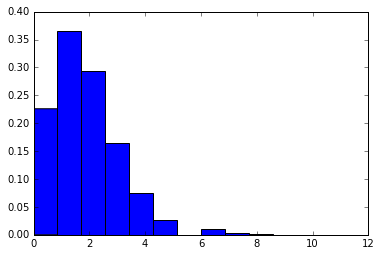

1
2
2
1
0
1
2
1
2
2
3
1
0
4
4
3
4
0
1
1
3
1
3
2
1
1
3
0
0
2
0
3
4
2
2
0
1
0
4
3
1
3
4
3
1
3
1
0
3
1
3
2
2
3
3
0
2
2
0
3
2
1
1
1
2
1
0
1
2
1
1
1
3
0
0
2
3
0
0
0
4
0
1
0
0
0
2
0
2
1
0
3
2
0
1
1
4
4
0
4
5
1
3
2
1
5
4
1
2
1
3
4
1
2
0
1
3
2
0
1
0
2
4
1
2
1
0
2
1
0
3
2
1
1
0
2
2
2
5
1
1
0
1
3
3
1
6
2
0
3
1
3
3
6
5
1
3
1
1
0
4
1
1
1
1
0
1
1
0
1
2
0
2
0
3
1
0
1
5
2
1
2
3
0
3
1
2
1
1
1
0
0
1
1
0
1
1
3
2
2
2
3
2
2
2
2
0
2
1
1
4
1
2
3
1
2
1
2
1
0
2
4
2
3
0
0
1
1
1
3
0
1
0
0
1
4
0
1
0
3
2
2
3
2
1
2
1
3
2
2
2
3
2
1
1
0
2
2
0
0
1
0
4
1
0
0
1
0
4
3
2
1
1
1
2
3
1
1
1
4
2
0
1
1
1
2
3
2
1
4
1
3
2
1
2
2
1
5
4
2
1
2
0
4
3
2
4
0
3
2
4
2
0
1
1
2
4
2
1
0
3
2
2
0
3
3
2
3
2
6
2
2
3
1
1
2
3
1
0
1
0
0
2
0
0
1
2
0
2
4
0
2
0
1
2
1
2
1
1
2
0
3
1
1
2
3
1
1
2
3
0
1
5
0
4
6
3
2
1
1
1
3
1
3
2
3
2
2
0
3
2
0
1
0
3
1
3
2
1
2
4
1
2
3
0
2
2
1
0
0
1
2
2
1
0
2
0
2
1
3
0
2
1
1
2
1
4
2
1
1
0
1
1
1
1
3
2
0
1
4
1
0
1
3
1
1
0
4
3
0
1
2
1
1
0
3
0
1
5
0
2
1
0
1
0
0
1
2
1
2
1
0
3
1
4
1
1
1
2
0
1
3
2
1
2
2
4
1
4
1
3
2
1
1
0
0
1
2
2
1


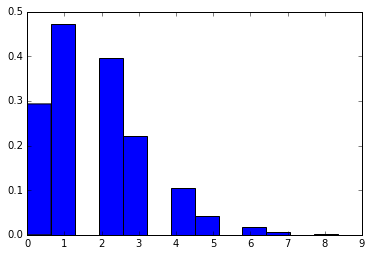

1
0
0
1
2
0
1
1
2
3
1
0
0
1
5
1
0
1
1
2
3
2
2
2
2
3
4
2
1
3
4
1
2
1
5
2
1
0
3
0
4
1
2
1
3
4
4
4
6
1
1
2
0
1
2
4
7
0
1
4
0
1
2
2
1
4
3
0
1
3
1
1
1
2
1
3
1
3
3
0
1
1
2
0
2
1
0
1
2
1
2
0
1
0
0
2
3
2
1
1
2
1
0
0
3
3
0
2
5
3
1
0
3
1
3
2
1
3
0
5
2
2
2
0
2
2
2
3
3
6
2
2
1
1
1
2
3
1
0
0
1
0
1
1
1
2
2
1
1
1
2
2
0
0
0
4
0
0
0
1
1
2
1
0
3
3
1
2
0
1
3
2
2
0
1
3
0
2
5
6
0
6
3
7
3
1
0
2
1
5
2
1
3
2
1
2
1
2
2
2
3
3
0
1
2
3
1
1
0
0
7
3
6
0
4
5
2
1
4
0
2
1
2
4
4
2
3
1
2
5
2
1
0
2
1
3
3
4
2
2
2
1
1
2
2
1
0
2
2
3
4
1
0
0
1
1
1
4
2
2
2
3
3
3
1
3
2
4
2
3
1
0
3
4
1
1
0
2
1
3
2
2
1
1
2
2
1
2
0
1
1
0
3
2
0
1
0
2
0
1
1
3
2
2
5
1
1
0
1
3
2
1
2
2
4
0
0
4
1
1
2
2
4
0
1
2
1
1
3
2
0
1
1
3
0
4
0
1
1
1
3
0
2
4
0
2
2
3
2
2
2
1
1
2
4
3
6
3
2
2
2
4
6
2
1
1
3
8
4
2
0
2
3
4
2
0
0
1
2
0
0
5
2
2
7
1
0
1
2
3
1
0
4
5
3
4
2
3
0
0
2
1
2
2
2
0
1
3
1
1
1
2
0
1
2
2
0
4
0
1
0
1
1
1
2
3
1
2
0
0
4
4
3
0
2
2
3
3
5
0
2
1
2
6
2
1
1
1
0
1
3
4
2
0
0
1
2
0
3
3
2
3
2
1
2
2
2
1
1
0
0
4
3
3
2
2
0
4
1
3
5
4
2
2
1
1
2
3
0
0
1
0
3
3
3
2
2
4
2
0


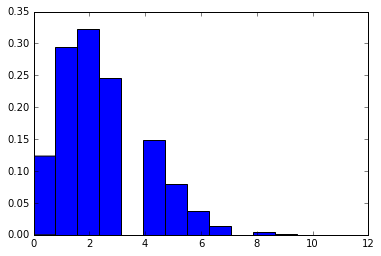

2
3
1
0
2
2
2
5
6
2
3
1
1
2
2
2
2
1
3
2
1
1
2
2
5
2
2
2
1
3
2
3
6
0
2
5
7
1
2
2
6
3
3
3
5
1
3
2
0
4
2
2
2
2
0
2
2
5
3
1
4
0
2
3
2
2
3
1
3
0
0
1
3
2
0
0
0
0
3
0
0
1
0
0
4
5
2
1
4
2
3
1
3
5
2
2
1
2
2
5
2
0
1
3
1
3
3
2
2
2
3
4
1
4
0
0
0
8
3
3
3
1
2
1
1
4
1
4
3
3
1
4
3
4
4
2
4
2
1
2
3
1
3
2
3
2
0
5
1
2
0
3
5
4
5
2
3
4
2
2
2
1
5
3
3
4
3
4
1
1
6
1
3
3
1
2
1
4
3
3
3
1
0
2
3
1
1
4
3
1
4
1
4
1
0
1
0
1
2
0
2
3
2
4
3
3
2
3
4
2
4
2
1
6
3
3
2
1
1
0
1
1
1
3
2
2
2
3
4
2
2
6
3
1
5
0
6
3
1
4
4
4
7
1
4
2
4
6
4
1
7
2
2
4
3
3
5
4
2
4
3
3
0
3
3
2
5
3
2
3
0
2
4
2
2
4
3
4
2
4
4
4
3
2
6
1
3
2
3
6
6
1
8
3
2
3
0
2
2
4
6
2
2
0
1
3
3
4
1
5
5
4
2
2
4
4
0
2
2
2
4
5
2
2
3
7
7
2
4
2
1
6
5
3
2
3
0
2
1
4
3
2
2
3
7
1
3
2
3
2
6
3
2
1
3
7
5
6
6
3
5
3
4
3
2
3
3
2
0
4
0
1
2
1
4
2
2
2
2
4
1
3
3
4
2
1
3
4
1
2
0
2
3
2
1
5
2
6
0
1
4
2
1
1
0
0
3
1
2
5
2
2
0
3
2
1
1
3
3
3
5
3
1
1
4
1
1
1
1
3
2
3
2
1
1
2
5
3
3
2
3
1
2
3
3
5
0
2
3
4
4
5
2
6
1
4
1
2
2
1
5
0
7
1
1
2
1
3
2
1
2
6
0
2
1
1
2
5
1
2
6
3
1
0
1
4
0
7
3
1
4
4
2
4
1
2
3
1
1
1


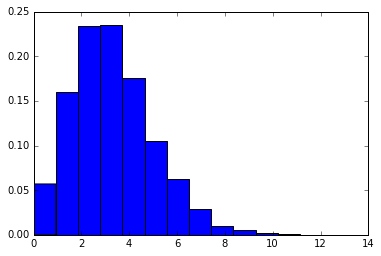

3
4
0
3
1
4
2
1
3
5
5
2
7
1
4
3
3
3
4
2
2
6
2
4
4
1
4
2
3
1
6
2
3
2
7
5
7
5
4
5
5
7
0
2
5
4
5
4
6
4
2
3
1
3
1
1
6
3
3
2
4
6
1
2
9
2
7
4
5
4
2
2
2
5
3
3
4
5
7
2
1
5
5
5
1
3
1
7
5
1
2
3
3
4
3
5
2
4
0
4
2
2
2
0
4
7
4
1
2
4
2
4
1
4
5
1
2
2
4
4
2
2
2
6
6
3
5
3
2
1
0
5
1
2
3
4
0
4
6
3
4
6
4
2
4
2
2
1
2
6
3
2
3
3
2
2
1
3
4
3
4
4
4
2
6
3
3
6
3
2
2
3
1
7
2
1
6
5
3
5
3
1
2
3
5
1
2
3
5
5
3
4
3
4
2
4
4
2
3
3
4
1
2
4
2
3
6
6
0
5
8
5
3
4
6
3
5
3
2
1
1
2
4
2
3
5
4
0
2
3
1
4
2
3
2
6
4
2
10
1
3
3
3
8
5
5
2
4
7
1
2
1
4
2
1
5
3
6
2
4
7
2
2
4
3
4
5
5
4
1
3
4
2
2
3
2
2
2
3
4
6
3
4
1
3
1
3
7
2
1
5
5
2
2
2
3
1
3
1
2
6
2
3
2
2
3
2
5
2
4
5
2
8
2
2
2
3
7
3
4
4
1
3
6
4
1
3
1
2
0
4
4
3
3
4
2
1
4
8
5
3
2
3
2
3
2
3
6
6
3
1
1
7
5
6
7
2
9
6
3
1
4
2
2
1
2
2
4
7
4
4
2
2
2
1
5
3
2
4
4
5
1
2
6
2
2
2
3
4
5
3
6
5
3
3
1
3
3
3
3
1
2
7
4
2
2
7
4
4
4
2
3
4
6
2
2
2
3
6
5
2
5
2
3
1
4
3
1
9
4
6
3
4
4
4
8
3
6
6
7
4
4
5
3
4
4
6
1
2
1
2
2
2
1
3
5
3
1
6
5
2
3
2
1
3
2
1
1
7
4
3
1
2
4
1
2
3
5
1
4
4
2
0
6
3
3
2
4
2
4
2
2
1
4
2
3
4
3
2
0

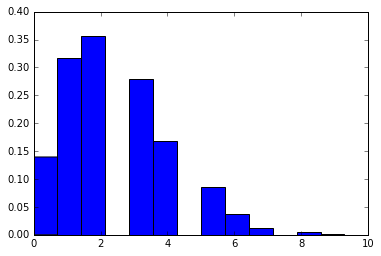

1
2
1
1
0
0
4
3
1
2
0
1
4
2
0
5
2
2
1
2
2
2
1
2
0
1
2
1
4
2
7
3
1
3
4
2
6
1
5
3
5
3
3
3
3
1
2
4
5
5
5
2
1
3
1
3
3
1
2
1
4
3
1
2
5
4
2
3
4
3
0
1
0
1
1
2
1
1
5
4
1
3
1
2
3
4
0
4
1
3
4
2
2
3
4
3
1
5
2
4
3
3
1
2
1
3
5
2
8
10
0
0
1
0
2
1
1
1
2
5
1
1
1
4
4
2
6
3
4
2
2
3
3
0
3
2
2
2
0
4
1
1
3
0
1
4
3
3
2
0
0
1
0
0
2
3
3
1
2
3
2
2
2
2
1
4
3
4
2
6
1
2
1
5
0
2
4
7
1
2
2
3
1
5
1
3
0
2
0
2
1
0
0
0
2
2
1
1
1
1
1
2
0
1
3
0
2
1
2
1
3
5
1
5
1
0
2
6
3
1
4
2
1
2
5
2
4
1
3
3
4
2
3
0
1
3
2
1
3
2
0
8
3
1
2
6
2
4
3
3
4
2
5
1
1
4
2
2
2
1
3
3
6
6
2
5
5
4
1
2
2
1
3
6
0
4
5
5
1
3
0
3
3
4
1
2
1
5
1
2
4
6
2
3
1
3
2
4
5
1
6
3
3
2
4
3
1
2
2
2
3
2
0
4
2
1
1
3
1
1
8
2
3
2
4
1
4
0
3
1
2
3
3
5
1
2
2
3
0
1
0
1
2
2
3
2
2
5
4
2
5
1
4
5
4
4
2
1
4
3
3
5
2
0
2
1
1
2
3
1
0
2
0
0
4
1
2
0
2
1
0
3
4
2
4
1
3
2
2
5
0
3
1
2
2
2
0
1
2
0
1
1
2
3
0
2
5
1
2
3
2
4
1
1
3
0
1
1
6
4
4
5
3
5
2
1
4
0
3
2
5
7
2
2
1
3
5
1
2
5
1
4
4
0
2
5
2
3
3
4
2
3
0
1
1
1
5
1
2
2
5
4
4
2
0
5
2
3
2
3
1
2
4
2
1
2
3
3
0
4
2
6
0
2
1
1
2
1
4
0
3
2
3
2
1
5
3
3
1
2

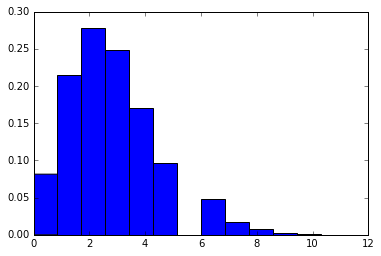

2
2
3
1
3
0
1
0
3
6
1
5
3
2
3
7
1
3
2
3
3
5
2
4
5
0
1
0
2
0
1
4
1
7
2
4
2
4
3
6
6
4
1
9
6
3
3
6
6
2
3
3
6
1
7
2
1
6
4
2
4
1
1
4
5
5
2
3
2
4
1
3
3
1
0
0
3
5
2
1
1
2
1
6
0
3
2
7
3
1
2
3
2
3
3
1
8
2
3
1
3
3
0
1
0
4
4
8
4
2
1
3
0
2
2
4
2
0
3
6
3
3
1
8
2
2
3
2
1
2
1
4
2
1
4
1
2
1
4
2
3
2
1
1
3
2
1
2
2
2
2
3
2
0
2
5
4
3
2
3
0
3
3
5
2
6
5
6
4
1
1
1
2
2
2
1
0
2
5
3
3
2
0
2
2
3
3
5
2
1
1
1
0
3
1
2
3
2
1
5
1
2
1
3
4
2
7
0
2
4
3
0
4
5
4
1
1
3
3
2
3
3
2
1
4
2
4
3
3
4
1
0
2
3
3
0
4
1
2
1
6
0
1
8
2
4
2
6
6
1
3
4
2
3
8
5
1
3
0
3
4
2
4
4
0
3
1
3
3
2
4
1
1
1
3
4
2
1
1
3
2
2
1
3
3
3
3
1
7
3
3
6
4
2
2
3
2
4
2
5
3
0
2
5
1
5
4
3
2
2
2
2
2
1
1
1
5
11
1
2
4
4
6
2
3
2
3
2
1
1
0
5
5
4
4
8
7
2
1
1
5
7
4
2
4
4
0
6
5
2
4
1
1
2
7
7
3
4
7
3
5
1
4
3
4
4
2
1
5
7
2
1
3
1
0
0
3
2
3
3
1
3
2
1
3
4
4
1
1
2
1
6
3
3
1
7
2
1
0
0
1
1
2
5
4
2
5
2
1
3
1
2
3
0
3
4
2
1
4
3
4
2
3
3
2
1
2
5
1
4
2
3
3
5
5
0
3
1
3
3
3
1
3
4
3
3
2
0
4
1
6
2
2
1
4
2
5
3
4
1
3
0
1
6
3
5
3
1
4
6
4
4
3
3
6
1
3
3
2
3
3
4
0
6
4
6
2
5
4
4
4
2
1
1
4
0
2
4
1
0

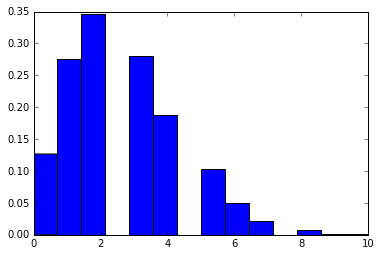

2
3
1
1
4
4
0
3
5
2
0
5
1
4
3
1
2
0
4
1
2
3
2
0
1
1
2
2
2
2
1
3
2
3
2
1
4
4
0
3
3
5
8
8
3
6
7
5
3
3
4
3
4
1
2
2
3
1
2
0
0
3
4
4
3
5
2
3
2
1
6
2
3
2
0
0
1
3
2
6
0
2
0
1
1
3
2
3
0
0
4
3
0
4
1
4
1
6
1
4
3
2
3
4
4
5
3
3
2
2
3
3
1
4
6
4
0
6
2
1
3
2
0
1
0
6
1
4
0
3
3
3
2
2
4
5
3
0
1
2
2
2
2
1
0
2
2
1
0
2
2
0
2
6
5
5
4
4
2
1
4
7
3
2
3
2
3
1
1
1
0
1
0
2
4
2
1
1
3
0
5
3
1
1
4
1
0
2
2
3
4
2
3
4
0
4
0
0
8
3
2
2
3
0
2
2
3
3
2
2
4
2
1
1
4
1
1
1
1
1
2
1
3
0
3
4
1
2
1
2
3
2
1
2
4
6
7
4
0
4
5
5
1
2
3
2
3
2
4
3
2
1
1
0
2
1
2
3
3
4
0
3
1
5
3
3
0
3
2
2
5
3
6
3
3
7
1
3
0
2
6
3
4
0
5
3
3
1
4
0
1
6
3
2
6
3
2
7
6
1
7
2
2
4
1
2
7
2
3
2
3
3
1
3
0
2
2
4
3
5
0
2
1
4
4
2
1
4
0
1
2
6
6
2
4
1
1
3
1
2
4
2
4
5
1
4
2
1
3
5
1
4
4
0
2
10
1
4
3
4
2
1
1
4
3
1
2
2
2
4
0
1
1
3
2
5
4
4
2
3
4
5
3
3
1
5
4
2
3
2
2
1
2
1
2
4
9
2
2
2
0
6
0
0
1
4
2
3
3
2
1
4
1
2
2
3
2
3
1
3
4
2
3
6
4
2
1
3
2
2
1
1
3
6
4
5
8
6
4
1
1
0
0
2
1
0
2
2
1
1
1
2
5
3
4
4
1
3
3
5
3
4
4
3
7
3
5
1
0
1
5
2
3
6
2
3
4
4
4
3
1
5
1
4
1
5
1
2
1
2
2
5
5
0
3
2
1
4
2
1

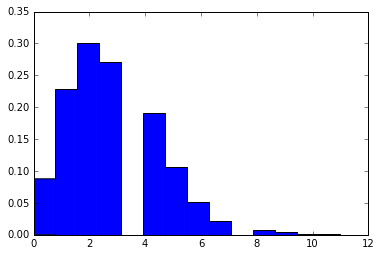

1
3
2
1
2
0
3
5
4
2
1
3
3
5
3
1
1
4
1
3
0
5
3
3
2
3
2
1
2
2
2
5
3
6
2
1
3
2
2
2
3
3
3
5
5
6
6
4
4
3
1
4
3
2
2
1
7
2
5
0
3
2
2
1
2
3
2
2
6
3
0
0
2
2
1
3
1
3
5
0
1
3
1
3
3
6
2
2
0
3
0
1
3
0
2
1
6
7
2
3
1
1
5
4
6
1
2
2
1
0
2
3
2
3
2
2
3
1
3
2
1
1
3
2
2
2
1
3
2
9
0
3
2
3
4
7
0
2
3
2
2
3
4
1
4
2
3
1
2
2
2
1
1
1
3
6
4
3
2
4
0
5
0
4
3
3
6
3
6
5
5
4
0
4
4
1
2
1
2
1
3
2
3
3
3
3
0
2
2
5
2
2
2
2
4
2
1
3
4
4
4
1
3
2
2
2
3
3
4
1
6
5
1
1
1
5
2
2
2
2
1
2
1
2
2
1
3
3
6
4
2
6
5
0
6
1
3
1
4
2
3
2
3
5
5
4
0
3
5
4
4
2
6
1
2
4
2
3
1
1
2
1
1
6
5
5
1
4
4
2
4
4
3
2
1
5
2
0
2
2
4
1
2
4
1
4
4
2
1
7
1
4
3
5
5
2
5
5
3
4
1
2
3
1
1
3
5
2
2
2
2
3
2
3
1
1
1
0
1
3
4
4
4
2
0
1
1
2
0
3
1
4
1
3
7
3
1
0
1
3
1
5
1
1
3
3
3
3
6
4
1
5
7
2
4
4
5
6
4
6
6
7
1
5
2
5
2
7
2
1
1
1
3
3
3
2
0
2
6
3
3
2
3
1
2
0
0
2
1
7
0
3
2
4
3
4
2
3
4
5
1
4
2
0
1
0
5
1
1
5
1
2
3
3
2
1
4
2
5
3
2
3
2
1
2
3
2
4
5
2
2
4
4
1
2
4
2
3
2
6
1
2
7
4
2
5
3
3
1
2
1
1
3
1
2
4
1
2
4
1
4
1
2
0
2
0
0
4
1
2
2
3
2
5
0
7
0
3
4
6
2
3
3
1
3
4
1
2
6
3
5
1
2
2
3
2
2
0
1
3


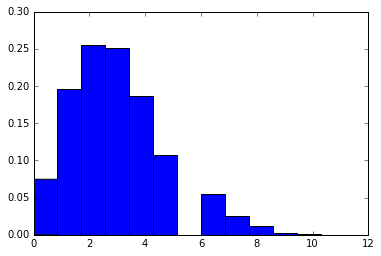

0
0
1
2
2
0
2
2
3
2
0
3
3
3
5
3
3
1
3
5
3
5
4
6
3
2
3
2
2
3
4
3
5
2
3
3
3
5
3
4
6
7
0
4
5
2
4
6
3
0
4
2
5
7
2
1
0
4
10
4
1
2
2
3
3
1
3
6
5
2
5
0
1
0
0
1
1
2
4
3
2
4
4
0
2
2
3
0
2
1
1
3
1
4
3
4
10
4
2
1
1
2
2
4
0
5
1
3
1
1
7
6
3
2
2
3
2
1
3
2
1
3
7
3
1
1
3
3
5
1
1
6
0
3
6
2
3
4
2
3
2
0
2
5
1
4
3
1
4
3
4
2
1
2
4
2
4
2
1
9
4
7
1
4
2
6
2
5
7
1
2
5
0
3
0
1
4
2
3
2
1
3
5
0
3
0
3
0
7
3
3
3
6
2
2
1
2
2
0
1
0
4
2
2
3
3
2
0
3
5
3
3
2
1
2
5
4
4
2
1
3
2
5
2
2
4
3
4
4
6
4
2
5
5
5
4
8
6
5
2
3
2
2
1
2
4
2
5
0
4
3
5
3
3
4
3
4
1
4
2
8
3
3
2
4
3
1
4
2
4
2
3
3
1
1
4
1
1
2
5
2
4
3
1
4
1
2
1
5
4
5
4
3
4
0
1
1
7
6
5
4
2
3
4
5
4
1
3
3
1
5
2
1
4
1
2
3
2
4
3
2
2
3
7
1
3
2
2
7
4
3
3
5
2
6
4
2
3
2
3
2
3
2
4
1
4
1
2
1
0
2
1
3
4
5
5
3
3
5
3
0
4
6
1
1
3
2
5
2
3
5
3
4
4
0
2
2
3
2
1
2
2
3
1
2
1
1
2
2
1
1
3
2
4
0
4
3
3
4
1
1
4
1
0
2
2
2
3
2
1
2
2
4
3
1
5
3
3
2
2
1
4
3
1
2
6
2
3
1
1
1
2
7
2
2
7
7
2
2
3
4
2
3
5
2
1
2
6
3
5
1
2
5
2
3
2
2
1
7
3
5
3
4
2
3
6
5
1
4
0
4
2
4
9
3
3
3
3
0
4
3
5
4
5
3
1
2
3
4
2
2
3
4
3
3
0
4
3
1


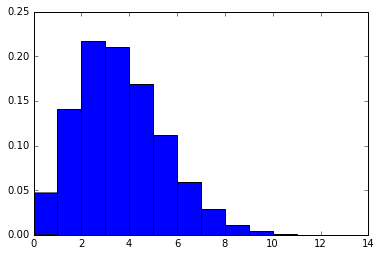

1
7
1
0
3
4
1
4
3
5
2
3
4
6
4
5
2
1
4
3
3
0
5
0
1
2
4
2
1
2
0
0
3
7
4
3
3
4
6
3
3
4
4
3
4
8
8
1
2
4
3
7
4
4
3
2
3
5
6
5
4
7
5
0
0
3
4
3
3
5
4
5
2
4
2
2
1
6
1
2
0
4
1
5
1
2
2
4
2
4
2
2
2
5
3
5
5
1
3
1
0
4
0
3
4
2
3
0
4
0
6
3
3
5
5
2
2
2
0
3
4
7
2
1
4
2
3
1
3
1
3
4
4
1
1
5
2
3
2
3
6
3
2
5
3
1
1
5
2
1
4
2
3
0
3
1
2
3
1
3
2
3
0
2
2
3
1
3
2
2
5
2
1
3
3
3
2
4
6
7
2
3
2
5
3
5
3
0
3
3
4
1
4
3
3
3
2
4
2
5
4
2
4
0
4
2
3
4
1
2
0
3
6
6
4
3
2
4
3
4
0
2
3
3
2
3
1
1
3
3
5
1
5
4
3
1
3
4
1
2
3
4
5
5
3
5
1
5
9
1
2
3
1
0
5
2
4
3
1
5
3
5
1
6
2
9
4
2
4
3
2
3
1
1
4
7
0
3
1
2
1
3
4
1
5
2
5
4
4
3
7
1
7
3
2
0
2
4
2
5
5
4
6
5
4
1
5
1
3
4
4
4
6
2
3
2
2
2
2
5
0
5
6
2
1
3
2
1
4
4
3
7
4
1
2
2
7
6
2
5
4
2
6
2
2
4
0
2
2
2
4
6
3
4
5
8
1
2
4
3
6
2
3
1
3
6
0
2
3
3
4
3
3
2
0
3
6
5
3
4
4
5
2
6
5
4
3
0
1
1
3
1
6
5
4
4
0
4
3
3
2
2
3
2
1
2
3
3
6
4
2
3
3
4
2
4
4
3
5
4
1
1
5
4
5
5
1
1
2
2
3
5
6
7
1
5
2
3
7
1
2
3
7
3
2
3
5
7
5
5
3
1
4
3
3
5
1
1
7
7
0
3
4
1
1
3
1
4
2
2
2
3
3
4
2
1
3
4
4
1
1
0
2
1
2
1
6
2
6
4
3
3
4
3
4
0
5
3
7
2


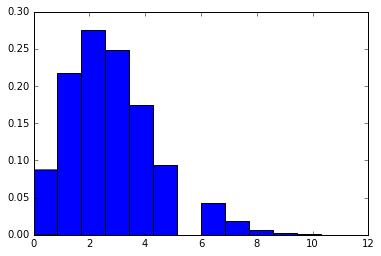

2
1
2
1
1
2
1
2
3
1
5
1
0
1
1
2
6
1
1
3
0
2
1
2
5
0
1
1
3
5
3
2
5
0
0
3
1
9
3
1
4
1
5
3
4
4
10
4
2
2
1
1
5
2
0
2
1
5
4
5
5
0
4
2
1
1
3
0
1
2
2
2
4
1
3
3
1
0
8
1
1
0
1
3
3
2
2
2
1
3
1
1
3
2
2
2
2
2
5
1
2
2
2
1
2
2
1
3
2
2
0
3
2
3
2
4
2
3
4
1
2
1
1
2
1
2
5
2
3
7
3
1
4
3
1
1
4
0
0
4
3
2
1
4
3
2
0
2
4
3
1
2
4
3
1
3
2
1
2
4
2
1
4
4
2
5
8
2
5
2
5
1
1
6
3
2
2
4
4
3
4
2
4
3
2
2
2
1
2
3
0
4
1
2
4
0
3
2
1
3
2
2
2
5
6
1
4
1
2
6
3
6
6
2
5
4
2
3
1
3
5
5
2
1
2
3
3
1
3
4
2
2
3
4
5
2
2
7
2
5
1
3
1
2
4
2
3
4
2
2
0
3
0
4
1
3
3
4
0
2
0
7
1
3
4
6
2
3
4
0
2
1
1
3
7
4
6
3
0
3
1
0
0
7
1
0
3
2
3
3
0
2
3
4
5
2
4
3
5
3
1
1
1
3
4
1
7
2
2
5
3
3
2
0
1
2
3
5
2
4
2
2
3
2
2
1
2
3
3
1
1
2
4
3
5
4
1
3
2
10
4
1
1
1
5
5
2
3
2
2
3
2
2
7
4
8
3
4
0
2
0
2
1
2
2
2
1
1
3
2
2
3
3
1
2
2
2
1
2
2
0
5
3
8
4
1
1
5
1
5
5
5
2
7
2
7
3
3
3
2
3
2
3
4
2
2
4
0
8
3
1
2
5
4
1
3
0
2
3
2
3
2
1
3
4
1
3
3
4
0
3
2
1
3
1
5
2
5
2
2
4
2
2
2
2
4
1
1
3
4
1
4
0
1
2
1
1
2
3
5
2
2
3
2
2
2
4
1
5
3
2
1
4
2
3
3
2
1
2
2
1
1
4
4
3
3
3
3
3
2
5
2
4
2
2
4
4
3
7


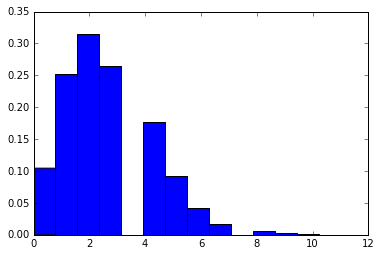

5
2
1
2
1
3
4
1
4
0
2
3
1
3
1
3
1
3
3
3
3
0
1
3
1
7
2
3
1
1
6
3
2
0
2
1
2
1
4
1
4
4
4
5
5
2
5
5
2
4
3
2
4
7
4
3
5
3
3
1
5
3
5
1
2
0
5
0
1
3
1
1
2
1
4
3
3
7
3
4
8
3
2
1
0
1
3
2
4
2
2
1
0
2
1
4
3
2
5
3
0
3
3
2
2
2
5
1
4
2
3
4
2
4
3
3
3
6
2
2
2
3
3
5
2
2
4
3
0
0
2
4
0
7
0
3
0
0
1
4
2
3
3
2
3
1
4
1
0
1
4
1
3
4
4
1
1
3
4
1
2
1
3
5
1
6
4
5
2
2
5
5
2
2
2
5
4
0
4
4
3
2
2
4
0
2
1
2
2
2
2
3
1
1
2
2
2
3
4
1
3
0
2
2
0
1
4
0
2
1
2
3
4
1
3
2
4
1
2
3
5
2
4
2
2
4
6
4
2
2
2
3
3
3
6
2
4
5
1
2
2
4
5
4
0
7
4
5
4
4
3
3
2
2
1
0
2
3
2
2
1
3
1
1
6
2
2
4
3
4
0
3
2
3
5
6
4
2
2
2
4
1
2
4
3
4
1
1
1
1
3
3
1
2
1
1
1
5
0
2
1
3
2
1
2
2
1
0
2
1
5
3
5
0
1
3
1
4
7
6
3
2
2
4
2
2
2
4
1
4
0
1
2
3
0
2
2
1
4
4
2
4
1
1
3
4
0
1
4
2
2
7
2
1
3
7
7
2
4
7
5
0
2
4
2
0
0
4
1
4
2
0
3
2
2
1
2
2
1
7
4
0
2
1
0
6
3
4
3
4
2
1
3
4
0
5
4
4
3
5
1
2
3
1
1
3
1
2
1
0
3
1
3
4
0
1
0
3
2
3
2
1
1
4
6
5
5
6
4
5
3
4
0
0
3
10
5
3
3
2
1
5
3
3
2
5
0
1
4
5
1
4
2
2
2
2
1
4
1
4
4
2
1
2
4
0
5
2
3
1
3
2
4
3
0
3
3
3
1
2
3
3
2
3
3
4
2
4
6
2
2
3
3
4
3
0
7
4
3
5

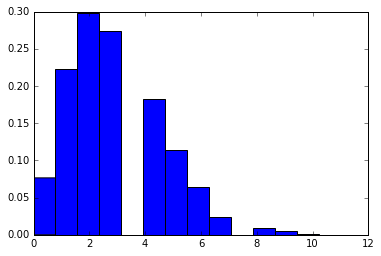

2
3
0
0
2
1
2
2
2
2
1
6
1
1
4
4
2
3
4
2
4
2
7
3
2
2
3
2
1
6
2
3
2
0
5
6
5
3
2
3
6
8
3
7
4
6
2
11
3
4
2
1
1
0
3
1
1
6
4
0
4
0
5
0
2
2
3
3
1
6
2
2
1
0
3
4
5
3
3
2
1
1
2
6
2
1
2
3
3
0
2
1
1
1
3
2
5
5
1
2
5
2
3
5
1
1
3
7
3
5
2
1
4
2
3
4
2
3
2
0
4
2
1
1
2
0
2
3
2
3
5
2
2
2
3
3
1
5
3
3
3
3
2
3
4
3
1
1
2
1
4
4
1
2
3
4
3
3
2
2
6
4
3
5
3
1
5
3
1
2
4
2
2
6
3
6
4
5
2
4
4
4
4
7
3
2
5
3
0
4
4
2
2
0
4
2
1
4
5
7
1
3
4
2
4
2
3
6
3
2
1
3
5
3
3
2
3
3
1
5
5
3
4
4
4
6
4
2
2
3
0
4
5
2
4
6
2
4
3
2
6
1
1
4
3
5
3
6
4
3
5
3
3
4
6
2
2
6
2
4
1
3
7
2
4
2
2
4
3
0
2
3
2
5
6
3
3
5
3
2
1
2
2
6
1
3
3
2
4
2
2
5
3
2
4
1
3
2
7
2
8
0
5
1
4
3
4
1
1
1
4
4
1
6
2
3
2
2
1
2
4
0
0
2
6
4
5
2
1
4
3
7
4
3
2
5
2
1
0
5
2
3
1
2
2
2
1
3
2
3
4
4
6
3
2
2
3
10
2
3
3
3
1
4
0
6
2
1
2
3
1
1
10
3
2
2
4
4
9
5
0
3
2
3
7
4
5
3
2
5
2
3
2
3
2
7
7
2
1
2
3
1
0
2
6
2
5
1
6
2
1
2
2
1
2
1
3
1
1
3
2
1
3
5
1
3
4
2
1
5
1
2
2
5
3
5
4
0
1
4
1
3
2
4
1
3
1
3
3
6
3
1
3
0
3
5
5
2
3
2
2
1
4
3
3
3
3
4
4
4
2
4
0
4
4
1
4
4
5
2
3
2
3
4
2
3
3
3
2
1
2
2
4
2
2
3
3
2
2

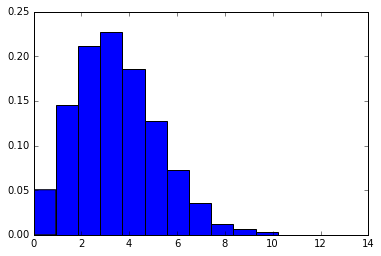

2
2
3
1
5
0
5
1
3
7
7
3
5
5
2
3
2
4
0
3
3
4
5
2
1
0
1
2
5
2
4
2
2
5
4
1
1
1
5
4
2
4
4
7
4
9
6
3
1
6
3
3
4
3
4
1
2
1
3
5
4
2
3
3
3
3
2
2
3
3
0
3
3
3
2
1
8
1
4
3
5
5
2
1
0
2
1
0
2
2
2
4
1
2
1
2
4
2
3
4
5
3
4
3
1
7
2
6
2
2
3
1
5
2
2
2
6
6
4
2
1
5
4
2
5
3
4
5
1
2
4
2
1
4
3
3
2
0
1
3
2
1
3
3
6
2
3
6
8
2
5
1
2
1
10
2
2
0
4
3
7
0
3
5
2
5
3
1
2
1
2
1
4
5
3
4
3
1
5
4
4
2
2
5
5
5
5
9
4
0
1
1
1
2
0
1
3
7
3
1
2
5
3
1
4
3
4
1
1
2
5
6
8
5
3
3
3
0
2
0
1
4
1
5
1
0
2
5
3
6
2
2
2
5
4
7
4
7
3
5
6
3
6
5
4
6
6
5
4
3
3
2
3
3
3
2
3
5
3
2
1
1
1
2
7
1
4
3
3
4
2
3
2
1
2
1
4
1
5
4
3
3
2
4
2
3
4
2
2
5
4
6
2
3
7
7
3
3
5
8
2
3
1
1
5
2
4
7
2
1
6
5
4
4
0
0
4
5
6
1
2
2
4
5
4
2
5
3
4
7
3
1
6
5
1
7
4
3
4
4
3
3
6
0
8
1
2
5
4
6
5
5
4
1
5
4
2
8
3
6
5
1
1
5
2
4
3
4
7
5
4
5
9
2
1
6
3
2
2
1
3
0
6
3
3
6
6
6
4
6
1
5
6
0
4
2
1
5
4
6
5
5
6
4
0
4
2
2
3
4
0
3
3
2
9
2
6
3
3
2
3
2
2
3
3
1
3
4
4
6
7
3
5
0
4
5
3
2
4
2
4
6
0
3
7
2
2
4
3
4
7
4
4
6
3
1
2
4
2
0
4
3
7
3
1
5
1
2
2
1
4
5
3
3
0
5
5
6
1
3
4
3
1
1
3
2
4
2
8
5
2
2
0
1
1
2
3
2
5
5

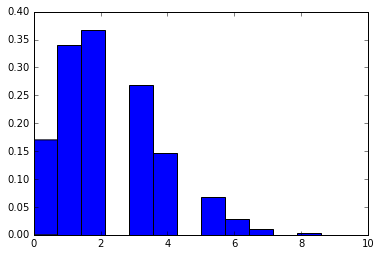

4
2
2
2
3
1
0
3
2
2
2
1
3
3
3
1
2
0
1
1
2
1
3
4
3
2
1
4
0
4
1
2
2
1
1
4
1
1
1
2
1
2
5
2
5
4
2
4
4
3
3
4
6
1
3
4
5
3
2
2
2
3
5
2
0
2
1
0
1
0
3
2
2
2
0
1
1
2
7
3
4
2
1
0
2
1
4
2
0
4
1
1
1
2
3
0
8
5
2
0
3
0
0
1
1
3
2
1
2
1
1
2
2
1
3
1
1
3
7
3
2
0
1
3
4
3
1
1
2
1
0
2
1
0
4
4
1
3
1
2
2
1
2
1
2
2
2
2
3
1
3
2
0
2
6
4
2
3
0
1
2
4
2
5
1
3
3
1
1
3
3
3
1
1
1
1
6
2
3
3
1
0
2
3
4
2
4
5
2
3
3
1
2
2
2
0
2
1
1
1
3
1
1
3
4
3
2
0
3
1
2
4
3
2
2
0
2
0
0
2
3
3
3
4
3
1
3
2
5
1
1
4
3
4
1
6
4
5
3
3
4
2
1
2
2
2
3
3
0
1
6
4
3
0
2
1
3
3
0
2
1
5
0
1
1
3
1
5
2
3
0
3
2
5
1
1
0
1
1
5
5
2
2
2
2
4
1
2
4
1
3
4
4
2
1
2
4
1
3
0
2
2
2
2
1
4
5
0
1
0
4
0
1
2
1
1
0
2
1
2
2
4
2
1
2
1
3
5
1
1
0
3
3
6
5
4
2
1
2
2
1
6
2
2
2
3
6
3
3
3
5
2
3
3
4
1
0
4
7
3
3
5
2
0
1
1
0
3
1
3
0
0
0
1
2
3
2
0
1
3
1
2
3
5
1
0
2
1
2
2
3
0
6
1
6
4
2
4
6
1
2
3
0
1
0
1
1
2
2
2
0
3
2
2
1
1
2
1
2
3
0
6
4
4
3
2
0
2
1
5
2
2
3
2
3
4
3
5
2
2
4
3
1
1
1
2
1
1
5
2
4
1
0
3
0
3
0
0
3
3
2
0
2
2
0
4
0
1
3
1
3
3
3
2
2
0
2
2
4
2
2
2
2
4
3
3
7
0
2
1
3
3
1
2
2
0
3
1
1
0


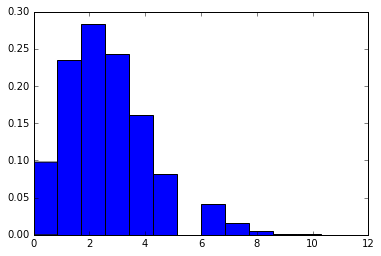

1
1
0
1
2
1
2
0
1
4
1
1
1
2
1
2
1
0
1
2
2
4
3
2
3
3
3
5
0
2
4
2
0
0
6
1
4
4
5
1
3
8
3
1
1
3
3
1
5
4
1
2
1
2
2
1
0
2
1
2
2
1
1
1
3
4
2
0
2
1
3
2
2
3
1
3
3
3
4
6
3
4
2
2
1
3
2
1
0
1
2
1
3
2
4
0
6
6
2
7
4
0
1
4
3
4
0
3
4
3
1
3
0
0
1
5
4
3
5
1
3
2
3
1
0
0
5
3
2
2
4
5
0
3
2
2
3
3
1
6
2
3
3
2
3
1
2
2
1
1
2
3
5
4
2
3
6
1
2
4
1
3
1
4
1
2
2
3
3
3
4
1
2
1
0
2
1
1
5
2
2
3
3
4
4
4
1
4
3
3
3
0
2
3
3
2
3
3
1
1
1
2
1
2
0
3
1
1
0
1
2
3
2
1
4
3
3
1
1
1
0
1
2
2
2
3
1
3
2
0
1
2
2
0
3
5
4
0
1
2
2
2
1
0
2
5
3
2
3
3
3
1
4
4
4
3
2
4
4
2
2
3
4
2
5
2
2
3
1
2
2
5
3
2
1
4
1
2
3
2
1
0
4
4
2
3
2
3
6
3
0
2
3
2
4
3
1
3
3
4
2
1
3
2
1
5
2
3
1
1
4
2
3
2
3
5
3
3
7
3
0
2
3
4
4
2
2
2
0
6
2
4
5
3
3
2
4
4
2
1
1
1
1
5
3
3
0
4
5
4
2
0
2
2
5
6
3
5
4
3
8
3
1
3
2
1
1
4
3
3
3
1
1
2
4
4
2
2
2
3
2
1
0
2
2
1
5
0
2
1
4
1
1
0
4
6
3
1
1
6
3
2
1
3
2
2
2
3
3
4
0
1
4
2
2
1
3
1
2
2
1
1
3
0
6
3
1
3
1
2
0
2
4
2
5
1
1
2
2
0
2
1
3
4
3
1
2
1
3
4
3
4
3
1
2
1
5
1
1
3
5
2
0
0
2
1
0
2
3
3
1
0
4
3
0
4
4
1
6
1
3
4
0
0
2
3
4
0
0
2
0
3
3
3
2
1
1
5
1
2


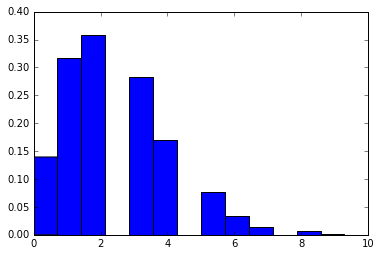

4
3
1
0
0
0
1
0
3
0
2
4
1
4
3
3
5
0
2
0
1
4
1
1
2
1
3
2
3
2
3
4
1
4
1
2
4
4
2
4
4
4
1
5
6
1
8
6
2
2
2
1
5
2
2
1
0
4
1
1
3
1
1
5
5
2
2
2
2
4
1
3
1
1
1
1
2
3
3
2
2
3
7
5
4
4
2
0
0
3
2
2
3
3
4
1
2
4
0
3
3
2
5
0
2
4
4
4
1
4
3
3
3
1
1
2
1
3
2
1
2
3
3
1
0
3
1
2
1
2
4
3
1
3
0
3
3
7
3
3
0
4
0
4
1
2
2
1
0
0
1
3
3
2
0
4
3
2
2
0
3
0
0
1
1
2
4
4
5
2
2
4
2
2
3
4
1
4
5
2
1
2
1
2
1
1
3
3
0
4
4
3
2
2
0
2
3
3
1
1
3
6
3
2
1
5
3
3
2
4
3
7
3
2
1
4
2
2
2
2
1
1
2
3
1
2
4
2
0
4
2
2
4
4
2
1
3
4
2
3
1
4
0
2
1
1
3
4
3
3
2
4
2
2
0
1
1
3
6
0
1
1
1
2
2
7
3
3
0
3
1
2
1
3
3
5
3
4
4
1
3
5
5
0
3
1
1
2
3
4
2
1
1
4
2
2
1
6
1
2
4
2
1
3
0
5
3
1
0
1
2
2
3
8
2
1
2
4
1
2
2
1
3
1
2
1
0
3
4
5
5
7
3
2
0
3
1
5
0
6
1
2
1
3
4
2
3
2
1
0
3
3
2
2
5
5
2
2
3
5
6
4
5
3
3
3
2
7
5
2
1
2
4
5
1
1
2
4
3
2
4
2
2
1
2
2
3
1
3
1
0
2
2
4
2
4
7
2
4
2
2
3
0
3
2
2
3
0
3
1
3
3
2
4
2
2
0
2
3
1
3
3
5
3
3
0
1
2
4
6
1
2
0
4
5
3
6
2
2
1
2
0
3
0
5
3
1
2
0
3
3
4
5
2
2
4
3
0
2
3
2
1
1
2
3
2
1
4
1
2
3
3
4
2
4
2
2
0
1
0
1
2
0
2
2
1
2
2
4
1
3
3
6
3
4
2
2
2
3
3


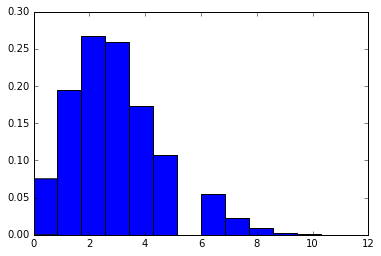

0
1
2
2
3
3
2
2
2
4
3
3
2
2
6
2
1
1
2
3
2
4
2
2
3
6
0
4
3
3
1
4
0
1
4
2
3
2
1
4
2
3
3
8
6
3
3
8
5
0
3
5
2
3
2
0
5
5
2
1
2
3
3
3
2
3
4
3
5
7
0
2
2
2
3
0
3
5
4
1
1
3
4
1
2
1
0
2
2
3
1
3
3
3
4
1
8
2
1
1
2
1
7
5
4
4
4
1
6
3
2
3
5
3
5
4
3
1
1
7
0
4
3
4
3
5
1
5
2
3
5
2
3
2
3
5
2
2
2
3
4
0
0
2
1
1
2
5
4
5
4
4
4
6
1
2
3
2
7
3
1
4
3
3
1
8
2
7
4
0
4
0
4
4
3
5
3
4
2
2
5
5
2
3
2
2
1
1
3
3
0
0
2
2
4
3
2
3
3
2
1
3
1
1
3
0
2
4
2
2
2
5
4
1
2
1
2
1
4
3
4
4
2
2
1
4
5
4
1
3
1
2
5
3
3
3
5
4
1
2
2
4
4
2
6
1
3
5
6
3
4
1
1
2
0
4
3
5
0
2
0
3
6
3
4
4
4
3
4
3
2
3
7
4
2
7
2
0
4
7
7
3
5
4
4
0
2
5
5
6
1
3
6
4
1
3
2
3
5
2
3
3
3
3
4
7
3
4
6
0
1
5
0
3
2
3
2
2
1
4
1
3
3
4
4
8
1
2
4
2
0
2
6
3
4
2
2
2
0
1
3
3
3
3
3
0
1
1
2
4
3
5
6
5
0
4
3
3
4
1
6
2
4
3
2
2
7
3
0
8
5
2
3
0
0
2
2
2
3
2
6
4
2
5
6
3
2
5
8
3
4
2
1
3
1
7
5
2
1
6
2
3
3
3
0
3
6
2
4
5
1
7
0
3
3
0
2
3
3
3
2
3
3
3
4
0
3
1
1
2
6
3
3
4
5
0
4
6
3
4
4
1
2
6
3
3
3
4
4
5
4
2
5
3
5
3
1
4
3
2
1
3
3
1
2
1
1
1
0
4
5
3
3
6
3
4
0
3
3
4
4
5
4
0
1
4
0
3
3
2
3
1
0
2
3
2
4
3
3
2


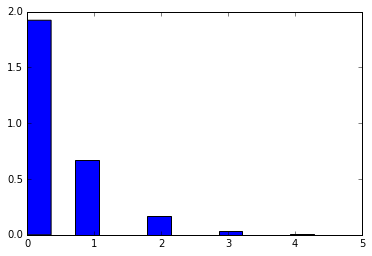

0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
2
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
3
0
0
0
0
0
0
0
1
2
0
0
0
0
0
4
0
0
0
0
0
0
0
1
2
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
2
0
0
0
0
2
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
2
1
2
1
3
0
0
0
0
1
1
3
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
2
1
1
1
1
0
1
1
0
0
0
2
0
0
0
2
0
0
0
0
1
2
1
0
0
1
2
0
2
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
2
1
1
0
3
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
3
1
3
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
2
1
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
2
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
2


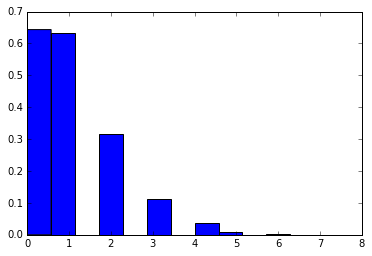

0
1
0
1
0
0
2
1
1
1
0
2
0
0
0
0
3
3
1
1
0
1
1
0
1
1
0
3
2
0
1
5
3
4
0
1
0
0
1
3
2
2
2
2
5
3
0
0
2
0
2
0
2
0
1
2
1
2
0
1
1
0
0
1
1
0
1
0
0
1
0
0
2
1
1
2
0
0
0
1
0
1
0
0
0
1
0
1
0
2
1
1
1
2
2
2
2
2
4
0
0
1
1
1
0
1
0
0
1
3
1
0
2
0
0
0
2
0
4
0
0
3
0
1
2
2
0
0
1
0
1
0
0
0
0
0
0
1
0
1
2
1
4
1
2
0
1
0
0
2
1
1
0
2
1
2
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
2
1
2
1
0
1
0
1
0
3
0
0
1
1
0
0
0
1
1
1
2
1
0
1
3
0
1
3
0
1
3
0
2
0
0
0
1
0
0
1
1
0
1
1
0
0
2
4
0
0
1
0
0
1
1
1
3
1
1
1
3
1
1
0
1
3
0
2
2
1
0
2
1
0
0
2
1
2
1
1
1
2
1
0
0
1
0
1
0
2
2
1
1
4
2
4
2
1
2
2
1
2
0
1
1
0
3
0
1
0
0
2
1
1
0
1
4
2
0
0
4
0
0
2
1
1
3
1
1
0
0
0
1
2
1
3
2
0
1
3
2
3
2
1
1
0
2
1
0
0
2
1
0
0
2
1
0
2
3
2
0
3
0
2
1
0
0
0
1
0
0
0
1
3
0
1
0
2
1
3
1
0
1
0
0
2
1
3
2
2
3
1
0
1
0
0
1
2
1
1
0
0
3
4
0
0
1
0
1
1
0
1
1
0
3
1
2
1
1
2
2
1
0
0
2
0
0
0
0
0
1
0
2
0
3
1
0
0
0
0
0
0
2
1
0
0
0
0
2
0
0
1
2
0
0
0
0
1
0
2
0
0
0
2
1
2
1
3
3
3
0
2
2
4
0
3
0
0
0
1
0
0
2
0
0
2
1
2
1
0
0
0
2
3
3
1
2
1
1
2
2
0
1
1
2
2
0
2
1
1
0
0
1
0
0
0
1


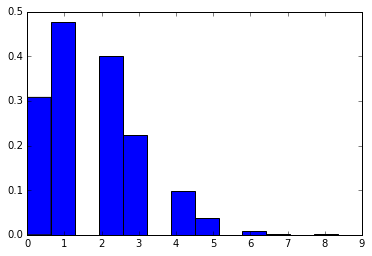

3
0
0
2
2
2
3
5
1
1
1
1
0
0
2
2
0
1
1
2
3
5
0
1
2
3
2
1
4
1
4
1
1
3
5
0
1
0
1
0
1
2
2
0
4
0
0
5
0
3
3
1
0
2
0
1
4
2
1
2
2
2
0
2
2
3
1
3
2
2
2
2
1
1
3
0
2
0
5
2
1
3
0
1
4
2
0
3
5
3
0
1
2
0
1
4
2
1
0
2
1
1
2
0
1
2
1
0
2
2
6
0
3
1
4
0
0
1
0
2
2
3
0
2
4
0
1
3
0
0
3
1
0
1
4
1
1
1
2
4
2
2
1
5
2
0
1
2
1
1
2
3
0
4
4
2
0
2
2
7
3
1
2
0
1
2
1
2
1
2
2
2
2
3
3
1
0
2
3
1
0
1
2
0
0
1
1
0
3
2
0
1
2
2
1
4
2
2
0
4
1
2
0
1
2
3
3
3
0
1
4
3
0
1
2
0
0
0
3
1
1
1
0
1
2
0
0
1
3
1
1
1
1
1
3
3
0
0
2
2
0
5
3
4
2
3
2
0
1
1
0
0
1
3
1
4
1
3
2
1
2
2
2
5
1
2
1
2
1
3
2
0
2
2
1
1
3
2
1
2
1
3
1
4
2
4
0
3
3
2
2
6
4
0
3
4
1
3
1
7
2
3
2
3
2
1
0
2
2
2
1
0
3
0
2
1
1
4
5
3
4
3
0
2
1
1
0
4
0
1
2
1
0
1
3
2
3
4
1
2
1
3
2
1
4
2
2
2
4
1
1
0
0
2
1
3
2
2
2
0
2
4
2
3
1
2
2
2
0
1
1
0
3
2
2
2
2
5
1
0
0
7
2
0
3
2
1
0
4
1
5
4
2
1
3
0
2
1
0
1
2
2
2
4
1
2
3
0
2
1
1
1
3
3
1
2
3
1
2
1
3
4
3
2
3
1
1
0
2
1
0
3
3
0
1
1
1
2
0
5
0
1
1
0
2
2
1
2
3
5
2
0
2
0
3
4
1
2
0
1
2
3
1
3
1
1
2
2
0
5
3
2
2
2
1
1
0
1
1
1
1
0
3
4
1
1
3
0
3
2
3
1
0
0
3
1
0
1
2
0


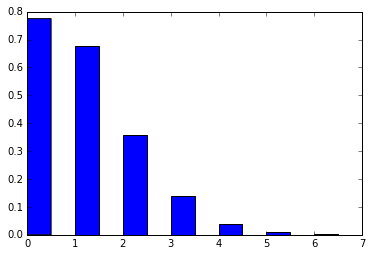

0
1
0
2
0
2
1
2
1
2
3
0
2
0
2
2
1
1
2
1
0
1
2
0
2
0
4
0
0
0
1
0
1
0
4
3
0
1
1
0
0
0
0
0
1
1
2
0
3
2
2
2
2
1
2
0
0
0
0
2
1
2
0
2
0
2
1
0
1
2
0
1
1
0
0
0
2
0
2
1
2
0
1
0
4
0
0
1
0
1
2
0
2
0
1
0
1
1
0
0
1
0
1
2
3
1
1
3
4
2
0
1
1
0
1
1
1
4
1
0
1
0
0
0
1
1
2
2
0
2
1
3
1
0
2
0
0
0
0
2
1
0
0
5
2
0
3
1
3
1
2
1
1
2
1
0
1
0
1
1
3
3
0
2
0
0
2
0
3
2
2
2
3
1
1
1
0
2
0
1
0
3
0
0
0
1
0
0
0
1
0
1
3
4
1
0
1
1
1
2
0
0
0
1
2
0
0
2
0
2
4
1
2
1
1
0
2
1
0
2
0
0
0
0
1
0
2
1
0
1
0
0
0
0
2
1
0
0
0
0
0
1
0
1
0
1
0
1
1
0
3
0
2
0
0
0
0
0
0
0
1
2
2
2
1
3
1
2
3
3
4
0
2
0
1
2
3
2
2
1
1
1
0
3
0
0
0
0
0
1
2
0
2
0
0
0
1
1
0
0
1
1
1
0
4
0
2
0
1
1
1
1
0
2
0
1
1
7
0
0
2
0
0
0
1
1
3
1
0
1
0
0
0
1
1
1
1
0
0
1
1
1
0
1
1
0
0
1
3
1
1
0
2
1
1
2
0
0
2
0
1
3
4
2
1
5
1
1
1
0
4
1
0
2
1
1
3
0
0
3
1
0
2
2
1
1
0
4
2
1
0
2
3
1
3
1
0
0
0
0
1
1
0
1
1
3
1
3
1
1
2
2
0
2
2
1
1
0
1
2
4
1
2
0
0
0
0
0
0
0
3
0
0
0
1
2
0
2
0
2
1
0
0
1
1
2
0
0
0
0
2
0
1
1
0
0
2
1
2
2
1
0
2
2
1
1
0
0
1
2
0
1
0
1
1
0
0
1
0
0
1
2
0
1
1
0
2
1
0
1
2
0
1
1
0
1
0
0
2
1


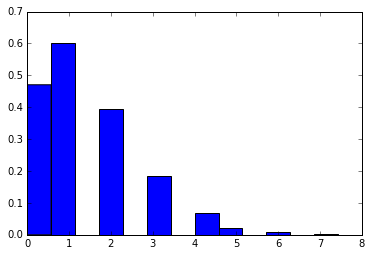

1
2
3
0
1
0
1
2
1
1
2
2
2
0
4
1
1
1
5
3
4
1
2
3
2
1
1
2
1
1
0
0
2
0
1
0
1
3
1
2
1
0
4
2
3
2
2
1
0
0
2
2
4
0
2
0
1
0
2
1
0
2
1
1
0
0
2
0
2
1
2
1
1
1
1
2
2
1
0
1
1
2
1
0
3
4
1
4
1
3
1
3
0
3
0
1
3
2
0
2
1
0
0
4
2
0
2
2
0
0
1
2
1
1
2
1
2
0
0
2
1
1
1
1
1
1
0
1
0
2
0
1
0
0
0
2
1
1
2
2
1
0
3
1
1
1
4
0
1
4
1
1
0
5
2
1
1
0
0
1
4
1
1
1
1
0
2
1
5
4
0
1
3
1
1
1
1
1
1
1
1
0
3
0
1
1
2
1
1
0
3
1
2
2
0
3
1
1
1
0
1
1
0
1
2
3
2
2
5
2
1
0
1
2
0
0
1
0
0
0
2
0
1
2
0
0
0
2
0
2
2
1
2
0
1
0
0
2
0
0
1
0
4
1
1
0
2
0
0
2
3
3
1
2
2
4
0
1
1
2
0
1
1
1
1
0
2
1
1
0
2
1
4
1
2
1
2
0
2
4
1
1
1
2
2
1
1
2
2
1
1
0
1
3
1
1
3
1
1
1
2
5
2
2
2
1
3
1
3
1
1
1
1
3
2
3
1
1
2
3
4
4
3
7
0
1
3
2
0
1
1
2
0
2
0
4
0
0
1
2
3
1
0
2
3
1
1
2
1
0
0
0
0
3
2
1
0
0
1
2
1
1
3
0
1
0
2
3
1
2
2
0
2
0
2
3
2
4
0
2
5
0
6
1
5
2
1
2
0
0
5
2
3
1
2
4
1
0
1
1
0
1
1
2
1
3
1
0
3
0
0
2
2
0
1
1
1
1
6
4
2
1
1
4
4
2
1
0
1
3
2
0
2
0
2
1
0
3
0
1
4
0
0
1
1
3
0
1
2
1
3
1
1
3
4
5
2
0
1
2
4
2
1
1
3
2
0
0
3
0
1
5
1
0
0
1
1
0
2
0
1
1
1
0
2
1
3
1
0
1
2
2
2
0
2
2
0
3
3
2


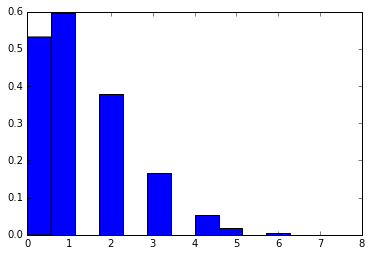

1
1
4
1
5
1
1
2
2
2
1
2
0
2
0
0
1
0
1
1
0
1
1
0
3
2
2
2
1
4
2
4
1
1
3
0
0
1
4
3
1
2
0
2
0
0
0
3
1
0
3
1
2
1
1
0
1
2
0
0
0
1
3
2
0
1
1
2
1
0
2
1
1
1
0
1
0
1
2
2
0
2
0
2
3
1
1
1
0
1
1
0
2
0
1
0
0
2
2
3
1
1
0
0
3
1
1
1
0
1
3
2
3
6
3
2
2
0
1
0
1
1
2
2
3
1
0
1
1
2
1
2
1
2
2
3
1
2
1
0
1
0
3
1
0
0
1
1
0
2
1
0
3
1
2
0
1
1
3
3
1
3
0
2
0
1
2
0
1
4
1
1
2
4
3
0
1
2
2
1
0
0
0
0
1
0
0
1
1
0
3
1
0
1
2
1
1
0
1
1
0
2
3
2
3
2
2
3
1
3
0
0
1
0
0
0
0
2
0
0
2
0
0
0
0
0
0
0
2
4
1
2
2
1
1
2
2
1
2
2
2
1
0
1
1
3
0
1
0
1
2
2
1
2
2
0
2
0
4
2
1
0
2
1
2
3
0
4
3
1
1
3
2
2
0
4
0
0
5
3
2
2
1
1
2
0
1
0
1
2
3
0
2
0
2
0
0
3
1
0
1
1
3
1
3
1
1
1
2
1
2
1
3
1
0
0
2
2
0
0
1
1
3
0
0
0
1
2
1
0
3
1
1
1
0
0
3
2
1
1
1
1
1
1
4
2
0
2
1
1
0
1
1
0
0
3
1
0
1
1
1
2
3
1
1
1
1
0
1
2
1
3
2
2
0
1
3
1
1
1
0
3
2
1
3
1
0
1
0
0
2
0
0
0
1
0
1
2
1
2
2
1
1
1
2
0
1
4
3
1
0
0
1
0
1
0
0
1
0
4
1
1
0
0
2
2
1
3
1
1
2
0
0
0
3
3
2
2
1
1
3
0
0
0
2
0
2
0
1
1
2
0
2
0
3
0
1
0
2
2
1
0
0
1
1
1
3
0
2
1
0
2
1
2
2
4
1
2
1
0
1
3
0
1
1
4
1
0
1
1
1
1
0
2
0
2
0
0
2
0


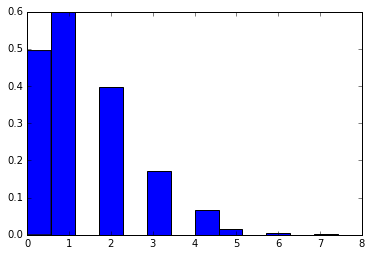

3
1
1
0
1
0
1
1
1
0
0
1
0
1
2
0
2
4
1
1
1
1
1
5
0
0
0
2
4
2
1
4
1
0
5
0
1
0
0
1
2
1
0
4
2
0
1
1
4
2
4
2
2
1
3
1
1
1
1
1
4
1
2
2
0
2
2
3
1
0
4
0
1
1
1
1
0
2
2
2
2
2
0
0
1
0
0
1
0
0
1
0
0
2
3
2
3
2
1
1
2
3
0
0
0
1
1
0
1
0
2
5
1
1
1
0
3
1
2
1
2
0
1
0
0
2
0
1
1
1
1
1
1
2
1
1
3
0
0
4
0
2
0
0
0
0
3
2
0
0
3
1
1
1
4
1
1
1
0
2
1
3
2
1
0
0
1
0
1
1
3
1
3
1
4
1
7
0
1
4
1
1
1
1
0
2
0
1
2
2
1
0
1
1
0
2
0
2
1
1
2
0
0
2
2
0
0
1
1
0
1
3
1
2
0
1
0
1
4
1
1
0
0
4
1
0
2
1
2
5
1
1
1
0
1
1
2
1
3
2
3
0
3
2
1
0
0
0
1
4
2
0
0
0
2
2
1
0
0
4
2
2
1
3
4
0
0
0
0
2
2
1
2
0
0
2
1
3
3
1
2
2
3
1
1
3
3
1
0
2
0
1
3
1
1
1
2
1
2
2
3
4
2
1
3
3
4
3
2
2
1
3
2
0
2
1
0
0
0
3
0
3
1
3
3
3
2
1
1
1
1
1
1
3
4
1
2
0
2
0
2
2
3
0
0
1
2
0
0
1
1
1
1
1
1
0
0
1
1
1
2
1
2
2
1
2
1
1
1
2
4
2
1
1
2
0
2
0
1
1
2
3
1
1
2
3
0
0
1
1
1
0
1
1
0
1
0
1
2
0
0
0
3
1
3
1
2
1
0
1
1
1
0
0
2
1
2
0
0
1
0
1
1
0
0
1
3
0
0
1
2
2
3
3
0
0
1
1
0
1
0
1
2
1
3
0
1
1
2
2
1
0
0
0
2
2
4
0
0
2
1
2
2
2
2
3
2
0
0
0
2
0
3
2
0
2
0
1
0
1
1
2
2
0
2
1
2
2
1
0
2
3
0
0
2
3
2
1
1
0


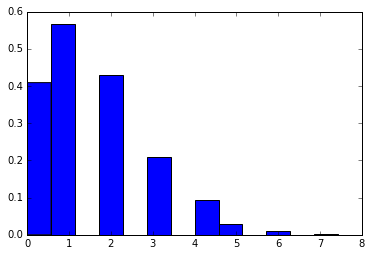

1
1
1
2
1
3
1
1
0
0
3
1
2
1
2
2
3
0
2
3
1
0
5
2
1
1
2
6
1
1
0
1
2
0
1
1
1
1
1
1
1
1
0
1
1
3
0
0
2
1
3
3
1
3
1
1
0
1
0
0
2
1
2
0
0
1
0
4
4
1
0
2
1
3
1
1
3
3
0
1
3
3
2
1
0
4
1
2
2
3
2
0
1
1
0
2
1
3
2
2
1
0
2
0
0
0
4
2
5
0
3
1
1
2
2
0
1
2
2
1
2
2
3
2
2
0
0
0
4
1
0
0
1
1
4
1
1
3
2
0
2
2
3
5
0
2
2
4
0
1
1
1
0
0
3
3
1
2
1
0
0
0
2
3
4
2
1
2
0
1
0
1
1
2
1
2
0
0
4
2
4
2
3
4
1
0
2
2
0
1
1
2
3
0
2
4
2
3
2
0
0
0
1
2
2
2
1
1
2
0
1
3
1
0
0
1
0
1
3
0
3
0
1
2
2
1
1
0
2
0
1
1
3
0
4
1
1
1
3
5
1
4
1
2
5
4
2
0
1
0
0
4
7
2
1
1
2
2
4
1
1
1
2
1
1
2
1
1
2
3
0
0
2
0
0
1
3
2
1
4
0
1
3
1
3
1
0
1
2
2
0
3
1
0
1
0
1
0
1
1
1
3
2
2
3
1
1
3
2
2
0
2
1
1
0
2
1
3
4
1
1
2
3
1
1
3
3
0
1
0
1
0
0
1
0
2
3
2
1
0
3
3
2
3
1
2
2
3
1
1
0
3
2
2
1
1
1
1
1
0
2
1
1
4
1
1
1
1
2
0
1
2
3
2
4
0
0
0
0
2
3
1
1
5
2
0
1
1
1
0
1
1
2
1
2
2
0
1
3
3
3
2
1
1
1
1
3
0
1
1
0
1
0
1
0
1
1
6
1
1
3
3
2
3
2
2
3
1
0
1
0
1
2
1
0
0
2
2
3
3
1
6
2
0
0
3
2
0
1
2
1
1
2
1
2
1
0
1
2
2
1
0
4
4
2
0
1
0
1
1
1
1
1
0
2
1
3
0
4
1
0
0
5
1
1
1
3
0
0
0
0
0
2
2
1
0
2
1
1
1


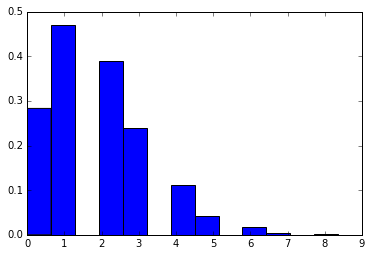

1
0
2
2
2
0
3
3
3
3
1
1
1
3
2
1
3
2
0
0
3
0
2
0
1
3
1
1
1
1
0
0
2
7
1
1
1
1
3
1
5
5
1
1
1
1
0
0
2
5
5
3
6
0
0
2
1
3
3
2
3
1
1
0
2
3
1
2
3
0
2
0
1
2
2
6
2
2
3
1
1
0
0
2
0
1
1
3
6
1
1
1
4
4
2
1
1
2
0
1
3
0
0
2
0
0
1
1
3
3
2
5
2
3
1
3
0
2
2
4
3
1
1
5
3
2
3
1
2
1
1
0
3
3
0
2
3
2
3
1
5
4
3
2
2
3
1
0
1
1
2
1
1
0
4
3
1
2
1
0
0
2
0
2
1
2
2
1
0
5
1
1
0
1
0
0
2
1
0
4
0
0
0
3
2
1
3
1
4
1
2
3
2
0
1
1
1
1
1
2
1
2
2
1
3
3
2
5
1
1
2
1
2
4
0
1
1
0
3
1
0
3
1
1
0
2
1
3
0
0
0
0
0
2
1
2
2
1
2
3
1
1
4
2
0
1
1
4
6
2
3
3
1
2
1
1
2
2
3
2
1
3
1
3
3
2
1
6
2
0
2
1
4
2
0
2
2
1
2
3
3
0
4
1
1
2
0
1
0
3
3
0
2
0
3
4
1
1
4
3
4
4
2
0
1
0
0
2
3
2
2
0
3
1
1
2
0
3
2
2
1
2
1
2
3
1
2
0
2
1
4
1
1
1
1
0
2
3
4
2
3
1
2
2
3
1
3
2
2
0
1
3
2
2
1
0
0
0
0
1
3
0
1
2
2
2
0
2
1
2
2
1
0
8
2
3
1
4
3
2
1
1
0
2
0
4
4
0
3
1
4
0
4
6
3
1
2
0
3
3
0
1
0
1
1
3
1
3
3
1
0
3
1
2
0
0
2
0
2
1
0
2
2
2
1
2
0
1
3
2
1
0
3
2
4
2
1
1
0
1
0
3
3
2
0
0
3
1
1
5
3
1
1
1
1
2
4
2
2
5
0
2
0
0
1
2
0
0
0
2
0
0
1
5
1
1
0
2
2
3
0
0
2
2
2
0
4
5
2
4
2
1
1
1
2
0
5
1
1
1


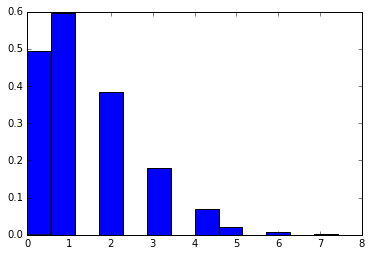

1
0
2
0
2
1
0
2
4
0
0
3
0
1
1
0
2
0
0
2
2
1
1
1
0
1
0
0
0
0
1
1
0
1
0
5
1
0
0
0
0
2
1
1
1
2
3
0
0
1
1
1
2
1
1
0
1
2
4
2
0
4
2
2
0
0
1
3
1
3
1
2
0
1
3
1
6
0
1
1
0
1
0
0
4
0
0
3
0
0
2
1
1
1
1
2
3
2
2
0
2
2
0
1
1
4
1
1
0
0
1
0
2
0
1
2
1
2
1
1
3
1
3
3
2
0
1
1
2
3
1
1
0
1
2
2
2
1
2
1
2
1
0
1
1
1
1
3
0
1
1
2
2
0
2
4
0
1
1
3
0
1
1
3
3
1
1
1
1
2
2
2
1
1
0
1
2
0
2
0
2
1
0
1
1
2
1
0
1
0
1
0
0
0
0
1
1
0
0
1
1
0
1
0
1
0
3
2
2
1
1
0
3
3
2
5
3
1
2
3
1
2
0
0
3
1
1
1
1
1
0
1
3
1
0
2
1
2
0
1
3
2
2
0
2
0
2
0
0
0
0
5
4
1
1
1
1
1
1
0
0
1
2
1
0
0
1
1
2
2
2
1
2
2
3
1
1
4
3
2
5
6
5
2
1
0
2
1
1
2
2
0
2
0
0
2
1
5
1
1
3
2
0
0
4
2
0
5
4
2
1
1
2
0
2
0
2
2
1
0
0
1
4
1
2
1
2
3
1
1
2
1
3
2
0
1
2
0
1
3
1
3
1
2
0
3
0
2
1
3
0
1
2
0
0
0
2
2
1
2
0
0
3
0
2
0
0
1
2
0
0
0
1
1
0
0
1
1
2
1
0
1
1
0
2
0
0
1
0
2
2
2
1
0
1
2
0
0
0
1
1
0
1
1
2
3
1
0
1
2
0
3
2
1
0
3
3
1
1
0
3
1
1
0
1
1
2
0
1
2
0
2
1
1
1
0
1
1
1
2
1
1
1
2
0
1
0
1
2
0
0
0
1
0
0
0
0
0
2
1
1
2
3
3
0
0
3
3
1
1
1
2
2
0
3
3
0
1
2
1
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
2
3
3
0
0


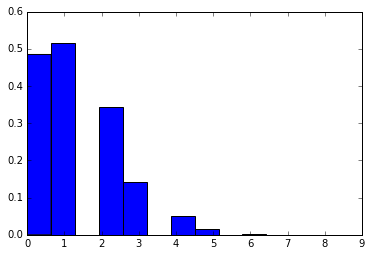

1
1
1
1
2
1
4
0
2
0
1
0
0
2
0
2
2
1
0
0
1
1
2
0
1
2
2
6
1
1
2
2
1
3
3
1
1
3
0
0
1
0
1
2
1
0
2
1
4
1
1
2
4
1
0
1
2
1
0
2
3
1
1
2
0
0
0
0
0
0
1
1
1
1
2
2
1
0
1
3
0
0
1
0
0
1
0
0
2
1
1
0
1
2
1
3
0
0
1
0
0
1
2
2
1
0
4
1
1
1
1
0
2
1
5
2
4
2
2
0
1
2
2
1
2
1
1
0
0
1
0
1
0
0
1
0
3
1
3
2
4
0
2
1
2
0
3
1
3
0
2
5
1
3
1
2
0
0
0
3
0
3
3
1
1
1
1
1
5
1
1
1
1
0
2
1
1
0
1
0
0
0
0
0
1
0
0
3
0
2
0
2
2
0
1
1
0
0
0
0
1
1
3
0
2
2
2
0
2
2
1
0
0
0
0
1
0
2
1
0
0
1
0
0
0
2
0
1
0
1
0
1
0
3
0
0
0
4
0
3
2
2
5
1
2
2
4
0
0
0
2
1
3
1
0
2
1
0
2
3
1
0
1
0
4
2
0
2
1
1
3
2
2
1
2
2
1
2
4
0
2
2
1
0
3
1
2
2
1
1
2
1
0
1
1
1
0
2
0
2
1
3
3
1
1
1
1
2
4
0
3
3
0
0
2
3
2
0
0
5
2
1
1
0
1
2
0
3
1
0
1
1
2
1
0
3
0
1
3
2
3
1
1
1
4
0
1
0
1
0
1
0
0
2
1
1
0
2
2
2
1
1
0
0
1
0
1
4
3
1
1
0
0
1
4
0
0
0
3
1
3
0
3
4
2
2
1
2
2
1
2
0
3
2
0
3
0
3
0
1
0
0
2
0
1
0
2
1
1
3
0
0
1
0
1
0
1
0
2
0
0
1
0
2
2
2
0
0
1
0
0
2
2
1
0
1
1
2
1
1
1
0
1
2
0
3
1
0
2
1
3
1
1
0
1
2
1
1
0
2
0
1
0
0
0
0
0
1
1
0
0
1
0
3
0
0
1
1
1
0
1
0
1
1
2
1
1
1
2
0
0
3
0
0
4
1
0
0
2
4


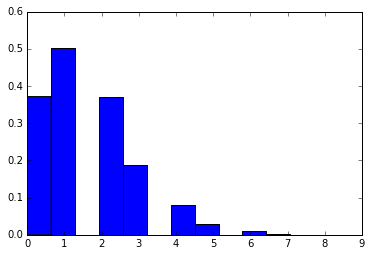

1
0
1
0
0
0
1
1
0
1
1
4
1
2
2
1
1
0
0
1
0
3
0
0
2
1
0
1
2
2
0
1
2
2
1
2
0
1
2
3
1
0
0
1
1
1
1
1
1
2
2
4
1
2
1
3
1
0
2
2
1
1
0
1
0
2
2
3
1
2
2
1
1
1
1
5
2
0
1
2
2
1
0
0
0
2
1
3
2
3
2
0
3
2
1
2
1
1
2
1
1
4
1
0
0
3
1
1
0
0
5
1
2
3
2
1
0
3
2
1
2
3
4
2
3
5
1
2
1
1
1
4
3
1
2
1
1
2
4
2
1
1
4
2
2
3
0
4
2
0
6
2
1
2
4
5
3
1
2
2
1
2
2
0
1
4
1
1
1
0
0
5
2
2
3
4
3
1
0
1
0
2
0
3
1
2
2
1
1
0
1
2
0
2
2
1
0
2
2
2
1
2
2
0
3
0
3
2
1
1
2
0
1
1
1
0
0
1
0
2
1
0
0
1
1
0
0
0
6
1
3
3
0
2
4
2
4
5
2
3
1
1
1
2
1
0
3
0
2
5
2
1
1
1
0
0
1
1
2
4
2
1
3
5
2
5
0
0
0
1
2
1
1
2
0
2
0
6
2
3
0
1
1
4
0
1
2
1
1
1
0
1
1
1
1
3
1
0
2
2
5
0
2
3
1
0
0
2
0
0
1
1
4
2
1
0
1
1
0
0
0
2
1
1
2
3
1
2
1
0
2
2
2
2
1
2
1
1
3
1
3
2
1
2
0
1
1
1
3
0
0
1
2
2
0
2
0
2
2
1
1
1
1
0
1
3
2
2
0
1
2
1
0
1
1
0
2
0
2
2
1
2
3
2
1
4
0
2
1
2
0
3
0
1
2
0
0
0
3
3
3
2
3
1
0
1
1
2
3
3
0
0
5
0
1
1
1
1
0
2
1
0
1
1
3
3
0
1
2
2
1
0
1
3
2
4
0
1
1
1
0
3
1
1
3
1
1
4
0
3
2
0
4
0
1
2
2
0
3
2
0
0
0
0
1
2
1
1
1
4
3
0
1
0
0
3
5
0
2
1
0
1
1
3
3
0
1
3
3
1
1
1
3
1
1
3
1
2
2
2


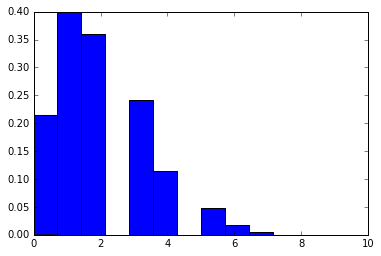

1
1
2
2
2
3
0
2
2
0
1
2
1
1
3
3
3
1
0
0
1
5
3
2
4
0
2
1
1
2
1
2
0
1
2
2
3
1
2
1
1
1
3
0
4
1
0
0
4
2
2
3
1
0
1
2
1
1
0
2
1
1
1
1
2
1
2
3
2
2
0
1
2
2
3
2
1
3
2
2
1
3
4
1
3
0
2
1
1
2
3
4
5
3
1
3
2
3
0
0
0
3
1
2
1
2
3
2
3
2
0
1
3
3
2
1
1
1
0
3
2
4
5
4
2
0
2
1
2
0
1
1
1
0
1
6
2
2
3
0
1
2
7
2
5
1
4
1
5
1
2
3
3
3
1
2
1
2
1
1
1
5
1
3
2
2
1
2
2
2
1
2
1
0
1
3
3
1
2
2
0
2
0
0
1
1
1
1
0
1
2
1
1
0
1
1
2
3
1
3
4
0
2
1
3
1
3
0
3
3
4
1
0
3
3
2
2
1
0
1
2
1
0
0
0
3
0
1
3
1
0
1
3
2
2
2
3
2
0
3
0
0
0
1
0
6
5
3
0
1
0
1
1
3
1
1
2
1
2
1
2
2
2
2
2
2
2
2
4
2
1
4
3
0
1
3
3
3
2
1
1
2
4
4
3
0
1
5
1
1
1
0
3
4
0
5
3
2
1
6
0
3
1
2
3
3
4
4
3
1
0
1
0
0
2
0
1
2
0
3
2
4
1
2
0
1
5
1
0
2
1
4
3
1
6
4
1
2
1
3
6
3
1
2
1
5
3
1
4
2
1
0
3
2
1
3
1
1
3
2
2
1
3
3
2
1
4
3
2
2
2
1
5
0
1
1
3
4
2
4
2
3
3
0
2
2
3
4
2
0
3
2
3
3
2
3
1
3
2
1
0
4
3
1
1
4
1
2
4
1
1
3
1
2
1
0
0
1
4
0
0
2
2
2
2
5
1
2
1
1
1
3
1
1
6
4
2
2
4
4
7
2
3
3
2
2
2
3
1
5
1
0
0
3
3
3
1
1
0
2
1
2
0
0
1
1
1
3
3
2
2
0
0
3
3
1
2
0
2
2
5
1
2
0
1
1
5
0
0
3
0
1
3
1
3
2
2
6
3
1


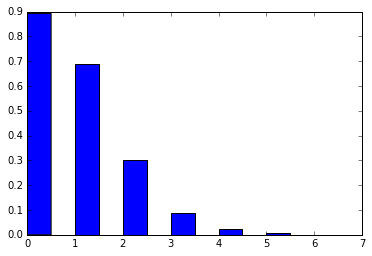

0
1
0
0
0
1
2
0
1
0
1
1
0
0
1
1
2
0
0
0
1
0
1
2
3
2
0
0
3
0
3
3
2
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
2
3
2
3
0
2
2
1
2
1
2
4
0
1
3
0
0
4
0
0
0
0
0
1
2
1
1
1
0
5
0
1
0
0
0
0
0
3
0
1
0
1
0
0
2
2
2
0
0
0
0
1
0
1
2
1
1
0
0
0
1
1
0
1
1
2
1
0
1
0
1
2
0
0
2
1
0
0
0
0
0
0
0
1
0
1
2
0
2
0
1
4
0
0
1
1
0
4
3
0
2
0
0
1
0
4
4
0
2
2
2
1
1
0
0
0
0
0
0
3
2
0
1
0
1
1
1
0
0
0
0
0
0
0
2
2
0
0
0
2
0
0
1
1
0
0
2
0
1
1
0
4
0
1
0
3
2
1
1
1
2
0
0
0
1
0
1
0
0
0
1
0
0
2
2
0
1
0
1
0
0
0
1
3
2
0
2
0
0
1
0
4
0
0
0
0
2
0
1
1
1
0
0
1
2
1
0
0
1
1
2
1
2
2
1
2
2
2
1
2
0
1
3
1
0
2
0
2
0
0
5
1
3
2
0
1
1
1
2
1
1
2
1
1
1
0
1
0
1
2
1
1
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
2
2
1
0
0
0
2
1
3
0
0
0
1
1
2
1
1
1
2
1
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
2
2
1
1
1
3
0
1
2
0
1
0
1
1
0
1
0
3
1
0
1
1
2
1
0
2
1
0
0
1
1
1
0
0
0
1
1
2
2
1
0
1
1
0
0
2
1
0
0
0
0
0
1
0
0
0
1
0
0
2
0
0
0
1
0
0
1
2
0
0
0
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
0
4
0
0
2
0
1
0
1
0
1
0
2
0
0
1
0
1
1
2
1
0
1
0
2
0
0
1
0
0
0
2
1
0
1
1
1
1
0
1
0
4
1
0
0
1
1


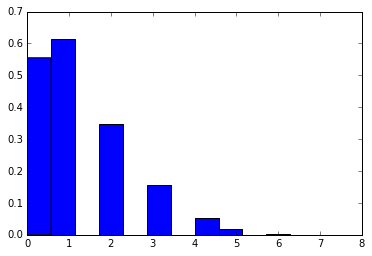

2
1
0
1
0
4
0
0
0
3
1
0
0
1
1
2
0
2
1
1
2
0
4
1
1
1
2
1
1
0
4
2
1
0
2
0
0
2
0
3
1
1
0
0
4
1
1
1
2
0
1
1
1
0
0
0
0
2
1
0
3
1
2
4
2
1
0
1
0
1
0
0
1
0
2
0
0
2
0
1
0
0
1
0
2
0
0
2
1
1
3
3
0
1
1
1
1
0
1
1
0
1
1
2
1
1
1
1
0
1
2
1
1
1
0
2
1
4
2
2
1
2
3
1
2
1
1
3
1
2
1
0
0
1
3
0
1
0
0
2
3
3
2
1
2
1
2
2
1
4
3
3
2
1
2
1
2
1
0
2
2
2
2
1
1
2
0
2
1
0
1
1
0
0
0
1
1
1
1
1
0
0
1
2
1
1
2
1
0
1
1
1
3
2
3
3
2
0
1
1
2
2
0
2
4
1
1
0
1
0
0
3
0
1
0
0
1
1
0
0
0
0
1
0
0
3
0
1
1
2
2
1
0
0
0
1
0
1
1
1
2
1
1
4
2
2
1
0
2
2
1
0
1
1
0
1
0
0
2
2
0
1
0
1
1
0
1
0
2
2
1
5
2
3
1
0
0
3
2
3
1
1
0
2
1
1
1
2
0
0
1
1
0
1
2
1
1
2
2
2
0
3
1
3
0
1
0
1
1
0
0
2
0
1
0
0
5
2
2
4
0
3
1
0
0
1
0
2
2
1
1
1
0
0
3
1
3
5
0
2
1
1
0
0
0
0
0
0
1
1
0
2
0
2
0
0
0
0
0
1
1
2
2
1
1
2
3
0
1
1
1
0
4
1
1
2
2
3
2
0
2
2
3
0
1
2
3
0
0
0
2
0
1
1
1
2
0
0
0
3
0
2
5
2
1
5
3
1
3
0
1
2
2
1
0
1
0
0
0
1
2
0
0
1
2
0
1
1
0
2
2
0
2
1
0
1
1
0
0
1
0
3
0
0
0
0
0
0
1
2
2
0
2
3
1
0
0
1
0
1
0
0
0
0
0
2
0
0
1
3
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
0
0
2
1
0
3
1
0
3
1
2
2
1
1


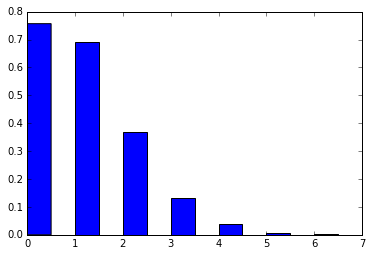

2
0
2
0
0
1
2
1
1
1
4
0
0
1
1
2
1
1
0
0
0
0
0
0
0
1
1
1
1
0
1
1
3
1
0
0
3
2
4
2
2
5
3
2
0
1
1
1
1
1
1
3
1
0
0
3
1
0
1
0
1
2
2
2
0
1
1
1
1
2
0
1
1
0
1
1
0
1
1
4
0
1
2
2
0
0
1
1
1
1
0
1
0
0
1
0
0
0
1
2
2
0
0
1
2
2
4
1
0
4
0
1
1
1
2
1
0
3
0
2
2
1
1
0
1
1
0
2
0
2
1
1
0
0
1
1
1
2
1
1
1
3
1
0
0
1
1
1
2
3
1
0
1
0
1
2
0
2
0
1
0
0
0
0
0
0
1
2
1
1
2
0
2
0
2
1
1
2
0
3
1
1
1
1
0
2
0
1
0
0
2
3
2
4
0
1
2
4
0
1
3
0
0
2
1
3
1
3
1
1
0
0
1
1
0
0
1
0
1
0
1
1
0
2
0
0
0
0
1
0
1
0
0
2
3
0
2
1
1
0
2
1
1
0
1
1
1
2
2
3
0
2
1
1
1
1
0
2
0
0
1
0
0
0
1
2
0
0
0
0
3
0
1
1
0
2
2
1
4
1
0
1
0
0
1
0
1
1
1
0
1
1
1
1
0
2
1
1
0
2
2
1
2
1
0
2
1
1
2
0
1
0
1
1
1
1
2
4
0
1
2
1
1
1
1
1
0
1
1
2
3
3
0
2
0
3
1
3
1
1
0
2
0
0
0
2
1
3
0
0
1
2
0
1
1
0
1
0
0
0
0
4
2
2
0
3
1
5
0
2
2
1
2
1
0
3
1
0
2
0
3
1
0
2
2
0
0
1
2
0
1
0
0
0
0
0
1
0
0
0
0
0
2
0
0
3
1
1
2
3
0
3
1
3
2
0
0
3
0
0
1
1
1
0
0
1
1
2
1
0
0
0
0
0
0
1
1
2
1
1
0
0
1
1
1
0
0
1
0
1
0
0
1
1
2
0
0
1
1
3
0
2
1
2
1
1
2
0
0
0
0
0
0
1
1
1
0
1
1
0
2
0
0
0
0
0
0
0
2
1
1
3
2
3
0
0
0
0
0
1


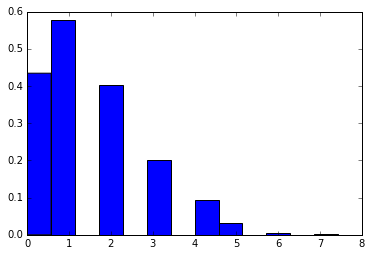

0
2
2
0
1
0
2
0
0
0
2
0
2
1
1
1
2
0
2
1
0
1
2
2
1
3
1
5
0
0
2
2
3
0
1
2
3
0
3
0
3
5
2
1
3
2
0
1
2
2
2
1
3
4
3
0
1
1
1
0
2
2
1
1
1
0
1
1
0
2
3
0
1
0
2
0
2
1
1
0
1
1
0
0
0
0
0
1
1
1
1
2
0
0
3
2
3
4
0
1
2
1
3
0
1
0
1
2
1
2
1
2
1
1
0
0
0
3
2
4
0
3
1
0
2
4
2
1
1
1
2
0
0
0
2
3
1
0
3
1
1
2
0
2
1
3
1
1
1
1
4
3
3
2
3
0
2
5
2
2
2
2
1
3
1
2
4
1
1
1
1
1
1
0
2
4
1
0
0
1
1
0
1
0
0
0
0
0
4
1
0
0
2
1
2
1
0
0
0
2
0
0
2
1
0
2
1
1
1
0
1
0
1
1
0
0
1
0
2
1
1
2
2
1
0
3
1
0
2
1
5
4
1
1
0
6
2
0
1
2
0
1
0
0
2
2
1
1
1
1
3
0
1
2
0
0
1
2
1
1
1
2
2
0
0
0
1
0
3
4
0
0
1
0
3
3
1
0
3
3
2
2
1
1
2
1
3
2
3
2
3
1
4
1
4
5
0
1
5
5
1
0
0
1
1
1
4
2
3
0
1
2
2
1
1
3
0
2
2
2
2
0
1
1
3
2
3
2
4
0
1
1
1
3
1
1
3
1
1
2
4
2
0
2
2
0
4
1
2
1
1
0
1
1
0
1
1
0
1
0
2
0
5
3
2
3
2
0
0
1
1
2
3
3
1
6
1
0
2
4
3
0
1
2
1
0
4
2
3
1
1
4
2
2
0
1
1
1
1
1
0
0
0
1
0
0
2
3
3
3
2
1
0
1
1
2
1
2
0
1
1
3
2
3
1
2
1
1
1
3
0
1
2
2
1
2
0
3
0
1
1
0
1
1
0
2
1
2
1
4
3
1
1
2
4
2
1
2
2
1
0
0
4
0
1
0
0
1
1
1
1
2
1
0
1
1
2
0
1
0
1
0
2
1
1
2
1
1
1
1
1
0
2
2
1
2
0
2
3
2


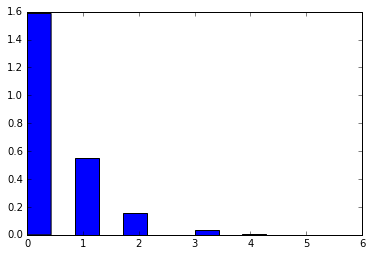

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
3
0
0
0
2
1
0
2
1
3
1
2
1
2
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
1
3
0
1
0
1
0
0
0
0
0
0
0
0
1
0
2
2
1
0
2
1
1
0
0
0
1
1
0
0
1
2
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
2
0
1
0
0
0
0
0
2
0
0
0
1
0
0
1
0
0
0
0
5
1
0
2
1
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
0
0
1
4
0
0
1
1
2
1
0
1
1
2
0
1
0
2
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
2
4
2
0
0
0
1
0
0
1
1
1
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
3
0
0
0
0
1
1
0
2
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
2
2
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
2
1
2
0
1
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
2
0
0
0
0
0
0
0
3
1
2
2
2
0
0
0
0
0
1
0
0
1
1
0
0
0
0
1
2
2
3
0
0
1
1
1
0
1
0
0
0
0
0
0
0
1
2
0
0
0
0
0
0
1
1
0
0
2
0
0
0
0
1
0
0
0
0
0
0
0
2
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
2
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
1
0
1
1
3
0
0
0
0
2
0
0
1
0
0
0
0
0
0
0
0
0
0
1
2
2
0
1
1
0
2
0
2
3
2
3
0
2
0
0
2
1
0
0
0
0
0
0
0
0
0
0
0


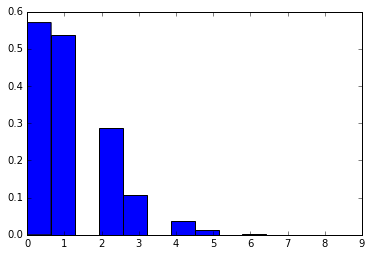

0
0
1
0
1
1
3
1
0
1
1
0
1
1
1
2
1
2
1
0
1
1
0
2
3
1
3
0
0
2
0
2
0
0
1
3
0
1
0
0
0
0
0
2
3
0
2
2
1
0
1
0
0
5
0
3
2
1
3
1
1
0
0
0
0
3
0
0
1
1
1
0
2
1
1
2
0
1
0
1
0
1
1
2
1
2
0
1
0
1
2
0
2
2
1
1
0
0
1
3
0
1
1
2
1
0
3
2
4
0
3
1
1
1
1
1
0
0
0
1
0
0
1
0
3
1
1
0
1
1
1
2
2
1
0
3
2
0
2
3
2
1
0
0
0
1
2
1
0
1
2
2
2
4
2
1
1
1
0
0
0
2
1
2
2
1
0
1
2
1
1
2
0
0
2
1
0
0
2
2
1
0
2
3
2
1
1
2
3
1
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
2
1
0
1
2
0
0
0
0
1
1
2
0
0
0
0
1
2
0
3
0
2
2
4
1
0
2
1
1
0
0
0
2
1
1
2
0
1
0
1
3
2
1
2
1
1
2
3
0
1
0
4
1
3
1
2
0
1
0
0
1
1
0
3
0
2
0
2
0
0
0
1
1
0
1
2
3
1
1
1
1
0
5
3
1
1
0
0
0
0
2
2
0
0
4
1
1
1
0
0
2
1
2
2
1
1
2
0
0
1
3
1
1
1
3
2
0
0
2
4
1
1
1
1
1
1
1
2
1
1
0
2
5
0
0
1
4
2
0
1
1
0
1
2
1
0
1
2
1
2
3
3
1
0
1
1
2
1
1
3
0
2
1
2
2
1
0
1
0
1
1
5
1
2
5
1
0
0
0
2
0
0
1
1
0
0
1
0
2
1
1
2
0
2
1
0
0
1
0
0
1
1
2
2
2
0
0
0
1
1
0
0
2
1
2
0
0
0
0
0
0
0
1
0
1
1
1
2
1
0
0
0
0
1
2
0
1
2
1
1
2
4
2
0
2
1
2
2
1
1
0
0
1
0
1
0
0
2
1
1
0
1
1
0
2
1
2
0
1
1
2
1
1
2
1
1
0
1
1
1
0
2
0
5
1
1
1
0
0
0
0
0
1


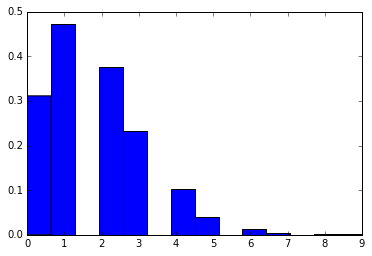

3
3
0
0
3
2
6
1
1
1
2
0
1
3
0
1
2
2
2
2
6
2
1
1
5
6
5
3
6
3
0
2
3
2
0
1
3
0
0
1
1
3
4
1
2
1
0
0
2
2
1
1
2
4
0
1
4
1
4
4
4
3
1
2
4
4
1
3
5
2
2
4
2
4
4
1
3
3
1
3
2
2
3
1
2
2
2
0
2
1
0
0
1
0
1
3
1
2
3
4
0
0
2
1
3
3
1
1
2
1
4
5
3
3
2
0
1
2
1
3
3
1
0
0
2
2
1
2
2
2
1
4
2
2
5
1
1
3
3
4
1
3
2
3
1
0
1
0
1
2
1
1
1
0
1
3
1
2
0
4
1
1
1
3
2
1
1
3
0
2
3
1
1
3
0
4
1
1
1
3
3
2
3
2
2
1
1
1
4
5
0
1
4
4
2
2
1
0
2
2
3
1
5
2
2
1
0
2
2
1
3
1
2
2
3
1
2
6
3
2
0
1
2
1
1
0
2
1
2
1
1
0
1
2
0
0
3
1
3
1
1
1
0
3
2
3
0
2
1
2
2
3
0
3
2
0
1
2
3
1
2
1
1
1
0
2
1
1
1
4
1
2
2
1
3
2
2
2
3
3
4
2
3
1
0
3
1
2
3
4
3
1
2
3
2
2
2
6
1
1
1
1
2
1
4
0
2
6
0
1
1
3
1
3
3
4
4
2
2
1
2
2
3
0
0
3
2
0
2
1
3
1
0
3
3
0
1
1
2
3
1
1
1
3
3
1
3
1
0
3
4
1
2
1
5
3
0
2
1
3
2
0
2
0
1
2
3
0
2
0
4
0
3
3
3
5
2
1
4
0
3
2
0
0
0
1
0
1
2
0
2
0
2
1
2
1
0
0
3
1
1
2
1
5
1
1
1
1
1
0
2
3
0
2
4
0
3
2
0
1
0
1
1
4
1
1
0
1
2
0
0
2
1
1
4
2
2
1
1
1
2
1
1
3
1
4
1
0
4
2
1
2
1
2
2
1
6
1
0
4
3
3
1
2
3
1
2
2
2
1
1
2
1
0
0
0
1
2
1
2
2
0
1
2
0
1
3
1
3
1
4
2
0
2
0
2
0
2
2
2


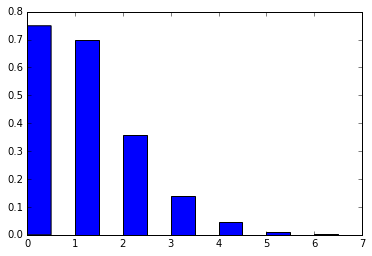

1
0
2
0
1
4
2
1
0
2
0
0
0
0
4
3
4
3
2
1
1
1
3
0
2
3
1
2
3
0
0
0
1
1
2
0
0
2
1
0
0
0
0
1
0
1
0
0
2
0
1
1
1
1
3
1
1
0
0
1
0
2
0
4
2
1
2
1
2
1
0
1
0
1
0
0
1
0
2
1
1
0
1
0
1
2
1
0
1
1
1
1
1
1
2
0
1
1
1
0
0
3
0
0
1
1
1
4
2
1
0
2
2
0
0
0
1
0
1
0
2
1
3
2
2
0
1
2
1
1
0
1
1
3
1
1
0
3
0
0
0
2
1
1
2
3
7
1
3
0
0
1
0
0
2
0
2
0
1
2
0
1
2
1
1
0
0
2
0
0
1
0
2
2
1
2
2
0
1
2
2
2
1
0
1
0
1
2
2
1
2
2
4
1
1
0
1
0
1
0
0
0
1
0
1
0
1
1
0
3
0
2
0
1
0
0
0
2
0
2
0
0
2
1
1
3
2
1
2
1
2
3
0
0
0
0
1
0
2
0
0
0
2
1
1
1
1
2
2
0
1
1
2
0
1
4
1
0
3
0
2
2
2
0
2
1
0
2
3
2
2
0
0
2
1
0
1
0
0
0
0
0
0
1
0
0
0
1
1
2
0
2
2
1
1
0
3
1
1
1
2
3
2
0
0
0
3
1
2
0
0
0
4
1
1
2
1
1
1
0
1
0
1
1
0
1
2
1
1
1
0
0
1
0
1
1
0
0
0
0
1
0
1
0
2
0
1
0
1
1
0
2
2
0
0
0
1
1
0
0
0
0
0
4
1
3
0
1
2
1
0
0
1
1
1
0
0
3
0
1
1
1
0
1
1
0
2
3
1
1
1
1
2
0
0
2
0
0
1
1
1
1
3
0
1
1
2
2
1
0
3
0
1
0
0
2
1
1
2
1
2
4
0
0
0
3
1
1
0
1
0
1
0
1
1
0
2
1
0
0
1
1
3
5
2
1
1
0
0
0
2
1
2
0
0
2
1
2
2
1
3
1
3
0
0
2
2
0
0
0
0
1
2
1
0
1
0
0
4
3
0
0
1
0
1
0
2
1
0
1
0
1
1
0
1
0
2
0
0
1


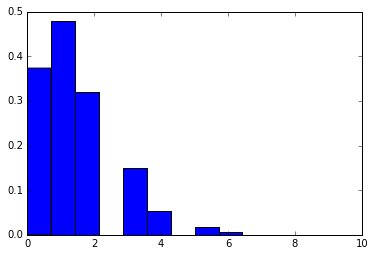

0
0
3
0
3
2
2
0
2
1
1
0
1
1
3
1
2
2
3
1
0
1
1
2
3
1
1
2
0
2
2
2
3
0
0
1
1
1
2
1
1
2
3
2
1
3
0
0
0
3
1
1
2
0
1
5
1
1
1
5
1
3
2
2
1
4
1
0
0
0
0
1
1
2
2
1
1
1
0
0
0
0
1
2
5
3
0
1
0
1
0
2
1
3
3
1
2
2
1
1
0
0
2
2
1
1
2
1
2
2
5
0
6
1
2
0
1
2
0
4
1
1
1
1
2
2
2
1
2
0
0
1
1
5
3
0
3
0
0
0
1
2
1
3
0
2
2
2
3
2
0
0
0
2
0
1
1
0
2
0
1
0
1
0
0
5
2
1
2
3
4
3
1
1
3
1
2
1
2
3
2
1
1
1
0
1
1
1
2
3
0
1
3
4
0
3
1
0
1
0
1
2
3
1
0
0
3
3
2
1
2
1
1
1
2
0
1
1
4
0
2
0
2
1
2
2
1
3
0
3
1
3
3
1
2
2
1
0
0
0
1
2
2
0
3
2
0
1
2
3
3
2
0
4
1
4
1
1
2
1
0
1
0
2
0
0
3
0
0
1
1
1
0
1
0
1
0
1
0
0
2
1
2
2
2
1
2
3
0
2
3
2
3
0
1
1
0
2
4
0
0
2
1
0
2
1
3
1
1
4
1
0
3
2
1
3
2
1
2
3
3
2
7
3
0
2
2
1
0
0
2
0
0
0
2
1
2
1
1
2
0
0
2
3
1
0
2
0
2
0
1
1
0
2
1
0
3
0
3
2
2
0
1
0
2
3
1
3
2
0
2
5
7
2
1
3
1
0
2
3
1
1
2
0
2
1
3
0
2
1
3
2
3
1
2
0
0
0
1
1
1
1
0
0
1
0
1
2
2
2
2
2
2
1
3
0
3
2
3
3
0
2
3
2
2
1
4
3
2
2
2
1
1
1
0
1
0
1
1
2
4
3
2
1
3
0
4
3
3
1
1
1
2
1
2
3
2
2
1
5
0
1
3
3
1
3
1
1
2
1
2
1
1
1
1
4
1
6
1
4
2
1
2
0
0
0
3
2
1
0
0
2
0
0
1
2
1
2
0
1


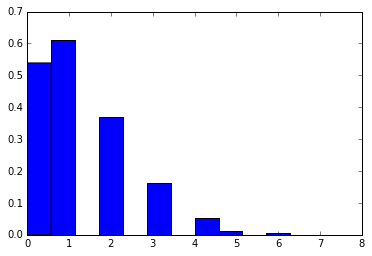

2
3
3
5
4
0
4
3
1
0
1
0
1
2
0
3
1
1
0
1
0
3
1
0
1
1
1
1
2
1
2
2
3
2
1
1
3
0
1
1
1
0
3
1
3
1
1
2
3
3
0
2
1
1
1
4
4
1
1
0
6
1
0
1
0
1
5
1
3
2
0
0
1
2
0
2
0
0
0
1
1
0
0
3
1
0
0
2
0
1
1
3
1
0
2
2
1
5
1
0
3
2
0
3
3
4
4
0
2
5
1
3
1
2
1
0
0
3
1
2
1
1
1
3
1
0
1
3
1
1
2
3
4
3
5
2
4
3
1
0
1
3
0
1
2
0
1
2
1
3
0
1
2
0
0
3
0
0
0
0
1
1
1
0
1
1
2
1
2
1
1
1
1
1
0
2
3
0
1
2
1
1
0
4
1
4
1
1
1
1
0
3
3
2
2
1
2
3
0
1
0
1
1
0
0
3
0
1
4
1
0
1
1
0
0
1
1
2
2
0
1
2
0
3
1
0
3
1
1
1
4
2
1
2
6
0
2
0
3
0
0
2
1
1
0
2
0
2
5
0
2
3
1
0
5
0
1
3
5
1
1
2
1
1
0
2
2
3
5
1
0
1
0
4
3
0
0
1
1
3
2
1
2
1
1
1
1
0
2
2
3
0
1
1
0
0
0
1
1
0
1
0
0
0
1
2
1
1
3
2
2
0
2
1
3
0
0
2
2
0
0
1
2
1
3
1
0
3
1
1
2
1
0
0
0
2
2
0
0
0
2
0
1
1
0
1
0
1
1
2
1
2
2
0
1
1
1
1
1
1
2
1
0
1
0
0
4
1
1
0
1
1
0
3
2
0
1
2
0
1
0
4
0
3
2
2
1
2
3
1
1
1
2
1
0
1
2
1
1
3
3
0
1
0
1
0
0
6
0
1
2
0
3
1
1
0
0
0
0
1
0
2
0
0
1
0
0
1
1
1
2
1
0
2
3
0
2
1
5
1
4
1
2
4
4
0
2
1
1
0
2
0
1
0
0
0
2
0
0
2
0
1
2
0
0
0
0
2
2
0
2
0
0
3
3
2
2
1
2
2
2
4
3
2
1
0
1
1
0
2
1
0
3
0
0
1
1
0
0
0


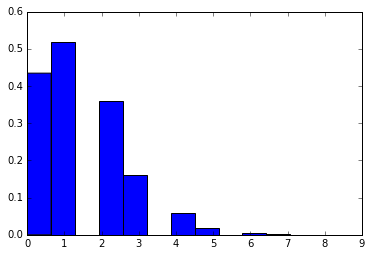

1
0
1
1
0
1
0
1
1
3
1
0
0
0
2
1
2
2
2
2
1
4
2
0
0
2
2
2
1
2
2
1
0
1
0
1
1
1
1
3
0
2
2
1
3
0
1
2
1
1
0
1
1
0
1
2
0
3
4
2
4
1
0
1
0
2
3
0
3
2
1
0
1
5
1
1
1
1
0
1
0
1
2
2
2
1
0
2
3
3
4
2
0
2
1
1
3
1
0
2
0
1
1
3
6
7
4
2
1
1
2
3
2
2
0
1
1
2
0
1
0
2
1
1
1
3
2
0
1
1
0
4
0
3
1
2
1
2
1
0
3
1
2
2
1
3
2
1
2
0
2
0
2
2
1
0
1
1
1
0
1
1
2
1
1
0
0
1
0
2
1
1
2
4
1
1
0
3
2
1
3
1
2
1
2
4
1
0
1
1
3
2
2
2
0
0
2
1
0
2
2
1
1
1
1
0
0
0
0
1
0
1
0
0
0
0
2
0
2
1
1
3
2
3
1
0
2
1
4
3
3
2
1
2
2
0
3
0
2
0
0
2
0
1
1
0
2
3
3
0
1
1
2
1
2
1
1
0
0
4
1
0
0
3
2
1
1
0
1
0
1
1
0
0
0
0
3
1
2
2
0
2
1
0
1
0
0
1
0
0
2
0
3
4
4
0
3
2
0
1
3
2
1
0
2
1
0
2
1
1
3
2
0
3
5
1
1
0
1
1
1
1
2
0
1
1
1
0
3
2
2
1
3
1
1
2
3
0
1
0
1
1
0
2
4
2
2
3
1
2
1
1
1
0
2
2
1
1
1
2
2
4
1
2
2
2
2
2
2
2
1
0
0
1
1
3
1
2
2
2
1
1
2
0
0
0
1
3
2
2
1
3
2
1
4
2
0
1
0
1
0
0
1
1
1
1
3
2
2
2
1
3
1
2
4
1
1
1
2
1
2
3
1
1
0
0
0
0
2
3
2
3
1
2
0
0
2
1
1
2
0
0
3
1
0
0
1
0
1
3
2
0
1
0
2
1
0
2
1
3
1
3
0
2
2
1
0
0
1
0
2
1
1
0
2
2
1
1
1
1
3
5
2
0
2
1
0
1
0
2
3
0
1
0
2
1
0
1
0
2


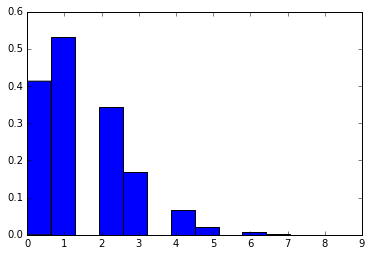

1
2
2
0
1
0
3
3
0
1
0
1
0
1
0
1
0
2
1
1
2
2
2
1
1
2
1
0
0
0
0
0
2
1
1
1
0
1
0
1
1
2
1
2
2
0
2
0
3
2
1
1
3
2
0
0
0
6
0
2
1
1
0
2
0
1
2
0
1
3
1
0
1
2
3
1
3
0
3
1
0
2
1
0
0
3
0
0
1
0
0
2
1
1
0
1
0
0
4
1
2
1
0
1
2
2
1
1
2
3
2
1
2
0
0
0
1
1
1
0
0
0
0
0
1
2
0
1
3
1
2
2
0
2
2
1
2
0
1
1
2
2
2
1
3
2
0
4
1
2
1
2
1
0
1
1
0
0
1
0
0
0
1
0
1
4
2
1
2
2
5
1
3
1
2
0
2
4
1
2
2
1
2
1
1
0
3
1
1
1
3
0
1
1
0
0
0
1
1
0
0
1
0
2
0
2
2
2
0
1
3
1
1
2
0
0
1
2
1
0
0
2
1
2
3
0
2
1
2
1
2
2
0
0
3
0
2
3
1
1
2
3
2
0
3
0
1
1
2
1
3
0
1
0
2
2
0
2
1
1
2
0
3
0
0
1
2
2
1
2
6
3
3
1
0
2
3
2
2
1
2
2
2
2
1
1
1
0
3
0
2
0
0
1
3
1
2
1
1
3
2
0
1
1
0
2
2
0
0
3
1
0
2
2
0
1
1
0
2
1
1
1
1
1
0
0
0
1
1
0
0
0
2
1
3
1
1
2
2
1
2
1
0
1
1
4
1
2
0
2
2
4
1
2
2
1
0
1
1
2
2
1
4
1
1
2
0
0
1
1
1
2
0
1
3
3
0
3
2
3
0
0
1
2
1
2
1
1
1
1
0
2
1
1
0
1
3
1
1
1
2
1
0
0
3
2
1
1
2
3
1
0
1
1
2
0
0
0
0
0
1
2
0
2
1
1
2
0
1
0
0
2
1
0
2
2
2
1
0
1
3
2
1
1
2
2
3
2
1
4
2
3
5
0
2
0
1
0
3
2
3
1
0
4
3
0
0
1
2
0
0
3
1
2
2
1
3
2
0
1
4
1
1
0
3
1
1
1
1
1
0
3
0
1
0
0
1
1
2
1


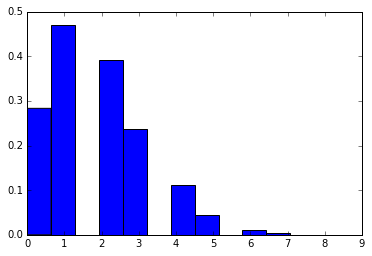

2
3
2
1
1
6
2
1
1
2
5
1
2
2
3
2
2
1
0
4
2
0
4
2
2
1
0
1
0
1
3
1
1
3
1
1
0
1
2
3
2
1
2
4
3
2
1
0
3
1
2
2
3
1
0
0
1
2
1
3
3
3
3
3
1
1
1
1
2
2
0
3
3
1
2
0
2
2
0
4
6
0
1
1
2
3
0
1
0
0
2
1
2
2
3
1
2
3
2
1
3
1
2
2
1
3
5
1
0
2
0
3
1
3
1
2
0
1
0
2
3
1
0
2
2
3
1
2
1
3
2
4
2
2
1
4
1
3
0
2
6
0
0
1
3
4
2
1
4
5
0
3
0
2
3
2
2
1
2
3
1
0
1
2
3
0
0
3
2
0
3
1
2
2
3
0
3
2
3
0
0
6
1
5
4
0
3
1
3
4
4
3
3
1
1
0
0
0
0
2
1
2
2
6
3
3
2
7
1
3
3
4
1
2
1
4
3
0
3
3
3
3
2
1
1
0
2
2
1
2
3
2
1
1
2
0
2
2
2
1
1
0
1
0
0
1
2
4
2
1
3
6
1
1
1
3
2
1
2
0
4
1
3
2
0
3
1
0
2
2
5
1
1
2
2
0
2
1
2
2
4
1
1
0
1
1
1
2
2
3
2
1
2
3
0
2
2
1
1
3
1
1
2
0
4
3
3
1
1
4
3
3
3
5
1
0
5
0
0
0
4
1
5
0
2
3
1
0
2
2
0
2
1
0
0
1
2
1
1
1
0
0
1
1
3
3
1
3
1
3
0
1
0
3
3
2
1
2
1
4
1
2
2
2
1
3
1
4
2
1
2
1
2
2
1
0
5
2
1
2
0
3
0
2
1
4
1
2
1
4
3
0
1
2
4
0
0
6
3
3
1
1
1
2
0
3
1
3
1
3
1
4
2
0
0
3
1
0
2
3
1
0
0
2
3
1
2
1
0
3
0
5
4
3
2
2
0
1
1
1
1
2
2
4
2
4
5
1
0
1
1
3
0
0
1
1
6
1
3
1
2
1
0
0
4
1
2
1
1
1
3
2
2
3
1
0
2
1
3
3
2
2
2
0
1
3
1
1
0
1
3
1
1
2
0
1
2
1
1
1


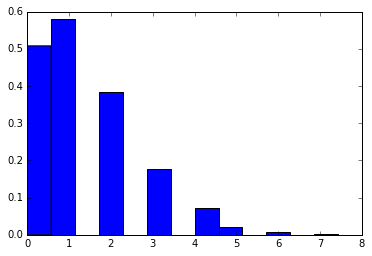

0
0
0
2
1
1
4
1
0
1
3
0
1
0
3
2
2
1
2
2
2
3
0
0
0
6
4
0
0
0
2
0
0
0
0
1
1
2
3
1
2
2
2
2
3
2
4
0
0
2
1
2
0
1
0
2
2
2
0
2
2
0
1
0
1
0
3
1
2
3
5
1
1
3
1
2
6
0
2
1
0
2
1
1
2
5
2
1
0
0
0
1
0
2
3
1
0
1
3
1
0
0
0
1
1
2
4
1
3
4
2
4
3
2
2
2
1
2
0
1
1
0
2
2
0
0
2
2
2
2
3
2
4
0
4
3
3
3
1
0
0
0
0
1
0
2
2
0
3
1
3
0
2
1
1
3
4
1
2
3
0
0
1
1
2
2
0
1
2
1
1
2
0
1
0
1
4
4
3
2
3
2
2
1
2
2
1
1
1
2
1
3
2
1
2
1
0
1
2
1
1
0
1
1
2
1
3
2
0
0
2
0
1
1
3
2
4
5
3
1
3
1
2
2
1
1
3
1
4
0
2
0
2
1
3
1
1
1
2
0
1
0
2
1
1
1
2
0
1
3
2
4
0
4
3
0
0
1
1
1
1
0
0
2
0
0
3
1
0
0
0
2
0
1
0
1
0
1
0
0
1
0
1
0
0
1
1
2
2
1
2
1
4
2
2
0
0
1
1
4
0
2
0
1
1
0
1
6
2
2
2
0
2
4
2
2
1
0
1
2
3
4
2
3
3
3
1
6
1
2
2
1
1
2
2
1
0
1
0
2
0
3
1
1
4
1
3
0
1
1
2
4
1
4
1
0
1
1
3
2
1
3
0
1
1
4
0
1
2
0
2
1
1
1
0
1
2
2
1
1
2
1
0
0
1
2
2
3
0
0
1
3
1
2
1
1
2
0
0
2
2
1
0
1
1
2
0
0
5
1
0
1
1
0
3
1
1
0
0
1
2
2
1
1
1
0
2
1
0
0
4
0
1
1
0
0
2
0
1
1
0
2
1
2
2
1
1
1
1
1
1
1
0
0
0
1
1
1
4
0
4
1
4
0
2
3
1
3
3
1
0
2
1
2
1
0
0
2
4
3
2
2
1
1
0
2
2
1
0
0
0
2
1
1
0
3
1
0
4
3


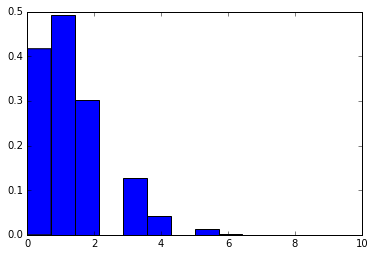

0
0
2
0
1
1
1
0
0
1
0
1
1
1
0
2
1
0
2
0
2
1
0
4
1
4
1
1
2
0
0
2
1
2
0
0
1
1
0
1
1
0
2
3
1
1
1
2
2
0
2
1
1
0
1
2
2
0
1
5
2
4
2
1
0
3
0
1
1
1
1
1
0
1
1
1
2
0
1
0
1
2
3
2
1
1
2
2
1
0
0
0
0
3
1
0
0
0
2
0
1
0
1
0
5
0
4
0
2
2
2
3
2
1
2
1
0
2
3
4
1
1
2
0
0
1
0
1
0
0
1
0
0
0
1
1
1
1
1
1
3
1
2
1
0
1
2
1
2
1
0
1
2
2
2
0
3
4
0
1
0
2
0
0
1
1
2
1
2
1
2
1
0
0
1
3
3
0
1
0
3
1
1
2
1
3
0
1
2
0
1
2
1
1
1
0
1
0
0
1
0
0
0
1
1
3
1
1
1
2
1
3
1
1
0
0
0
1
2
1
0
0
2
1
0
4
1
0
1
1
0
3
2
3
1
1
1
0
0
4
1
2
0
1
1
1
2
0
1
1
1
4
2
1
0
2
0
0
0
2
2
0
1
2
0
1
0
2
2
0
2
1
0
1
1
3
1
2
1
1
3
0
1
2
1
1
0
1
5
3
3
0
3
1
0
0
3
2
2
2
0
2
1
1
0
0
1
0
0
1
1
0
3
1
1
2
5
3
1
4
0
0
0
1
1
0
3
0
1
1
1
0
3
1
1
0
3
0
4
1
0
4
5
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
2
2
1
1
0
1
2
0
0
1
3
0
2
1
1
3
1
2
2
3
0
1
2
5
1
1
4
1
0
3
0
0
1
3
0
1
1
1
0
0
3
0
0
2
1
1
0
1
0
0
1
1
0
1
1
1
0
2
0
0
2
1
2
3
0
0
0
2
0
2
1
2
1
0
3
1
0
1
0
2
0
2
0
0
3
5
1
0
3
1
0
0
1
1
2
3
2
0
3
0
1
2
0
0
1
1
2
1
2
0
1
3
1
3
0
2
2
3
1
2
0
0
3
2
4
2
2
2
1
1
1
1
0
1
1
1
1
4
0
1
0
1


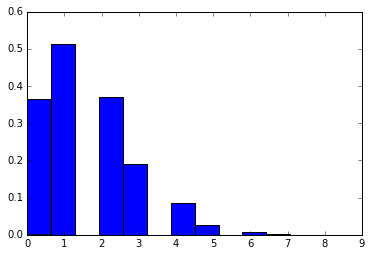

2
0
2
3
2
2
1
0
2
0
0
1
1
2
2
1
3
0
2
6
5
2
4
2
1
3
3
0
2
2
1
1
0
0
0
3
1
1
0
0
3
2
1
1
0
2
1
2
0
0
1
0
2
2
2
1
0
0
3
0
3
2
1
1
2
0
1
0
3
0
5
2
2
3
0
1
2
0
5
0
2
1
2
1
3
2
0
1
1
1
1
2
4
3
2
4
1
1
2
0
2
0
1
1
0
4
6
1
0
3
1
2
2
1
2
2
4
1
1
5
1
1
0
1
0
3
1
2
2
3
4
2
3
0
0
3
2
2
3
5
5
2
1
2
6
2
2
3
3
2
2
1
0
1
3
2
1
4
1
2
0
1
2
0
3
2
1
1
1
1
1
0
1
2
0
1
2
3
0
1
0
4
2
1
2
3
1
1
0
2
0
4
4
1
0
2
1
5
1
0
0
0
2
0
3
3
1
0
0
0
0
0
0
0
1
4
1
2
5
0
3
0
2
1
0
1
1
1
3
1
4
2
0
4
0
1
2
0
3
0
3
0
0
0
2
2
2
4
2
1
3
0
4
0
5
3
2
1
1
1
0
2
1
3
1
0
0
3
0
1
3
0
3
0
1
2
0
2
0
3
2
0
2
1
0
1
2
1
1
2
0
0
3
2
1
1
2
0
1
3
2
1
2
3
3
1
1
1
3
2
2
1
1
0
0
2
1
3
1
2
1
1
3
0
1
0
1
1
2
1
3
1
0
0
0
2
1
2
2
1
0
0
2
2
4
2
3
2
1
1
3
0
1
2
0
4
2
1
3
1
3
0
2
0
1
3
1
3
1
4
1
0
2
3
2
2
1
0
3
1
1
0
2
4
1
0
0
3
0
2
2
0
1
4
0
2
4
0
0
0
2
0
2
1
0
2
1
3
3
4
0
1
0
3
1
1
0
2
1
1
2
2
2
1
2
5
0
4
1
5
3
1
0
2
1
6
0
0
0
0
0
1
0
0
1
3
0
5
0
2
3
2
2
3
0
1
2
0
1
3
1
1
5
3
1
2
1
1
1
1
1
2
4
0
2
2
5
1
3
1
2
2
2
1
1
0
1
2
0
3
1
1
3
3
1
1
2
0
1
1


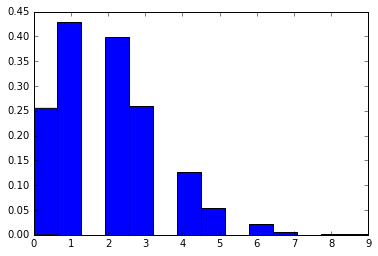

1
3
1
0
0
1
2
1
2
1
1
2
2
1
2
2
0
2
1
4
2
1
4
1
3
5
2
4
1
6
2
1
2
1
2
1
1
1
0
1
2
1
4
2
3
1
2
1
1
1
3
1
3
2
1
2
0
1
2
0
3
2
1
1
0
0
5
2
0
3
3
5
3
3
0
3
2
2
4
1
3
1
2
0
2
4
4
3
1
1
3
2
5
0
2
0
2
1
2
0
4
1
0
6
3
2
5
2
5
3
5
0
1
0
1
1
1
0
4
1
2
1
0
2
5
3
3
3
5
2
3
2
4
2
4
6
2
3
1
3
1
1
1
5
4
5
3
3
1
2
0
1
2
4
4
1
3
1
1
0
2
4
2
0
2
0
1
2
0
1
2
3
5
0
3
3
3
2
1
3
0
1
3
1
6
1
3
1
0
2
2
2
0
4
0
1
1
2
2
0
1
0
2
4
1
0
2
2
1
2
3
1
0
0
3
2
0
0
0
2
1
0
1
4
2
3
2
0
3
4
3
3
2
1
1
1
1
0
1
1
4
0
0
2
1
1
6
1
2
5
2
2
1
0
1
3
3
2
1
3
0
0
1
1
2
2
4
1
3
2
3
2
0
1
2
3
1
0
3
1
1
2
0
2
0
1
1
1
1
4
4
4
3
2
0
3
1
1
3
3
2
3
0
3
0
0
4
3
0
3
0
2
4
2
1
2
1
1
2
0
1
1
1
2
4
0
0
2
1
0
1
1
3
2
4
0
4
1
0
2
4
3
2
4
2
5
2
5
3
5
0
1
2
0
5
1
1
3
1
4
4
2
1
0
2
5
3
5
4
1
2
1
2
3
2
1
0
1
2
2
2
0
2
1
1
2
6
6
3
3
0
5
2
1
1
3
6
4
3
0
1
1
1
0
2
1
3
5
3
3
1
1
1
2
2
1
0
1
2
6
1
2
0
2
2
1
3
1
1
3
2
2
3
3
2
0
4
2
1
3
3
2
5
2
3
3
5
5
1
1
1
2
3
1
0
1
0
0
1
1
1
1
3
1
3
2
1
1
2
1
1
3
1
3
2
1
2
5
0
3
2
1
1
0
5
2
1
2
1
1
2
2
0
0
1
4
2
2
3
3


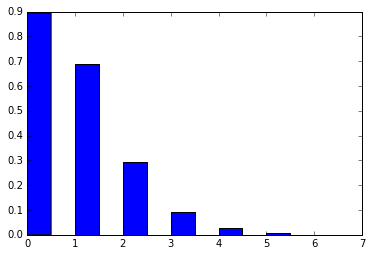

0
2
1
0
2
0
1
1
0
0
1
0
0
0
1
2
0
1
4
1
2
1
1
2
0
2
0
1
0
4
3
1
0
1
0
2
3
2
1
0
0
2
2
3
1
0
1
1
1
2
0
2
0
1
1
2
2
4
1
1
1
1
1
0
0
2
1
1
5
1
0
0
2
1
1
2
2
0
2
1
1
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
3
2
1
2
0
0
2
2
1
2
2
3
1
2
3
2
5
0
0
0
0
2
1
0
1
1
2
0
1
3
0
0
0
0
1
0
1
1
2
1
4
2
2
0
2
2
0
1
0
1
2
0
3
1
0
0
0
0
3
1
1
3
0
0
1
1
1
5
2
0
3
2
1
1
0
0
1
1
2
0
2
1
0
1
0
1
2
1
2
1
2
1
1
2
2
3
1
1
0
0
1
2
1
1
0
0
0
0
0
1
2
1
1
0
1
2
0
0
0
0
0
1
1
1
1
3
1
2
1
5
1
1
1
1
5
0
0
0
0
0
0
0
2
0
1
0
1
1
0
1
1
0
0
0
2
3
1
0
1
1
0
1
3
1
3
1
1
1
2
0
0
0
0
2
0
0
1
2
0
0
0
1
0
0
1
0
2
0
0
2
2
2
1
2
1
2
1
1
0
0
1
0
0
1
1
0
1
0
1
0
0
1
0
0
1
0
1
2
0
0
0
2
1
1
0
1
1
1
0
1
2
1
1
0
0
0
0
1
1
2
1
1
0
1
1
1
1
0
4
0
2
1
1
1
2
1
0
1
2
0
3
0
0
1
0
0
2
1
0
1
2
0
0
1
0
0
1
1
0
3
0
3
1
1
1
0
1
0
0
3
1
1
1
0
0
0
0
0
0
0
0
3
0
2
1
0
1
0
1
1
0
1
0
2
1
3
0
1
1
0
0
0
2
2
0
2
0
0
0
0
0
1
3
0
0
0
0
0
1
1
5
1
0
0
0
0
1
0
0
2
0
0
0
2
0
3
2
4
0
0
2
1
1
3
0
1
0
1
0
0
0
1
0
1
1
0
2
1
0
1
0
0
1
1
3
3
1
0
2
1
1
0
1
0
0
0
0
1
0
2
0
0
0
0


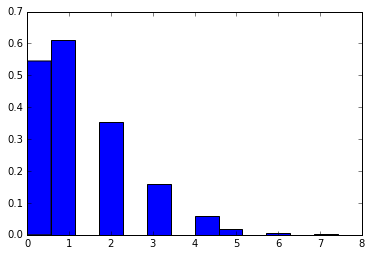

0
0
2
0
0
1
1
0
0
0
0
0
3
1
3
1
5
3
0
1
3
1
1
0
2
1
1
2
1
1
2
1
1
0
2
1
1
1
1
1
3
1
1
2
3
1
0
1
0
1
1
0
1
1
0
4
2
1
2
1
1
1
1
0
3
1
2
2
1
2
0
0
1
0
1
1
0
3
4
1
0
0
1
2
0
0
1
0
0
1
0
4
1
0
1
0
0
2
1
1
2
0
2
2
1
2
2
2
0
3
1
2
0
0
1
0
2
0
0
3
0
1
1
2
2
0
1
3
3
0
3
1
1
3
1
2
1
3
0
3
3
0
4
3
0
1
5
1
2
2
2
4
1
1
1
1
1
3
0
2
0
0
1
0
3
0
0
3
1
2
1
2
3
3
0
4
1
0
2
4
3
2
0
1
3
1
1
0
0
0
1
1
0
1
1
3
1
1
1
2
0
2
2
0
1
2
1
0
0
1
2
1
0
0
1
0
2
0
2
1
3
0
2
1
5
0
2
2
2
2
1
1
0
1
0
0
0
1
1
2
0
2
0
1
2
0
2
1
1
1
2
1
0
1
2
1
0
0
3
1
1
1
0
3
0
0
1
1
1
0
1
0
1
0
1
0
2
0
1
1
1
1
2
1
0
0
0
2
0
2
1
1
4
0
2
1
2
2
0
0
0
1
1
1
0
1
1
2
0
1
2
1
1
0
1
0
0
1
1
1
0
2
0
1
0
0
1
1
0
1
0
1
0
2
1
1
0
2
3
1
2
0
0
2
0
1
0
1
3
0
2
1
0
1
2
2
0
0
1
0
3
1
1
2
0
0
1
3
0
0
1
0
2
2
2
0
1
0
2
1
1
1
0
0
0
1
3
0
3
1
0
3
1
1
5
2
0
4
0
0
1
1
2
2
1
3
1
3
0
1
3
0
1
1
0
1
0
1
2
2
0
0
1
1
1
1
1
1
2
3
2
0
0
1
0
0
1
3
3
0
2
0
2
1
1
0
1
2
1
0
1
5
1
2
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
3
1
1
0
2
0
2
1
2
3
2
1
0
0
2
0
1
1
0
0
0
1
1
1
1
1
0
3
0


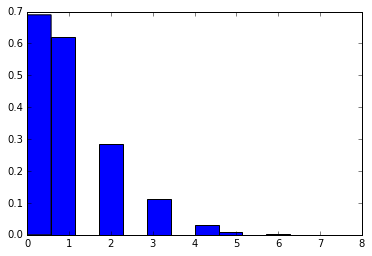

3
0
0
0
0
1
1
2
0
0
0
1
1
0
0
2
3
1
1
2
5
0
0
1
2
0
0
0
1
3
2
0
3
1
3
3
1
2
2
0
0
0
2
0
2
1
0
1
0
0
1
0
1
0
2
4
1
0
1
2
1
1
0
1
2
0
3
0
3
1
1
1
1
0
2
0
0
2
1
1
1
0
3
0
2
0
0
0
1
0
1
1
0
1
2
1
1
3
1
2
0
1
0
2
1
1
1
2
3
1
3
3
4
1
0
2
1
0
1
2
2
1
0
0
0
1
1
0
2
0
1
0
3
0
2
0
0
4
2
0
3
0
0
3
1
1
2
2
2
1
2
0
2
1
0
1
0
0
0
0
0
0
0
1
0
0
1
1
1
1
3
0
0
1
0
1
0
4
0
4
0
2
0
2
3
2
0
2
0
1
2
1
2
2
0
2
1
1
1
0
0
1
2
1
3
1
0
0
2
1
0
0
0
0
0
1
1
2
0
1
1
1
1
1
0
2
3
0
2
2
1
3
1
2
2
0
1
0
1
0
0
1
0
0
0
2
2
1
0
3
0
0
2
0
3
3
2
1
1
1
1
1
0
1
2
0
0
0
1
0
1
2
0
0
1
0
0
0
0
0
0
1
0
0
0
0
2
0
1
0
2
0
0
1
0
0
0
1
0
0
0
0
0
4
0
2
1
1
1
0
0
2
0
0
0
1
0
0
1
0
1
3
0
1
0
1
0
0
0
1
1
2
0
0
2
2
1
1
0
0
0
3
4
1
2
0
1
1
0
1
1
1
2
2
1
0
1
0
0
1
0
0
2
3
1
2
4
2
2
2
2
2
1
3
2
0
2
2
1
0
1
1
2
2
1
4
1
1
1
1
4
2
2
3
1
3
0
0
2
4
1
0
0
1
0
1
3
2
2
1
2
0
1
1
1
1
0
0
0
0
1
2
0
0
0
1
1
2
0
2
0
0
1
0
1
0
0
0
0
0
0
0
3
0
0
3
0
0
2
1
0
0
0
0
2
0
0
1
1
2
1
0
2
0
1
1
0
2
1
1
1
1
0
0
1
2
2
2
2
3
1
2
0
0
1
2
2
0
2
1
1
1
1
1
1
0
0
0
1
0


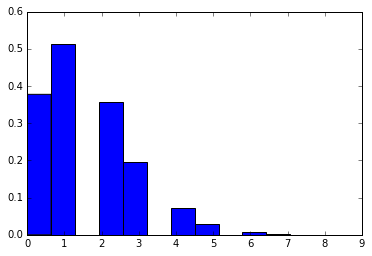

0
1
1
2
2
0
4
1
1
0
0
0
1
0
3
1
3
3
2
2
0
3
4
3
2
1
1
1
2
2
0
2
2
2
2
1
1
2
3
1
3
2
5
3
0
1
2
0
0
1
1
3
2
1
1
3
0
0
0
1
1
0
0
2
1
1
2
1
3
3
2
1
0
2
1
1
2
1
1
2
3
1
1
3
0
0
2
1
0
2
0
0
4
0
0
3
1
0
1
1
2
0
2
1
2
1
2
2
3
2
5
1
2
1
1
1
2
2
1
1
4
2
2
0
0
2
1
2
1
1
1
1
1
1
0
4
4
4
2
3
1
0
1
2
3
2
2
2
5
2
3
2
1
5
4
1
4
3
2
3
2
0
0
1
2
2
2
3
0
1
3
2
3
1
2
4
2
1
3
1
3
0
4
3
2
3
2
5
0
2
0
1
1
0
0
0
0
2
1
0
1
1
1
2
1
1
2
1
3
0
2
1
1
1
0
6
3
1
2
3
3
4
4
1
2
2
1
5
2
5
1
2
0
1
2
2
0
2
1
2
0
1
1
2
1
1
1
2
1
0
3
2
4
1
0
3
1
2
1
1
0
1
1
0
0
1
2
2
1
2
2
3
0
4
1
2
0
2
0
3
1
0
0
0
0
0
1
2
1
5
2
1
0
1
1
0
2
0
2
0
1
4
3
2
4
0
1
0
2
1
3
1
1
1
0
2
1
1
3
1
2
0
1
1
0
1
0
2
0
1
1
2
2
1
1
2
0
4
0
2
0
0
4
1
1
0
1
1
0
1
1
2
0
4
0
1
1
1
2
1
1
5
2
1
2
2
1
3
1
0
2
0
1
2
0
1
2
5
1
0
2
1
0
0
3
3
4
1
0
1
2
2
2
0
4
1
2
2
0
1
3
3
0
0
0
0
1
2
1
1
1
1
0
1
4
0
0
0
0
0
1
2
2
1
1
4
3
1
5
0
3
3
3
1
2
1
1
3
2
0
1
0
6
0
2
1
2
3
2
1
2
5
0
0
3
4
1
3
0
0
0
0
0
1
0
1
0
0
3
2
1
0
0
0
1
1
0
0
1
0
0
0
2
3
1
4
1
1
1
0
0
0
0
1
2
0
1
0
2
0


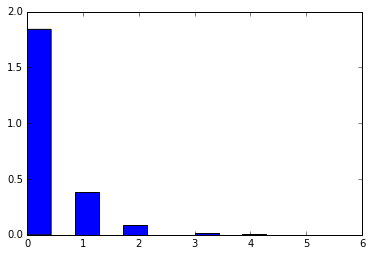

0
0
0
1
2
0
1
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
2
1
2
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
1
0
4
1
0
0
0
0
0
1
1
0
0
1
1
0
0
0
2
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
2
0
0
0
0
0
0
1
2
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
2
1
0
3
2
1
0
1
0
2
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
2
1
1
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
2
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
2
1
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
2
0
0
0
2
0
1
1
1
0
0
0
0
0
0
0
0


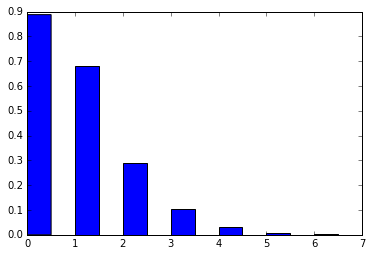

0
2
1
0
0
1
2
1
1
1
1
0
2
1
0
0
0
0
3
0
0
1
0
1
1
0
1
1
1
1
1
1
1
1
0
0
3
1
4
1
0
2
0
0
2
1
0
2
0
1
1
0
1
1
1
1
0
1
3
2
2
0
0
1
1
1
1
1
4
1
1
1
0
1
0
0
2
0
3
4
1
0
3
1
2
1
2
0
2
0
1
0
1
3
1
1
4
0
1
1
3
0
1
0
2
0
0
1
1
2
1
0
0
1
1
1
1
1
0
2
0
0
2
1
2
2
1
0
0
2
0
3
0
1
0
3
1
1
1
0
1
0
5
0
1
2
0
0
2
0
2
2
2
0
0
0
0
0
0
0
2
4
0
0
0
0
0
0
0
1
0
0
1
1
0
3
1
0
1
1
2
1
1
0
3
3
1
1
0
1
2
0
0
0
1
0
1
2
0
0
2
2
0
2
1
2
0
2
0
0
0
1
4
1
4
2
0
0
1
2
0
2
3
0
2
0
2
1
0
3
1
1
0
0
0
0
0
1
1
1
1
4
6
0
2
0
2
1
2
1
1
1
3
2
0
1
3
2
2
1
2
1
0
0
1
0
0
4
0
0
1
0
1
1
0
2
1
1
2
1
0
1
1
0
1
1
1
2
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
2
1
2
1
0
0
2
1
1
0
1
1
1
0
0
0
0
1
2
1
4
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
1
3
1
1
1
1
2
0
1
1
2
2
1
1
1
0
3
0
3
1
1
4
2
1
0
0
3
0
0
0
1
1
0
1
3
0
4
2
0
0
0
1
0
1
0
0
0
0
1
0
2
0
3
0
4
2
1
2
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
2
1
2
3
0
2
0
0
1
0
0
0
1
0
1
0
1
0
0
1
2
1
1
2
3
1
1
3
3
1
1
2
1
3
1
3
1
0
1
0
0
1
1
1
1
0
1
0
0
0
1
1
2
0
1
0
0
0
0
0
1
1
2
0
0
0
1
1
2
0
2
0
3
2
1
4
2
0
0
0
1
2
2


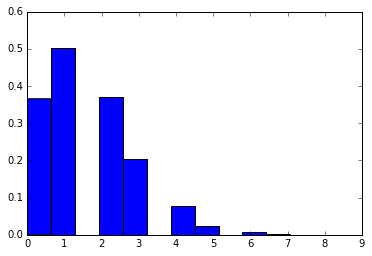

2
3
0
3
1
2
1
3
5
1
2
1
2
2
3
1
0
1
0
0
0
3
1
1
0
2
2
2
1
6
0
1
1
0
0
0
0
0
2
2
2
2
3
4
1
3
1
1
0
2
3
0
0
0
0
0
1
1
0
2
5
1
3
2
2
3
1
3
0
3
3
2
0
3
2
1
1
4
3
1
2
0
1
2
2
2
4
2
1
4
2
1
4
1
1
0
1
3
3
1
2
1
3
2
2
0
1
2
1
0
2
2
3
1
1
2
3
3
0
4
0
4
0
2
3
1
2
2
1
2
1
1
0
3
1
2
3
2
1
2
1
2
0
2
0
1
3
0
1
3
1
3
5
4
1
2
2
2
2
1
1
0
3
1
1
0
0
0
2
0
1
1
1
2
2
1
2
2
1
2
3
1
1
2
3
2
3
1
0
0
2
3
1
2
1
2
2
2
2
1
3
2
2
3
6
4
7
3
1
3
0
2
1
2
2
2
2
2
0
2
0
2
5
0
1
0
0
0
3
1
0
0
0
2
0
1
2
1
1
4
3
2
3
2
3
1
2
2
0
0
2
0
1
3
1
1
2
2
2
2
1
1
0
4
1
3
1
3
1
4
2
1
2
5
1
1
4
4
2
2
2
1
0
2
0
2
1
2
3
0
1
2
1
2
2
5
1
2
2
0
0
0
1
1
2
0
0
2
2
0
2
1
2
1
1
1
1
0
3
1
1
1
1
5
1
1
1
3
0
1
1
9
1
1
3
5
1
2
3
2
1
0
1
0
1
0
3
2
2
3
0
0
0
1
5
1
0
2
1
1
2
3
1
2
2
2
1
0
1
2
2
2
0
0
1
0
1
1
4
2
6
3
1
0
0
1
1
1
1
1
2
0
0
4
1
1
2
2
1
2
1
2
1
2
3
2
1
3
2
0
1
1
1
1
2
1
1
0
0
3
1
2
1
0
2
3
0
0
1
1
2
3
1
0
3
2
0
3
0
2
1
2
1
1
3
0
3
1
0
0
0
2
3
2
1
0
3
3
1
0
2
3
0
3
1
0
1
3
0
1
2
3
0
0
0
0
2
1
3
2
1
1
0
2
1
1
0
3
2
5
4
3
0
1
2
1
2
0
0
1


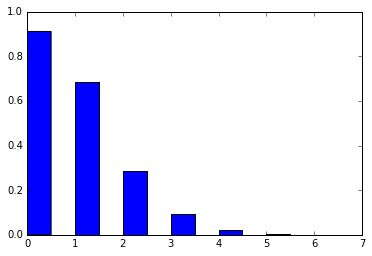

0
2
3
2
0
2
0
1
3
0
0
1
0
0
2
1
2
1
1
1
0
0
3
0
0
2
0
1
0
0
0
0
1
2
0
2
0
2
0
0
2
0
0
1
1
0
0
2
0
1
1
1
0
1
0
1
0
0
0
1
1
2
1
2
4
0
1
2
3
2
1
1
1
1
1
1
1
1
1
2
1
1
3
1
2
1
2
2
2
1
1
0
1
1
1
2
2
0
4
0
1
0
3
2
1
0
1
2
1
2
1
0
0
1
0
1
0
1
1
1
3
1
1
1
2
1
1
1
1
2
0
1
0
1
2
2
1
1
1
0
0
0
2
1
1
1
0
3
0
1
2
0
1
2
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
1
2
0
1
0
0
0
0
0
2
1
1
0
1
1
1
1
1
0
0
0
2
0
0
0
1
0
3
1
1
1
0
0
0
1
0
0
4
1
1
1
1
2
0
1
0
3
0
0
2
3
0
1
2
3
1
2
0
0
0
1
0
0
1
2
0
0
0
0
1
1
0
1
1
1
1
1
0
2
1
0
0
0
0
1
3
2
0
2
0
0
1
4
1
1
1
1
3
0
0
2
0
0
2
1
0
0
0
1
0
1
1
2
2
0
0
0
0
0
2
0
1
0
0
1
2
1
1
0
0
2
0
1
0
1
1
0
1
1
1
2
0
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
2
1
2
0
0
2
1
0
0
0
0
0
1
2
2
1
0
1
1
0
0
1
1
0
2
0
0
0
0
0
0
1
1
1
1
2
4
0
1
0
0
0
0
0
0
3
0
0
0
0
0
1
0
0
1
2
1
0
0
1
1
1
0
3
1
1
0
1
0
0
1
0
0
1
0
0
1
2
0
2
1
0
2
0
0
1
1
1
0
2
0
0
1
0
0
1
1
0
0
0
3
1
1
0
0
0
1
0
1
0
0
1
0
0
1
0
3
0
2
0
1
1
1
0
1
1
3
2
2
2
0
1
1
1
2
0
1
0
0
1
0
0
0
0
1
0
1
1
1
0
1
0
0
4
0
3
1
2
1
0
0
0
1
0
1
1


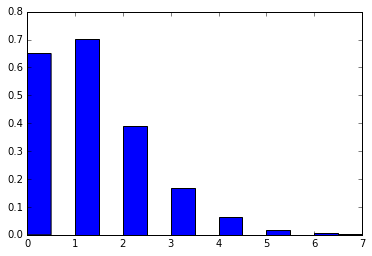

0
0
2
1
0
0
3
1
2
4
3
2
0
1
1
0
1
2
0
0
2
0
4
0
2
0
0
1
1
1
0
1
0
3
1
0
2
1
1
0
7
2
2
3
1
1
1
1
0
1
0
1
2
2
3
2
0
2
0
1
3
0
1
1
3
2
3
2
1
3
4
2
0
1
2
1
0
1
0
0
0
2
3
3
1
5
3
1
0
1
1
3
1
0
0
2
0
1
3
1
2
3
3
0
2
1
0
3
1
0
0
5
3
1
1
0
2
1
1
1
0
1
0
2
2
2
1
0
4
1
1
2
3
1
0
1
1
3
2
0
0
4
3
1
1
1
0
0
1
2
1
2
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
4
1
0
0
0
3
1
1
0
3
3
2
3
1
3
2
1
5
1
1
1
2
1
2
2
0
0
0
0
0
0
1
0
2
2
1
0
0
2
1
1
2
1
0
0
1
0
3
3
1
0
0
0
0
1
0
1
4
0
1
0
1
4
0
1
0
0
1
1
0
1
0
0
0
1
0
3
2
0
0
1
1
0
1
0
1
2
0
2
2
1
1
0
3
0
1
1
0
0
0
0
2
0
2
2
0
1
1
0
1
1
1
2
0
1
3
0
1
0
2
0
1
3
0
1
1
2
2
2
0
0
2
1
0
0
1
1
0
1
0
4
2
1
0
1
2
4
0
3
2
0
2
1
2
4
0
1
1
1
1
3
0
2
1
2
1
1
1
2
0
0
0
1
1
1
2
1
1
3
0
0
1
1
2
0
0
0
1
1
1
1
2
2
1
1
0
2
0
1
1
2
2
1
1
0
5
0
0
1
0
1
0
0
1
1
0
3
0
0
2
0
2
1
0
0
3
1
3
1
0
4
0
2
1
3
1
6
1
2
1
1
0
1
1
0
0
2
0
1
1
3
2
5
3
0
1
0
2
0
1
1
1
3
2
1
1
4
2
2
0
0
0
0
3
2
2
1
0
2
1
2
1
1
1
1
2
3
1
1
0
2
2
5
0
2
2
0
5
4
1
0
3
2
0
0
1
0
1
0
1
0
0
2
0
0
0
0
0
0
1
1
1
3
2
1
3
0
2
0
0
0
1
1


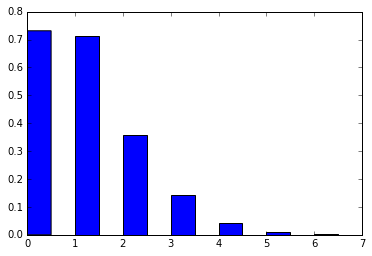

1
0
3
1
4
1
4
2
4
4
2
2
0
0
0
1
2
0
1
0
1
0
1
4
1
0
3
0
1
2
3
3
4
1
1
0
1
2
2
3
2
1
2
0
3
0
2
1
0
2
0
0
0
2
3
2
2
2
2
1
1
1
5
1
1
0
1
1
2
3
0
3
0
1
2
1
2
0
0
0
0
0
0
2
0
4
2
1
1
0
0
1
1
3
0
4
1
0
1
2
1
0
1
0
1
2
0
1
0
1
1
1
1
2
2
1
3
1
2
2
1
0
0
1
1
2
1
1
1
1
0
1
2
1
2
2
0
1
1
0
1
0
2
1
0
1
0
0
2
2
2
0
0
1
2
0
1
0
0
1
0
2
1
0
2
0
2
1
0
0
0
0
3
0
1
1
1
2
1
2
2
0
1
0
1
2
0
1
2
0
2
0
1
0
0
2
3
1
0
1
1
0
0
2
1
2
0
1
3
1
1
0
3
0
0
1
3
0
0
1
0
2
0
3
1
0
3
2
1
0
1
0
0
3
0
1
0
3
1
2
1
1
0
1
2
1
1
2
1
0
0
0
1
1
2
0
0
1
0
1
3
2
0
2
2
0
1
0
2
0
2
1
1
2
2
0
2
1
0
0
2
1
2
0
2
1
1
0
0
0
1
0
0
0
0
1
2
1
2
0
0
2
1
2
0
0
0
1
0
1
0
1
2
1
0
3
0
1
0
1
1
0
1
1
3
1
0
3
1
2
2
1
3
0
0
1
0
1
0
1
2
1
1
1
0
1
2
1
1
2
1
2
1
0
1
1
1
1
2
0
1
1
2
3
2
2
1
0
0
0
0
0
0
2
2
0
3
0
4
2
3
1
1
2
1
1
0
0
1
0
1
0
1
0
1
1
0
1
0
3
0
1
0
2
0
1
0
1
0
1
0
0
0
5
1
4
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
2
1
0
0
3
0
0
1
1
1
0
1
0
0
2
2
0
0
1
0
1
0
0
2
0
1
1
1
1
1
1
2
1
1
3
1
1
1
1
0
0
2
4
1
1
0
1
2
1
0
1
1
2
0
0
0
3
1
1
3
0
0
0
0
2
1
1
0
1


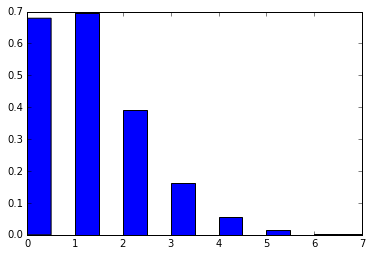

1
0
0
0
0
0
2
1
2
1
0
1
3
2
1
1
1
2
0
1
0
0
2
1
0
1
2
5
2
3
3
1
3
1
1
0
1
1
3
0
3
1
0
1
1
2
1
3
1
0
1
0
1
1
1
1
0
0
1
0
4
2
3
3
0
1
5
2
0
0
2
3
2
1
0
3
1
4
0
2
2
1
1
1
2
2
3
2
2
2
0
0
1
2
0
3
1
2
2
1
2
2
1
2
3
4
2
3
2
1
4
0
0
1
2
1
2
1
1
1
0
4
0
3
2
4
1
1
2
1
1
0
1
2
1
0
4
2
0
1
3
1
0
1
2
0
1
2
4
1
4
0
1
2
1
1
1
0
2
1
0
0
1
0
0
0
1
0
1
1
1
1
0
0
2
2
4
1
0
0
0
1
2
1
1
3
2
0
2
3
1
0
4
0
0
0
0
1
0
1
1
0
2
1
0
0
1
3
1
1
0
0
2
2
0
0
0
1
0
4
3
2
1
1
1
0
0
1
2
1
3
3
1
0
2
0
1
1
1
1
2
2
3
2
1
2
0
1
2
0
0
0
0
1
1
0
1
1
1
2
1
1
1
1
1
0
0
1
0
2
0
1
1
1
1
1
2
1
0
0
2
0
1
2
0
2
0
1
0
0
0
1
0
0
3
3
1
0
3
1
2
1
1
2
0
0
1
2
1
2
1
1
0
2
1
1
1
1
1
0
2
1
0
0
0
3
1
0
1
0
2
1
2
1
0
1
0
0
1
2
0
1
1
1
0
3
1
0
1
1
1
2
2
1
3
0
0
1
0
2
1
1
0
3
1
2
0
0
1
0
1
3
0
1
0
1
1
1
3
3
0
1
0
0
0
0
2
0
2
1
3
0
1
3
0
3
3
2
0
1
1
1
0
1
0
2
2
1
1
2
0
0
2
2
0
2
3
1
2
1
0
2
2
2
2
1
0
1
1
0
2
2
2
2
2
1
0
1
0
0
0
0
2
2
2
2
1
1
2
0
2
1
0
1
2
1
1
0
1
2
2
2
2
1
2
1
0
2
2
1
0
2
2
1
2
0
0
0
0
0
1
0
0
2
0
2
0
1
0
0
4
1
1
0
0
1
2
1
1
1


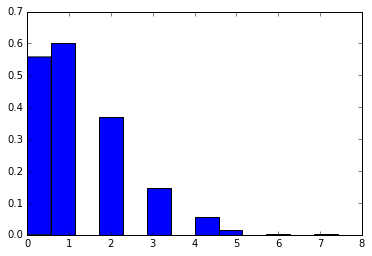

3
1
0
3
1
1
2
0
0
1
0
1
2
1
0
2
1
1
0
0
0
4
3
2
2
0
0
0
3
0
2
2
1
2
0
2
1
2
3
2
0
0
1
1
1
1
2
1
0
1
1
0
0
2
0
2
1
0
1
1
1
2
2
4
1
2
3
0
2
1
0
1
0
0
0
2
1
0
2
0
1
0
5
1
1
6
0
1
1
2
0
1
3
0
2
0
0
2
1
2
3
0
2
2
1
1
2
2
0
0
1
1
2
2
1
0
3
0
2
0
0
0
0
1
2
2
0
0
0
1
0
1
0
2
2
0
1
2
1
3
3
1
2
2
1
4
3
0
0
3
2
3
3
1
2
2
2
2
1
2
1
0
1
0
1
0
0
1
0
1
0
0
1
1
1
2
1
1
3
1
0
1
2
3
2
0
1
0
0
4
0
1
1
0
1
0
0
1
2
2
4
2
0
0
2
1
0
1
2
2
1
0
2
2
1
1
1
1
2
2
0
0
1
2
0
1
2
0
3
6
1
0
3
0
0
0
2
3
4
0
0
4
2
1
2
2
0
1
2
1
1
3
0
2
0
1
0
0
1
1
1
1
4
1
0
0
1
1
3
5
2
1
2
0
0
0
1
0
1
2
1
0
1
2
1
1
3
0
1
1
2
3
0
1
1
3
0
1
3
2
2
0
1
0
2
1
1
3
5
4
1
1
2
1
0
2
3
2
0
2
0
4
1
2
0
0
0
2
2
2
0
0
2
0
2
0
2
1
1
0
0
1
1
2
3
0
0
1
1
2
1
1
1
2
1
3
1
1
2
1
0
2
5
2
1
3
2
1
1
0
0
2
1
0
2
1
1
3
1
1
1
0
0
2
4
0
1
0
0
1
1
2
2
3
0
4
8
1
3
3
0
1
1
1
0
2
0
0
5
1
1
1
1
4
1
0
1
0
3
0
1
1
0
1
2
3
1
1
0
0
0
2
2
0
0
0
1
4
2
0
2
1
0
0
0
3
0
3
1
1
1
3
2
1
3
0
1
2
1
2
1
2
2
0
0
1
1
2
0
0
1
1
0
0
1
1
1
2
1
0
1
0
4
1
3
0
0
2
2
3
2
1
0
2
0
4
1
1
0
1


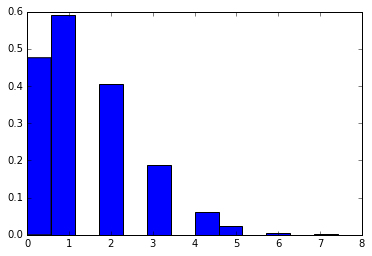

1
2
3
0
0
1
2
3
2
2
0
1
0
1
1
1
1
2
1
1
1
0
0
2
2
1
1
0
3
4
4
1
2
1
1
4
3
0
0
2
1
0
0
0
1
1
2
0
0
1
0
2
1
0
1
2
0
1
3
0
2
1
2
0
3
2
0
7
1
1
3
2
2
1
2
1
0
0
3
4
3
2
1
2
0
2
1
2
3
2
3
3
2
0
3
0
1
1
2
1
0
1
5
1
1
0
0
4
1
1
3
2
2
1
2
0
4
2
2
3
0
1
0
3
1
0
0
0
2
3
1
2
1
1
1
1
1
2
0
4
1
2
1
2
1
2
0
0
0
0
0
1
2
2
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
0
1
3
3
1
1
2
0
1
4
1
3
2
1
6
0
1
2
0
0
0
3
1
0
1
2
0
1
0
1
0
1
3
1
4
1
2
0
0
0
1
0
0
2
1
1
2
0
2
5
2
1
2
0
2
1
2
0
2
2
1
2
1
1
1
2
3
0
2
2
1
2
0
5
3
2
4
0
1
1
0
2
3
2
0
0
1
1
2
3
5
1
0
2
2
1
1
2
3
2
4
3
0
1
1
1
2
1
1
1
0
2
1
2
2
0
0
1
1
0
1
0
0
0
3
0
3
1
2
1
2
1
0
0
0
3
6
1
0
2
1
1
0
1
0
1
2
1
1
0
2
2
1
8
3
2
0
2
2
0
1
4
2
0
2
2
0
1
2
1
4
1
1
0
3
0
3
0
3
1
0
1
1
1
0
5
1
1
2
1
0
1
5
0
3
1
1
0
0
0
1
1
5
1
3
2
0
1
2
1
0
1
0
0
1
2
1
1
0
2
1
0
1
2
0
2
2
2
1
0
0
2
2
1
2
0
2
0
2
0
1
1
0
1
0
0
0
4
3
1
1
1
3
2
2
0
2
4
1
2
2
3
0
3
3
0
2
2
1
2
0
0
3
1
0
2
2
1
0
2
1
1
1
1
1
1
0
2
0
0
1
0
3
0
4
1
1
2
2
1
1
1
1
2
1
1
1
0
0
0
0
0
0
0
1
3
0
2
1
0
1
4
4
3
2
0
2
1
0
0
3


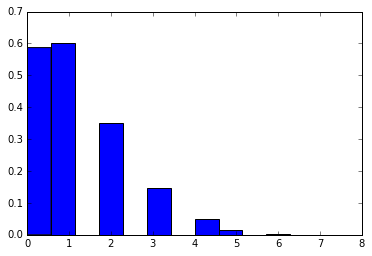

1
0
1
2
3
1
0
0
1
0
1
3
0
1
2
3
0
1
1
1
0
0
1
0
0
3
2
2
0
1
1
3
2
3
1
1
2
2
1
0
1
2
0
2
5
1
0
1
1
0
0
1
0
3
0
1
0
1
2
1
1
2
0
0
3
1
1
2
4
1
1
1
0
2
0
0
2
0
3
2
1
1
4
1
4
1
2
1
2
2
1
2
1
4
3
1
1
2
1
2
0
3
3
1
4
1
0
1
0
2
1
3
1
1
2
5
2
0
1
0
0
1
1
1
0
0
0
1
0
1
0
2
1
4
0
3
1
0
0
1
1
3
0
1
1
0
1
1
1
1
1
0
2
4
1
0
0
0
1
3
0
1
2
1
1
2
2
0
1
0
3
5
5
2
1
3
2
3
1
0
1
0
1
2
0
1
1
0
2
2
1
0
1
3
0
1
0
0
1
0
2
0
0
3
0
1
0
2
2
0
2
1
1
3
0
2
2
0
0
1
4
2
0
0
1
0
3
3
0
0
3
0
0
0
0
0
3
1
1
2
0
2
2
1
4
0
2
3
1
0
2
1
1
1
2
0
1
0
0
2
2
1
0
0
0
2
0
0
0
0
2
0
2
1
1
2
1
2
2
2
2
0
0
0
2
1
1
1
1
1
0
2
1
0
0
4
2
1
2
2
2
0
1
2
0
1
1
4
0
2
1
0
1
1
2
1
0
0
2
3
0
3
3
0
2
0
0
0
1
1
2
1
2
2
4
1
0
0
2
2
0
4
3
3
2
2
1
0
0
1
0
0
2
2
1
1
0
2
0
1
1
1
3
0
0
0
0
1
0
0
0
1
0
0
0
3
1
2
3
2
2
0
1
1
1
0
1
2
2
1
1
0
0
0
1
1
0
2
1
0
1
1
3
0
1
2
1
0
2
2
2
0
1
2
1
2
0
2
1
0
3
0
1
0
1
1
1
1
0
2
5
3
2
2
0
0
1
0
0
0
0
0
2
0
3
2
0
0
1
2
2
0
0
1
0
0
4
0
4
0
1
1
4
2
2
1
1
2
2
0
0
1
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
2
1
0
0
1
2
4
0
1
4
3


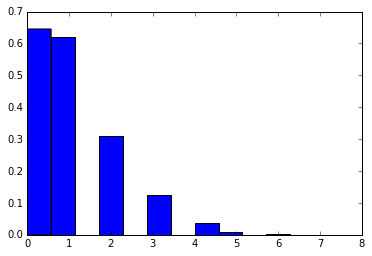

1
3
1
3
3
1
0
4
2
1
1
0
0
0
1
0
2
0
1
1
0
0
3
2
1
3
2
2
1
0
1
2
1
1
1
1
0
0
2
1
2
0
1
2
1
1
1
1
0
1
0
2
0
3
3
2
0
2
0
4
0
1
3
1
4
6
1
1
2
2
0
0
0
0
0
0
3
1
0
0
0
0
1
0
2
2
3
2
3
0
1
0
4
2
0
1
0
1
3
2
0
1
3
2
0
3
0
4
0
1
2
1
1
1
1
1
3
2
1
4
2
0
2
1
0
0
3
2
0
0
0
0
0
0
3
0
1
2
1
1
0
0
1
0
1
1
0
2
1
1
1
0
2
2
0
0
2
0
1
4
1
1
0
2
1
0
2
0
0
0
0
0
2
2
0
3
1
2
0
2
1
2
1
1
1
1
0
1
0
1
1
3
3
2
1
2
0
2
1
1
0
0
1
3
0
3
1
0
1
0
1
0
1
0
0
0
1
0
2
2
0
0
3
1
1
0
1
0
1
2
2
0
0
0
0
0
1
1
0
1
1
1
1
3
2
1
2
0
0
0
0
0
2
0
0
0
4
0
3
0
0
0
0
1
0
0
0
1
1
1
0
0
1
1
1
1
2
1
2
0
0
1
1
2
1
1
3
1
2
2
0
0
0
0
0
2
1
0
0
1
1
3
0
1
1
2
1
0
1
2
0
1
1
1
0
2
3
0
0
1
1
1
0
1
1
1
1
1
4
0
1
1
3
1
3
0
1
4
1
5
0
1
1
0
0
0
0
0
1
3
2
1
1
1
0
2
4
0
1
4
3
0
0
0
2
1
1
1
0
0
0
0
0
0
2
0
0
0
1
0
1
0
0
1
3
4
2
1
0
1
0
0
0
3
1
2
1
1
2
0
1
1
0
1
0
0
2
1
0
1
0
0
1
1
1
0
1
2
0
1
2
1
2
1
1
0
0
3
0
0
0
1
2
1
0
0
0
1
0
2
1
0
2
1
0
2
3
1
2
1
5
2
1
1
3
0
3
1
0
0
1
1
0
0
1
0
0
3
1
0
0
0
1
3
0
0
2
0
0
0
0
0
0
1
1
0
2
2
2
2
0
2
2
1
0
2
2
3
0
1


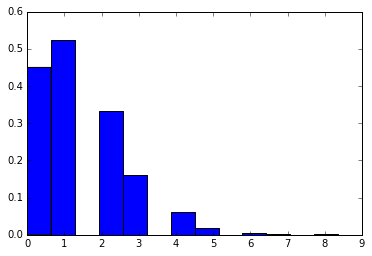

3
0
1
0
2
0
1
1
2
0
1
0
4
2
2
1
2
2
2
1
3
3
2
2
3
2
0
2
3
2
1
1
1
1
3
3
0
0
1
0
1
1
1
0
3
3
1
1
1
0
0
1
0
0
3
0
0
0
1
0
2
1
1
1
0
2
1
2
1
2
2
1
0
2
3
1
4
2
0
3
3
1
2
1
0
1
2
2
0
2
1
2
5
2
2
1
2
2
0
4
1
0
2
0
1
1
1
2
1
3
1
0
3
0
4
0
1
0
1
1
1
2
4
0
0
1
2
3
2
0
1
2
0
0
1
1
1
0
2
1
1
1
1
2
3
3
2
1
2
2
2
2
0
1
0
2
3
0
0
4
0
0
0
2
0
1
1
3
0
1
1
1
2
1
1
1
1
0
0
0
1
2
2
3
1
3
1
1
0
0
2
4
0
0
2
2
1
1
0
1
1
1
2
0
0
1
1
4
0
1
0
2
1
2
2
1
0
0
2
1
3
2
1
3
1
1
1
1
1
5
3
0
1
2
2
1
1
1
0
0
1
1
0
1
4
0
0
2
0
0
0
1
1
1
0
0
1
0
2
2
6
2
0
1
2
2
0
2
0
1
1
2
0
1
1
0
1
0
2
0
0
0
4
0
3
0
1
0
0
3
1
1
2
1
3
0
0
0
1
2
1
0
0
1
0
2
1
0
0
0
1
3
2
3
1
0
0
2
0
1
0
1
1
1
0
1
1
3
0
2
1
1
1
1
0
2
1
1
2
0
1
0
2
3
1
0
0
0
1
1
1
1
0
0
2
1
0
0
2
1
1
0
0
2
2
2
1
2
2
1
1
3
0
2
1
1
2
2
3
2
1
0
1
1
4
1
1
0
2
1
1
1
0
2
2
1
4
2
1
0
1
0
2
0
2
0
1
1
2
2
2
1
0
0
1
3
1
1
2
0
2
3
1
3
1
1
2
2
3
2
3
0
1
1
2
2
0
1
0
0
1
0
1
0
3
3
0
4
1
1
4
1
1
4
0
1
0
3
1
1
3
2
2
0
0
2
1
3
0
2
3
0
2
0
2
0
1
3
0
1
2
1
2
2
2
2
0
0
2
8
2
2
0
0
1
3
0
1
1
2


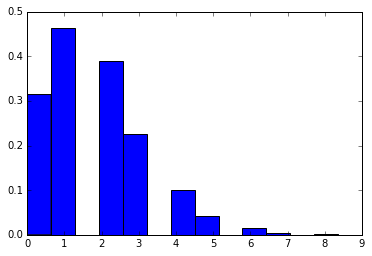

3
5
4
2
2
2
1
2
1
3
3
0
2
4
5
1
1
2
1
1
0
2
6
3
2
3
0
1
1
1
1
1
1
0
1
2
0
3
1
1
3
1
4
0
2
0
2
2
0
1
2
0
0
0
2
1
0
1
1
0
1
1
0
0
3
3
3
3
2
1
5
0
2
0
1
2
3
1
1
2
2
0
1
2
0
2
5
1
5
2
3
2
1
1
4
4
0
1
2
2
0
4
0
2
2
3
3
2
1
5
0
2
4
2
1
1
1
1
2
2
1
2
2
1
0
3
0
3
3
3
4
3
3
0
3
1
1
1
0
3
3
1
0
2
0
0
1
3
0
1
1
2
2
3
2
5
1
1
0
3
0
0
0
4
0
0
0
1
0
0
4
1
3
1
0
1
3
0
5
3
0
1
4
1
1
0
0
2
0
0
1
2
0
0
3
0
0
3
4
0
1
0
1
0
1
3
1
0
4
2
1
2
4
1
3
2
2
2
0
2
0
4
0
0
0
1
1
2
3
4
4
3
2
2
2
2
3
2
1
2
3
3
0
2
2
6
2
2
2
2
0
1
4
1
3
3
1
1
0
0
0
0
2
1
4
1
3
1
1
1
0
0
3
2
2
1
0
1
0
3
1
2
1
3
2
1
1
5
0
1
1
1
2
0
1
1
0
2
2
3
0
1
4
0
2
4
1
2
4
3
2
4
1
0
2
2
1
2
2
3
1
1
3
3
1
0
3
2
3
3
0
0
1
0
0
0
1
4
2
0
0
1
0
2
5
2
0
3
1
0
0
1
2
2
3
2
1
5
0
1
1
3
0
2
3
1
5
4
0
7
1
0
1
2
1
0
1
4
4
0
1
0
1
1
1
2
2
2
0
0
2
1
0
2
0
3
5
2
0
2
2
3
3
2
1
1
1
2
1
3
1
1
1
1
4
1
0
4
0
1
1
0
0
0
5
2
2
2
4
0
1
0
1
2
1
0
0
2
0
1
1
0
0
1
1
4
1
2
3
0
1
2
3
1
1
3
0
1
4
2
1
1
1
0
1
4
2
2
1
1
0
2
2
1
0
1
0
1
0
2
2
3
1
1
3
2
1
2
3
2
4
2
2
0
2
1
2
2
2
2


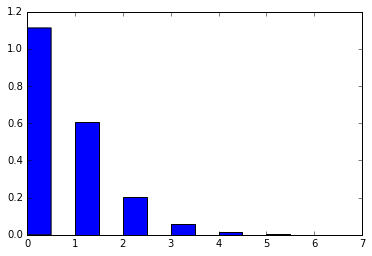

1
1
0
0
2
0
1
0
1
0
1
2
2
1
2
1
0
1
2
0
1
2
0
0
0
1
0
1
3
1
1
0
1
1
2
1
0
3
0
0
0
1
1
0
2
1
1
1
0
2
0
0
0
0
3
0
0
0
1
0
1
4
1
1
1
2
1
3
3
2
0
1
1
2
0
1
2
1
2
5
2
1
1
0
0
0
0
3
1
3
0
2
2
2
3
0
1
0
0
1
0
2
0
0
1
0
0
0
1
1
1
1
3
1
1
0
2
1
1
0
1
1
1
1
1
0
1
1
0
1
0
2
1
0
1
0
2
1
1
2
0
1
1
0
0
0
0
2
1
0
1
1
3
1
0
1
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
2
0
0
2
0
1
1
1
0
0
0
2
3
3
0
0
1
2
2
1
1
0
0
0
0
1
0
0
0
0
0
0
1
3
2
0
0
0
0
2
0
0
0
1
0
1
2
0
1
0
0
0
1
0
0
1
1
3
3
1
1
1
0
1
0
0
0
1
1
1
1
0
0
0
0
1
0
2
0
1
1
1
0
0
0
2
0
0
0
1
1
0
0
0
2
0
0
0
1
3
2
0
0
0
0
0
2
0
1
0
1
1
1
1
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
3
0
1
1
2
3
0
2
0
1
0
1
1
0
0
0
0
2
0
0
0
3
0
0
0
0
0
1
2
0
2
0
0
0
0
0
0
0
0
0
2
1
1
2
0
0
0
2
0
2
0
1
1
0
0
1
1
1
0
1
2
0
1
1
1
0
2
0
1
2
0
1
0
1
0
3
2
0
0
1
3
2
0
1
1
0
0
0
1
1
1
0
0
0
2
0
0
1
1
0
0
1
1
0
1
0
0
1
1
1
0
0
0
2
1
0
1
2
0
0
0
0
0
0
1
0
0
3
1
1
0
2
1
1
3
2
2
1
0
1
0
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
0
1
0
1
1
0
2
0
0
0
0
1
0
0


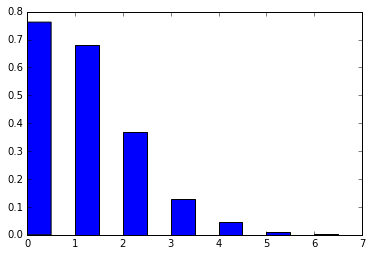

0
1
1
2
1
1
1
0
1
2
2
1
1
3
3
1
1
1
1
1
3
0
2
1
0
2
0
0
1
0
1
1
0
1
1
1
0
4
0
1
0
1
1
1
1
0
0
0
3
1
0
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
1
0
3
2
1
0
1
1
0
4
1
1
1
1
0
0
1
2
0
2
1
0
3
3
2
0
1
0
2
2
1
1
2
3
3
1
4
0
1
1
1
1
3
0
3
0
1
1
0
3
2
2
1
2
1
0
2
0
0
2
0
0
1
0
1
1
3
1
0
0
0
3
0
1
2
1
2
3
0
0
0
1
1
1
1
1
2
0
1
2
0
0
1
1
0
1
0
1
0
0
1
1
1
1
0
0
1
1
1
1
0
2
2
0
1
0
1
0
2
3
3
3
1
1
0
1
2
0
3
4
0
0
1
1
0
2
1
1
1
0
0
0
0
1
2
2
1
0
0
0
1
1
3
1
2
1
2
0
0
0
0
2
2
3
1
0
1
0
1
0
2
0
1
0
1
0
0
1
2
1
1
2
0
0
0
3
0
1
1
1
0
1
2
1
0
2
3
0
0
0
1
0
0
0
1
0
0
1
1
2
1
2
0
0
1
0
0
0
1
1
0
1
0
1
0
1
1
0
3
4
2
1
0
1
4
0
1
0
1
1
1
0
0
2
0
0
2
0
1
0
0
2
0
2
0
0
1
0
1
0
0
0
2
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
3
3
0
0
0
1
0
1
0
1
0
1
0
2
2
0
0
1
0
0
1
1
2
1
2
0
0
1
1
1
0
3
0
2
1
2
0
0
3
2
1
0
0
2
1
2
0
3
2
1
0
0
0
1
0
3
1
3
0
1
1
0
1
1
0
2
0
0
0
0
1
2
1
0
2
1
1
1
3
1
1
0
0
1
1
0
1
1
1
1
0
0
1
0
0
1
0
0
1
0
1
0
0
3
2
2
1
2
0
2
0
0
1
0
0
1
0
1
0
0
0
1
1
1
0
1
2
0
0
2
1
1
0
1
2
0
1
0
2
0
5
1
4
1
1
2
1
1
0
0
0


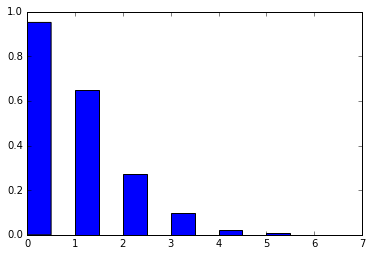

2
1
0
0
0
2
1
1
0
0
0
0
0
1
1
1
0
0
1
2
0
1
2
1
1
1
1
1
0
0
0
1
1
1
2
2
3
1
0
2
2
3
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
2
2
4
4
1
3
1
0
3
5
1
2
0
0
1
0
1
1
1
2
2
1
1
1
3
1
0
3
0
1
1
1
2
2
1
1
2
2
1
3
4
0
1
0
0
0
0
1
1
0
2
0
0
2
1
0
1
3
0
2
0
2
1
1
1
2
0
0
2
2
2
1
2
0
1
2
0
3
4
0
0
1
1
1
1
0
0
0
3
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
2
2
1
1
1
3
1
0
0
1
0
3
1
0
2
0
1
1
1
1
1
0
3
2
1
0
1
1
0
2
0
0
0
0
0
0
3
1
1
0
0
1
4
2
2
3
1
0
0
0
2
3
0
2
1
1
2
2
1
0
0
1
0
0
0
0
3
0
0
2
1
1
2
1
0
0
0
2
2
1
0
1
0
0
1
2
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
2
0
1
0
1
0
0
0
1
1
2
1
0
0
0
0
1
0
0
0
1
0
1
1
3
0
2
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
2
2
0
0
1
1
0
1
1
0
1
3
0
1
0
1
0
0
0
1
0
1
0
1
1
0
2
2
1
0
0
2
2
0
0
1
0
2
2
0
4
1
1
0
0
2
2
0
3
1
1
0
0
1
1
0
1
1
3
3
2
0
1
1
1
0
1
1
2
0
1
2
2
3
0
0
1
1
1
4
0
1
1
2
3
1
2
0
0
0
3
0
0
4
2
1
0
0
2
0
0
1
0
0
1
0
2
2
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
2
1
1
0
0
1
0
3
0
1
3
0
2
0
1
0
0
1
0
1
0
2
2
1
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
3
1
0
0
1
1
2
2
0
0
0
0
1


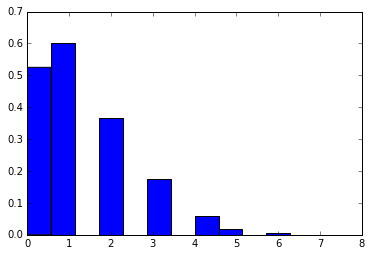

2
1
2
1
1
2
0
1
1
4
1
0
1
2
0
3
0
1
1
2
0
1
1
1
2
2
0
1
2
0
2
2
2
1
1
4
1
2
1
0
0
2
3
4
1
4
1
1
0
1
0
1
1
0
1
3
0
0
0
0
1
0
1
3
1
4
2
3
2
3
1
2
1
1
0
1
1
0
5
5
1
1
3
0
1
0
2
2
1
2
1
1
2
2
0
1
4
2
1
1
2
1
0
3
1
1
3
2
2
2
0
1
4
1
0
2
2
1
0
1
1
2
2
0
1
0
4
1
0
1
0
0
1
1
1
2
4
3
3
3
2
1
4
1
3
0
1
2
0
0
1
2
1
0
0
0
0
1
0
1
0
0
1
0
1
2
2
2
3
0
1
2
0
1
1
2
2
3
1
1
1
3
0
1
0
3
3
2
0
1
1
2
1
0
0
0
1
2
1
1
1
1
0
2
0
0
0
5
0
1
0
1
0
1
2
1
2
2
2
1
2
1
1
5
2
0
2
1
5
6
2
2
0
1
1
2
1
0
0
0
0
2
1
2
2
2
0
0
1
0
3
0
0
0
2
1
2
0
0
1
1
0
0
1
0
2
0
1
0
0
1
3
0
0
1
0
0
2
0
2
0
0
0
3
1
0
4
5
1
1
1
2
1
0
1
2
2
3
3
4
2
1
2
1
1
1
4
0
3
5
2
0
1
1
0
1
2
0
2
2
2
0
0
3
0
0
0
0
2
2
1
1
0
1
0
0
3
0
3
2
1
1
2
0
0
0
0
0
2
1
0
1
1
2
0
0
0
0
0
1
1
0
3
3
1
2
2
1
0
0
0
2
3
2
2
1
1
3
1
3
2
3
0
1
0
3
2
2
3
3
3
3
2
1
1
2
2
2
2
0
1
1
0
1
1
1
0
1
0
2
0
0
0
3
0
1
1
1
0
2
0
2
2
0
2
1
0
0
3
0
1
0
2
0
1
1
3
1
0
3
3
1
2
1
2
1
2
3
5
2
3
3
3
2
2
0
1
1
2
4
0
1
1
1
0
0
0
1
1
4
0
1
0
0
1
0
2
2
1
0
1
0
1
1
0
0
0
6
3
1
4
0
1
0
4
0
0
1
1
1


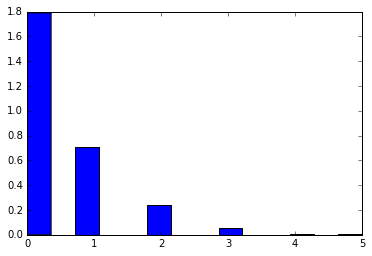

0
0
0
0
0
1
0
1
0
1
1
2
0
1
2
0
0
0
0
1
0
0
0
0
0
0
0
0
2
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
1
0
1
0
1
2
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
2
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
1
2
0
1
0
0
1
0
0
2
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
2
1
3
0
0
0
2
0
1
0
0
2
0
0
0
0
0
0
0
0
0
0
2
3
0
2
0
0
0
0
0
1
0
0
0
0
1
2
2
1
0
0
1
0
1
2
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
2
1
0
0
1
0
0
2
0
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
2
1
0
1
1
1
0
0
0
0
0
0
0
0
2
1
0
3
2
0
2
1
0
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
0
0
1
1
2
2
1
1
1
1
0
0
1
2
1
0
1
0
0
1
1
1
4
0
0
4
1
2
1
1
0
0
0
1
0
0
0
0
0
2
0
2
1
1
1
0
0
2
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
2
1
1
0
0
0
1
0
2
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
2
1
0
0
0
1
0
1
1
0
2
0
2
0
0
1
0
0
1
0
1
0
3
1
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
3


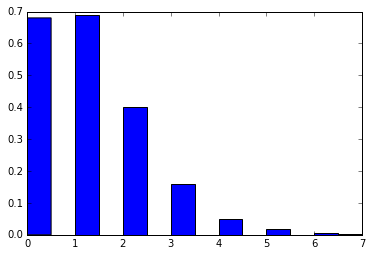

1
0
0
1
0
1
0
2
2
0
1
1
2
0
1
0
1
3
2
2
0
0
0
1
1
0
2
3
4
2
3
3
2
2
2
0
1
1
1
0
1
0
0
1
1
0
0
1
1
0
2
1
1
0
0
2
0
0
0
0
0
0
0
0
1
0
1
1
0
2
0
1
0
0
1
1
5
2
1
0
2
1
2
0
0
2
1
2
1
3
3
2
1
3
3
1
1
1
1
1
0
1
0
0
3
0
1
4
0
2
4
0
1
3
0
3
0
3
1
3
1
1
0
2
1
1
0
1
1
0
1
0
0
3
3
3
1
1
0
1
1
0
3
0
2
0
0
0
0
3
0
0
0
1
1
1
0
1
1
2
1
0
2
1
1
0
2
1
1
0
0
1
1
2
0
0
1
0
2
1
2
2
3
0
3
1
2
2
0
1
0
3
2
2
0
0
1
2
0
1
1
5
5
0
1
2
1
1
1
0
0
0
0
1
2
1
0
2
0
1
3
1
1
0
0
1
2
0
0
1
2
1
4
2
2
1
2
2
0
4
1
2
1
1
1
1
0
0
0
4
1
1
1
3
1
4
2
2
0
1
0
3
2
1
1
0
1
1
2
0
2
1
1
2
1
1
0
3
1
0
1
2
3
2
2
3
1
1
3
1
1
0
2
3
2
0
1
0
1
0
1
4
0
0
1
2
0
0
1
0
0
1
1
0
3
2
0
1
0
1
1
0
1
2
1
2
0
1
2
4
1
1
2
0
0
2
0
0
3
1
2
1
1
1
2
1
0
2
4
2
1
0
2
1
2
1
0
0
0
1
0
0
1
1
1
2
1
2
0
0
4
0
1
1
0
1
2
1
3
1
0
2
1
1
2
1
1
0
2
5
1
0
2
3
0
1
2
1
1
2
1
0
2
1
3
1
0
0
0
3
1
1
3
0
3
1
3
1
0
0
1
1
1
0
0
0
0
3
0
1
2
1
0
0
1
0
2
2
0
2
2
0
2
2
1
0
0
1
1
0
1
0
1
2
3
4
1
2
0
0
2
2
0
0
3
1
2
1
2
0
1
1
1
2
4
2
2
2
0
2
1
1
1
0
0
2
1
0
0
0
2
2
2
0
1
1
0
1
2
1


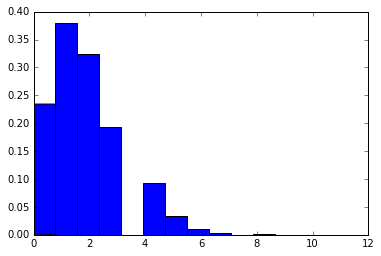

2
2
1
3
2
2
1
0
2
2
3
1
1
3
1
2
2
1
0
3
2
1
2
2
2
3
4
3
3
5
4
0
3
2
0
1
2
0
0
0
1
2
1
2
0
2
5
2
2
0
4
3
0
0
2
2
2
3
2
3
2
2
1
3
1
0
2
3
0
1
1
3
3
2
3
4
4
4
1
2
2
3
1
1
5
0
4
3
2
3
2
1
3
2
3
2
1
2
1
3
0
2
2
1
1
3
2
2
3
3
0
2
1
4
1
1
2
1
2
1
4
3
0
3
1
0
1
2
4
0
2
3
0
0
0
0
1
0
0
0
1
2
3
1
4
2
0
2
1
3
4
3
5
3
3
3
0
2
1
1
1
2
2
1
0
2
0
2
1
3
0
2
2
1
2
2
4
3
3
4
3
2
3
2
3
2
1
4
5
2
2
1
0
5
0
1
2
0
0
5
2
3
3
2
4
0
2
2
4
1
2
3
2
1
2
1
3
3
1
3
2
1
0
1
1
1
2
2
1
0
0
4
0
3
1
2
2
1
3
1
3
3
1
1
2
4
3
1
1
1
1
1
0
0
2
1
1
2
0
1
2
2
0
0
1
3
2
0
6
1
0
1
3
2
3
2
5
3
1
3
1
2
4
1
2
2
0
4
3
5
2
2
4
3
3
4
2
3
4
4
4
2
2
2
1
0
2
2
0
2
2
2
2
3
1
4
0
1
2
1
1
4
1
3
1
2
0
0
3
4
1
1
4
1
1
2
4
1
1
1
0
3
1
5
4
4
1
0
2
1
2
2
4
3
3
5
1
2
0
2
1
4
2
1
1
1
3
3
2
0
1
4
3
0
2
1
4
4
1
1
0
7
1
0
1
3
1
2
3
5
0
5
2
3
1
1
1
0
7
3
2
3
4
2
1
3
1
2
1
1
1
4
1
2
2
2
4
2
1
1
1
1
2
2
3
2
2
0
3
4
0
3
0
2
3
0
5
3
1
2
2
1
0
4
0
2
1
0
2
0
1
1
1
3
1
4
5
3
2
6
6
2
0
2
1
1
1
2
4
2
1
2
2
1
4
1
1
4
2
2
0
2
1
1
1
3
6
4
4
2
3
2
3
1
1
0
4
2
4
2


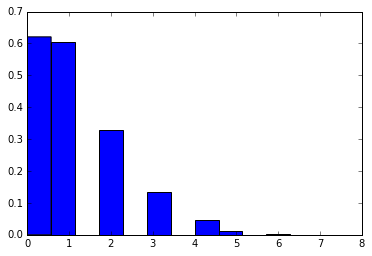

1
2
0
0
0
0
0
0
2
2
0
4
1
0
2
2
1
1
0
0
0
0
1
2
2
1
1
2
1
0
0
2
4
2
2
2
0
3
0
0
0
0
0
1
0
0
0
3
2
0
1
0
0
0
0
1
2
1
0
0
1
2
2
0
2
1
2
2
2
2
2
1
0
1
0
1
0
2
3
0
4
3
1
1
2
2
2
1
1
2
1
3
0
2
1
4
2
1
1
0
1
0
1
0
3
2
1
1
2
0
2
1
3
2
1
1
1
0
1
2
1
2
0
1
0
2
1
0
0
2
1
1
0
1
1
2
0
0
1
0
0
0
0
2
1
0
0
0
1
1
2
0
0
0
1
0
2
0
1
2
0
0
3
0
0
0
2
2
0
0
3
3
0
2
0
2
1
1
0
3
3
1
2
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
3
1
1
1
4
0
0
0
1
2
3
3
0
0
4
0
1
1
0
0
0
0
0
0
3
0
0
1
2
0
1
1
1
0
1
1
0
1
2
2
1
0
2
0
1
0
0
0
3
0
0
1
0
1
0
0
1
3
2
5
2
0
3
1
2
0
2
1
0
1
0
1
2
0
1
1
1
0
0
0
2
1
1
2
0
2
0
0
1
0
0
2
1
0
3
0
1
1
2
3
1
2
1
2
2
2
2
1
0
1
0
2
1
0
1
0
2
2
0
0
0
1
1
0
0
0
2
1
3
1
1
1
1
1
1
2
1
0
2
3
2
0
0
0
1
2
0
2
1
1
2
2
2
0
3
0
0
0
1
0
1
1
1
1
1
0
2
0
0
0
0
3
1
3
1
0
1
3
1
1
0
1
0
1
2
1
4
1
0
2
2
0
0
1
0
0
0
0
1
0
0
0
3
1
0
1
1
0
0
1
0
2
1
1
0
0
0
1
0
0
2
1
1
1
4
0
1
0
2
0
0
0
1
4
0
1
1
2
2
2
1
2
3
0
1
1
1
2
0
0
1
0
2
0
0
1
0
0
0
1
0
2
3
2
3
0
0
1
3
3
0
3
1
1
1
1
0
2
1
1
1
1
1
0
1
0
0
2
0
1
3
4
2
0
0
1
0
0
0
0
3
2


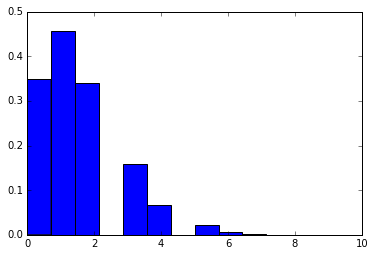

1
2
0
1
1
1
1
0
0
1
0
1
0
2
1
1
1
2
1
0
2
2
1
1
4
0
0
1
0
0
5
0
3
3
0
1
1
2
0
4
1
1
2
0
0
0
1
1
1
1
0
0
2
0
1
1
4
4
0
0
0
1
3
1
2
3
6
2
1
1
1
1
0
2
1
4
2
1
0
1
2
1
0
0
3
6
3
5
1
1
1
3
1
2
1
2
0
0
3
1
0
1
1
0
1
3
2
1
2
3
1
2
1
1
1
0
0
2
2
0
0
1
0
0
2
0
3
3
3
1
1
2
0
1
2
1
3
3
1
0
1
1
2
1
2
0
1
0
1
1
1
1
0
1
1
2
1
1
1
4
1
1
0
0
1
2
3
6
2
1
1
2
0
1
2
3
0
1
0
1
0
1
1
0
1
2
0
0
1
1
2
1
0
1
1
3
1
2
2
0
2
2
2
1
2
2
2
0
2
1
0
0
3
2
1
0
0
0
1
0
1
0
0
1
2
2
2
1
1
2
1
0
2
0
1
0
4
0
2
2
0
1
3
1
0
1
0
1
1
1
2
2
0
2
3
0
1
2
1
0
1
0
1
1
1
1
0
1
0
1
3
1
0
1
0
0
0
1
2
5
3
5
2
1
1
1
1
0
2
3
2
3
1
3
4
1
1
0
3
1
2
1
4
2
1
1
1
2
2
6
4
4
0
0
0
3
3
6
1
1
3
5
5
3
5
1
2
3
4
3
2
2
0
1
2
0
0
1
1
0
3
0
3
1
0
0
3
1
1
2
0
3
3
2
0
0
2
0
0
1
1
4
0
1
5
4
2
1
7
1
0
0
2
2
2
1
0
1
1
2
0
1
4
1
2
0
2
0
1
0
3
1
2
2
2
1
2
0
1
2
1
1
5
2
1
0
2
2
1
2
1
1
0
3
0
1
2
2
1
1
5
4
1
2
2
1
2
2
1
0
2
1
0
1
2
1
0
0
2
1
1
0
0
0
1
2
0
1
2
2
1
0
1
1
1
1
0
3
3
0
1
1
1
2
2
2
2
2
1
2
8
1
1
6
0
1
2
2
2
2
1
1
2
0
5
2
1
0
2
0
4
3
2
3
0
1
0
2
1
0


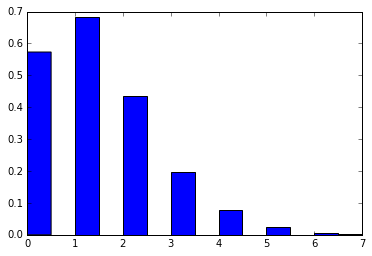

1
1
1
0
0
1
3
1
1
1
3
1
1
2
1
1
1
0
0
1
0
3
3
1
1
1
1
2
6
2
1
3
0
3
3
1
1
1
1
2
0
1
0
0
2
1
0
0
1
2
0
1
0
1
0
1
3
3
1
1
1
0
2
1
0
2
0
0
1
0
2
3
1
5
1
2
0
0
2
1
2
0
1
3
2
1
1
2
3
1
1
1
0
2
2
0
1
1
1
0
0
1
0
1
1
0
2
0
2
0
0
0
2
2
3
0
1
0
2
3
4
0
2
3
0
0
0
1
3
2
0
0
1
0
1
0
2
0
1
1
2
0
0
0
0
1
0
0
0
1
2
3
0
2
6
1
0
1
1
1
4
1
1
0
2
1
3
3
1
2
0
1
4
1
1
1
0
2
0
0
1
1
4
2
2
0
0
3
3
1
2
0
1
2
0
1
1
1
2
2
1
0
2
2
1
2
3
2
4
0
1
1
1
1
1
1
0
0
1
0
0
0
0
1
1
1
2
1
2
0
2
0
1
4
1
1
1
2
1
0
0
0
3
2
1
1
0
2
1
3
1
4
0
1
0
2
0
4
1
0
2
0
0
4
0
0
1
0
1
1
0
0
2
3
2
0
2
0
3
3
2
1
2
1
2
1
3
0
0
1
1
0
3
1
3
1
2
2
0
1
1
1
2
0
1
2
0
3
1
0
1
1
1
0
0
0
1
1
3
1
1
1
2
4
2
1
0
1
1
3
1
1
2
0
2
1
1
0
3
1
3
1
1
0
2
2
2
3
1
4
2
0
0
2
3
1
0
3
1
1
0
1
2
0
0
2
4
2
1
0
1
1
0
3
4
0
3
0
2
3
5
2
1
0
2
0
1
1
1
2
0
2
0
1
0
0
2
1
0
1
1
1
0
2
1
0
1
2
1
1
1
3
3
2
0
1
2
2
1
1
0
1
1
2
0
2
0
2
2
0
2
0
0
0
1
2
2
2
1
2
2
0
0
0
2
0
1
2
1
0
1
0
0
2
1
2
4
3
0
3
2
1
0
2
2
1
0
3
0
2
2
2
0
4
1
4
4
5
0
0
4
3
5
1
1
1
0
3
1
3
0
3
2
2
1
1
3
0
0
0


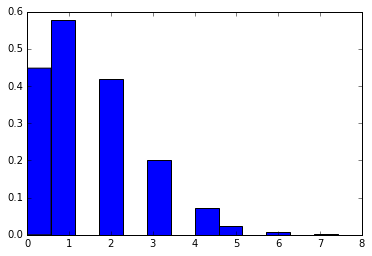

0
0
2
2
1
2
0
0
1
1
1
1
1
3
1
1
1
1
2
0
2
0
2
2
1
1
0
0
4
1
3
0
1
6
1
0
2
1
0
1
0
0
0
0
2
2
0
1
0
2
0
2
3
2
1
0
1
6
2
1
1
1
1
1
3
0
3
1
1
3
0
2
0
0
2
2
1
0
0
0
2
3
2
4
1
2
3
2
3
2
1
2
3
4
2
2
3
0
1
0
0
2
1
0
5
1
0
2
4
1
3
0
3
0
1
2
1
0
0
3
1
3
2
1
1
1
0
0
1
0
1
3
0
1
1
1
2
2
1
1
2
1
1
2
1
0
2
1
2
2
1
1
0
3
2
1
0
1
0
1
3
3
1
0
0
0
1
3
2
1
1
3
1
1
1
3
5
3
1
1
0
2
0
0
1
2
2
3
1
1
1
1
0
1
0
1
1
1
1
2
3
2
1
1
1
2
0
0
2
1
1
0
2
0
1
1
1
4
1
4
1
1
1
2
0
2
0
0
2
0
0
2
1
2
2
1
4
0
2
0
1
2
0
0
2
3
2
1
1
0
1
0
1
0
0
1
1
2
0
1
1
1
0
3
1
3
1
0
0
0
2
1
0
1
0
0
2
4
0
3
0
3
4
0
0
1
0
0
0
1
1
1
2
2
4
1
2
2
0
2
1
1
0
1
1
2
0
3
4
3
0
0
0
1
2
0
1
3
1
1
2
0
0
3
0
2
1
1
1
3
1
0
3
2
2
2
2
2
2
0
2
0
1
2
0
1
0
1
0
0
2
3
3
1
2
2
1
3
1
0
2
2
0
0
0
2
1
3
3
2
0
3
1
0
1
1
0
0
2
3
1
0
2
1
1
3
1
1
0
3
2
3
3
2
1
0
2
3
1
1
0
2
1
0
2
2
1
1
1
0
1
4
0
1
3
1
2
4
2
2
1
1
3
2
1
0
1
1
1
2
0
2
0
2
1
0
3
1
1
5
1
2
0
0
0
2
0
0
0
1
1
1
1
0
3
2
0
2
3
3
2
1
2
1
2
2
0
2
2
1
2
0
1
4
3
3
1
0
1
0
0
3
1
1
3
0
1
1
0
0
1
1
4
0
0
1
1
2
1
0


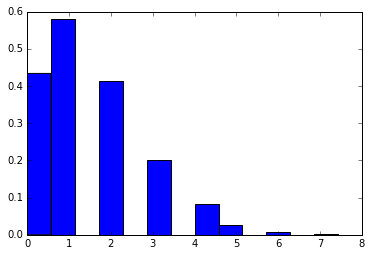

1
1
2
3
0
1
0
3
0
0
3
1
0
0
0
2
1
4
1
1
1
3
0
1
4
0
0
2
1
3
2
3
1
2
0
0
1
0
0
2
1
0
0
0
0
1
0
2
1
1
1
1
0
0
0
0
3
2
1
0
0
0
3
1
1
1
2
3
1
2
0
3
3
1
0
2
3
0
1
0
0
4
3
2
3
1
0
1
3
1
1
1
1
0
1
1
1
0
2
6
2
2
2
2
1
1
0
2
0
3
5
1
2
1
0
2
1
0
2
3
3
1
1
0
0
1
3
0
0
0
1
3
1
4
0
0
3
1
1
0
1
1
4
2
1
2
0
5
1
2
0
0
0
3
0
0
2
2
3
1
0
2
2
1
2
1
0
0
2
3
0
1
3
1
3
1
1
1
0
3
0
0
2
1
0
1
0
2
1
1
1
1
1
0
0
0
1
1
1
2
2
1
3
3
1
0
2
0
1
0
0
1
2
1
2
0
3
1
0
2
0
2
1
0
1
1
1
1
2
3
0
2
0
2
2
1
2
1
3
1
1
0
1
1
2
3
0
2
0
0
0
2
0
0
2
0
0
0
2
2
0
2
1
1
4
3
2
4
1
4
4
2
2
0
1
3
1
3
5
3
2
1
0
0
2
3
1
4
0
6
0
2
1
2
1
1
2
1
0
1
1
4
0
2
0
0
0
4
0
0
2
2
1
1
0
2
2
2
0
1
1
1
3
1
0
1
0
4
0
3
2
1
0
0
1
0
0
5
2
2
3
2
2
3
2
3
3
1
0
1
0
3
1
0
2
2
1
3
4
4
2
1
1
1
1
1
4
2
3
2
1
3
0
1
3
1
1
3
0
0
1
1
0
3
2
2
0
0
4
2
3
2
1
3
0
1
5
4
2
1
4
1
0
2
1
1
2
0
2
0
1
0
4
1
1
0
2
0
0
2
0
0
1
1
4
2
1
3
0
1
0
1
2
0
1
1
2
4
0
2
2
2
0
2
0
3
3
1
0
1
1
0
1
0
1
1
0
3
2
3
4
1
0
1
2
1
2
2
4
1
1
0
1
1
6
2
2
0
0
1
0
1
0
2
3
2
1
1
1
2
2
4
1
3
1
2
2
1
0
2


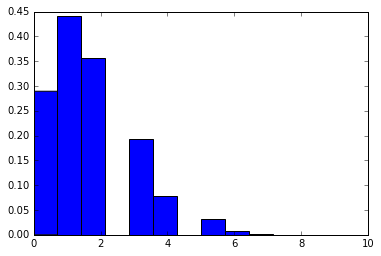

1
1
1
1
0
1
3
4
1
2
0
0
2
0
5
1
0
1
3
2
1
2
1
1
1
2
1
3
2
2
1
5
3
3
4
1
1
1
4
1
0
1
0
0
1
0
1
1
2
4
1
2
0
3
0
0
2
4
1
2
2
0
0
1
0
2
0
1
3
4
5
3
2
3
1
3
2
3
0
1
1
3
1
5
1
1
0
1
4
1
0
1
1
0
3
2
1
1
0
1
1
2
1
1
0
3
0
2
1
1
2
4
4
0
0
4
3
1
1
2
0
2
0
1
1
4
0
0
1
2
1
1
1
2
3
2
0
0
1
0
1
1
1
2
3
0
0
1
1
0
1
0
2
2
0
0
1
0
4
0
3
5
0
2
0
0
1
2
0
0
3
0
1
1
0
0
0
2
4
1
2
2
0
3
3
1
0
1
1
1
1
1
0
1
1
1
3
3
2
2
4
2
3
3
1
1
2
2
2
1
2
1
1
1
0
1
1
3
2
1
2
2
2
1
2
1
0
1
3
2
2
2
1
1
1
3
1
1
0
0
2
2
0
4
3
2
5
1
2
1
1
0
1
2
3
0
1
0
2
1
1
2
3
1
3
1
3
1
1
0
1
2
1
1
1
2
2
2
0
1
1
1
0
2
2
1
0
2
2
3
1
2
2
5
4
0
0
0
3
2
4
1
3
1
0
3
1
0
1
1
0
0
3
0
0
1
1
3
2
2
0
5
0
1
2
1
2
2
0
1
2
3
1
2
3
1
1
1
5
1
0
0
3
4
1
1
3
3
1
3
2
5
5
1
2
2
0
2
4
4
0
2
4
2
4
1
1
3
2
2
5
4
1
2
3
1
2
2
0
1
0
0
2
0
2
2
2
4
1
2
3
2
6
2
0
1
2
0
0
1
0
2
2
1
2
3
1
3
2
1
3
1
1
1
2
3
3
1
0
2
4
4
1
0
0
3
3
0
1
1
1
1
3
0
1
1
2
3
2
2
1
3
0
5
0
1
1
4
1
5
0
0
2
2
2
3
2
2
3
2
0
1
2
4
3
2
3
3
2
1
2
1
2
2
0
0
0
3
0
1
3
1
2
2
0
1
0
1
2
0
0
3
0
2
0
2
3
2
1
0


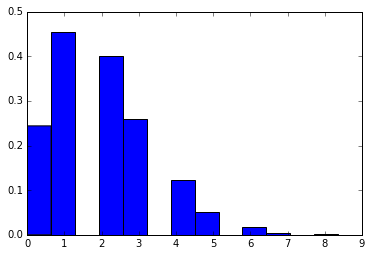

1
0
1
3
3
1
4
6
1
6
2
4
1
2
1
3
2
1
0
1
1
0
2
0
1
2
5
1
0
1
3
1
1
2
2
0
2
1
1
2
1
2
0
2
1
1
0
1
0
2
3
2
3
2
2
1
1
1
4
2
1
3
3
0
3
0
2
1
1
2
0
1
2
1
5
2
2
1
1
2
5
1
1
0
3
2
1
0
3
4
3
1
1
1
1
1
1
1
2
1
4
2
0
3
1
5
3
3
1
3
2
3
0
4
1
2
1
3
1
0
3
2
1
1
0
3
2
2
1
3
4
2
0
1
2
0
2
2
3
3
3
1
2
4
1
1
0
0
1
2
2
1
3
1
2
0
0
2
2
3
2
3
4
2
3
0
2
2
3
2
0
3
4
2
1
2
3
0
5
1
3
2
0
2
2
1
3
4
2
4
2
1
0
2
1
0
0
0
5
3
6
1
5
4
2
5
3
3
2
2
3
1
3
1
4
3
1
0
1
2
1
0
1
0
1
1
3
1
1
2
5
2
1
1
3
0
2
0
1
4
0
3
1
2
1
1
1
2
2
1
2
1
1
3
2
1
1
1
2
0
2
2
3
1
0
2
1
1
2
0
1
3
1
2
3
4
5
2
2
3
0
4
4
5
1
6
3
2
1
1
6
2
4
2
3
0
0
5
0
2
0
0
2
3
1
1
4
0
5
2
4
1
2
4
2
2
2
1
0
0
2
2
1
1
1
2
0
0
2
4
3
6
4
5
1
0
0
6
5
2
1
3
1
2
0
0
1
3
1
3
1
4
2
2
1
1
4
3
3
1
1
4
1
0
1
3
2
4
2
1
1
3
4
2
2
1
2
0
2
3
2
1
1
1
2
5
3
3
2
1
1
0
4
4
3
2
3
2
1
2
1
2
1
0
2
2
4
2
2
1
1
1
1
1
1
2
1
0
1
2
3
2
0
3
0
2
1
3
2
1
2
3
1
1
7
2
4
1
4
0
3
2
0
2
3
3
1
2
1
2
0
0
2
0
1
2
1
0
1
1
2
1
3
2
5
2
2
4
5
2
1
3
2
2
4
2
4
2
1
1
0
1
1
1
1
4
5
3
0
2
5
2
1
1
1
0
1
1
1
2


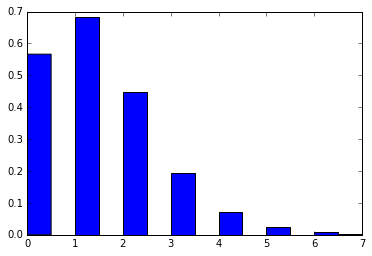

0
1
0
2
2
2
2
1
1
1
0
3
1
0
2
0
1
0
0
1
0
0
0
0
2
2
0
1
1
2
3
2
2
0
1
1
2
1
1
1
2
0
2
0
2
0
0
0
1
1
0
2
1
1
2
1
1
5
0
3
1
2
4
0
2
2
1
1
1
1
1
2
3
2
2
2
2
1
1
1
2
0
1
2
2
1
2
1
2
3
0
0
0
1
0
2
2
1
2
0
0
2
0
1
2
0
1
1
0
1
1
1
3
1
0
2
2
0
0
3
0
1
2
0
0
1
2
0
1
2
3
4
1
1
1
0
2
1
0
0
1
2
1
0
1
0
1
1
1
1
1
0
2
1
3
2
0
2
2
3
0
3
3
2
1
2
1
0
2
1
2
1
1
0
0
2
2
2
2
1
1
1
0
1
0
1
0
0
1
2
1
2
0
2
3
0
2
2
0
1
0
1
2
0
2
1
0
1
2
0
0
1
0
0
0
0
0
1
3
1
0
1
0
1
0
0
1
0
1
0
4
1
0
1
1
0
1
0
3
3
0
3
0
1
2
1
1
1
4
1
0
2
1
0
2
1
1
0
0
0
0
2
2
0
0
4
1
3
3
1
1
0
3
3
1
2
0
2
1
2
1
2
3
3
0
1
0
1
4
2
0
3
1
3
4
5
1
2
1
0
0
1
1
3
2
0
2
3
2
2
2
0
0
0
1
2
4
0
1
4
2
2
0
1
0
1
2
1
0
6
2
0
3
2
2
2
0
2
5
1
2
3
4
1
1
2
1
1
0
1
2
2
1
2
0
2
0
0
1
1
0
1
0
4
1
1
2
7
3
3
4
3
0
2
0
1
1
1
1
2
2
0
4
1
1
2
1
0
5
2
3
2
1
1
1
0
0
2
0
2
0
1
0
1
0
1
3
0
0
0
1
1
2
1
1
0
1
0
2
1
0
1
2
0
0
1
1
4
2
0
3
1
0
3
3
2
2
3
0
0
5
0
1
0
1
0
0
2
1
1
1
0
1
1
3
0
1
1
0
0
2
0
2
1
2
3
2
0
0
0
1
3
4
2
2
3
1
0
2
1
1
2
0
0
2
1
1
2
0
1
3
1
0
0
1
2
0
2
0
0


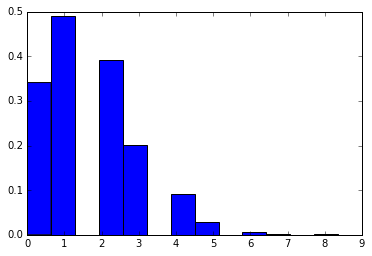

4
1
2
1
3
0
1
0
0
1
0
0
1
1
3
2
2
2
1
0
1
1
1
2
2
1
3
1
1
0
1
3
0
1
3
1
4
0
0
1
0
0
0
2
2
1
2
1
1
1
0
3
1
0
0
0
1
1
1
2
0
2
0
2
1
1
0
1
2
3
2
3
3
1
0
1
3
1
2
1
0
1
1
4
0
1
0
2
1
2
2
0
3
0
2
3
1
1
3
1
1
1
3
1
3
3
0
1
1
4
1
0
1
1
0
1
1
2
0
0
1
1
0
3
2
2
2
2
2
2
2
2
0
2
1
0
3
0
3
2
0
1
0
0
2
3
0
3
3
4
1
2
0
2
0
4
0
5
2
1
1
1
1
3
1
0
0
2
1
1
2
0
2
1
3
2
0
0
2
3
0
0
1
1
2
2
2
2
0
2
2
0
1
1
1
1
1
2
2
1
1
1
0
0
3
2
0
3
2
2
1
0
0
5
2
3
1
2
1
2
2
2
0
0
3
2
1
1
1
4
0
1
4
1
1
6
1
0
2
2
2
0
0
0
0
1
0
3
2
3
0
2
0
0
2
1
1
0
4
4
2
2
0
2
1
2
2
3
1
0
1
1
4
0
0
1
0
2
4
4
3
2
2
1
2
0
2
4
3
1
3
4
0
1
2
2
4
2
2
2
2
4
2
5
3
0
1
3
3
4
0
1
6
1
0
0
1
1
1
2
2
4
1
1
2
3
0
3
0
0
3
1
3
4
3
1
1
3
0
2
0
0
2
4
3
1
3
1
2
1
1
3
1
2
0
1
3
2
0
0
1
3
3
1
0
1
2
4
1
2
4
2
2
2
3
1
4
1
0
1
2
4
1
4
0
1
2
2
3
3
2
3
4
2
2
3
2
0
2
0
1
0
1
1
0
2
0
2
0
1
2
2
2
0
2
3
1
2
4
0
1
1
2
2
0
3
7
1
3
6
1
4
1
6
0
0
1
2
1
1
1
1
1
0
1
2
0
0
1
0
1
2
1
1
0
1
2
0
2
3
2
3
3
3
1
0
3
4
1
2
2
3
0
2
1
0
1
1
1
2
2
5
0
0
2
3
0
1
1
1
1
1
2
4
1
1
1
2
2
1


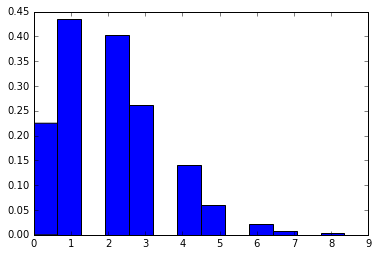

1
2
1
2
1
3
3
1
3
4
2
0
3
0
2
2
0
1
1
1
6
2
3
7
5
0
2
5
3
1
2
0
1
2
0
4
0
0
2
1
2
2
0
2
0
0
1
1
1
2
1
2
2
1
1
4
1
4
3
3
2
2
1
2
3
1
3
3
0
0
1
3
3
3
2
5
5
2
0
3
2
3
0
4
0
2
2
2
5
6
2
1
1
2
4
3
1
1
0
1
3
3
1
4
1
0
3
2
0
3
1
0
2
1
4
0
2
5
0
2
3
4
2
5
1
4
4
1
3
4
3
3
1
1
1
2
1
3
0
1
2
3
3
1
1
2
1
2
2
2
4
2
4
0
1
0
4
1
4
0
1
0
2
1
1
0
2
3
4
0
4
4
4
0
4
3
1
3
4
3
0
1
3
1
4
1
1
0
0
1
6
1
3
2
4
2
4
4
4
1
2
2
1
2
1
2
0
2
3
2
1
1
3
0
4
0
1
1
1
2
1
0
0
1
1
0
1
2
3
1
3
1
2
2
0
1
4
2
4
1
3
5
0
3
2
4
2
1
0
3
1
1
1
1
1
0
0
2
1
2
1
3
0
1
1
1
2
1
2
2
2
1
1
4
3
1
3
3
3
1
2
6
2
1
1
4
2
6
5
3
5
2
2
2
4
3
6
2
2
3
2
2
2
0
1
3
6
2
0
0
0
1
2
2
2
2
0
1
0
3
2
1
2
4
4
3
0
1
2
1
2
2
1
4
6
2
2
4
2
3
1
2
2
2
3
2
2
4
6
2
0
5
4
1
2
3
2
2
1
0
3
6
0
3
4
6
4
2
4
2
2
3
1
3
1
3
4
0
1
2
1
1
5
2
1
2
5
5
3
3
0
3
4
1
3
3
2
0
3
0
3
4
1
0
2
3
1
1
3
0
5
2
5
0
2
2
1
1
1
1
3
3
2
0
2
1
0
5
1
2
2
0
2
2
1
0
1
4
3
2
1
1
4
2
3
2
1
2
3
1
0
1
1
1
3
5
1
2
4
2
1
2
5
4
1
2
1
6
1
1
1
0
2
2
2
1
2
3
3
3
3
3
3
3
2
3
3
1
1
0
5
0
0
2
2
5
2
3
4
1


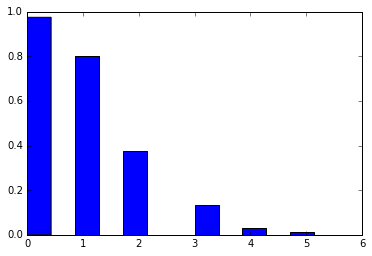

0
1
0
1
2
2
1
0
0
1
1
0
1
0
1
1
1
0
1
0
1
0
1
2
0
0
5
2
1
2
3
2
1
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
0
1
2
1
1
2
0
2
2
0
3
1
2
2
0
0
4
1
2
0
3
3
1
1
2
0
5
4
2
0
2
2
2
1
0
0
0
3
1
3
0
0
1
0
0
1
2
1
1
1
0
1
1
1
0
0
1
0
1
2
0
0
2
0
1
1
1
0
0
0
0
1
2
1
1
0
1
0
0
2
0
0
1
1
0
0
0
1
1
0
1
0
1
0
2
2
1
1
0
2
0
1
0
1
2
1
0
3
0
0
1
2
3
1
2
1
0
0
0
0
0
4
1
1
0
0
1
0
0
0
1
1
3
0
2
3
0
2
1
1
0
1
1
1
1
1
2
0
3
3
1
2
0
1
1
0
1
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
2
1
1
1
0
2
0
0
1
0
0
3
1
2
2
1
1
1
1
1
0
0
0
0
0
2
0
0
0
1
0
0
1
1
2
0
0
0
3
2
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
3
2
2
0
0
0
2
1
1
1
3
2
0
4
3
0
1
0
0
1
0
0
0
0
2
1
2
1
0
1
3
1
0
0
1
1
0
2
1
0
1
2
0
0
0
1
0
1
0
2
2
1
2
2
1
0
1
1
0
0
1
0
0
2
0
1
2
1
0
0
2
2
1
1
0
2
2
1
0
0
0
0
1
0
2
0
1
1
0
2
1
0
1
0
0
4
2
3
1
1
1
1
2
1
1
1
0
3
1
0
2
0
0
0
0
2
0
0
1
2
0
1
1
0
1
0
2
1
0
0
3
0
2
3
0
2
1
1
0
0
0
2
3
1
0
1
1
1
3
0
0
0
1
2
1
2
1
1
2
1
2
1
2
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
3
2
1
2
0
2
1
1
2
3
0
4
0
0
0
3
2
0
1
2
0
1
1
1
0
1
0
2
1
1
3
1
1
1
0
0
0
1
0
2
1
1
0
0
0
1


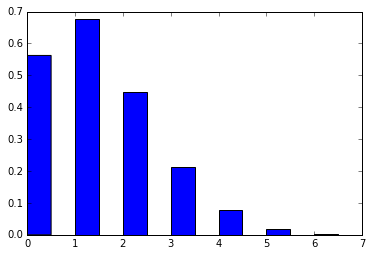

2
1
0
1
1
1
1
1
0
2
0
0
0
2
0
0
2
2
2
1
2
2
3
1
0
0
3
3
2
0
5
2
2
1
0
0
2
0
1
0
3
1
0
0
0
0
0
0
2
0
0
1
0
0
1
2
1
1
1
1
0
2
0
0
2
3
4
3
4
1
3
2
2
0
0
3
2
1
1
1
1
1
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
1
2
1
4
1
1
1
2
1
3
1
0
1
1
2
1
1
2
4
2
1
1
1
0
2
1
1
2
6
2
2
1
3
0
0
1
1
1
1
0
1
1
2
0
1
1
1
2
0
3
1
1
1
0
0
0
1
1
1
0
1
3
0
2
0
3
3
1
1
1
2
1
0
0
1
2
1
3
4
1
2
0
1
2
0
0
1
0
1
2
1
1
1
1
2
0
0
0
1
0
0
2
0
0
1
0
1
0
0
0
0
1
0
1
2
1
1
0
1
0
0
0
0
0
1
1
1
0
5
1
3
2
2
2
3
1
1
4
1
1
1
2
2
1
1
1
2
0
0
1
1
2
1
3
2
0
0
0
0
1
1
2
0
2
2
2
0
2
1
3
2
1
1
0
1
0
0
2
3
3
0
1
0
2
1
2
2
4
1
0
1
0
0
1
3
0
0
2
0
1
1
1
1
2
0
2
3
1
1
0
2
2
0
2
2
4
0
1
1
3
2
1
0
1
0
2
3
0
0
2
0
3
2
4
3
0
1
2
0
0
4
0
1
2
1
2
0
0
1
1
3
2
2
2
2
3
3
1
0
1
2
0
0
1
2
0
1
1
0
1
1
0
1
2
0
1
6
2
2
2
3
1
2
0
0
2
1
1
1
1
0
2
3
0
2
3
0
3
2
2
0
0
0
1
0
1
1
3
1
0
0
2
0
1
1
1
0
3
0
3
1
4
1
2
1
1
3
2
1
3
2
1
0
4
0
1
1
1
1
2
1
3
2
2
0
0
0
1
0
1
0
1
2
0
0
1
0
0
3
1
0
0
0
2
3
0
1
1
0
1
3
2
2
0
2
2
0
3
0
0
0
1
2
1
1
4
2
1
1
1
0
0
0
1
2
1
2
2
0
2
3
1
5


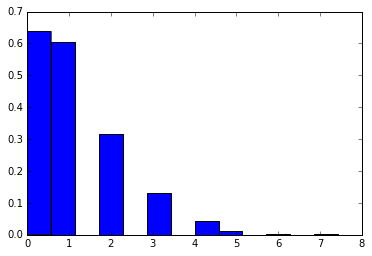

1
0
0
2
0
0
2
2
2
1
0
0
1
0
1
0
2
1
2
1
0
0
1
0
0
0
0
1
1
2
1
6
1
1
1
0
0
1
1
0
0
2
0
1
2
0
1
2
1
0
0
1
1
0
1
1
1
2
1
0
1
1
2
1
3
5
2
0
2
3
2
2
4
1
1
1
0
0
1
2
1
4
1
2
1
1
0
0
2
2
3
2
2
2
1
0
0
2
1
1
1
1
1
1
0
1
1
2
2
2
0
1
2
2
1
1
1
1
1
2
1
3
1
5
1
0
1
2
1
1
0
2
3
3
1
1
1
1
0
2
0
0
0
1
0
1
1
0
0
0
3
1
0
1
0
2
2
3
0
2
2
0
3
0
0
0
0
1
0
0
1
0
1
3
1
2
3
1
3
0
1
0
1
3
3
2
1
1
0
3
1
2
1
3
3
3
0
1
1
2
1
1
0
3
0
2
0
4
0
0
2
2
0
0
0
0
1
1
0
1
2
2
0
0
1
0
1
1
1
1
0
0
0
1
1
2
3
2
1
4
1
1
0
2
1
0
2
1
0
0
0
2
1
2
1
0
2
3
1
1
0
0
0
1
0
0
1
2
1
1
1
0
1
0
1
1
0
1
1
1
2
1
1
1
0
0
1
2
2
1
0
1
2
1
0
2
0
1
2
3
1
1
1
1
3
1
2
3
1
0
0
0
1
1
0
0
0
0
3
1
1
2
1
2
0
3
0
4
0
1
1
1
1
2
2
5
2
0
3
1
0
2
0
0
1
0
0
1
2
1
0
0
1
2
1
2
1
1
1
1
0
2
2
2
0
2
4
2
3
0
1
0
1
1
0
2
2
0
1
1
0
5
3
2
4
2
0
1
1
1
1
1
2
0
0
0
1
0
0
1
2
3
1
2
1
3
0
2
4
3
2
1
2
1
3
1
1
1
1
3
0
0
0
0
1
0
2
5
2
0
1
0
0
1
1
0
0
4
3
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
3
0
1
0
1
2
1
0
0
2
2
0
2
2
2
2
0
3
0
0
1
1
2
2
0
0
2
0
1
0
2
2
0
1
1
0
0
2
1
0
1
1
0
3
0
0


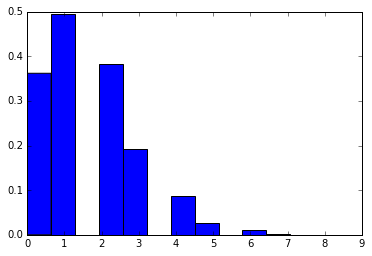

0
1
0
0
1
0
2
2
2
3
3
2
0
2
4
2
2
0
1
0
2
0
2
0
2
2
5
3
2
0
2
1
1
3
1
2
1
0
1
2
1
1
3
0
2
2
1
1
0
1
3
3
2
0
4
2
2
3
4
1
0
2
2
3
3
5
1
2
2
1
1
2
5
0
3
1
2
2
2
3
0
2
1
0
4
4
0
0
0
1
1
1
1
1
1
1
2
3
0
2
1
1
0
2
0
2
3
3
2
0
3
1
0
2
0
2
1
2
0
0
0
0
3
1
1
2
1
1
1
1
1
1
0
0
3
4
1
3
1
2
3
0
0
2
1
4
0
1
2
3
2
6
2
2
1
0
2
0
2
1
2
3
1
4
4
1
1
2
4
0
2
1
2
4
3
1
1
3
3
1
3
1
3
1
1
0
0
1
2
0
1
3
0
1
0
1
0
2
0
1
3
0
0
0
1
1
0
1
1
3
0
1
0
1
2
2
5
0
2
1
0
0
2
0
0
1
0
2
2
1
2
3
2
2
2
0
2
1
2
2
2
1
0
1
0
0
4
1
1
2
4
0
0
2
1
0
4
1
1
1
4
1
0
0
0
1
0
2
1
0
2
1
0
2
0
1
4
0
2
1
0
1
3
6
3
1
2
2
1
1
5
2
1
0
2
0
1
4
0
3
1
2
2
2
1
0
0
1
1
2
1
1
2
0
1
0
4
5
1
0
0
0
0
0
4
2
1
1
3
5
4
2
2
3
2
1
1
0
1
2
2
3
0
2
1
0
0
3
2
3
2
2
1
2
2
1
1
0
0
1
2
4
3
2
2
1
2
1
3
0
1
2
0
1
4
3
0
3
1
3
3
2
7
0
3
3
2
2
0
2
4
4
2
3
3
1
0
0
1
1
0
1
1
4
2
2
1
2
1
2
1
0
0
3
0
2
2
2
1
2
1
2
3
0
0
2
1
1
0
1
2
2
1
1
0
0
0
3
0
0
2
0
0
2
1
0
1
1
0
0
1
1
1
0
3
3
2
5
4
2
2
1
1
1
0
2
1
2
1
2
2
2
2
2
3
2
2
0
0
2
1
1
1
2
0
2
1
1
2
0
1
1
3
2
0
1
2
0
2
4


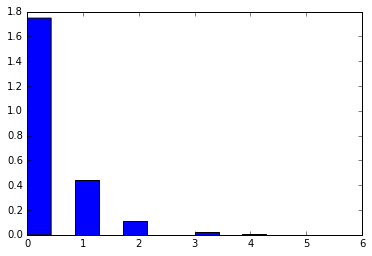

5
2
0
0
2
2
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
1
0
0
0
0
2
0
0
0
1
0
0
1
1
1
1
1
0
1
0
0
0
0
0
0
2
2
1
0
0
0
1
2
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
3
0
0
1
0
0
2
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
2
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
0
0
0
1
3
2
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
2
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
1
1
1
1
0
2
3
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
3
2
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
3
0
0
2
1
0
0
2
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
2
1
1
2
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
2
2
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
2
1
1
0
0
1
1
1
1
1
2
0
0
0
2
2
1
0
1
0
0
0
3
0
2


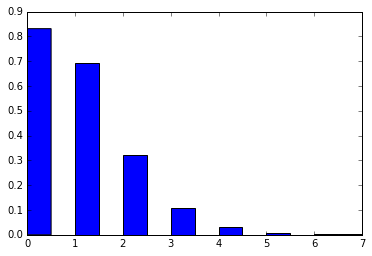

0
0
3
1
0
2
2
3
1
0
1
1
0
0
0
0
0
0
1
0
0
2
1
0
1
1
1
1
3
0
2
0
0
3
0
0
0
1
2
1
0
1
1
0
1
3
0
0
1
1
4
1
1
0
1
1
1
1
1
0
0
2
2
1
1
0
1
0
0
0
1
1
2
3
1
1
0
0
2
2
0
2
2
0
0
1
2
0
0
0
1
1
1
3
1
1
1
1
1
0
1
0
0
1
0
0
0
2
1
1
0
2
0
0
0
4
2
1
2
0
2
3
1
2
0
1
0
0
1
1
2
3
0
0
0
0
0
0
1
1
0
1
0
0
1
0
0
1
0
2
1
0
1
4
0
0
1
0
1
1
3
1
2
0
1
0
0
0
0
0
0
0
2
1
0
1
0
0
1
1
0
0
0
1
0
1
1
0
0
3
0
2
3
1
2
2
0
1
1
0
0
1
0
0
0
1
1
1
1
0
0
2
0
0
2
2
1
1
0
3
1
0
1
0
0
1
1
0
2
4
3
1
1
0
1
1
1
0
2
3
2
3
2
2
1
0
1
0
1
1
0
3
1
1
7
3
1
0
1
0
3
0
1
1
0
0
0
0
2
1
0
2
0
0
0
2
2
0
2
3
0
3
1
0
1
4
3
2
4
2
2
2
0
1
1
2
1
1
0
1
1
0
0
1
1
1
0
1
0
1
2
1
1
0
1
0
1
0
1
1
0
1
2
1
0
2
0
2
4
2
0
3
1
0
1
0
0
3
2
1
1
1
0
3
1
2
1
3
3
0
0
2
0
0
0
0
2
2
3
0
0
0
0
2
0
1
1
0
2
0
0
2
0
0
0
1
1
1
2
1
3
1
3
1
1
4
0
0
1
2
1
1
1
1
1
3
1
1
2
0
0
1
0
1
1
0
0
0
0
3
0
0
0
1
3
1
2
1
0
1
0
0
0
1
0
0
2
0
1
1
1
0
0
1
0
1
0
0
0
1
0
1
2
2
4
6
0
0
0
2
2
1
0
3
0
1
2
0
0
0
1
0
0
2
0
2
1
2
1
0
0
1
0
1
1
1
1
0
0
0
0
1
2
0
2
4
2
2
1
1
3
1
1
0
0
1
0
3
0
1


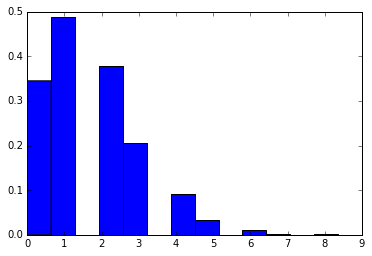

2
5
0
2
2
0
0
3
1
4
2
0
3
1
2
1
1
2
0
3
2
2
1
2
3
0
1
3
1
2
3
2
0
3
2
1
0
3
0
3
0
2
4
3
2
3
2
1
1
2
2
1
1
1
2
1
0
1
3
3
4
2
3
1
4
5
0
3
1
3
5
1
0
0
1
3
2
2
2
1
1
1
1
3
0
0
0
2
3
0
0
1
1
1
0
1
5
3
2
0
2
3
2
2
0
2
3
1
0
4
3
1
1
3
0
0
0
0
1
0
3
2
2
0
0
2
3
3
2
0
2
0
3
1
0
0
1
0
0
5
0
3
4
1
1
1
0
0
4
2
3
1
1
1
3
1
0
1
1
1
2
2
0
0
1
1
4
2
3
3
3
2
1
0
2
3
1
1
0
1
2
2
3
1
1
2
4
5
5
1
4
3
2
1
2
2
2
0
0
2
0
3
2
3
1
4
3
0
3
0
3
0
5
3
1
1
1
1
2
2
0
2
1
0
2
2
2
0
1
4
4
1
0
4
2
2
2
2
2
1
4
2
6
2
2
2
2
0
3
2
3
0
1
2
4
1
1
1
1
2
1
1
2
4
1
1
4
1
7
6
1
2
3
2
1
1
2
2
1
0
2
1
0
0
4
3
4
3
2
7
1
3
5
2
1
1
1
1
0
0
0
0
0
2
2
1
0
1
0
2
1
2
3
3
0
0
0
1
0
0
1
0
5
2
0
2
4
1
2
5
1
4
1
2
2
0
1
5
3
1
0
3
2
1
6
0
1
0
1
2
1
1
1
0
3
3
4
4
3
3
3
2
1
2
0
1
1
0
1
1
1
1
0
0
3
2
6
4
3
3
4
2
4
2
2
3
2
1
0
3
0
0
1
1
2
1
2
1
1
0
6
3
0
4
1
3
0
2
1
0
2
1
1
1
1
1
2
0
0
0
4
2
4
1
3
0
1
0
5
1
1
1
2
2
2
2
3
2
1
4
3
0
1
2
3
1
1
2
0
4
3
0
1
3
2
0
1
1
2
0
5
4
2
1
0
1
2
2
2
0
1
2
1
1
3
2
2
1
0
0
2
2
2
6
6
1
5
3
1
5
2
1
1
1
0
1
1
1
2
5


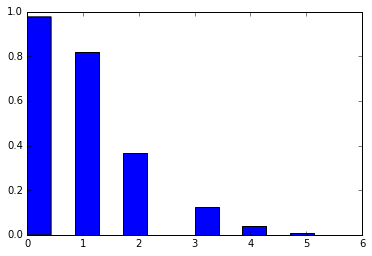

1
1
1
2
5
1
2
3
2
2
1
1
0
0
0
2
0
1
1
2
1
1
1
1
1
1
0
1
0
0
1
1
2
1
0
0
1
2
0
0
2
2
0
0
1
0
1
3
0
1
0
1
2
0
0
0
0
0
0
1
2
0
2
2
1
1
1
0
0
0
0
2
1
0
0
1
0
2
4
1
1
2
2
1
1
2
1
2
1
0
1
1
2
2
1
0
0
0
1
0
0
1
0
1
0
0
1
1
2
1
2
1
0
2
1
1
0
0
2
1
2
1
0
2
3
2
1
0
3
1
2
1
3
0
1
0
1
2
0
2
0
1
0
0
0
0
4
0
1
1
5
0
0
0
1
0
0
0
0
0
0
0
0
0
0
2
2
2
3
1
0
1
2
1
1
2
0
3
0
0
1
2
0
1
0
0
0
2
0
0
0
2
0
1
1
0
1
1
1
0
0
0
1
1
1
2
0
3
0
3
1
1
4
3
1
1
2
0
1
0
2
0
0
0
1
1
0
0
1
1
2
0
0
1
3
0
0
1
1
1
1
0
1
2
0
1
0
1
0
0
0
1
2
1
1
2
5
0
2
0
1
1
4
1
1
0
1
0
0
0
0
2
0
0
3
0
0
0
0
0
0
0
1
5
1
1
1
0
0
2
1
1
1
0
1
2
3
0
0
0
0
0
0
1
0
2
0
1
1
1
0
0
1
0
3
3
0
1
0
0
0
0
1
0
1
0
4
1
1
1
1
1
1
1
4
2
2
1
0
1
1
0
0
0
1
2
1
0
1
0
0
1
0
0
1
2
3
0
1
1
1
0
0
1
0
3
0
1
1
0
2
1
1
1
1
1
0
0
1
3
0
1
1
0
0
3
1
1
2
1
0
0
0
0
0
0
0
3
1
0
0
0
0
0
0
1
2
0
0
1
0
0
0
3
1
0
1
0
2
0
2
1
1
1
0
2
1
0
1
1
0
0
4
0
2
2
1
2
0
1
2
0
0
1
0
0
2
0
0
0
0
0
0
0
1
0
4
0
0
1
1
2
2
0
1
3
1
2
3
1
1
2
2
0
1
0
1
0
3
1
0
0
1
2
0
2
1
1
1
3
1
2
0
3
0
3
1
0
2
0


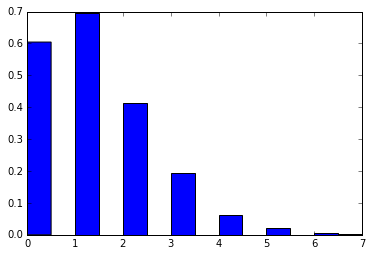

3
2
2
1
2
0
2
0
1
0
1
2
0
3
1
2
1
3
2
2
3
1
1
0
1
2
2
1
1
0
5
1
0
0
0
2
3
2
1
4
1
2
5
2
1
1
3
3
0
0
1
1
3
1
0
0
1
1
1
2
3
1
3
3
2
1
0
1
0
1
1
0
0
0
2
2
1
0
2
0
1
0
1
1
2
3
1
2
2
1
0
0
1
0
0
2
5
0
0
3
1
1
0
0
0
0
0
1
0
0
0
2
1
2
3
1
1
0
1
0
0
4
1
1
1
2
1
0
2
1
0
1
0
0
2
1
0
0
0
1
2
0
2
2
2
1
0
2
2
4
1
1
0
0
0
0
0
1
2
0
1
0
3
0
3
0
5
0
0
4
2
1
4
1
0
1
0
0
1
2
1
2
1
1
1
0
1
3
2
0
1
2
1
1
0
2
1
0
1
1
1
1
2
1
0
1
1
1
2
0
1
1
0
1
1
2
3
2
2
0
1
2
1
0
2
2
1
3
3
1
1
0
2
1
2
2
2
0
1
1
2
0
0
1
1
0
1
1
0
1
3
4
4
3
1
5
0
1
0
1
1
0
3
0
0
2
3
1
0
0
3
2
0
2
1
2
2
3
2
1
1
0
1
0
2
1
2
2
3
1
1
1
3
3
2
2
0
0
1
2
0
0
0
3
1
5
1
1
3
3
2
0
4
1
1
3
0
4
1
0
2
3
5
1
0
1
1
0
2
1
2
3
1
3
1
0
1
1
1
1
0
4
2
1
2
1
2
3
1
0
0
2
1
1
2
1
3
0
0
1
2
1
1
2
2
3
3
1
1
2
1
0
0
0
0
0
0
1
2
1
0
3
1
2
1
0
0
3
2
4
2
2
0
0
1
1
1
0
3
1
3
0
2
1
1
1
2
1
3
4
2
2
1
3
3
1
1
1
2
5
2
1
0
1
0
2
2
0
2
0
0
0
1
3
1
1
3
1
2
0
0
1
1
2
2
1
2
1
4
1
1
2
1
0
1
2
1
0
1
0
2
4
0
2
1
3
1
2
1
3
0
1
3
0
2
0
1
3
1
2
0
2
3
2
1
2
2
1
0
0
0
2
4
3
1
1
2
2
2
1


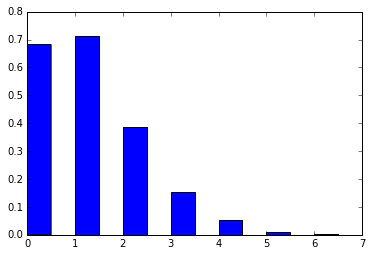

1
4
6
3
2
2
4
3
1
4
1
1
0
1
0
1
0
1
0
0
0
3
0
2
3
1
0
1
2
2
1
0
0
1
1
1
1
2
0
3
1
0
3
3
2
1
2
3
2
3
0
0
0
0
2
0
1
0
1
1
3
1
1
3
0
1
3
3
1
1
2
1
0
0
0
0
1
0
1
1
1
0
0
3
0
1
3
1
1
0
3
2
1
0
0
0
1
0
0
0
2
0
1
0
2
1
0
1
0
1
0
2
2
1
0
2
3
1
0
0
0
1
1
0
2
0
2
1
2
1
1
0
0
3
0
0
0
2
2
0
0
1
2
0
0
1
0
1
1
0
1
1
1
2
2
0
1
0
0
1
1
0
2
0
3
0
1
0
1
2
0
0
3
2
0
1
0
0
1
0
0
1
0
1
0
2
0
1
1
3
1
0
4
0
0
0
2
1
4
2
0
3
0
0
2
1
1
1
4
1
0
1
0
0
0
1
1
1
0
2
3
2
2
0
0
0
0
3
0
2
0
4
1
2
3
1
0
4
2
1
2
2
1
1
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
1
3
4
4
2
1
4
1
0
2
0
1
3
0
2
3
1
0
1
0
1
3
0
3
2
1
2
6
1
2
0
1
2
1
0
1
3
0
1
2
1
1
1
2
0
0
0
0
0
4
1
2
2
2
0
1
1
1
5
0
2
2
0
0
1
1
1
2
3
3
3
0
2
1
2
2
1
0
0
0
0
3
1
2
3
0
0
1
2
0
0
0
2
0
0
0
0
1
3
2
1
3
1
3
1
3
0
1
1
0
1
1
0
0
2
1
1
0
1
1
1
2
2
1
2
3
3
1
1
1
0
0
0
1
1
2
0
0
1
3
1
3
1
0
0
0
0
1
0
0
3
0
1
0
1
2
0
0
0
0
1
1
1
0
3
1
0
0
1
3
0
0
2
0
2
5
2
1
1
1
2
1
1
0
0
3
1
0
0
4
0
2
0
0
2
2
2
0
1
3
1
2
2
0
3
1
0
2
2
2
1
0
1
1
1
1
6
2
0
2
0
0
1
1
1
2
3
1
3
1
3
4
3
2
1
1
1
2
1
3
1


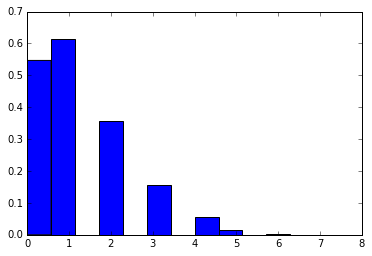

0
2
2
1
3
1
1
2
1
4
2
2
1
1
1
1
0
2
1
2
1
0
1
0
2
2
2
2
2
3
0
1
3
0
1
0
0
2
1
1
2
0
3
2
2
2
3
3
2
0
4
1
1
0
0
0
2
1
2
1
4
3
3
1
2
2
0
1
0
0
0
0
2
3
2
4
0
4
4
1
3
1
2
0
0
1
1
1
1
0
0
3
1
2
2
1
0
3
2
0
2
2
1
3
0
0
1
0
1
1
2
2
2
1
4
0
0
0
0
0
1
0
1
0
0
0
3
1
0
1
0
0
1
0
1
1
0
0
3
2
1
5
2
1
4
2
1
0
6
2
1
1
3
4
1
2
2
1
2
2
1
2
1
1
1
0
1
0
2
2
3
2
0
3
2
1
5
2
3
0
1
1
0
1
2
3
2
3
2
3
1
1
1
4
2
0
1
2
1
0
2
2
0
1
2
0
0
1
1
4
0
1
1
0
1
3
1
1
1
0
1
0
0
1
1
1
1
1
2
2
1
0
1
2
0
1
3
1
0
1
0
0
0
0
2
0
1
0
2
2
0
2
0
1
0
2
0
0
0
1
1
4
4
3
0
2
1
2
1
1
1
0
0
1
3
0
0
2
1
3
5
1
1
1
0
1
5
1
2
3
1
3
2
1
0
3
0
0
1
0
0
0
2
2
1
2
0
2
0
2
2
1
4
1
0
1
2
5
0
2
4
0
1
0
0
1
0
2
3
1
2
2
5
1
1
3
1
1
1
2
0
3
0
0
2
2
0
0
1
0
2
1
2
4
1
1
3
2
0
0
2
2
0
2
1
0
1
0
0
1
1
1
1
0
1
1
1
1
4
3
2
0
1
0
1
0
1
2
4
1
1
0
3
1
1
2
0
3
0
0
0
4
0
0
0
3
0
0
0
1
0
1
1
3
0
1
2
2
3
1
2
0
1
0
0
0
0
0
0
2
2
0
1
3
1
3
2
3
2
2
1
2
1
0
1
2
1
3
0
0
2
1
1
0
0
0
2
2
1
2
5
1
1
6
1
1
4
2
0
2
3
1
3
1
2
1
3
2
0
0
2
2
0
0
1
3
1
6
1
2
2
1
0
0
2
1
2
1
0
2


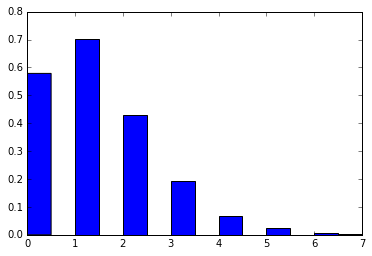

3
5
0
4
1
1
1
1
2
2
2
4
3
0
1
1
1
1
0
1
1
1
2
1
0
1
2
1
2
0
3
3
1
0
0
1
0
0
0
2
2
1
4
3
4
2
1
1
2
1
2
0
0
3
2
2
3
1
0
1
1
0
1
3
1
0
1
1
4
0
0
0
0
2
0
1
1
1
0
3
0
1
1
1
0
1
0
3
1
0
2
0
1
0
0
0
3
2
1
2
1
1
1
0
0
2
2
1
0
0
1
2
0
1
2
0
0
2
2
0
1
1
2
1
1
2
3
2
1
2
1
0
1
1
2
1
1
0
2
0
1
5
1
1
2
0
2
0
2
1
1
0
1
0
0
0
2
2
2
0
2
2
1
0
1
2
0
1
1
1
2
2
1
2
0
4
3
1
0
2
0
1
1
0
0
1
3
1
1
3
2
0
1
2
0
1
0
0
0
1
0
2
1
1
4
2
1
0
1
3
3
0
0
0
1
2
3
1
1
0
0
2
0
2
2
1
3
1
1
2
0
2
1
2
2
2
2
1
4
1
0
2
0
3
0
1
1
1
2
2
1
3
2
1
1
2
0
1
1
2
0
1
1
0
1
2
1
3
0
6
5
3
1
0
3
2
2
0
2
1
0
0
0
2
4
3
1
6
1
1
0
2
2
1
2
0
0
2
1
2
0
0
0
0
3
0
2
1
2
6
0
0
2
1
1
2
0
1
1
1
0
0
2
1
1
1
1
3
2
0
2
0
3
3
2
1
0
2
2
0
0
1
3
0
2
4
2
0
0
1
0
1
1
0
2
3
4
0
3
3
5
0
1
1
2
2
0
2
0
2
0
3
2
0
1
3
0
2
0
3
0
1
1
0
0
1
0
1
2
4
1
1
1
1
1
2
3
1
0
1
1
2
0
1
0
0
1
2
0
0
0
0
1
0
2
1
1
1
0
1
0
1
0
1
2
2
2
1
1
0
0
2
1
1
2
1
1
1
1
2
2
0
0
2
2
2
2
2
5
4
1
2
1
1
1
0
5
1
1
4
0
1
1
2
1
0
2
1
0
1
0
0
3
0
4
1
0
1
4
2
2
1
0
4
3
0
0
0
2
3
1
1
1
2
1
2
2
3
2
1


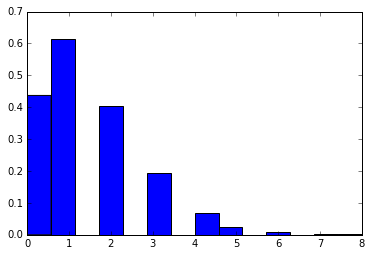

1
4
2
2
2
0
0
2
1
1
2
5
0
0
0
1
1
0
1
0
2
2
1
0
2
1
3
3
2
3
0
0
1
0
1
0
1
2
1
1
1
2
2
2
0
3
1
0
1
1
1
2
1
2
2
1
4
1
3
1
0
2
2
0
3
3
2
0
2
0
2
2
2
1
1
0
1
0
3
2
1
3
1
2
1
1
1
3
3
1
1
1
1
3
1
1
1
1
0
1
2
1
1
2
1
0
0
2
3
2
2
1
0
0
1
0
3
3
1
2
1
1
2
1
2
2
1
1
1
2
4
1
0
1
0
0
1
2
1
1
3
0
0
2
0
3
2
1
3
2
0
0
2
1
1
2
0
2
1
2
3
1
3
1
0
5
2
0
0
2
0
1
0
1
0
1
0
2
1
2
3
0
1
2
0
4
0
2
1
2
1
3
3
1
2
1
2
2
0
1
2
0
1
2
4
0
1
2
0
1
1
1
1
3
3
1
2
2
1
2
1
4
0
1
2
1
1
3
0
1
1
3
3
2
2
0
1
4
1
3
0
5
2
0
2
1
0
1
0
1
2
2
1
1
2
1
2
1
1
0
1
1
1
2
2
1
0
2
2
3
1
0
1
0
2
0
1
3
1
1
0
3
1
2
1
2
0
2
3
1
0
6
3
1
2
0
0
1
0
3
3
0
3
7
2
3
1
1
0
0
4
2
1
1
1
0
2
2
0
3
2
2
3
1
1
1
2
2
3
4
5
4
3
2
2
3
0
1
1
1
1
2
0
3
1
1
1
2
0
3
0
1
1
1
1
2
1
1
3
2
3
0
1
0
3
3
2
1
1
1
0
2
1
1
0
2
0
1
3
1
0
2
2
3
1
0
1
2
2
0
2
1
6
2
0
0
0
2
3
2
2
3
2
1
1
0
0
0
1
0
2
1
1
0
1
1
5
3
2
2
3
0
1
0
1
0
1
3
1
1
0
1
0
3
3
2
1
5
2
1
1
3
1
3
0
1
1
1
1
2
3
1
0
0
0
0
0
2
0
1
3
2
1
1
2
1
1
4
3
1
1
0
4
1
1
2
0
0
0
0
1
0
3
0
1
5
1
0
1
3
1
1
1
2
4
1
3
1
1
1


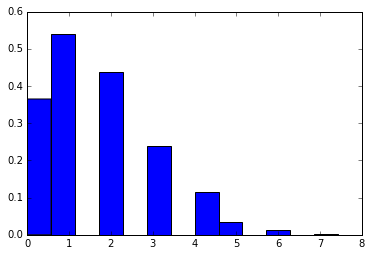

2
4
4
1
3
0
1
3
3
1
3
1
4
0
3
1
2
1
2
1
0
0
0
2
1
0
2
0
0
1
0
0
3
1
0
0
0
1
1
1
2
7
4
1
1
3
0
1
0
3
6
6
3
2
2
1
1
2
2
0
1
0
1
2
3
1
1
1
2
3
0
0
1
2
1
1
1
0
1
0
4
3
1
4
0
2
3
1
2
1
0
4
0
0
0
0
0
2
1
1
2
4
1
5
1
3
2
2
1
5
3
1
0
3
2
4
1
1
0
2
5
4
0
3
1
4
4
1
0
2
3
2
2
0
2
1
1
2
1
1
3
1
1
4
1
1
2
4
5
3
1
1
4
1
2
2
2
1
1
1
4
1
0
1
1
2
1
3
2
3
0
0
1
1
2
0
1
2
1
0
1
0
0
2
1
1
4
3
1
0
4
4
2
1
0
3
2
1
2
2
1
1
4
1
2
4
2
1
1
4
0
2
0
3
4
5
1
3
2
2
2
3
4
3
2
0
4
4
5
3
3
1
1
4
4
2
2
1
1
2
0
1
0
1
0
0
1
3
4
0
1
2
2
4
2
1
0
3
1
1
1
4
1
2
0
2
1
2
1
1
1
0
5
1
3
2
3
0
1
1
1
1
2
2
3
4
2
2
1
2
2
2
4
1
1
4
1
4
1
1
2
3
3
2
1
1
2
2
1
5
3
2
0
3
2
1
0
0
0
0
2
3
2
1
1
3
2
2
4
5
1
3
1
1
2
1
2
6
1
0
2
2
1
2
3
3
2
2
1
1
1
2
1
0
5
2
1
1
1
2
1
1
1
3
2
1
3
2
1
1
0
0
4
1
1
3
0
0
0
2
1
3
1
0
4
1
1
1
2
3
2
0
6
2
1
0
1
0
1
2
0
1
0
1
1
1
1
2
3
4
1
1
1
0
3
1
4
2
0
1
0
3
0
1
1
2
1
1
1
1
0
2
1
4
3
1
0
3
1
2
1
0
1
4
2
3
0
1
2
1
2
0
1
1
3
1
1
1
2
0
1
2
1
3
1
0
0
1
0
1
1
4
1
2
2
1
1
3
6
0
0
3
2
0
2
2
1
4
2
2
0
1
2
3
1
3
1
4
1
3


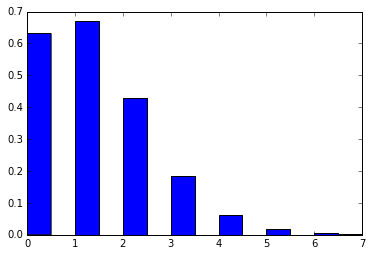

1
0
1
2
1
1
0
1
3
2
0
2
3
3
2
0
1
0
2
0
0
0
1
2
0
2
0
0
1
0
0
0
1
0
0
1
1
0
0
1
0
1
2
1
2
1
4
3
0
2
1
0
2
2
1
1
1
1
2
1
1
0
1
0
2
1
0
1
0
1
2
0
0
1
0
0
2
0
5
1
1
2
1
2
2
0
1
1
0
1
2
0
2
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
3
2
2
1
1
0
3
0
0
0
1
2
0
0
1
2
0
0
0
1
3
3
0
1
1
1
0
0
0
0
2
1
0
1
1
0
0
0
1
2
3
3
2
3
1
0
2
1
2
1
2
2
2
2
0
0
2
0
5
0
0
1
1
2
1
2
1
3
2
1
0
0
0
2
0
0
1
0
3
1
2
0
3
2
1
1
1
1
1
1
3
1
2
1
2
2
2
0
0
1
0
1
1
3
1
2
6
3
5
2
3
1
1
2
2
0
1
0
3
6
5
1
3
0
0
2
5
0
3
0
0
1
1
0
0
0
3
3
1
2
1
3
0
1
0
1
1
1
1
2
2
1
2
5
2
0
1
1
1
3
1
4
1
0
3
3
2
1
1
2
0
2
0
1
2
1
3
0
1
3
0
3
1
0
2
2
2
2
1
1
2
1
2
0
0
2
0
0
3
3
2
4
3
2
0
0
2
3
1
2
1
2
0
0
2
4
2
0
4
2
0
1
0
2
1
0
3
2
1
2
0
2
0
2
2
0
1
1
0
1
3
0
3
3
1
1
1
1
0
1
2
0
2
0
1
0
1
0
0
1
1
1
0
2
0
0
0
0
2
0
1
3
4
1
0
0
0
2
2
1
3
1
0
0
2
0
0
2
0
1
0
1
1
0
1
1
2
2
1
0
2
2
1
2
2
3
2
2
3
0
0
1
3
1
0
1
3
1
2
1
1
3
1
1
1
1
1
1
0
1
3
0
2
1
0
0
2
0
1
1
0
1
1
0
1
1
1
2
1
0
2
1
0
3
2
2
2
2
4
2
3
0
0
0
1
0
2
2
2
1
0
0
1
2
3
3
1
0
0
1
1
0
2
1
1
2
3
4
2
3
5
3


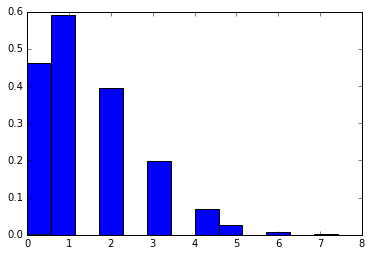

0
2
4
0
2
0
1
0
0
1
1
1
1
3
4
2
1
0
1
2
0
4
2
4
0
2
2
1
3
4
1
1
1
0
2
3
0
0
0
0
1
1
0
1
0
0
0
0
0
0
2
5
0
2
3
2
1
0
3
1
3
0
1
1
0
0
0
0
1
1
1
0
1
3
0
1
1
0
1
0
0
2
2
3
0
3
1
0
1
1
2
1
2
2
0
3
0
2
1
0
1
2
2
2
2
1
0
2
2
2
2
0
0
2
1
2
0
1
2
1
2
2
1
3
2
3
0
0
2
4
1
2
0
2
0
1
0
0
7
1
0
1
0
2
0
0
0
3
0
1
1
2
1
1
0
1
0
1
0
1
0
3
1
1
2
6
1
3
0
0
0
0
2
1
2
1
2
0
1
1
1
1
1
1
2
1
5
1
1
2
1
1
3
1
1
1
1
1
1
1
1
0
1
0
2
1
2
1
1
0
0
1
2
1
4
1
2
3
2
2
3
0
1
2
2
0
2
2
3
3
4
3
1
1
1
1
4
0
0
1
3
2
1
1
3
0
1
1
2
0
1
2
0
1
3
2
3
0
1
1
3
1
0
1
4
2
2
1
1
1
2
1
0
1
2
2
0
2
0
0
0
4
5
0
2
3
2
4
3
4
2
1
1
3
1
1
1
2
0
4
2
3
3
1
1
4
2
2
6
0
0
1
2
0
0
0
0
1
1
2
1
0
0
1
0
1
0
1
2
2
4
1
4
3
1
2
1
1
1
2
3
1
3
2
3
0
2
0
0
2
3
3
3
0
1
0
0
0
1
2
5
0
2
1
0
2
2
0
2
1
0
0
1
0
1
4
0
2
2
0
0
3
3
3
0
1
3
3
2
1
0
1
1
2
3
1
2
2
4
2
3
5
3
1
0
2
0
0
0
1
1
2
1
2
1
1
0
3
2
0
1
2
1
0
0
0
2
1
1
1
3
2
0
6
3
2
2
0
0
1
3
2
0
0
2
2
1
4
3
1
7
3
1
4
1
2
1
1
0
0
0
0
0
4
2
0
3
1
1
0
0
1
1
2
2
0
0
1
0
0
1
1
1
2
3
2
3
0
3
1
2
3
1
0
4
0
1
1
8
2


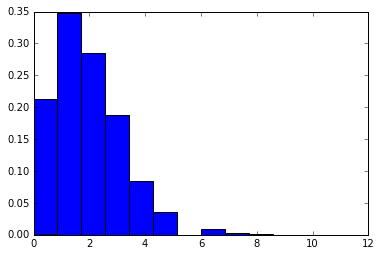

4
2
2
2
1
3
0
1
4
1
3
1
4
3
1
1
0
4
3
3
2
3
3
4
5
1
1
4
4
1
2
2
0
1
2
0
1
1
3
0
0
0
2
3
2
4
5
1
1
0
2
4
0
2
0
3
3
0
1
2
2
0
2
3
2
3
3
1
3
1
2
2
0
1
1
2
2
0
0
4
1
0
0
2
1
1
1
0
2
2
1
0
2
2
2
4
2
1
1
2
2
0
1
2
3
3
1
0
1
1
1
1
2
1
1
1
0
4
1
2
2
3
1
3
1
1
2
4
2
1
1
1
0
2
1
2
0
3
1
0
1
1
1
0
2
1
3
5
2
1
2
3
1
1
4
3
2
7
4
4
3
2
1
3
5
1
1
2
0
0
1
0
1
0
3
1
0
1
0
0
1
1
1
1
3
1
2
0
1
0
1
1
1
2
2
1
0
0
1
1
1
3
3
2
0
1
1
1
0
1
2
0
2
3
0
2
2
1
4
2
3
0
0
0
0
1
3
3
1
3
2
0
2
2
4
0
3
3
1
1
3
6
1
4
1
0
2
5
2
0
2
3
1
5
2
4
1
3
2
1
0
2
0
3
2
3
1
4
2
0
6
3
2
1
2
2
2
2
1
2
1
1
3
4
2
1
6
1
2
0
2
3
3
1
2
0
1
2
1
2
2
2
1
0
0
2
4
1
4
3
0
4
3
0
2
0
2
5
1
5
2
2
1
3
3
2
1
1
4
3
0
4
2
2
2
2
2
1
2
2
4
2
2
5
2
2
3
1
3
1
0
1
0
2
0
1
2
1
1
7
5
0
3
1
3
1
3
2
4
2
0
1
2
2
2
2
7
1
2
2
3
2
0
2
1
0
5
4
1
2
1
2
1
2
2
5
1
1
3
1
2
0
3
3
0
3
1
2
1
2
1
0
1
1
2
0
3
2
1
2
2
0
0
0
1
2
1
1
7
1
0
1
3
2
4
5
1
2
0
2
3
2
1
3
4
2
1
2
4
0
1
3
1
1
2
1
2
1
2
2
3
0
0
5
3
2
1
2
2
2
0
1
4
2
1
2
1
1
2
0
1
1
1
3
3
1
2
2
2
2
4
3
2
1
4
0
0
2
1
4


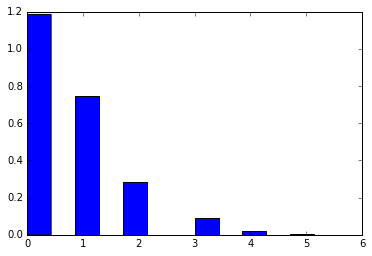

1
0
2
3
1
1
2
2
1
2
0
0
1
0
0
0
1
0
1
0
0
0
2
1
0
2
0
0
1
0
0
1
1
0
0
1
0
2
0
0
1
0
2
0
1
0
1
2
1
2
1
0
1
1
2
1
0
1
2
1
3
2
0
0
2
1
2
1
0
1
2
1
2
0
1
1
2
1
2
3
3
0
0
0
0
0
2
1
0
2
1
2
0
0
0
0
0
0
2
0
0
0
1
0
2
1
0
0
2
0
2
0
0
0
1
0
2
1
0
1
1
0
0
2
1
0
1
0
1
0
2
1
0
0
0
0
0
0
1
1
0
0
0
0
0
3
2
2
0
0
1
1
0
1
2
3
1
2
2
2
2
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
1
0
1
1
2
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
2
2
0
3
0
1
1
0
1
2
0
2
2
2
2
0
1
1
0
1
0
1
0
2
2
2
2
2
1
1
2
2
1
0
1
1
2
1
0
0
1
0
0
0
0
1
0
1
0
2
2
0
0
0
1
4
1
0
0
0
0
0
1
0
0
0
2
0
0
4
1
1
1
2
2
0
3
1
0
1
2
2
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
1
2
1
1
1
0
0
0
0
1
0
2
2
0
2
3
2
3
1
0
1
0
1
0
2
0
0
1
2
1
0
1
4
1
0
2
2
1
0
0
0
4
1
1
2
1
1
4
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
2
3
1
2
1
0
0
2
0
1
0
0
0
0
0
1
0
2
0
2
1
0
3
0
0
1
1
0
0
0
1
0
2
0
0
1
3
1
0
0
0
0
2
0
1
0
0
3
0
1
0
0
1
0
1
1
2
1
2
1
0
0
0
3
2
0
0
1
2
2
1
1
0
1
0
1
1
0
2
0
0
1
0
3
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
3
0
0
1
1
0
0
0
4
1
2


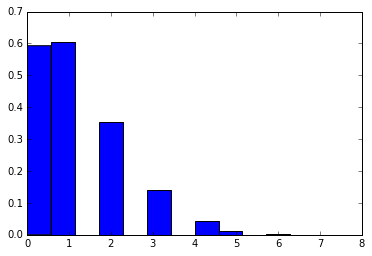

2
2
0
3
1
0
1
2
0
1
1
0
1
2
0
1
2
1
0
1
1
1
0
2
0
1
2
0
1
0
0
0
2
0
1
1
0
2
1
2
2
0
0
0
0
2
1
1
1
2
0
0
0
0
1
0
0
0
0
1
0
0
1
1
2
0
1
1
2
0
0
0
0
2
2
0
0
1
2
4
2
3
0
2
1
0
0
1
0
1
2
1
1
3
1
0
1
2
0
0
1
0
2
2
2
1
4
0
4
0
1
2
3
1
0
1
1
0
1
0
5
1
2
2
1
1
0
3
1
2
2
0
0
1
1
1
1
0
2
0
1
2
1
4
0
3
0
1
1
2
1
3
2
1
1
3
1
0
1
1
0
3
1
3
1
2
1
1
0
0
1
0
0
1
0
0
1
3
1
0
2
0
1
1
2
2
0
1
1
0
1
0
1
0
1
1
0
1
0
0
3
1
1
0
0
0
1
0
1
1
1
2
0
1
0
1
1
0
0
1
3
0
0
0
0
3
1
0
4
3
1
2
4
0
2
1
1
1
0
3
1
1
1
1
1
1
1
2
0
1
2
2
2
0
1
1
0
1
1
1
0
1
0
3
3
0
0
0
0
1
8
2
1
1
0
2
1
0
0
1
1
1
1
1
1
1
3
2
2
3
1
3
3
2
0
1
0
2
0
1
1
0
2
0
1
0
2
0
2
0
0
2
5
1
2
1
0
1
1
2
2
0
0
0
1
0
1
0
0
3
2
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
2
0
0
1
0
0
1
0
2
0
1
0
2
0
3
0
1
3
1
2
1
1
2
3
1
1
0
2
1
1
0
0
1
1
2
3
1
0
1
0
2
1
0
2
1
1
3
5
0
0
0
0
1
0
1
2
0
1
1
1
1
0
3
1
0
0
2
2
2
4
1
1
0
0
3
1
2
2
0
0
0
0
1
0
1
1
0
1
3
1
0
2
0
2
0
0
1
0
1
1
0
0
1
1
1
2
1
0
0
1
0
2
2
1
1
1
0
1
0
0
0
1
2
4
2
1
1
0
0
1
1
1
2
0
1
1
1
3
0
1


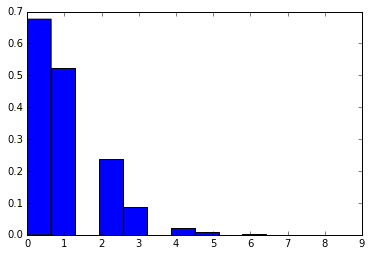

2
1
2
0
1
0
4
4
1
1
2
1
0
0
0
0
0
1
0
0
0
2
0
1
1
0
1
1
3
0
0
1
2
0
0
0
3
2
2
1
1
2
4
0
4
0
0
2
3
0
2
0
1
3
0
2
2
0
1
3
1
0
2
0
1
0
2
1
0
1
0
0
3
1
0
0
0
0
2
1
1
2
0
2
2
1
0
0
0
1
0
0
2
1
0
0
0
1
0
2
2
2
1
1
1
0
1
2
3
2
1
0
1
1
0
2
1
0
1
1
0
1
1
0
4
1
1
0
3
3
0
0
1
0
3
3
0
0
0
1
0
0
1
0
0
0
2
1
3
1
3
1
2
0
0
0
3
1
3
2
0
1
0
0
2
1
1
1
0
0
1
0
0
1
2
1
1
2
1
0
2
1
0
0
1
0
0
4
2
0
0
1
2
1
0
2
0
3
0
0
0
0
1
1
0
2
1
2
0
1
0
0
0
2
0
3
3
2
1
1
1
4
0
2
0
1
0
3
1
4
0
1
1
1
0
1
0
1
0
2
0
0
3
0
1
3
0
0
2
0
1
2
0
0
3
4
1
2
0
1
0
1
2
0
0
0
1
4
0
0
1
0
1
1
0
1
0
2
0
1
0
0
0
1
0
2
0
1
1
2
0
0
1
0
2
1
0
1
0
1
3
0
0
3
0
4
0
1
1
2
0
1
0
0
0
0
0
0
0
0
1
0
2
0
0
0
0
2
2
0
0
2
2
0
1
0
0
2
0
1
3
2
0
4
0
2
0
0
1
0
0
0
0
0
1
1
2
0
2
4
0
1
1
0
1
1
0
0
1
5
1
0
0
0
0
1
0
1
1
0
5
2
1
2
0
1
1
1
0
2
0
0
0
1
0
0
2
1
1
1
1
1
0
0
1
0
1
0
1
1
0
0
1
3
3
2
0
1
3
1
1
0
0
1
0
0
3
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
0
3
0
0
0
1
0
0
2
0
0
0
1
0
0
0
0
3
2
1
0
3
1
0
1
1
0
0
1
1
1
1
0
0
0
0
0
0
1
0
1
0
1
3
1
2
2
1
2
0
1
0
0
2
0
0
0


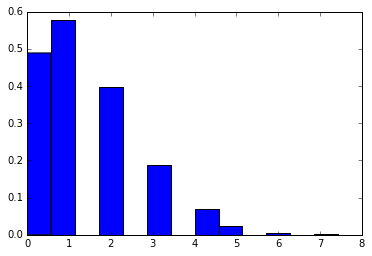

3
0
1
2
1
2
1
1
1
0
2
0
1
1
1
1
0
0
2
2
0
0
2
2
2
1
0
4
2
2
1
1
5
0
1
3
1
0
2
1
4
0
4
3
1
2
0
1
2
2
3
0
2
0
1
2
5
1
1
2
1
1
0
1
0
1
0
0
1
2
3
1
2
0
2
0
2
0
1
2
1
2
1
0
3
0
0
1
1
1
3
1
1
0
0
0
2
0
0
1
0
6
2
1
0
2
1
0
1
2
3
0
1
2
1
0
0
3
0
5
1
1
3
1
2
1
1
0
1
3
1
1
1
1
2
1
2
3
2
1
3
0
1
3
1
3
2
3
3
2
2
3
5
0
3
2
2
4
2
2
0
0
1
0
0
3
2
3
1
1
3
1
1
2
3
2
1
1
3
0
2
1
1
0
1
0
1
0
3
3
2
0
4
2
2
1
0
0
0
0
1
1
3
1
1
1
3
2
1
0
1
2
1
2
1
3
1
3
1
3
2
1
3
2
0
2
3
1
5
1
3
3
1
2
2
4
0
2
2
0
0
1
1
2
4
2
1
1
0
3
0
2
2
0
1
1
1
1
1
0
1
0
0
1
1
2
0
1
1
2
3
2
2
0
0
2
1
2
1
0
1
0
5
0
0
1
4
5
2
3
2
1
2
7
3
0
0
0
0
1
1
1
1
3
1
0
3
0
3
4
2
4
4
1
1
2
3
1
0
1
0
1
2
0
1
1
2
3
1
1
2
3
2
0
4
2
3
1
1
2
1
3
0
1
0
2
0
1
1
0
2
0
1
4
2
3
2
3
0
2
2
2
0
1
2
2
0
1
2
2
5
2
0
0
0
1
2
1
0
1
1
3
3
0
0
1
1
3
0
5
3
3
1
0
0
1
1
1
3
0
2
3
0
1
0
0
2
1
1
1
0
1
0
1
0
1
0
1
0
3
0
1
2
0
1
2
3
2
2
0
1
6
3
1
3
1
4
4
3
0
2
0
2
1
1
0
1
3
1
1
2
1
2
3
0
1
1
2
1
1
0
3
2
0
1
1
0
4
2
0
1
1
1
2
0
0
2
1
2
1
1
3
1
2
1
3
1
1
2
3
3
1
2
0
2
2
3
0
1
2


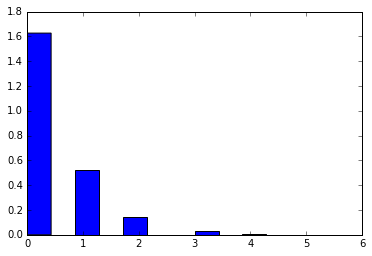

2
0
1
0
3
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
2
1
2
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
2
1
0
1
0
1
0
0
2
0
0
0
0
0
0
1
1
0
2
1
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
3
1
0
0
0
0
0
0
2
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
2
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
2
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
2
0
1
0
0
1
1
1
0
0
0
2
0
1
2
1
0
0
3
3
0
1
0
0
0
0
0
0
0
0
1
0
1
1
2
1
0
0
0
1
0
1
1
0
0
3
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
2
2
0
0
2
1
0
1
1
0
0
0
0
3
0
0
0
1
0
0
0
1
0
0
0
0
0
0
2
4
0
0
1
2
1
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
2
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
1
0
3
0
0
1
0
0
0
0
1
1
0
0
1
2
0
0
0
3
2
0
0
0
0
0
0
0
0
0
1
0
0
2
0
0
0
0
2
1
1
2
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
2
0
2
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
2
0
1
1
0
0
1
3
1
0
0
0
0
1
2
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
0
1
2
1
0
3
1
1
0
1
0
2
2
0
0
0
1
2
0
0
0
0
1
0
1
2
2
2
3
1
1
1
0
0
0
1
1
1
0
0
0


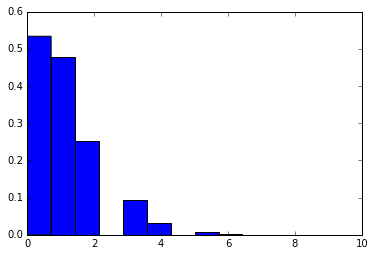

0
1
1
2
4
2
2
6
1
1
3
1
2
0
0
1
1
1
0
0
0
0
2
0
1
0
2
0
2
1
2
3
2
1
1
0
0
1
1
2
1
0
0
1
0
2
2
2
1
1
2
1
2
2
1
1
1
0
1
0
1
0
0
0
0
1
1
0
1
0
1
1
0
2
2
4
2
1
0
0
0
3
2
1
4
1
1
1
1
1
1
1
0
3
1
0
1
1
0
1
2
1
4
1
0
1
1
0
1
1
0
1
0
1
0
1
2
0
1
2
1
0
0
0
1
1
0
2
2
1
1
2
1
0
0
0
1
1
1
3
0
1
0
0
0
1
1
0
0
1
2
2
1
0
1
1
2
1
1
0
0
2
1
1
0
3
1
0
1
0
1
5
1
1
2
0
2
1
1
0
0
0
0
0
0
0
1
1
2
1
1
2
0
0
0
1
2
2
3
1
2
3
2
0
3
2
1
1
0
3
1
1
1
4
5
1
0
0
0
1
1
1
2
0
0
2
1
4
3
1
4
1
3
2
3
1
1
1
0
2
3
1
0
0
2
0
2
0
2
2
1
2
2
0
3
3
1
2
1
2
2
1
1
1
1
1
1
1
3
2
1
1
1
1
0
2
2
0
1
2
1
0
0
0
1
3
0
2
1
3
0
0
1
1
0
1
0
1
1
0
2
0
1
1
2
2
2
2
2
0
1
2
0
0
1
0
0
0
2
1
1
0
3
0
1
2
2
2
1
0
3
0
2
2
1
0
1
3
0
0
0
1
1
1
2
3
1
1
3
1
1
0
1
1
1
1
2
1
3
2
1
0
1
1
1
0
0
0
0
2
0
0
0
0
2
0
0
0
1
0
2
3
0
0
0
2
4
1
1
1
3
0
1
1
2
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
6
2
0
3
2
1
3
2
2
1
0
2
0
1
3
0
2
1
1
0
0
2
0
0
0
1
0
1
1
3
3
2
1
0
0
1
2
0
2
0
1
0
0
0
4
2
2
1
0
1
1
0
1
0
2
0
1
0
0
1
1
1
1
0
1
0
0
0
2
1
0
1
0
1
4
2
1
0
3
0
2
1
1
0
2


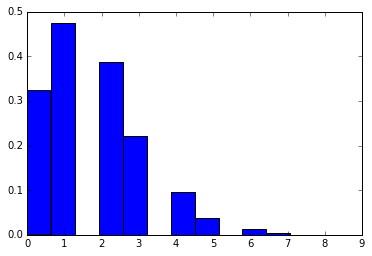

0
2
3
3
2
4
1
2
2
1
2
0
2
0
2
1
2
1
2
2
1
2
2
1
3
2
3
5
0
2
1
1
1
1
2
0
4
1
0
2
2
6
1
0
4
4
3
0
2
3
0
0
2
2
2
0
5
2
1
3
2
1
0
2
2
2
3
5
3
1
1
2
6
2
4
0
1
1
3
2
2
3
4
2
5
4
2
3
0
1
1
3
1
0
1
3
0
1
1
1
3
1
2
3
1
1
0
0
1
2
1
2
2
0
0
0
2
3
3
3
1
4
3
1
3
1
0
1
3
1
3
0
1
4
2
4
2
0
3
1
3
2
1
4
2
1
2
2
4
2
1
2
2
3
3
1
1
2
2
2
2
2
1
0
4
4
2
1
1
1
4
1
0
3
6
0
1
2
0
4
2
3
0
2
4
1
4
1
2
3
0
1
0
2
1
4
1
4
2
3
1
3
2
2
4
7
1
2
3
1
0
1
1
4
1
2
0
0
4
1
0
2
5
0
0
1
1
0
3
2
1
0
3
3
3
2
1
2
1
3
3
1
2
2
6
3
1
1
4
2
1
1
0
2
0
2
5
2
5
0
3
0
4
4
1
2
2
1
3
3
2
5
1
1
1
1
5
0
1
2
0
4
0
3
2
4
2
1
3
2
2
6
2
3
1
1
0
1
1
5
2
2
1
1
0
3
3
1
2
4
1
1
1
3
2
0
1
2
2
3
1
2
1
2
2
0
3
3
1
0
3
1
0
1
1
2
1
3
5
4
1
3
1
0
3
1
4
2
0
2
3
2
0
1
1
0
3
0
2
1
1
2
1
1
4
0
4
1
1
0
3
2
2
2
3
0
1
4
2
1
1
0
2
2
1
2
2
1
3
0
3
1
1
0
1
0
0
1
3
1
3
3
1
1
1
1
0
2
2
4
1
3
2
5
0
1
4
0
0
2
6
3
1
5
2
4
2
1
1
4
3
1
2
1
2
1
2
3
4
1
1
2
4
3
2
1
3
1
2
1
2
0
3
0
0
2
3
3
0
3
3
5
4
2
5
1
3
0
2
1
2
2
1
0
0
0
0
0
2
1
2
3
1
1
1
2
2
5
3
3
3
1
0
1
1
1
1
2
2
3


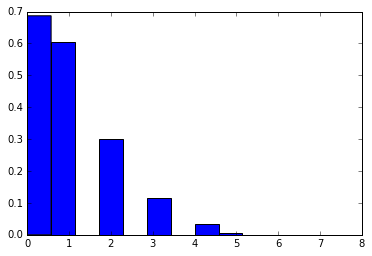

1
1
2
2
0
1
0
4
1
1
2
0
1
0
1
0
2
3
5
0
0
3
0
0
0
0
0
2
2
2
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
2
3
0
1
0
0
2
0
1
0
1
0
1
1
0
0
0
2
1
1
1
0
1
0
1
0
2
1
1
1
3
0
1
2
1
0
2
3
1
0
1
1
0
1
0
0
0
3
0
0
2
0
0
1
0
2
1
0
2
2
2
1
5
1
3
4
2
0
0
0
1
1
1
1
1
1
2
1
1
1
2
1
1
1
0
0
1
2
0
0
1
0
1
1
1
1
1
1
1
2
1
1
1
0
1
2
0
0
0
0
0
0
1
1
2
1
1
3
0
2
2
2
1
0
1
0
2
1
1
1
0
1
3
0
0
2
1
0
1
1
0
4
1
2
1
0
1
1
0
3
2
2
1
1
1
0
4
0
2
1
1
1
2
0
8
4
2
1
2
2
0
0
0
1
1
1
5
2
1
0
1
2
0
0
1
1
1
0
2
1
1
0
2
1
0
1
0
0
0
2
0
2
0
1
0
0
0
1
0
2
0
1
1
3
3
0
0
1
2
2
1
3
3
1
5
2
0
0
0
1
1
0
1
2
2
0
0
0
1
1
1
1
0
0
1
3
1
0
2
3
0
1
1
1
0
4
1
0
0
1
0
1
0
0
0
1
1
1
3
1
0
5
1
2
0
4
1
3
0
0
0
0
1
1
3
2
3
0
0
2
0
0
0
0
0
0
2
0
0
4
2
1
1
1
1
1
0
0
0
0
2
0
1
1
0
1
0
1
0
1
1
0
0
1
0
0
0
2
1
0
1
2
1
2
0
0
0
2
1
3
2
1
1
0
2
0
0
0
0
2
1
0
0
1
3
1
1
1
0
0
1
1
2
2
0
1
1
1
1
1
1
2
2
2
1
0
1
1
0
0
1
2
0
2
2
0
1
0
0
1
2
0
0
2
3
1
0
1
1
2
0
2
2
1
1
0
2
0
1
3
0
1
2
1
0
3
2
1
1
0
1
0
2
3
1
0
1
0
3
2
0
2
2
2
1
3
2
2
1
0
0
1
1
2
1
1
1
2
1
2
0
2


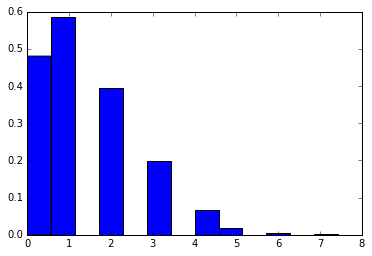

2
0
7
2
1
0
5
4
1
2
2
2
2
1
1
2
2
2
1
1
3
3
1
2
3
2
4
1
2
2
1
1
1
0
1
2
0
1
1
2
2
3
1
2
2
1
2
1
2
2
2
1
2
3
1
3
4
2
4
2
0
0
0
3
1
3
1
2
2
2
1
1
0
1
0
0
0
1
0
1
1
1
2
3
1
6
6
3
1
3
2
2
1
2
0
0
0
0
1
0
0
4
3
1
1
2
0
1
1
0
0
1
3
2
1
1
1
3
2
0
3
0
2
3
1
4
0
3
0
0
3
1
0
1
2
1
2
1
0
1
0
2
0
1
1
2
2
1
1
1
0
2
0
2
2
1
2
1
0
1
1
1
4
1
2
0
3
2
1
2
1
2
0
2
2
1
1
0
0
2
1
4
2
1
2
4
2
0
1
4
1
2
1
1
0
2
1
0
0
2
2
2
3
2
2
1
1
1
3
0
1
0
1
2
0
1
1
2
1
4
0
1
2
3
1
1
0
1
1
1
2
0
0
2
1
3
3
1
1
1
3
2
1
1
3
1
0
0
1
2
2
0
2
3
1
1
3
3
3
1
2
2
3
1
0
1
0
4
1
0
1
0
0
1
1
0
3
1
0
1
2
3
2
1
1
2
0
2
1
0
1
0
0
2
0
1
3
0
1
1
1
0
0
1
2
0
0
1
3
2
0
1
1
1
2
1
1
1
0
2
0
3
5
5
1
2
3
0
1
1
2
2
1
1
0
1
1
0
0
1
3
0
2
1
2
0
2
2
0
1
1
1
1
1
1
1
2
0
2
2
1
1
1
0
1
1
2
0
2
1
1
1
0
0
0
2
1
0
0
1
1
0
1
1
1
2
1
0
0
0
1
2
1
1
4
1
1
1
2
1
1
2
0
3
1
0
0
3
2
2
0
2
0
2
3
1
5
2
1
1
5
0
0
0
2
1
0
3
2
1
1
5
3
0
2
2
1
1
4
1
5
2
2
0
0
0
2
1
2
3
1
0
2
0
0
1
1
0
2
2
4
1
1
0
0
4
1
1
0
3
0
0
4
0
2
1
1
1
3
0
2
5
4
0
2
0
1
0
1
0
1
2
0
1
3
2
1
2
0
2


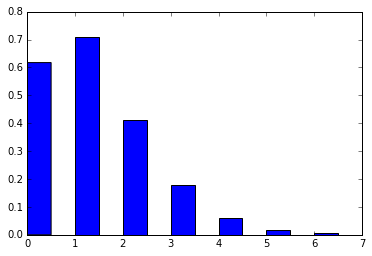

2
3
1
1
1
4
1
2
2
2
2
0
3
1
0
2
0
1
1
2
0
1
2
1
1
2
0
0
3
1
0
2
0
1
1
2
2
2
2
0
0
1
2
1
2
1
1
0
0
0
0
1
0
0
2
1
0
0
1
1
1
1
1
3
2
0
2
2
0
3
1
3
0
2
3
1
2
0
2
3
0
0
0
2
1
2
1
0
1
0
1
0
2
0
1
1
0
0
2
2
1
1
4
2
1
0
0
1
1
1
1
3
1
2
3
2
0
0
3
1
1
2
0
0
1
3
0
1
1
0
1
0
2
3
2
1
1
0
1
0
3
0
0
4
0
1
0
0
0
2
2
2
0
1
2
0
4
3
3
1
1
2
1
0
2
0
4
1
0
1
3
2
1
3
1
0
2
0
1
1
2
1
0
1
1
1
1
0
2
2
1
0
0
1
2
1
4
5
2
0
1
1
1
2
2
0
2
3
2
0
0
1
0
2
0
0
1
0
0
0
0
2
1
0
1
0
2
1
0
1
2
1
2
1
2
1
0
2
1
1
1
2
2
0
3
2
3
2
3
1
2
1
1
1
0
1
3
1
1
2
1
2
3
3
1
4
3
5
0
1
2
4
3
0
2
0
1
3
3
3
4
0
0
1
0
1
1
0
2
0
0
0
3
0
1
0
0
2
0
1
3
1
2
2
3
2
2
2
3
2
0
1
3
2
3
1
0
0
2
0
0
1
1
1
0
1
1
0
1
1
3
0
2
1
1
3
0
0
2
0
1
1
0
1
0
3
1
0
1
3
1
1
0
1
0
1
2
1
0
1
2
0
0
0
1
0
1
1
0
2
2
0
1
2
2
2
3
1
3
2
1
0
1
2
1
1
2
1
3
1
0
2
1
3
1
0
2
1
2
2
1
0
0
1
1
0
0
0
0
0
1
1
0
3
4
3
2
1
3
0
0
1
2
2
1
0
1
2
1
2
1
1
3
1
0
1
0
3
4
0
2
1
2
2
1
0
3
3
1
2
0
2
3
0
1
1
1
2
3
1
1
0
2
2
4
1
4
2
2
2
2
1
1
0
2
1
2
1
1
1
1
1
0
0
3
1
1
1
0
1
3
5
1
2
0
1
0
0
0
0


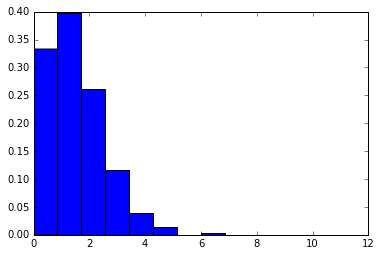

4
1
2
1
2
0
1
0
2
0
0
0
0
2
1
1
2
1
3
0
2
0
1
2
1
3
1
1
1
2
1
1
1
0
2
2
1
0
1
2
1
1
2
2
0
1
1
3
0
5
1
1
3
0
2
1
4
3
0
2
2
3
0
1
1
1
0
3
4
3
0
1
1
3
3
0
0
2
1
3
2
6
1
0
2
1
3
2
1
2
4
0
0
1
1
1
2
1
2
1
5
0
2
0
0
0
1
2
0
4
1
0
2
3
1
0
0
2
2
1
2
1
4
1
3
0
0
1
3
2
0
1
1
0
2
4
2
2
1
1
2
1
2
1
1
1
3
0
5
0
2
1
3
0
0
2
2
0
2
2
0
1
3
2
2
1
3
1
4
0
0
1
1
1
2
2
2
0
1
1
0
0
1
0
3
1
2
0
0
0
2
0
2
2
0
0
0
2
1
1
2
1
1
1
0
1
1
1
3
0
1
1
1
1
3
0
0
0
2
1
1
1
1
1
1
1
2
1
1
0
2
0
0
2
2
2
2
1
0
1
0
2
1
0
1
1
0
2
1
1
0
1
1
1
1
1
2
1
3
1
3
1
1
2
4
1
0
0
3
0
0
0
1
2
1
3
1
0
0
1
0
2
0
0
0
2
1
2
0
1
1
3
1
1
2
2
0
1
0
0
1
0
3
2
4
2
1
1
1
1
4
3
0
2
1
1
1
4
1
0
1
3
3
1
2
0
2
0
0
0
1
3
3
3
4
1
2
1
0
2
3
1
1
4
4
2
2
2
1
0
0
2
2
3
3
1
1
1
1
2
1
0
0
2
3
0
2
1
0
0
0
1
2
1
1
1
0
2
3
1
3
3
0
2
0
1
1
3
2
0
1
2
1
1
2
1
3
1
0
1
2
1
2
0
0
0
1
1
0
4
3
2
2
2
2
1
1
0
1
0
1
2
1
1
1
3
1
0
1
0
1
2
1
1
5
0
2
1
0
2
3
0
1
1
1
1
4
0
0
6
3
1
1
2
3
1
1
2
2
1
1
2
3
0
2
0
2
3
0
1
2
1
2
2
2
3
1
0
3
4
0
2
2
2
4
1
0
2
3
4
2
0
3
0
0
1
2
0
0
1


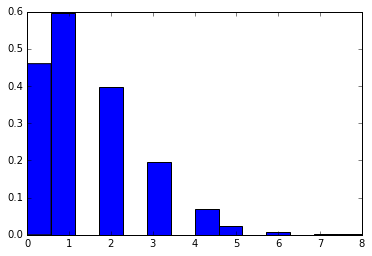

1
0
0
1
2
1
1
1
0
3
1
2
1
3
0
2
1
4
2
1
0
1
0
4
2
2
2
0
3
4
1
0
0
0
1
0
1
0
0
3
1
1
1
1
2
1
0
0
1
2
3
1
0
3
1
0
3
2
3
3
1
0
0
3
1
2
3
0
4
0
1
1
1
2
2
1
0
0
3
3
4
1
0
0
1
0
3
1
0
2
0
0
1
0
0
1
0
2
1
1
1
3
1
4
1
2
4
0
1
3
1
1
1
2
1
0
0
1
0
0
0
1
1
0
0
0
1
2
2
0
0
0
1
1
1
1
0
1
0
0
3
1
2
2
0
2
0
0
3
2
3
2
1
0
0
2
0
2
1
0
1
0
0
0
0
3
2
0
3
2
3
2
1
2
0
1
3
1
1
2
1
2
0
2
2
1
1
2
2
1
1
1
1
0
0
2
3
3
0
2
3
3
2
2
1
4
1
0
2
1
2
1
1
0
1
1
1
1
0
1
0
2
3
0
4
2
2
4
2
2
2
1
1
2
1
3
2
2
2
2
1
0
2
2
2
0
2
2
1
2
0
2
1
1
1
1
2
1
3
1
2
2
5
4
0
0
0
1
2
1
1
2
1
5
1
4
4
0
1
1
1
0
1
2
1
1
1
4
0
1
1
2
0
2
3
2
2
5
1
0
1
0
0
1
0
1
0
3
2
2
1
0
0
1
0
1
2
0
3
1
2
1
2
2
2
1
3
1
0
1
2
2
0
0
4
0
0
1
2
2
1
5
2
2
1
1
0
2
3
3
1
1
0
2
2
6
0
4
2
1
2
2
0
1
1
2
2
2
0
1
0
1
1
1
0
2
0
2
2
3
1
1
2
0
1
0
2
0
1
5
3
1
0
0
1
2
0
0
1
0
1
2
2
1
0
1
1
3
3
1
1
2
1
0
1
1
1
0
0
2
2
0
2
2
0
4
1
0
0
3
0
2
6
0
3
2
2
2
0
2
1
1
0
2
2
0
0
1
0
0
1
3
4
0
0
2
1
2
3
2
5
0
4
2
1
1
2
1
0
0
0
2
1
0
1
2
1
0
1
2
2
1
1
1
1
3
1
1
1
2
2
1
1
0
0
0
0
2
4
2


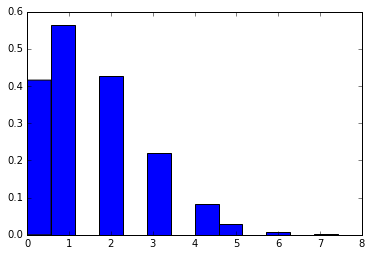

1
3
2
4
3
0
4
3
1
4
2
2
1
2
3
1
3
5
0
1
0
0
2
2
0
1
3
1
3
3
0
1
2
1
0
2
2
2
1
0
2
1
1
0
1
4
1
1
1
1
2
1
4
2
0
1
1
1
4
1
0
5
1
2
3
0
3
3
1
2
0
0
0
0
1
0
1
2
3
3
2
2
0
0
2
1
2
1
1
2
1
1
1
0
1
3
2
1
1
3
1
2
2
3
2
2
2
1
2
2
0
3
2
0
2
4
0
1
4
1
1
0
1
1
3
2
0
2
2
2
1
1
0
3
0
0
0
3
2
3
1
1
1
3
3
1
0
2
1
3
1
4
4
1
1
0
3
1
1
1
2
1
0
4
3
0
1
0
3
1
4
1
2
1
0
0
1
1
1
1
1
2
4
2
1
3
1
0
1
0
0
0
1
0
2
2
1
2
1
0
0
2
1
0
4
1
2
1
1
0
0
2
2
2
1
1
2
2
3
1
5
0
0
1
3
1
2
3
3
1
0
1
3
0
4
3
1
2
5
2
4
3
1
5
4
2
0
1
2
2
1
2
4
4
3
1
6
4
1
2
4
1
1
2
0
1
0
4
1
1
0
1
1
0
2
2
1
1
2
0
1
1
1
2
1
1
1
1
1
2
3
1
2
3
1
1
5
0
0
1
3
0
3
2
2
2
2
1
3
1
0
0
2
0
0
1
3
2
2
1
3
2
0
0
3
2
1
0
0
2
3
3
1
5
4
2
2
3
3
3
1
5
3
0
2
1
0
4
2
2
0
1
0
2
2
0
1
3
1
2
2
1
2
1
1
1
3
1
1
2
1
1
1
2
3
3
1
0
1
1
1
1
1
0
0
3
2
0
2
2
0
2
1
2
2
3
3
0
1
0
1
3
1
1
1
5
2
1
2
0
2
0
5
5
0
0
2
1
3
3
2
1
2
1
0
1
2
5
1
2
1
3
1
0
0
2
1
3
1
3
3
4
1
0
3
0
5
0
1
1
2
1
1
2
4
1
2
3
2
2
2
0
0
3
2
1
1
2
4
1
0
1
3
3
1
3
1
1
2
0
3
2
3
0
1
1
3
1
2
2
4
5
2
3
1
0
5
0
2
1


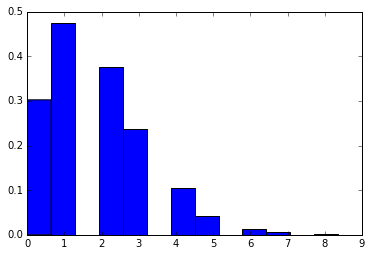

4
0
0
1
2
4
2
5
3
1
0
2
4
5
3
0
0
1
1
1
2
0
0
0
1
0
2
1
3
0
0
1
1
4
1
1
0
4
2
2
3
0
1
1
1
3
2
1
2
0
1
3
0
1
0
2
1
2
0
1
2
2
1
2
1
0
4
4
1
1
1
3
4
2
2
3
5
1
2
0
1
1
5
1
1
1
1
1
0
0
2
1
2
1
1
3
0
0
2
3
3
7
1
1
2
0
0
1
5
2
4
5
1
1
0
1
1
1
1
2
0
0
3
1
0
1
2
1
0
0
0
0
1
3
4
1
2
0
2
2
2
2
3
1
4
1
1
2
2
2
0
2
3
1
3
2
2
3
2
3
1
1
2
5
3
2
0
0
5
3
3
1
0
1
2
0
6
1
2
3
1
2
3
3
3
1
1
2
2
1
2
2
2
1
3
2
1
1
1
3
0
2
4
6
2
2
5
5
3
0
2
2
2
1
2
1
2
3
0
2
1
3
1
1
3
3
3
3
1
4
3
0
2
2
2
1
0
2
1
3
2
0
5
0
0
1
0
0
1
0
1
1
0
1
2
3
5
3
4
3
0
3
6
5
3
4
2
2
0
0
2
4
0
1
1
3
2
1
1
1
2
2
2
3
3
2
1
0
2
2
1
1
0
3
3
2
3
1
3
1
0
1
3
2
1
0
3
1
4
2
3
2
1
2
1
0
2
2
2
1
4
1
4
1
0
3
2
2
1
0
5
2
0
0
1
1
2
1
3
4
2
1
1
2
1
1
1
1
3
3
0
3
0
1
6
0
2
1
3
3
3
2
0
0
4
3
2
2
1
0
4
0
2
1
1
4
0
1
2
2
3
0
3
1
2
0
0
4
3
1
5
6
1
3
0
5
6
3
0
1
3
0
1
2
1
0
3
1
2
3
0
2
1
1
3
0
1
0
2
0
4
1
1
1
1
3
2
3
2
2
0
5
3
2
1
0
1
3
2
2
1
0
3
0
3
3
5
3
3
2
4
0
1
2
4
1
1
4
2
1
6
1
2
1
0
2
2
3
1
1
3
4
1
1
1
2
0
4
1
0
1
1
5
3
3
1
2
0
2
1
1
1
2
1
1
1
2
2
1
4


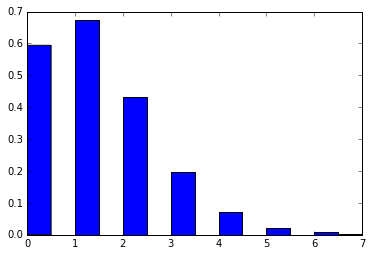

1
0
1
3
2
2
1
3
3
2
3
2
3
3
2
1
1
3
0
3
1
2
1
0
1
2
0
0
1
0
1
2
0
0
0
2
2
2
2
3
0
1
4
2
0
2
4
0
1
0
1
0
1
3
2
0
0
1
2
3
0
0
0
3
4
1
2
2
1
1
0
1
1
1
5
2
2
2
1
0
1
3
1
3
2
1
1
2
1
2
1
0
0
1
0
0
0
0
0
1
2
1
1
2
3
2
0
0
1
3
0
1
2
2
0
2
0
0
1
0
1
1
0
0
1
1
0
1
4
0
2
1
0
1
3
1
2
0
0
0
2
1
1
0
0
0
1
4
1
2
0
0
0
7
3
1
2
0
2
3
1
1
3
1
2
3
1
1
0
1
3
2
3
0
1
2
1
3
1
3
0
1
2
1
0
2
0
2
2
1
1
2
1
0
0
1
0
2
0
0
2
3
2
1
1
1
1
3
5
2
1
0
2
0
2
2
3
0
0
2
0
3
3
0
0
1
1
0
2
1
2
2
1
2
1
1
0
5
2
1
0
1
1
0
1
2
3
2
3
2
0
3
2
3
1
1
6
1
3
0
3
2
3
0
1
0
3
0
2
1
0
2
2
2
1
1
2
1
0
1
3
0
1
1
4
2
0
6
1
3
3
2
1
0
1
3
1
4
4
0
0
1
0
1
2
1
0
2
1
1
2
1
4
1
0
1
1
1
1
1
4
0
2
1
2
2
2
0
0
1
1
0
0
1
1
0
2
1
0
0
2
1
3
1
1
0
4
0
2
1
0
1
0
2
1
0
4
1
0
1
1
0
2
1
0
0
0
0
2
0
0
1
2
1
1
0
1
1
0
0
0
0
2
0
0
1
0
1
0
1
2
1
0
0
1
0
1
0
1
1
2
0
4
0
0
2
1
1
0
1
0
1
2
0
2
0
2
2
1
2
3
3
0
0
2
1
0
1
1
1
2
2
2
3
0
3
2
2
1
0
0
4
1
0
0
0
1
1
1
2
3
1
1
0
2
0
2
1
1
2
2
3
5
2
2
1
6
3
6
0
4
1
1
1
3
0
0
3
2
3
3
1
3
2
4
3
1
1
1
3
2
0
1
3
3
1
0
2
3
4


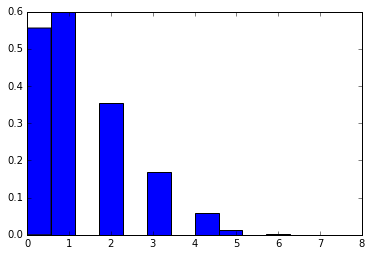

4
2
2
1
0
3
0
1
2
2
4
1
1
1
1
3
3
1
3
1
1
0
1
0
2
1
4
3
1
0
0
0
3
5
0
2
1
2
1
0
1
1
2
1
2
1
0
5
5
0
3
3
3
1
1
2
3
2
1
1
4
4
2
2
1
2
0
1
0
1
0
0
2
1
0
1
1
1
1
0
2
2
1
1
2
1
0
1
1
2
0
0
0
1
1
0
0
1
2
2
2
1
1
0
1
0
1
1
0
1
3
2
1
2
2
1
1
4
3
3
2
1
1
0
2
0
4
0
0
1
1
1
0
0
0
2
1
1
1
1
2
0
2
0
0
2
3
0
3
1
1
1
0
0
1
0
1
1
2
0
0
3
4
2
1
1
2
3
0
2
1
0
0
0
2
1
0
0
3
1
1
2
1
0
1
1
0
1
0
3
1
0
2
0
0
0
3
3
2
0
0
0
3
2
0
0
2
1
2
1
0
3
2
2
1
1
2
1
0
1
0
1
2
1
2
0
1
0
0
0
2
0
2
1
0
0
1
2
1
1
4
2
1
2
5
1
2
0
2
0
0
1
3
0
1
1
1
1
0
2
1
0
4
1
0
2
1
2
3
0
1
1
1
0
2
3
3
0
1
2
3
0
1
2
1
0
0
1
1
3
1
0
2
0
2
0
1
0
0
0
1
0
0
0
2
0
2
2
2
2
2
0
1
0
0
2
1
0
2
0
0
0
2
3
1
3
0
1
0
0
0
2
1
0
1
0
0
0
3
1
1
1
1
0
1
2
0
1
4
0
1
1
1
1
2
2
2
1
0
4
0
0
0
0
1
0
1
2
3
0
0
1
1
1
3
1
1
2
1
0
1
1
1
1
1
3
2
0
0
0
4
1
1
2
1
0
0
1
0
2
0
0
0
1
0
0
1
0
0
0
1
1
1
2
0
0
1
0
0
1
5
2
3
4
4
4
3
4
0
0
3
3
0
1
2
2
1
3
0
0
3
1
0
0
2
1
0
3
2
0
1
3
1
3
1
0
1
1
0
2
1
1
1
3
2
2
1
1
1
2
0
1
0
1
5
0
1
1
0
0
3
2
0
3
3
2
4
1
3
0
1
2
3
0
2
4
2
0
2
4


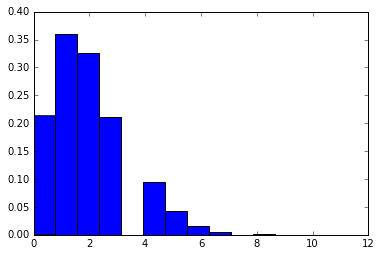

0
2
2
1
1
5
3
2
2
3
2
2
2
2
3
0
4
2
1
1
5
5
2
4
2
2
3
0
2
3
3
2
2
1
3
0
1
1
3
2
1
4
1
2
1
0
3
2
3
2
1
1
1
2
1
2
1
2
1
1
1
0
1
0
3
0
0
0
0
1
1
0
3
2
5
5
3
2
1
2
1
2
2
1
0
0
3
6
3
3
3
2
2
3
0
1
1
1
0
0
0
3
0
1
3
3
2
1
2
2
2
1
2
2
3
2
1
0
2
2
0
1
2
2
2
2
3
0
3
1
5
8
1
2
1
0
4
2
3
2
5
1
1
2
3
1
3
3
3
3
2
1
1
3
2
0
0
1
4
1
2
0
2
1
4
0
1
2
1
1
2
1
4
3
3
2
2
1
2
3
2
1
0
3
0
1
2
2
0
1
1
1
0
1
2
2
2
1
1
4
3
3
1
0
1
2
2
1
4
3
1
0
2
0
1
3
0
3
1
2
2
1
0
0
1
1
2
0
2
1
1
2
0
2
5
2
2
2
1
1
5
1
1
0
5
4
0
1
0
4
2
2
2
0
1
1
5
2
2
1
3
3
3
1
0
1
2
2
2
2
0
2
1
0
3
4
2
1
1
1
0
0
1
3
1
0
2
2
2
1
1
5
0
1
4
4
0
2
1
1
7
3
1
4
3
2
4
3
5
5
0
0
2
0
2
0
2
4
3
1
1
3
3
4
1
4
5
1
0
2
0
5
0
2
1
2
1
3
3
1
3
1
2
0
2
1
4
2
3
2
4
1
4
0
0
3
1
3
4
3
2
1
1
1
0
3
2
2
2
3
0
1
3
2
4
2
3
3
2
2
1
2
0
1
4
7
4
3
6
6
3
3
1
2
2
1
2
0
3
2
3
1
1
3
2
1
3
0
1
3
3
1
2
5
2
2
3
2
0
0
3
1
1
3
4
3
3
1
2
2
2
2
1
4
5
1
1
1
1
2
2
2
1
2
1
1
2
1
3
0
1
1
2
1
7
2
0
8
1
2
1
2
2
3
1
4
1
2
3
3
1
0
5
4
1
4
1
2
0
2
5
2
1
3
2
6
1
2
3
1
3
1
2
2
0
2
1
0
2
3


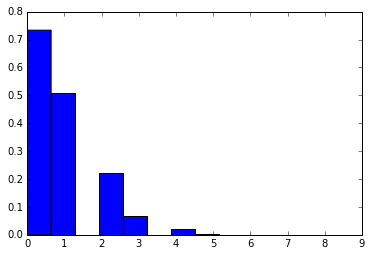

3
0
0
3
1
0
0
0
0
0
0
1
1
2
2
3
3
1
3
1
0
0
0
1
0
1
1
2
0
1
5
0
0
0
0
0
2
0
1
2
0
2
2
0
0
2
0
0
1
1
3
1
1
0
0
0
3
0
2
2
1
1
0
0
0
0
2
2
1
0
2
1
1
0
1
3
3
1
1
0
0
1
0
0
0
2
1
1
1
1
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
0
1
1
1
1
3
0
2
1
1
1
1
0
0
0
0
1
0
0
1
1
0
1
0
0
0
0
2
1
1
0
0
0
0
1
2
0
0
1
4
0
0
1
1
0
0
1
1
1
1
2
0
0
1
0
0
1
1
0
3
0
1
0
1
1
0
0
2
0
0
0
0
0
0
2
0
0
1
0
0
1
2
1
0
0
2
0
2
1
1
0
2
1
2
3
0
1
0
4
0
1
0
0
1
0
1
1
1
0
1
1
1
1
1
2
0
0
1
4
3
1
2
2
2
0
2
0
1
3
2
2
2
2
1
0
0
0
0
0
1
0
0
2
0
1
0
0
1
0
3
1
3
0
0
1
0
0
0
1
1
2
2
0
1
1
3
1
1
1
0
2
0
3
0
0
0
2
3
3
2
0
5
3
2
2
0
1
1
0
0
0
1
0
1
1
1
0
3
1
1
3
0
0
0
0
0
0
0
1
0
1
2
0
3
1
1
3
1
0
1
0
0
0
1
0
0
1
0
2
1
0
2
0
2
0
2
0
0
0
0
0
0
0
1
0
2
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
2
1
0
1
0
0
0
2
0
0
0
0
0
0
0
2
2
1
1
1
0
0
1
2
2
1
1
1
1
2
0
0
2
0
1
1
1
4
0
0
0
1
0
0
0
2
2
2
0
2
2
1
0
0
1
0
0
2
0
1
1
2
1
1
0
1
0
2
1
3
1
4
0
0
0
0
0
2
0
2
1
2
2
0
0
1
0
1
0
1
0
2
2
2
4
0
1
5
0
1
0
0
0
1
0
1
0
1
2
1
2
0
1
1
0
2
1
1
0
0
2
1
2
0
2
0
2
1


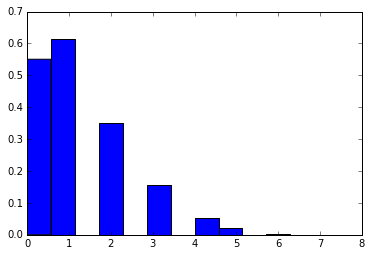

0
1
0
2
1
1
0
0
2
1
4
0
1
1
0
0
1
1
1
0
1
3
1
0
1
1
0
3
1
1
1
2
0
0
0
0
1
0
3
0
3
3
2
0
0
0
2
1
1
1
1
2
3
1
1
1
1
1
1
3
2
2
2
2
0
1
4
1
3
1
2
1
1
1
2
1
1
2
0
0
0
0
2
2
2
0
0
1
0
0
2
2
1
1
1
1
0
1
2
1
2
1
1
3
1
1
2
1
1
0
0
3
0
0
1
3
1
0
1
3
2
1
1
1
0
1
1
5
1
0
0
0
1
0
1
0
0
0
1
1
1
3
1
0
0
1
0
2
2
0
1
1
2
0
0
1
4
2
1
1
1
3
1
1
2
1
2
1
1
2
3
0
1
0
1
1
1
0
2
1
3
3
1
1
0
1
0
0
1
1
3
0
2
0
1
2
4
1
2
1
2
1
0
1
1
0
1
0
1
1
0
1
0
1
0
0
1
1
0
1
2
3
2
0
1
0
0
1
2
2
1
1
2
0
1
1
2
1
2
3
1
0
0
0
1
0
1
1
1
3
1
4
1
2
0
1
3
5
1
3
2
5
4
3
0
3
1
0
1
1
0
0
1
2
2
0
0
2
1
0
0
0
0
0
0
0
2
0
0
0
0
3
0
0
1
0
0
0
0
0
1
1
3
0
0
2
1
0
2
1
1
0
1
0
1
1
1
2
4
1
3
2
1
3
0
1
3
2
1
1
3
0
1
1
1
0
0
0
1
0
0
0
0
2
0
0
1
0
1
3
0
0
0
1
0
1
1
2
2
0
0
1
1
0
0
1
2
1
2
0
1
0
1
1
2
1
0
3
3
4
2
0
0
2
1
2
0
0
2
1
1
3
2
1
2
1
1
0
1
0
0
1
3
5
1
3
2
2
0
1
3
1
0
0
1
1
1
2
0
3
2
1
0
1
1
2
0
1
1
1
2
1
1
0
3
2
2
1
2
1
2
0
3
2
1
0
3
0
1
0
2
0
0
2
1
1
0
1
0
1
1
2
2
2
0
1
0
1
0
1
1
2
0
0
1
1
1
1
2
1
0
0
2
2
5
2
1
1
0
1
2
0
2
3
2
4
1
4
0
2


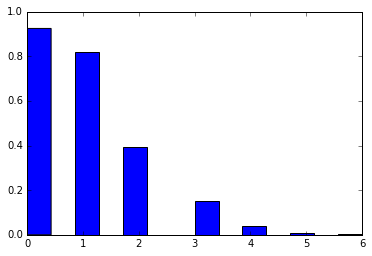

0
1
2
2
0
1
2
3
1
3
1
0
1
1
1
2
1
3
0
2
2
1
0
1
0
1
2
0
2
0
2
0
2
1
2
2
2
1
1
2
2
2
3
1
2
0
0
1
1
1
2
1
1
0
0
0
2
0
3
0
0
1
2
1
0
1
1
2
0
0
0
0
0
3
2
0
1
3
3
0
2
2
2
2
2
3
1
0
0
1
0
0
2
0
1
1
1
1
0
1
2
3
0
3
1
3
1
1
1
1
1
2
0
2
0
1
1
0
0
0
2
2
0
0
1
1
1
2
0
0
1
0
2
1
0
1
2
0
1
0
0
2
1
2
0
2
0
0
3
3
0
0
0
2
0
0
0
0
2
0
0
0
0
1
1
0
0
1
0
0
1
0
2
1
0
0
2
1
0
2
2
0
0
2
1
1
0
0
0
2
1
1
2
1
0
2
2
1
2
1
1
2
1
1
1
2
1
1
2
2
0
0
0
3
2
3
0
3
3
1
2
1
1
3
0
3
0
0
0
1
1
0
2
2
3
0
2
0
1
1
1
0
0
1
0
1
0
0
1
1
0
3
0
0
1
0
2
1
1
3
3
3
5
2
1
1
0
0
2
0
1
0
3
1
0
0
2
0
0
1
0
0
0
1
0
0
3
1
0
3
1
1
2
1
0
2
0
0
1
1
0
1
1
1
1
0
1
1
0
0
1
0
1
1
0
0
0
2
2
1
1
1
2
1
4
1
0
0
0
2
3
1
1
1
1
2
0
1
0
2
0
0
0
2
1
2
1
0
1
0
2
1
1
2
1
0
1
2
2
0
3
2
2
1
0
3
1
1
0
1
1
2
0
0
2
1
2
3
1
1
2
0
0
1
1
1
0
1
1
1
2
0
0
0
0
0
0
2
0
0
1
0
1
1
1
1
2
1
0
3
0
4
1
3
3
1
0
0
1
0
1
1
2
3
1
1
1
2
1
2
1
1
0
1
0
0
1
0
2
1
1
2
1
0
1
1
0
0
1
1
0
2
2
4
1
1
0
1
0
1
1
3
2
1
1
3
5
2
0
0
2
0
0
1
1
0
1
0
2
0
3
0
0
0
3
2
3
3
0
1
1
0
2
0
0
1
0
0
2
1


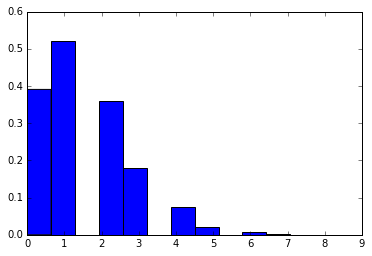

0
0
0
3
1
1
1
1
1
2
5
0
3
3
0
0
2
1
1
0
3
2
0
0
1
1
3
1
1
1
1
0
1
1
1
6
2
3
3
1
3
2
0
1
1
2
0
0
1
0
3
0
2
4
1
1
2
0
2
0
2
1
0
1
2
0
1
1
2
3
4
0
1
1
5
1
1
3
2
4
1
0
2
0
1
1
1
0
0
0
1
1
0
3
0
0
0
1
1
1
0
1
2
1
3
0
1
1
2
2
2
1
1
2
0
2
1
0
1
2
2
2
0
0
1
0
1
2
0
2
0
1
1
1
2
3
1
3
1
1
1
2
0
2
1
2
1
2
1
2
1
1
3
0
0
0
0
0
1
1
2
4
1
2
6
1
1
0
3
0
2
2
1
2
3
2
1
1
1
0
1
0
0
2
0
0
0
2
2
0
0
0
0
0
1
2
4
1
0
2
4
1
2
1
1
4
0
1
0
2
3
2
2
3
2
3
1
1
2
0
1
1
1
1
3
1
7
4
3
4
2
2
2
0
1
2
1
3
2
7
3
2
1
2
2
1
0
3
0
7
1
3
1
0
1
1
3
2
0
1
3
2
1
0
3
1
2
1
2
1
0
4
2
1
0
2
0
0
0
2
3
0
0
1
1
1
2
0
5
1
4
2
1
2
1
0
3
1
2
1
1
2
1
1
2
3
3
2
1
2
2
2
1
2
1
1
5
3
2
1
0
0
0
0
1
5
3
3
1
0
4
2
2
1
2
2
1
2
2
4
2
3
0
1
0
3
0
1
3
3
2
2
4
0
0
1
2
3
2
0
3
1
0
2
2
2
1
1
0
3
0
2
2
1
1
1
3
7
3
1
2
1
1
0
0
1
3
2
3
2
0
1
3
1
1
1
2
6
0
0
4
2
1
4
1
2
6
2
2
1
0
0
2
0
4
2
1
0
2
1
1
4
2
0
1
0
1
2
2
2
3
1
0
1
0
2
1
1
0
0
2
2
3
0
1
4
1
1
3
3
4
1
3
3
2
3
1
2
2
1
3
2
2
1
3
1
2
2
0
2
2
2
4
1
0
2
3
2
1
1
1
3
1
4
3
2
1
1
3
0
1
5
0
4
3
2
1
0
3
1


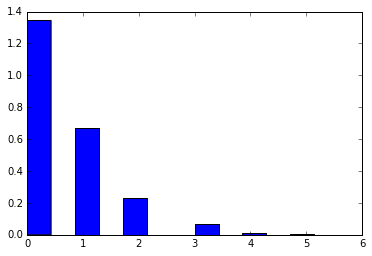

0
2
1
0
0
2
0
2
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
2
0
0
1
0
2
0
0
0
1
1
1
0
2
0
1
1
0
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
0
0
0
0
1
0
0
0
0
1
0
2
0
1
1
0
1
2
0
0
1
0
0
1
2
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
1
2
1
0
0
2
0
1
1
0
0
3
0
0
1
1
1
0
5
3
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4
2
0
0
1
0
1
2
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
2
2
3
0
0
0
0
1
0
0
0
1
2
0
0
1
0
0
2
1
1
0
0
0
0
0
0
0
2
0
0
0
1
0
1
1
0
2
0
1
1
1
1
2
0
1
0
1
1
0
1
0
0
0
0
1
0
0
1
0
1
5
0
0
1
0
0
0
0
0
0
2
0
2
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
3
2
2
0
0
0
0
0
3
3
0
1
6
0
1
0
0
0
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
1
2
0
0
1
0
0
2
0
2
0
1
1
1
0
1
2
2
0
0
1
2
4
2
0
0
1
0
0
1
0
2
1
0
1
2
1
2
0
0
1
0
1
0
0
0
2
1
2
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
1
1
0
2
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
2
1
0
1
0
1
0
1
0
2
1
1
0
1
1
0
0
1
0
0
0
1
0
0
1
1
0
2
1
0
1
0
0
0
0
0
0
0
1
0
1
2
0
1
1
2
0
1
3
3
0
2
2
2
1
0
2
0
1
1
1
0
0
1
1
0
1
0
0
3
1
0
2


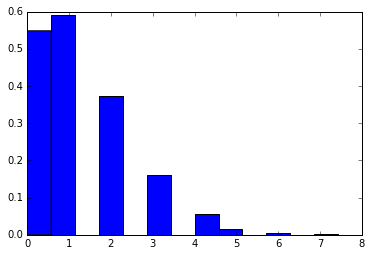

0
0
1
0
1
0
3
1
1
3
2
0
5
0
1
1
3
1
1
2
1
4
1
0
3
1
3
2
1
0
2
2
1
2
2
1
1
0
0
1
0
1
2
1
0
2
4
1
0
2
1
1
1
3
1
2
1
0
0
2
0
1
0
0
1
1
1
0
2
2
1
0
1
1
1
1
3
0
1
4
1
0
2
0
0
2
3
2
0
0
2
1
1
0
1
1
0
2
0
2
1
2
1
0
0
1
1
1
1
0
0
2
1
0
1
0
1
0
2
2
1
0
1
3
0
0
2
2
2
0
0
2
1
0
0
0
3
2
0
1
0
0
1
1
1
1
0
0
1
0
2
2
0
1
1
1
4
0
1
0
1
1
1
0
1
0
0
0
1
1
4
1
5
1
1
0
1
2
0
2
1
1
0
1
1
3
2
0
0
2
0
3
2
0
3
1
0
1
2
0
2
3
1
2
4
1
0
2
2
0
1
2
1
1
2
0
0
0
0
2
0
2
2
0
0
0
1
0
0
0
3
1
2
2
2
0
0
0
2
0
5
1
2
5
3
0
1
3
0
0
1
1
4
3
1
3
1
1
1
2
1
3
1
1
1
3
2
3
4
0
4
3
1
0
3
1
1
0
1
1
1
1
0
1
2
1
1
1
0
1
0
1
0
0
0
2
3
2
0
0
1
0
0
1
1
1
1
1
1
0
3
2
5
1
0
1
0
4
3
1
1
1
1
0
0
2
2
1
0
2
2
3
0
2
2
2
0
0
0
1
1
2
1
1
0
0
1
1
2
1
4
1
0
0
0
0
1
0
5
2
3
1
1
0
3
2
1
1
1
0
1
0
0
1
0
0
1
0
4
3
2
1
1
0
0
0
0
0
1
0
0
1
0
0
0
2
3
3
0
1
0
0
0
1
2
0
0
3
2
2
1
1
3
1
4
1
3
2
0
1
2
0
0
1
0
0
0
0
1
0
1
0
0
1
1
1
2
0
1
3
4
1
3
1
2
3
2
1
0
0
1
1
0
4
1
3
1
1
1
2
0
0
1
0
0
2
0
1
0
2
0
1
0
1
0
3
2
4
0
2
2
2
0
3
1
1
0
0
1
0
2
1
1
0
0
2
2
1
1
2


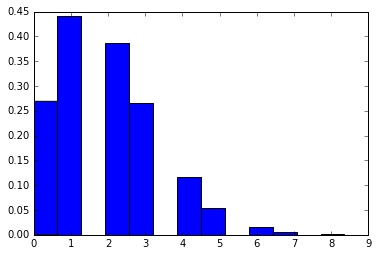

2
2
0
6
3
0
4
1
3
0
1
4
1
1
2
2
2
2
0
3
1
2
2
5
3
6
2
1
3
4
2
3
2
0
2
1
1
0
5
1
0
4
1
3
1
2
3
1
4
2
2
2
3
2
1
1
3
3
4
3
4
1
1
3
0
3
4
0
3
3
3
1
1
1
4
1
0
3
0
2
2
3
2
3
0
3
4
6
1
3
4
1
5
0
1
2
3
2
1
3
2
1
0
3
1
0
2
4
1
2
1
3
3
1
2
1
3
3
1
2
1
1
3
2
2
0
1
1
0
3
3
3
1
1
1
2
1
1
2
1
0
2
2
1
1
2
1
1
3
2
1
1
1
1
1
4
3
3
2
2
3
2
3
3
2
1
1
2
1
1
0
3
1
5
4
5
3
1
5
2
2
4
3
3
1
2
5
0
5
2
2
6
1
1
4
4
3
1
1
2
0
0
0
1
4
1
1
0
3
3
4
1
1
0
1
1
2
1
4
3
2
1
1
1
0
1
1
3
5
0
0
0
0
0
1
1
1
1
2
1
3
6
0
6
2
3
1
4
1
0
0
1
2
3
1
1
3
4
0
1
0
0
1
0
1
5
3
3
1
5
0
1
3
2
2
0
1
0
4
0
2
2
1
1
0
1
1
1
1
2
0
1
0
2
2
5
4
2
2
1
1
3
1
2
1
2
2
0
2
2
5
3
2
1
4
4
4
1
0
3
2
3
2
1
2
2
5
2
2
1
1
1
2
0
0
1
0
2
2
1
2
1
1
4
0
1
1
0
6
1
3
1
3
2
2
3
0
1
2
0
2
1
2
0
1
3
2
2
1
3
3
3
1
1
2
0
1
4
2
2
1
2
1
3
1
2
2
1
6
2
1
0
7
1
2
1
3
2
1
3
3
1
3
2
3
3
2
4
2
2
1
5
0
3
4
2
2
1
2
2
2
1
5
2
1
0
3
1
4
3
2
1
1
2
3
1
4
3
2
3
1
6
3
5
2
2
1
2
0
2
3
2
3
0
3
2
4
2
2
0
0
3
1
6
0
1
3
0
2
1
0
1
2
1
3
2
3
2
1
3
3
1
2
0
1
2
0
2
2
0
5
0
2
1
2
0
2
1
6
2


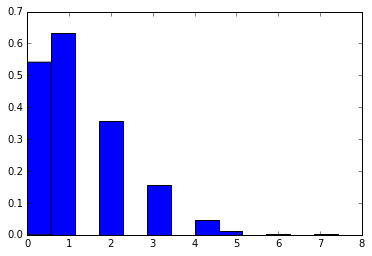

1
0
1
0
1
2
1
1
4
1
1
0
0
1
0
2
4
2
0
2
1
1
0
1
0
3
1
4
1
0
0
2
0
0
1
0
1
3
2
2
1
1
0
0
1
2
2
1
1
3
1
0
0
0
1
1
1
0
1
0
2
2
1
3
0
1
2
2
1
1
1
1
2
2
0
0
0
0
6
2
4
0
0
1
3
0
3
1
0
0
1
3
0
0
0
0
0
3
1
0
2
1
2
2
1
1
1
1
1
2
0
2
2
4
0
0
0
1
3
0
1
3
1
0
3
0
1
0
3
2
1
3
3
0
1
0
2
0
0
0
0
0
1
1
0
2
2
2
2
0
3
0
0
0
2
1
1
1
0
0
1
2
1
0
1
0
1
2
1
0
1
1
5
1
2
0
1
1
0
1
2
1
1
1
1
1
1
1
1
1
0
1
2
2
0
0
2
2
2
1
1
0
3
1
0
0
0
2
1
1
1
2
1
3
2
0
1
6
3
1
1
0
2
2
1
3
1
1
1
0
0
1
0
0
1
0
3
1
1
0
3
0
1
0
0
1
1
0
0
3
0
1
2
1
3
1
1
2
0
1
3
1
1
0
2
3
3
0
2
2
3
1
2
3
2
1
0
2
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
2
2
5
0
3
3
1
1
3
0
1
2
2
3
2
2
3
1
1
0
3
1
2
1
3
0
1
0
1
0
3
1
1
3
0
0
0
0
0
2
3
2
1
2
0
1
1
1
1
0
1
0
1
1
2
3
1
4
0
5
0
4
0
1
2
1
1
1
3
2
1
1
0
1
1
2
2
0
0
0
0
2
2
0
0
0
1
1
1
2
1
1
3
1
0
2
3
2
0
2
1
2
0
0
0
2
2
1
1
2
0
2
0
2
5
2
1
1
2
2
0
2
2
1
1
0
2
1
1
2
0
0
1
1
0
1
3
1
1
1
0
0
2
1
1
1
3
0
0
0
1
0
2
0
3
3
4
0
0
0
1
0
0
1
5
1
2
2
3
1
0
2
2
2
3
1
1
1
2
3
1
1
4
1
0
2
2
2
2
0
2
1
1
1
0
1
3
0
0
0
2
3
2
4
0
1
0


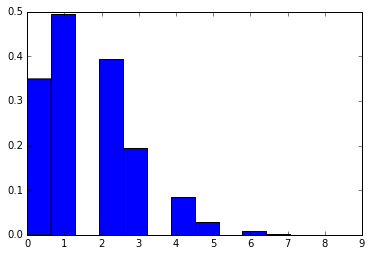

2
4
2
1
1
1
0
1
2
5
1
0
3
0
0
0
1
2
3
2
2
5
5
2
2
1
1
1
0
0
0
2
0
0
0
0
0
3
0
4
2
2
3
5
3
1
3
1
1
1
0
1
2
1
5
1
1
3
1
3
1
1
0
3
1
2
1
1
3
1
2
1
1
1
4
1
1
1
1
0
0
1
0
2
3
3
7
4
1
1
2
3
0
0
1
1
2
3
1
0
3
1
1
1
1
1
2
1
2
1
3
4
1
5
2
0
0
1
2
2
0
3
0
2
0
0
1
2
4
0
0
1
2
4
0
1
5
2
1
2
1
0
1
1
2
2
1
1
2
0
2
4
0
0
2
3
1
4
2
1
1
3
1
2
1
4
3
4
1
1
2
2
2
2
2
1
1
3
2
1
0
1
3
1
1
1
1
2
0
2
2
1
0
5
1
3
4
0
0
2
2
1
1
1
1
2
0
2
1
1
0
1
3
2
4
2
1
1
0
2
1
0
2
0
2
3
2
0
2
1
0
1
2
4
4
1
1
1
0
0
1
8
2
0
3
4
1
1
0
0
0
1
4
0
2
0
2
1
3
1
2
1
4
1
1
1
2
1
0
1
2
1
1
1
0
1
0
1
0
1
2
3
2
0
1
1
0
0
0
2
0
1
2
0
1
1
3
1
1
0
2
2
0
0
2
0
2
6
3
5
3
0
1
1
2
2
2
1
1
0
1
2
5
2
2
2
4
3
0
1
0
0
2
0
1
0
0
2
3
1
1
2
0
1
1
1
1
2
1
2
0
0
1
3
4
2
0
1
1
2
2
4
0
1
1
1
2
2
3
1
0
1
0
2
0
0
0
0
2
2
0
1
2
0
2
2
1
6
1
3
0
0
2
2
1
0
0
0
2
1
0
1
1
1
1
1
2
0
1
1
2
1
0
8
3
2
3
2
4
7
1
5
3
4
4
2
4
0
3
3
1
1
0
1
3
1
3
1
1
2
1
2
1
2
2
5
0
0
5
1
4
3
1
1
2
1
1
0
3
0
1
3
5
2
1
4
1
4
3
2
0
4
1
2
1
1
1
0
4
2
2
0
1
1
1
0
3
2
0
1
0
0
0
1
2
1
3
2
4
0


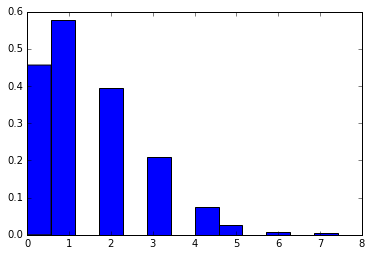

0
1
0
2
2
2
2
0
3
2
0
2
1
1
0
0
0
3
1
1
2
0
3
3
3
0
1
0
1
3
1
0
4
2
1
1
0
1
1
0
0
0
2
0
3
2
4
2
2
0
1
4
3
1
2
0
3
3
2
2
1
1
1
3
0
1
0
1
2
1
1
0
2
4
5
0
4
1
1
0
0
1
0
0
2
2
3
3
3
2
0
1
3
0
1
4
0
0
0
0
1
4
1
2
1
0
0
0
3
3
4
3
1
3
3
3
3
0
2
2
0
2
0
0
0
0
0
1
0
1
0
0
0
1
0
0
1
1
1
4
1
1
2
1
1
1
1
0
1
1
3
2
0
0
1
4
3
3
3
2
3
2
2
0
1
1
2
1
1
1
2
3
1
1
2
0
2
1
1
2
1
1
0
1
3
1
0
3
0
0
1
1
1
1
1
0
1
3
0
2
1
1
2
0
3
2
2
7
2
1
0
0
0
0
0
3
0
0
0
1
2
5
2
1
0
0
2
1
0
1
1
2
0
0
3
3
3
2
2
4
2
1
2
2
0
2
2
1
0
2
1
0
1
1
4
1
0
1
2
1
0
2
0
4
0
1
3
1
1
3
3
6
2
3
5
1
1
3
0
4
0
2
2
0
1
0
1
1
1
0
0
0
0
1
2
2
2
3
2
0
1
1
2
0
2
0
1
1
1
3
6
2
2
1
2
2
3
2
2
0
0
2
0
1
0
1
2
2
1
3
0
2
2
0
0
5
2
0
3
0
3
0
3
1
0
1
2
3
0
1
0
0
2
1
0
1
3
0
0
3
2
1
3
1
5
2
1
2
0
1
1
1
1
1
1
0
0
1
2
0
2
1
0
1
2
0
0
2
0
0
1
2
2
1
0
2
0
1
1
5
1
1
0
2
1
0
1
0
0
0
1
1
5
4
5
1
2
2
2
3
1
1
1
3
1
2
2
1
1
2
3
0
1
2
1
2
1
0
0
1
2
1
0
2
3
1
1
6
1
0
1
2
2
2
2
1
1
0
1
0
1
1
0
1
3
1
0
4
1
2
1
2
1
3
1
2
1
5
0
3
2
5
1
1
1
2
2
1
2
2
3
2
3
2
0
2
3
1
1
0


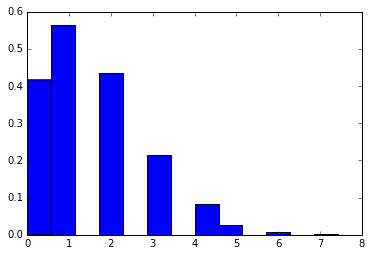

0
0
1
1
0
4
0
1
2
1
1
1
1
1
2
1
3
0
2
2
0
0
1
0
1
2
1
3
4
2
1
1
0
0
1
2
0
1
0
0
1
3
1
2
2
2
4
1
2
3
0
1
0
2
0
4
4
4
1
2
0
3
3
0
2
0
0
2
1
2
1
0
3
3
2
0
1
1
3
2
2
0
2
1
1
1
2
2
0
3
2
3
2
1
1
2
2
0
1
0
1
1
1
0
4
1
4
2
4
3
2
2
3
1
0
0
3
3
2
0
2
1
0
1
4
0
2
1
1
3
1
2
2
0
1
1
2
0
2
3
1
2
2
1
2
0
2
1
2
1
1
1
1
1
0
0
0
2
0
0
3
1
0
1
1
1
5
0
0
2
4
3
3
3
2
3
1
1
2
2
2
1
2
1
0
0
3
1
1
3
1
2
0
3
0
0
3
1
2
3
2
2
1
1
1
1
3
1
4
0
0
0
0
0
1
1
1
1
4
3
1
1
1
2
0
1
0
3
1
2
1
2
3
2
0
2
2
2
1
0
1
1
1
1
0
0
1
3
0
1
0
0
1
2
1
2
0
0
3
0
1
1
3
5
2
1
0
2
0
2
2
0
2
0
1
3
4
0
3
1
1
0
3
0
1
0
0
0
1
0
0
0
1
0
0
2
1
2
1
0
1
0
1
5
4
5
3
1
5
3
1
1
0
1
1
0
2
2
1
1
2
3
1
2
1
0
1
0
2
1
0
0
3
1
1
1
1
4
1
1
3
2
0
0
1
2
2
1
2
0
0
2
1
2
1
1
0
1
3
0
5
2
1
2
2
1
2
2
0
2
1
1
1
1
1
1
3
1
2
1
1
0
0
4
2
2
1
1
1
1
3
3
3
4
2
1
0
1
2
0
2
1
3
0
0
0
2
3
1
3
1
3
1
0
2
0
2
0
2
1
2
1
1
1
1
1
0
1
3
1
0
0
2
1
3
3
1
1
0
2
1
3
0
3
1
1
2
3
0
2
0
0
2
0
2
1
1
0
2
5
1
2
2
0
0
2
3
2
3
3
2
1
4
1
3
1
2
3
1
0
3
1
1
0
2
1
1
0
2
0
0
3
0
1
4
2
3
2
2
2


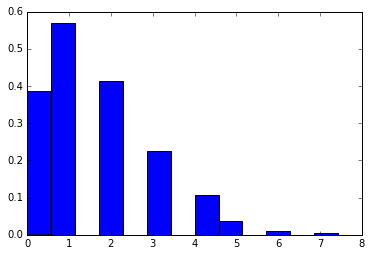

1
2
3
2
0
0
0
2
2
2
0
5
0
3
0
1
1
0
0
0
1
4
2
4
2
0
1
1
1
1
1
2
1
3
1
0
1
1
1
1
2
3
1
1
1
4
0
1
3
2
0
2
3
2
0
1
2
1
2
0
1
0
1
2
4
0
3
3
1
2
1
3
2
0
1
2
1
1
3
1
0
1
3
2
2
0
1
0
2
2
2
0
3
1
1
0
0
0
2
1
2
3
2
1
1
1
6
1
3
2
1
3
1
3
1
3
1
1
0
1
1
4
1
0
1
1
1
1
2
1
5
3
4
2
0
3
3
0
3
1
2
3
0
2
1
4
0
2
0
0
1
0
1
1
1
6
1
1
2
1
2
1
1
1
1
0
2
1
1
0
2
0
3
2
4
1
1
1
1
0
2
1
0
1
0
1
0
1
1
2
1
0
0
1
5
0
1
2
2
2
2
2
0
2
0
0
0
2
2
2
0
4
2
0
2
3
1
1
3
1
2
1
2
1
1
2
2
1
1
1
4
1
2
0
1
2
3
1
1
1
2
2
1
2
2
5
1
2
2
1
1
1
2
3
3
3
2
1
0
2
1
0
2
0
3
3
1
1
6
2
1
3
0
0
3
2
2
2
1
1
1
0
1
1
3
1
5
1
1
0
1
2
1
0
1
2
1
5
0
3
2
0
1
1
2
0
2
4
3
3
1
1
1
1
1
0
2
0
2
5
2
3
1
2
1
4
0
0
1
0
1
0
3
0
2
0
0
3
1
2
0
4
3
0
1
3
1
0
2
2
2
0
3
5
2
3
2
1
1
3
3
1
1
2
0
2
1
4
1
2
0
3
0
2
2
0
1
3
3
2
0
1
0
3
1
5
3
2
1
4
5
2
3
2
1
0
3
3
2
1
0
1
0
0
2
1
2
3
2
1
3
1
1
0
4
2
3
5
1
1
1
1
3
0
3
1
4
0
2
3
1
1
0
2
3
2
1
0
1
2
1
2
3
0
1
0
1
0
2
2
2
1
7
1
1
2
2
0
4
2
3
3
2
0
2
0
1
1
0
2
2
2
1
2
1
0
2
4
4
2
4
1
2
0
2
2
1
4
1
1
3
0
0
2
3
5
0
2
0
1


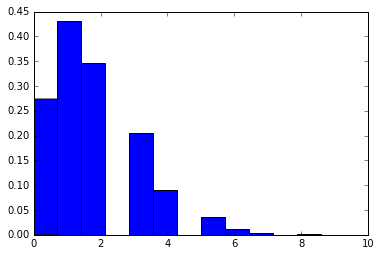

1
6
0
1
1
2
0
0
3
2
0
0
2
1
0
1
1
4
4
1
3
1
0
2
2
0
2
3
4
3
1
1
3
0
2
0
1
2
0
3
3
3
3
1
0
2
2
2
3
0
3
1
3
1
3
3
2
3
5
0
2
0
5
5
3
3
2
1
1
2
1
4
3
3
0
1
1
4
3
0
2
0
0
1
2
2
3
2
1
5
0
3
4
1
0
2
0
0
1
0
2
2
2
3
2
0
4
1
4
0
3
5
0
1
1
2
8
1
2
1
1
1
1
0
1
1
1
2
0
1
2
3
0
1
1
0
2
2
1
2
1
3
2
2
2
0
0
0
0
1
0
1
1
0
1
1
0
1
2
1
0
0
2
0
1
1
3
1
1
3
4
1
4
1
2
3
1
4
1
3
1
3
4
2
3
4
1
3
2
1
2
1
2
0
3
2
0
2
0
3
0
2
3
2
2
1
0
2
2
2
0
0
1
0
3
0
1
1
0
2
2
2
2
2
2
1
5
0
0
2
1
2
1
2
0
2
2
3
1
1
4
1
2
2
2
4
1
0
4
2
3
2
3
3
4
5
0
2
1
1
5
2
1
1
0
1
1
4
2
2
2
1
1
0
1
3
3
2
3
0
2
1
1
1
1
1
3
3
1
0
1
2
3
1
1
2
2
1
0
1
0
4
0
0
4
2
1
2
2
0
0
1
3
5
2
0
1
2
2
5
1
1
2
0
3
1
2
0
1
1
2
2
1
1
1
0
3
4
0
3
2
1
2
2
2
4
2
1
0
2
1
3
6
1
0
1
4
2
2
1
5
3
1
2
1
6
4
1
2
1
0
3
2
0
2
0
1
2
0
0
1
0
2
1
1
4
0
1
1
1
1
4
2
3
4
2
1
2
0
1
3
2
0
3
0
3
1
0
2
0
3
2
3
1
1
0
2
2
2
2
2
1
4
0
1
1
3
1
1
1
2
2
3
1
2
1
0
3
2
3
0
4
1
0
2
2
3
1
1
2
1
1
1
1
0
0
4
1
0
0
0
2
0
2
1
2
3
1
2
1
3
2
0
1
3
2
2
2
4
2
0
1
2
2
1
0
4
0
1
2
0
2
2
0
1
3
3
3
1
2


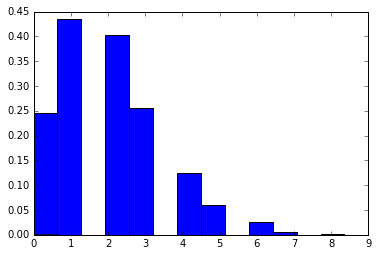

2
0
1
0
3
0
3
2
2
2
1
2
1
1
3
2
3
4
2
2
3
2
2
1
3
5
3
0
0
0
2
1
0
3
3
2
2
5
1
1
2
3
0
4
0
3
2
0
2
3
1
1
2
3
4
1
3
1
2
1
0
7
3
0
3
0
1
0
2
2
4
3
3
0
4
0
2
2
4
4
3
0
2
1
4
2
3
0
0
1
1
1
1
2
1
3
2
0
0
5
4
3
3
1
2
1
3
3
3
3
2
5
2
4
4
2
0
2
0
0
0
5
2
1
2
1
1
2
1
4
2
0
2
3
0
1
5
3
2
1
4
1
1
0
0
0
1
1
1
1
1
1
1
5
3
2
2
1
4
3
0
0
1
0
2
4
0
0
2
1
1
5
4
2
3
2
2
2
3
2
1
1
1
3
5
3
2
1
6
3
3
2
0
2
2
1
2
3
3
2
3
4
0
1
0
3
3
4
4
0
1
2
1
2
2
1
2
2
2
4
1
1
2
1
2
2
3
1
2
0
0
0
2
3
2
1
3
2
0
1
3
2
1
1
1
2
0
1
0
0
0
2
2
5
1
0
6
3
2
2
1
5
1
1
3
0
3
2
1
4
1
1
1
0
0
2
1
0
0
1
4
0
1
2
2
1
2
4
0
0
3
1
0
0
1
2
3
0
3
0
0
0
3
3
4
1
1
4
5
4
2
3
1
5
4
1
1
2
2
1
5
3
0
0
3
2
2
3
3
3
2
1
3
0
0
1
2
4
0
3
1
3
2
1
0
6
3
3
0
2
2
2
3
1
0
2
0
0
2
1
0
5
0
1
0
4
2
6
3
4
1
1
3
2
0
5
3
2
4
4
6
1
2
0
3
2
2
2
4
1
2
6
2
1
1
3
2
1
5
2
5
0
0
1
2
1
2
2
1
0
1
1
2
6
3
2
0
4
3
0
2
1
5
4
2
2
4
0
0
2
1
1
3
2
2
2
0
1
1
1
4
4
6
0
0
4
4
2
1
1
1
3
3
0
4
0
1
1
2
3
2
1
3
3
1
1
1
1
2
2
1
0
0
3
0
3
3
4
3
4
4
4
3
1
5
5
2
0
4
2
3
2
1
5
2
2
2
0
1
3


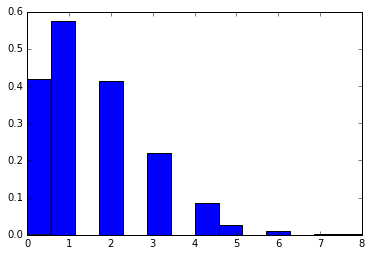

0
1
0
1
1
1
1
1
2
0
2
3
3
2
2
3
4
0
3
0
3
6
0
0
2
2
0
4
0
1
1
1
1
0
1
3
1
0
1
0
0
2
3
0
3
2
0
2
1
3
3
4
4
1
2
0
3
2
2
1
3
1
1
0
0
0
0
3
1
2
0
5
2
1
0
0
1
1
3
2
2
2
2
4
0
1
0
1
1
0
0
1
2
2
1
0
3
3
0
0
0
2
0
0
0
3
2
2
1
3
1
8
3
3
2
2
2
1
0
1
0
0
0
2
0
3
1
1
3
1
2
4
3
1
0
2
1
0
0
1
0
1
1
3
0
3
2
2
1
2
1
2
0
3
2
4
3
0
4
2
3
3
4
2
0
2
3
1
0
4
3
3
2
1
1
2
1
0
0
4
1
1
1
1
2
1
1
1
0
0
4
2
1
2
1
1
0
1
1
2
3
1
1
1
1
0
2
1
1
0
2
0
3
3
1
4
5
3
3
1
3
0
0
1
3
2
3
1
2
0
0
1
3
2
2
0
3
2
0
0
1
2
4
4
1
2
1
1
1
1
2
1
1
2
1
1
2
0
2
3
3
2
1
0
4
1
1
1
1
1
1
1
1
2
3
0
1
4
4
1
1
2
0
1
1
0
0
2
0
2
0
1
0
0
0
2
2
2
3
3
1
2
1
0
2
1
3
3
1
8
2
3
1
5
2
2
0
0
2
3
0
1
0
3
0
1
3
1
0
3
3
0
1
1
0
1
1
1
1
1
2
0
2
1
1
1
3
2
0
1
3
2
0
3
6
0
3
4
1
1
2
3
1
0
6
2
2
2
1
3
1
0
1
0
2
3
2
4
1
0
1
0
1
4
0
0
0
1
1
2
1
0
0
2
2
1
0
2
2
0
1
0
1
0
3
1
1
4
1
2
0
4
3
0
1
1
4
5
0
0
1
1
1
0
0
0
2
1
2
1
2
3
1
3
0
3
0
2
1
1
4
0
2
1
2
1
0
3
1
3
1
0
1
0
1
2
2
0
3
3
0
1
0
2
3
1
1
2
0
1
0
3
1
2
2
3
1
2
2
0
1
3
2
1
0
1
1
1
1
1
1
0
0
2
2
0
3
2
1
1


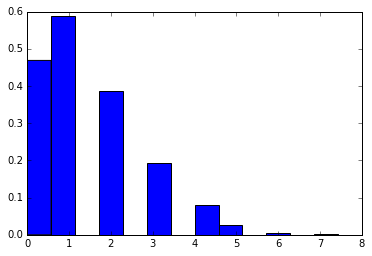

2
6
0
3
3
1
3
0
0
0
1
0
4
1
1
2
0
1
1
1
2
0
0
1
4
2
2
2
2
1
1
2
1
0
0
3
2
2
0
0
0
1
2
1
0
0
3
0
4
2
4
1
2
3
0
3
2
3
0
6
2
1
0
0
2
2
2
2
0
0
1
0
1
1
1
1
2
0
1
4
2
0
1
2
1
2
0
1
5
0
1
4
0
1
1
2
0
1
1
1
0
1
1
1
0
0
1
1
2
3
4
1
0
1
4
1
2
0
3
1
1
3
0
0
2
2
1
1
0
2
1
3
1
0
0
0
0
1
1
3
1
1
1
0
0
2
1
0
1
0
3
1
1
1
1
2
2
1
2
0
0
3
2
1
2
2
3
1
0
4
1
0
1
2
2
1
1
1
1
0
0
0
1
0
0
1
2
1
0
0
1
2
1
0
3
3
2
2
1
1
0
0
0
4
1
2
3
2
2
0
0
3
1
0
1
0
1
1
2
2
3
0
1
2
0
2
0
0
0
0
5
0
1
2
2
2
0
2
3
4
2
4
4
2
0
1
4
2
0
1
3
1
0
0
0
1
0
0
1
0
1
0
0
1
0
3
0
2
2
2
1
1
2
0
1
1
1
0
0
0
2
2
0
0
1
3
0
0
1
1
0
0
0
0
0
1
3
1
1
0
0
1
0
3
1
0
2
1
2
2
2
2
2
2
0
3
2
5
1
1
0
1
2
1
2
0
3
2
1
5
1
2
1
1
2
0
2
0
2
1
0
2
1
1
1
3
2
1
1
2
0
0
0
2
0
3
1
3
3
0
2
2
1
3
1
1
1
2
5
1
1
2
0
1
0
1
0
2
0
1
3
3
2
4
2
1
2
1
0
1
2
2
1
1
0
3
1
0
1
0
0
1
1
1
4
3
0
2
0
2
1
2
1
2
2
1
0
2
3
3
0
2
1
0
4
2
1
2
1
0
3
1
1
0
2
0
1
0
4
3
2
5
3
4
2
0
2
2
4
0
3
1
2
2
0
1
8
2
2
2
1
1
0
0
1
1
0
3
2
3
1
4
1
0
5
3
4
1
2
0
1
1
2
0
0
3
3
0
4
2
1
1
3
0
0
0
1
0
2
1


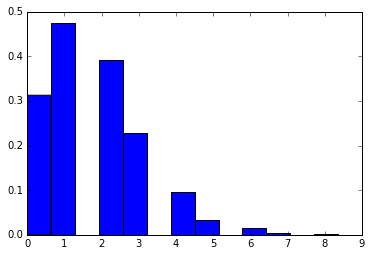

2
2
1
2
1
0
1
0
1
0
1
4
2
2
3
1
0
0
3
2
2
1
1
5
3
1
2
5
3
4
3
2
3
2
3
3
0
2
0
1
1
2
1
2
3
3
2
0
3
1
1
0
1
3
2
3
0
1
0
0
1
2
3
1
1
2
4
1
1
1
0
4
3
1
0
4
2
0
1
3
1
1
4
2
1
3
2
1
1
3
4
1
2
1
3
0
1
1
1
1
2
4
3
2
1
1
0
3
0
1
1
1
0
1
1
1
2
2
2
0
1
2
0
2
0
3
1
3
1
2
3
1
1
2
1
0
1
0
0
2
2
1
0
3
2
0
2
4
4
2
0
4
2
2
0
1
2
4
1
1
2
1
1
2
1
0
2
2
1
4
4
2
1
0
2
4
2
3
2
1
2
2
3
3
2
0
3
2
3
0
3
2
2
1
2
2
0
2
1
1
0
0
0
0
3
2
1
3
1
0
1
3
2
2
1
1
1
1
1
2
0
1
3
1
0
1
2
1
4
1
2
0
1
5
1
3
3
5
1
2
1
0
1
2
2
3
2
0
0
0
0
0
2
1
2
0
3
0
3
5
1
2
1
1
2
0
0
1
2
0
1
1
0
2
1
4
7
2
2
0
0
1
1
0
1
0
0
3
1
1
1
2
1
2
2
3
0
2
3
4
1
2
0
0
1
2
1
0
3
4
0
1
3
4
1
2
0
1
2
1
2
0
1
2
1
0
2
0
0
1
1
1
1
0
0
0
1
2
1
1
0
3
4
1
0
4
3
2
3
4
0
4
1
1
0
3
2
4
0
3
3
3
2
3
1
3
2
2
1
2
1
1
2
3
0
0
2
0
1
0
0
4
3
1
0
2
2
1
1
0
1
2
5
1
3
2
0
1
2
0
0
5
2
2
0
0
0
4
0
3
5
2
2
1
1
2
4
5
0
1
2
1
1
0
3
1
2
2
5
1
0
0
2
3
3
1
1
2
1
1
3
1
1
0
1
2
2
1
2
2
1
4
4
2
2
1
1
1
1
4
0
1
3
1
2
1
3
5
1
1
1
2
1
6
0
4
1
2
2
1
1
1
2
1
0
2
1
2
2
1
2
0
1
2
2
0
2
1
1
1


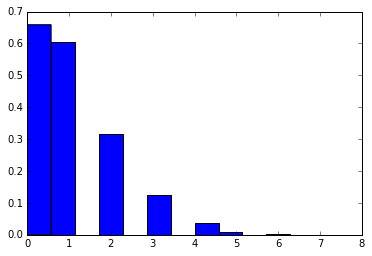

1
1
0
0
1
0
0
0
0
1
1
0
1
0
1
0
3
1
1
1
0
1
1
0
1
1
0
2
0
2
0
0
2
0
2
2
1
0
1
0
0
2
0
1
3
4
3
1
1
1
2
2
0
0
0
3
0
0
0
1
1
1
0
1
2
3
1
2
2
4
4
2
2
3
2
2
3
1
0
0
1
1
0
0
1
0
1
0
3
1
4
0
1
0
2
1
0
2
1
1
1
2
1
0
0
1
1
3
0
0
1
3
3
3
2
1
2
0
1
1
0
2
0
1
3
1
0
0
1
0
0
1
2
0
0
0
1
1
0
1
2
0
0
1
0
2
3
1
1
1
0
1
0
1
1
1
3
1
0
1
1
1
0
2
1
1
1
2
0
0
1
1
1
0
2
0
1
1
0
0
2
0
0
0
3
1
0
1
3
2
2
1
2
0
0
2
0
2
2
0
0
0
2
0
0
1
0
0
0
0
3
1
1
1
2
0
3
2
1
1
1
1
2
1
5
1
0
1
1
2
0
1
0
4
1
1
0
3
4
2
4
2
2
3
1
2
2
0
0
2
0
0
0
0
0
0
4
2
0
2
0
0
1
2
3
0
1
0
0
4
1
2
1
0
0
2
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
1
0
0
0
5
0
1
1
0
0
1
0
0
0
0
1
1
1
3
1
0
2
0
0
1
0
1
0
2
0
0
1
1
1
1
0
0
0
1
1
1
1
1
0
1
3
2
4
1
2
1
2
1
3
3
2
1
1
2
0
1
1
2
3
0
1
1
1
1
2
0
2
1
2
1
2
1
2
0
0
1
3
0
0
1
1
1
0
1
1
2
1
2
0
2
0
0
1
1
1
4
1
0
2
4
0
1
1
0
1
1
1
3
1
4
1
2
2
3
0
1
1
1
0
0
5
1
0
1
0
1
1
0
1
2
2
1
0
0
1
0
4
1
0
4
4
1
0
1
5
2
2
0
1
3
0
2
2
3
1
1
1
1
2
0
2
1
1
0
1
1
1
0
1
2
1
2
2
2
2
1
2
1
1
2
2
2
3
0
1
0
2
2
0
0
2
1
1
1
2
0
2
1
3
1
1
0
0
0


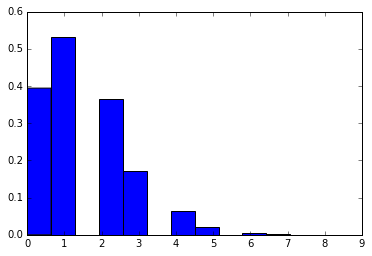

1
1
1
0
1
1
1
2
2
3
0
1
0
1
1
1
0
0
2
1
1
1
0
2
3
2
3
0
3
3
2
0
0
3
2
2
3
1
1
3
1
3
1
0
1
2
3
1
2
3
2
1
1
4
0
2
0
1
2
1
2
0
2
1
1
3
2
1
4
3
0
3
1
3
1
1
2
2
3
1
1
2
2
4
2
0
2
0
0
4
1
1
0
2
0
1
1
1
1
0
2
3
0
3
1
3
1
2
2
1
1
0
1
2
1
1
0
1
1
0
0
1
0
0
1
2
1
3
1
2
1
1
3
1
1
2
0
3
1
1
0
2
3
1
1
0
0
1
1
2
0
0
0
0
1
2
0
0
1
0
4
4
1
1
1
2
1
1
1
2
1
1
2
2
0
2
2
0
1
2
0
2
0
2
0
0
1
2
3
2
0
1
2
1
4
1
1
2
3
1
2
1
1
1
1
1
0
0
3
0
0
1
0
1
1
4
2
1
1
0
1
0
1
3
0
3
1
3
1
1
2
3
0
2
1
2
2
0
1
1
2
1
1
1
5
2
1
1
1
0
0
1
0
2
3
3
1
1
1
2
3
4
2
4
1
2
1
2
1
1
0
1
1
2
3
0
1
0
0
0
0
0
0
1
0
4
1
2
3
0
1
2
0
1
0
0
0
5
5
0
0
1
1
0
1
1
1
2
4
1
0
3
0
1
3
1
1
3
1
3
2
1
0
0
1
0
1
0
1
0
1
1
1
2
0
0
0
1
3
0
1
2
0
0
2
1
1
0
1
1
3
2
2
1
1
2
2
2
1
3
1
1
3
1
2
2
2
2
2
4
0
1
2
2
4
2
1
0
2
4
0
1
0
0
0
1
0
1
1
2
1
1
2
0
1
0
0
4
1
2
1
0
0
1
4
2
2
2
0
0
1
1
2
3
4
1
2
1
1
6
1
0
2
1
1
1
2
1
2
0
1
2
3
0
4
1
0
5
1
1
0
4
1
2
0
0
2
1
3
0
1
3
4
1
1
0
1
0
0
1
1
1
0
2
0
1
1
1
0
3
0
2
2
0
0
1
2
2
3
2
2
1
2
1
3
2
0
0
2
1
1
1
2
1
2
1
2
1
2
0


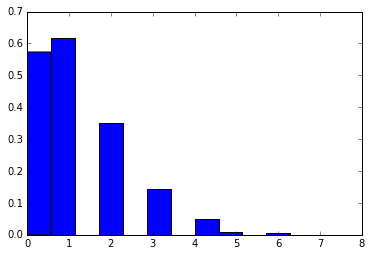

0
2
0
0
0
0
0
1
2
0
0
0
1
0
0
2
2
2
1
2
2
1
0
0
0
2
2
0
0
3
0
1
3
1
4
1
3
1
2
2
1
1
4
1
4
1
0
1
0
2
0
0
0
2
2
0
1
1
3
2
1
0
0
1
2
0
1
1
1
1
1
0
2
0
3
1
1
1
1
1
0
2
0
1
3
1
0
0
1
4
2
1
1
2
1
0
0
1
2
2
2
2
0
3
3
2
1
0
1
0
1
1
2
1
4
0
1
1
2
1
0
3
0
0
1
2
3
0
0
3
1
4
1
1
0
0
0
2
1
1
2
2
1
0
0
1
0
2
0
1
2
0
1
0
0
0
1
1
2
4
0
1
1
0
0
2
0
2
2
1
1
1
0
1
2
0
3
4
0
1
1
2
0
3
0
1
1
1
5
1
0
3
3
1
3
2
1
1
1
2
0
1
0
2
0
1
3
2
1
0
3
1
1
1
1
0
1
2
3
2
2
0
1
0
4
1
1
1
0
0
0
0
0
4
0
1
4
0
1
3
1
1
0
2
2
1
1
1
1
0
0
0
3
1
1
2
3
0
1
0
0
1
0
0
0
0
0
1
0
2
0
2
1
2
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
2
0
1
0
0
0
3
1
3
4
0
0
0
0
0
2
2
0
0
0
1
2
2
2
2
0
4
3
1
2
3
0
0
3
2
1
1
1
1
3
0
3
3
1
1
0
1
0
1
2
1
0
1
1
2
3
1
1
2
3
2
0
2
0
0
0
2
1
0
2
0
0
0
3
1
2
1
1
1
5
2
1
0
0
2
0
2
1
0
0
0
2
2
1
2
1
3
0
3
0
0
2
1
1
6
1
1
0
1
1
2
1
2
2
0
2
0
1
4
2
1
3
2
0
1
1
1
0
4
2
1
1
0
3
0
0
3
0
1
2
1
0
2
2
1
4
1
1
3
0
1
1
1
1
1
1
0
2
1
0
0
3
3
1
3
3
2
1
0
0
1
1
1
1
3
0
0
0
0
2
1
0
1
0
1
4
0
2
1
3
1
1
0
2
0
2
1
0
1
1
0
2
1
0
0
1
1
0
1
0
2


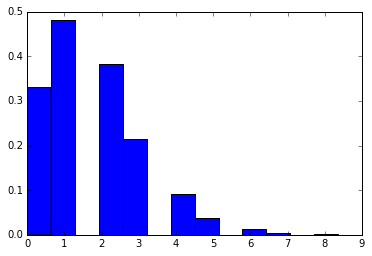

2
0
0
2
4
1
1
1
0
1
2
2
0
0
0
2
3
3
2
1
1
2
1
2
0
2
2
3
3
1
2
0
2
2
4
4
4
1
2
0
1
1
3
1
4
2
0
1
2
1
1
3
1
5
3
2
1
1
1
2
1
1
1
1
4
1
0
2
4
2
2
1
2
0
0
0
0
1
1
3
2
5
1
0
2
2
2
2
3
1
0
1
3
1
0
0
2
3
1
2
1
2
3
0
2
3
1
2
0
3
2
1
1
5
1
1
2
2
0
2
1
2
0
2
0
1
1
0
2
1
0
2
0
0
0
0
3
3
2
1
0
1
0
1
3
2
3
3
1
2
0
3
3
1
3
1
0
1
3
2
1
2
0
2
3
1
5
5
1
4
2
0
2
3
3
1
2
2
0
1
2
1
0
2
1
0
1
0
2
0
1
1
0
0
1
3
1
0
1
1
4
0
2
2
3
0
3
3
0
0
1
3
3
1
0
1
1
2
2
2
0
2
1
2
3
3
2
1
5
2
1
0
1
2
3
2
1
2
2
3
2
2
0
2
1
1
1
2
0
2
5
2
0
3
5
6
1
1
0
0
1
2
1
2
0
0
1
2
2
0
1
3
1
1
0
2
0
0
1
1
1
1
1
1
0
0
2
1
1
1
2
2
3
0
1
2
5
5
3
1
2
1
2
3
2
3
1
2
6
3
1
3
3
2
0
1
1
1
3
1
1
1
1
1
1
0
1
1
4
1
2
2
2
3
1
2
3
0
0
1
1
0
2
1
0
5
0
2
2
0
0
3
3
3
1
3
1
2
2
1
2
0
4
4
3
3
0
1
1
1
0
1
1
1
4
1
1
1
2
3
2
2
1
1
1
2
1
2
2
3
3
0
0
2
1
0
1
7
3
1
2
3
2
1
0
0
0
1
3
2
1
1
1
0
3
4
2
0
2
0
1
0
3
3
2
1
3
2
2
1
0
1
1
4
0
4
1
1
1
1
0
4
2
1
0
0
6
3
5
2
1
2
3
1
4
4
2
2
3
0
1
4
2
1
0
1
0
1
3
1
4
2
3
3
0
7
4
3
4
7
2
0
3
3
1
5
2
1
4
2
1
2
0
4
3
2
2
1
2
2


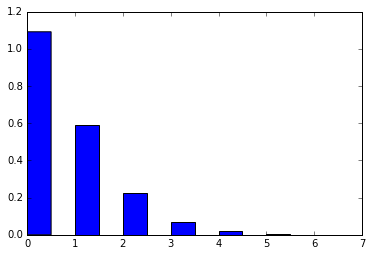

0
0
1
0
2
0
0
0
0
1
1
0
0
0
1
0
0
1
0
1
4
1
1
2
0
3
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
0
0
2
1
1
0
1
1
0
1
0
1
2
1
1
2
2
1
2
0
2
3
0
0
0
0
0
0
1
0
1
0
1
0
4
0
2
1
1
1
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
4
2
0
0
0
0
2
2
0
0
2
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
2
1
0
1
0
2
2
3
0
0
0
2
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
2
1
2
2
0
1
1
0
0
0
0
0
0
0
0
0
1
1
1
2
0
2
0
2
3
1
4
0
1
2
2
2
0
1
0
0
2
2
1
0
0
1
1
2
0
2
0
0
1
0
0
0
1
0
1
1
0
2
0
1
0
1
2
1
1
0
0
4
0
0
0
2
1
1
1
0
0
1
1
0
1
1
1
0
1
0
0
0
0
0
1
4
1
2
1
0
2
1
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
2
2
1
0
0
0
1
0
1
0
0
1
0
0
2
1
1
0
0
0
1
1
0
0
3
2
1
1
1
1
0
0
0
1
3
0
1
1
0
3
1
2
0
0
0
0
0
0
1
1
0
1
0
0
0
2
0
1
0
1
1
0
0
1
1
1
3
0
1
0
0
1
0
0
1
0
0
0
0
1
3
0
0
0
0
1
0
0
1
0
0
0
1
1
3
2
1
2
0
1
0
0
2
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
4
0
1
4
3
1
0
3
1
2
1
2
1
2
3
1
1
0
0
1
1
1
2
1
0
0
0
0
1
1
2
0
1
0
1
0
1
0
2
1
1
1
0
1
0
1
2
0
2
0
2
1
0
1
1
1
1
0
1
1
1
2
1
0
0
1
0
1
2
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0


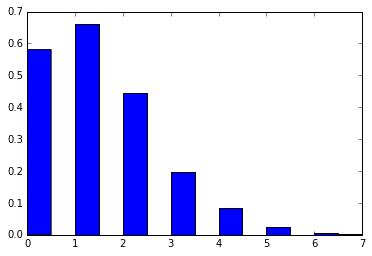

0
3
1
4
1
1
1
0
1
0
2
0
1
1
2
1
1
0
0
1
2
1
1
2
1
2
1
2
1
1
2
3
1
1
4
2
2
0
2
1
2
1
0
1
5
0
2
2
2
1
2
1
0
2
2
3
1
0
4
2
1
2
0
2
3
1
1
0
0
2
0
1
1
2
1
1
1
2
2
3
1
3
1
1
0
1
1
1
3
0
2
2
1
1
2
3
0
3
2
4
0
0
1
3
0
0
2
3
0
2
3
2
1
4
2
2
1
3
0
2
3
1
4
0
1
1
2
2
0
2
0
3
3
2
1
0
1
2
0
2
2
0
1
2
4
0
0
1
1
2
0
2
2
0
2
4
2
0
2
2
0
1
0
2
2
0
0
0
1
1
2
2
3
2
3
2
2
1
2
2
0
4
1
0
1
1
1
1
2
2
0
0
5
1
3
3
2
1
0
0
0
1
0
1
0
1
0
0
0
0
2
0
6
1
1
1
0
0
2
0
1
0
3
2
2
2
0
2
2
2
2
1
0
2
2
0
1
1
1
2
3
2
1
1
0
3
1
2
1
1
2
2
1
3
0
2
0
2
2
1
0
0
3
2
2
0
0
2
0
2
1
1
0
0
0
2
0
2
1
1
1
1
3
3
1
1
4
1
1
2
5
0
1
0
0
1
0
0
0
0
1
1
2
0
1
4
4
0
2
1
2
0
2
0
2
0
2
2
2
2
1
1
0
4
1
3
2
2
4
1
0
2
3
2
1
0
1
2
1
0
2
2
1
2
1
3
1
3
1
3
0
3
1
4
2
0
0
0
0
2
1
0
0
0
5
2
1
1
0
2
1
2
2
1
0
5
1
3
3
1
2
3
0
1
1
2
3
1
1
0
1
0
1
1
2
1
2
1
1
4
1
1
0
1
0
1
2
0
0
2
3
0
0
2
2
6
2
0
1
1
3
0
2
4
1
0
0
1
1
1
2
1
4
3
2
2
1
1
2
1
2
1
0
1
1
3
1
2
2
3
1
1
5
1
4
3
2
0
2
1
3
0
2
3
2
0
1
1
0
2
2
3
3
1
0
0
0
3
0
0
0
0
1
1
2
2
2
3
1
2
1
1
0
2
2
0
1
1
2
2


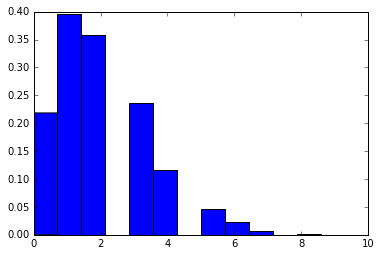

2
4
0
1
1
1
2
2
1
2
2
1
2
4
1
0
1
3
2
1
1
3
3
3
0
5
2
0
2
4
3
2
2
0
3
1
0
1
1
6
3
3
2
3
2
3
3
3
1
1
3
0
3
1
3
3
3
1
5
3
1
5
2
3
0
0
1
2
2
2
4
3
4
1
1
2
5
3
0
4
1
4
2
3
4
7
2
5
0
1
1
1
2
1
1
1
4
2
4
1
4
2
2
1
0
2
2
3
1
2
1
6
3
1
0
1
2
2
3
4
1
4
2
0
2
2
1
1
4
4
1
1
6
2
3
1
5
2
4
2
2
2
3
1
3
3
1
3
3
3
1
2
4
1
4
1
1
3
2
3
1
2
4
3
0
0
1
2
2
3
0
1
0
1
2
1
1
0
1
0
2
1
5
5
0
4
2
3
4
3
3
2
2
6
2
4
2
0
4
1
1
4
3
2
2
4
3
2
2
1
2
0
1
1
1
4
3
5
1
3
2
0
0
2
0
0
0
2
0
1
2
0
1
4
2
1
2
1
3
3
3
1
1
3
1
5
1
1
3
1
0
1
0
1
3
1
3
1
3
1
2
2
0
2
1
3
0
3
2
1
2
2
3
0
2
0
1
3
3
3
0
2
1
3
0
1
2
7
3
1
3
2
2
3
3
0
2
3
0
1
0
2
1
3
1
2
3
4
0
0
1
1
0
0
2
3
2
1
6
1
1
1
4
0
0
2
3
3
5
5
2
0
1
2
1
1
5
3
2
2
2
2
3
4
1
3
0
4
0
6
5
3
2
2
0
3
4
1
3
1
2
2
4
3
0
2
6
2
1
0
2
3
0
3
3
1
1
0
3
4
5
1
1
3
0
1
1
2
3
1
1
3
4
1
0
2
6
1
2
2
0
0
4
1
2
0
3
1
3
2
1
5
3
5
2
4
4
6
3
5
4
1
1
1
4
3
4
3
7
4
0
1
0
2
0
1
1
0
2
0
3
1
2
3
1
1
3
2
1
2
0
0
0
1
0
0
2
1
5
6
1
1
2
1
4
5
1
1
1
5
3
4
2
2
0
2
1
2
1
2
0
1
1
0
3
1
2
3
2
3
0
1
2
1
2
0
3
0
2
1


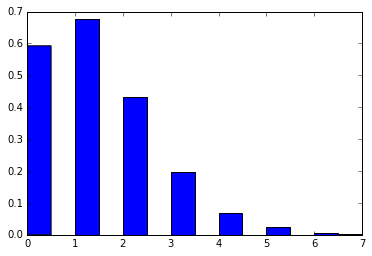

2
2
2
1
1
1
2
1
1
2
3
1
0
1
3
1
4
2
2
0
0
4
2
1
0
1
3
0
0
0
0
0
1
1
0
0
3
2
2
0
0
1
1
1
2
0
1
3
1
3
0
2
2
2
0
1
0
1
2
1
0
0
4
2
2
2
0
1
2
2
3
0
2
0
2
3
5
2
0
2
1
1
1
1
1
3
0
0
2
0
0
2
1
4
2
3
1
3
0
0
0
3
3
2
1
1
2
3
1
0
2
3
1
0
0
2
0
1
1
2
0
0
3
0
1
1
3
2
5
4
3
2
3
2
1
0
1
0
3
1
1
3
1
0
1
0
1
1
1
2
0
0
0
0
0
0
0
0
3
3
2
1
0
3
4
0
0
1
1
1
2
0
2
0
1
2
3
2
3
3
4
2
0
0
4
3
2
0
1
1
0
1
5
0
1
2
1
2
2
0
1
4
3
0
1
2
2
3
0
2
3
0
3
4
0
1
0
2
2
0
1
0
0
0
0
1
3
0
0
0
2
1
3
3
0
2
2
1
2
1
0
1
1
1
0
0
2
3
1
0
4
0
0
1
0
1
1
0
0
0
1
0
2
0
1
1
0
5
3
3
1
0
2
0
1
1
0
0
4
1
1
3
0
0
1
0
1
0
0
1
4
3
3
3
3
2
0
2
2
2
0
4
2
0
2
2
2
0
0
1
1
2
1
0
1
2
2
2
1
1
3
0
2
0
0
1
0
0
0
1
1
1
2
0
0
0
1
0
1
0
2
0
0
0
1
0
2
1
1
1
1
1
1
1
0
0
0
1
2
0
2
1
1
1
4
2
3
0
0
1
1
4
0
0
1
3
2
0
1
1
3
1
0
0
2
0
4
3
5
0
1
1
0
1
1
0
0
1
1
2
1
2
0
1
0
1
2
4
5
2
2
2
4
3
1
2
2
1
1
3
1
2
0
3
1
2
1
5
1
2
0
1
1
3
1
0
3
1
1
0
0
0
2
2
1
1
3
0
4
1
1
3
1
0
2
1
2
3
0
2
0
0
1
0
2
4
2
4
2
2
1
2
2
3
0
2
1
0
3
2
5
0
3
1
1
2
0
1
0
1
0
1
4
2
0
1
0
0
4
0


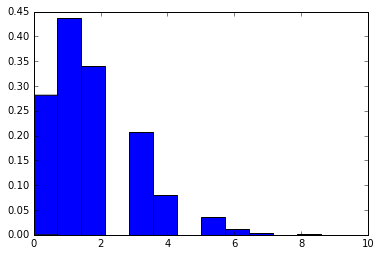

2
3
2
1
2
2
2
0
1
3
2
1
4
0
0
5
2
0
5
4
1
4
4
1
2
1
2
0
2
1
0
1
1
0
2
3
1
1
3
3
0
3
1
3
1
3
0
3
1
1
2
3
6
6
4
2
4
2
3
2
3
3
3
0
0
0
1
0
0
2
0
2
1
2
2
1
2
2
1
2
1
1
1
2
1
2
3
2
1
1
1
3
0
5
1
3
2
1
0
4
3
1
4
1
2
1
0
3
2
1
0
1
0
1
2
1
2
0
1
2
1
3
2
3
3
2
2
1
2
1
4
3
0
2
1
2
0
0
1
4
1
0
0
2
0
5
2
0
1
1
3
1
1
0
1
0
3
2
2
1
1
3
0
4
3
2
5
6
2
0
0
0
1
0
0
2
1
0
0
0
1
0
1
2
2
2
1
3
5
1
3
4
2
2
3
1
3
2
2
1
2
0
2
0
2
0
1
1
4
2
4
1
3
0
4
2
1
2
0
5
0
3
2
1
1
3
1
0
0
2
1
2
2
0
0
2
3
0
1
1
0
0
1
2
3
6
3
2
1
2
4
3
2
0
4
1
1
1
1
1
1
0
1
1
1
0
1
1
1
2
2
0
2
2
3
1
3
0
1
1
0
1
1
1
1
1
3
1
3
2
3
1
1
0
1
2
1
2
3
1
2
2
2
0
3
1
3
1
1
2
1
2
5
6
0
1
2
1
1
4
3
4
3
0
2
1
4
0
2
2
0
3
1
1
0
0
1
0
2
2
1
3
0
2
2
1
1
1
4
0
1
4
3
2
0
0
0
0
1
3
3
3
1
2
1
2
2
0
2
1
4
6
3
3
3
0
1
1
1
2
2
0
3
1
2
1
0
3
2
1
0
3
1
1
1
1
0
1
4
1
4
2
2
1
2
1
1
1
3
0
1
0
1
3
1
2
3
3
2
5
3
2
2
4
3
4
4
3
0
3
3
2
2
4
1
5
0
2
1
5
1
0
1
1
1
1
3
3
0
2
3
1
3
2
0
0
2
1
1
1
1
0
2
1
3
2
2
3
0
4
2
5
2
2
2
0
3
2
1
0
0
0
2
0
2
0
0
2
3
0
1
0
3
2
0
2
5
1
2
1


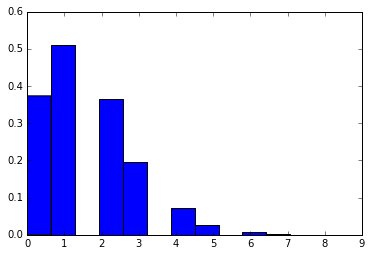

2
0
1
0
1
0
2
2
4
1
1
2
1
3
1
1
2
4
3
2
0
1
1
2
3
2
1
2
1
5
1
3
1
1
0
3
4
5
2
2
1
0
1
1
2
0
2
4
1
1
2
0
3
2
4
1
3
5
3
3
1
2
3
2
2
2
2
1
3
2
1
0
1
1
0
0
1
3
3
0
1
0
3
5
1
2
2
1
1
1
3
1
2
1
0
1
3
0
0
2
3
0
0
0
2
1
1
1
3
1
3
1
2
1
0
1
1
2
1
2
3
1
4
0
1
0
1
2
2
0
1
1
1
0
0
2
3
2
2
0
1
0
1
1
1
0
3
2
1
2
0
2
0
1
0
0
1
0
1
2
1
2
3
1
1
0
2
3
1
2
1
1
1
1
0
1
0
2
1
2
1
0
2
3
2
4
3
2
4
2
1
2
2
4
2
2
0
0
1
0
1
1
1
1
5
0
1
0
1
2
1
1
1
3
1
0
2
1
2
0
1
0
4
1
1
1
0
1
2
3
1
2
2
1
5
2
4
2
2
2
1
2
1
2
1
1
0
0
2
2
1
3
2
1
2
2
1
2
3
1
1
0
4
3
1
0
2
2
1
1
1
0
0
2
2
1
2
0
3
3
6
4
4
5
4
1
4
0
1
2
0
3
2
4
1
2
1
1
1
3
2
1
1
2
3
1
1
0
1
1
3
3
1
0
0
1
0
1
2
6
3
2
0
2
3
1
1
3
1
1
1
0
3
4
0
0
0
0
1
0
2
2
2
3
0
3
2
0
1
5
2
1
2
2
3
0
1
1
2
2
1
0
1
1
0
1
2
1
3
3
4
0
1
1
1
2
2
1
0
1
2
1
3
4
1
1
1
1
5
3
2
1
1
3
3
1
0
0
0
0
3
1
1
3
0
1
2
0
0
3
1
1
1
1
1
0
2
0
1
4
0
0
0
0
2
2
2
2
1
2
2
1
0
0
3
2
0
2
0
4
2
1
1
1
3
1
3
1
1
0
1
3
2
0
4
0
1
2
2
1
4
3
4
2
2
1
2
2
1
2
2
2
1
3
2
2
1
2
0
0
1
0
0
2
4
1
2
2
0
0
1
1
3
1
0
2
0
0
0
3


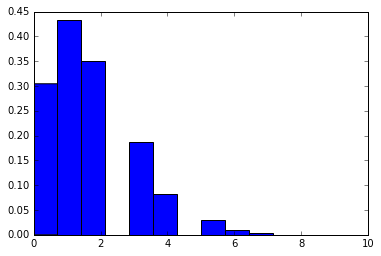

3
3
2
0
1
0
0
0
1
1
3
5
3
3
2
5
3
0
2
2
2
0
4
0
1
0
0
2
2
0
1
5
3
0
3
0
1
4
1
0
0
0
3
0
2
2
0
2
2
3
2
3
4
4
0
3
4
2
1
3
4
5
2
2
6
1
1
2
1
3
0
2
5
2
3
2
2
0
0
2
3
2
0
4
3
1
3
1
3
0
2
0
2
2
1
0
0
2
0
1
0
1
5
1
0
1
4
0
1
3
1
2
0
2
2
1
1
0
1
3
3
4
1
1
0
0
3
1
2
2
2
2
2
5
3
2
0
0
1
2
2
2
1
1
10
2
3
2
0
3
1
1
2
0
2
1
3
0
1
2
1
5
1
3
1
1
1
1
1
1
1
0
2
0
1
0
5
2
3
2
0
4
1
2
1
2
1
2
0
2
3
0
1
4
2
2
4
6
5
0
4
2
1
0
2
0
1
2
1
2
0
0
0
1
1
1
0
2
1
0
1
0
1
1
2
2
3
1
1
1
1
2
1
5
0
2
0
2
0
2
0
1
0
1
1
1
0
1
2
1
5
1
5
0
0
0
1
2
0
0
0
1
0
4
4
1
0
2
2
0
0
0
1
2
0
2
0
6
2
2
3
0
0
1
1
0
0
6
3
0
1
2
1
1
0
1
3
4
1
3
3
3
3
3
4
4
0
2
3
2
3
2
0
2
1
1
5
4
1
0
1
3
5
5
0
1
2
3
6
3
4
1
2
0
0
1
2
1
1
0
4
2
3
1
0
0
0
4
0
0
0
2
1
2
2
2
2
0
2
1
2
0
1
0
0
1
0
0
2
2
1
2
2
0
0
2
1
1
0
0
3
0
0
2
1
1
1
0
1
1
4
1
1
1
0
0
2
0
1
1
1
2
1
0
1
2
1
2
4
2
1
2
1
1
2
0
5
3
0
1
2
0
3
2
0
2
0
1
0
3
2
0
1
4
2
2
2
0
2
3
6
2
3
1
2
1
0
2
1
2
1
0
1
0
2
4
0
2
1
2
1
7
1
4
1
0
2
1
1
2
2
4
1
4
5
2
2
2
0
2
1
0
1
1
0
0
2
3
3
2
2
1
1
1
0
0
1
0
0
0

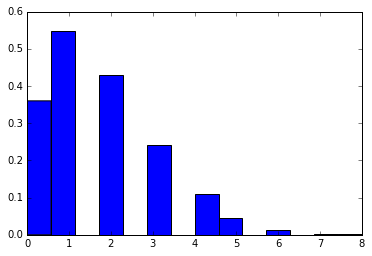

4
0
4
3
2
5
3
2
1
2
2
2
3
1
0
3
0
1
0
2
1
4
4
2
3
0
1
0
3
3
3
6
0
1
2
2
2
3
1
3
1
2
1
4
3
1
0
0
1
0
0
1
1
2
1
1
3
2
1
0
0
2
2
1
1
1
2
0
1
2
0
2
1
1
5
1
3
0
1
4
2
1
1
1
0
1
0
2
2
2
0
1
0
1
2
1
1
2
0
3
4
5
3
4
1
2
2
3
1
1
4
2
2
0
1
1
0
2
1
1
1
1
2
3
0
0
0
2
0
1
0
4
2
3
1
3
0
0
1
2
1
2
1
4
3
1
5
0
2
3
0
2
1
1
2
2
2
2
2
5
1
1
0
2
1
2
0
3
3
0
1
0
2
3
0
2
0
3
3
4
2
1
3
1
0
0
0
0
1
2
0
2
2
3
0
0
3
1
3
1
2
2
3
2
1
1
0
4
0
1
3
4
2
2
0
0
1
0
1
0
2
1
1
1
0
0
0
0
3
2
2
2
4
1
2
3
3
1
4
3
1
2
2
0
2
2
4
2
1
3
2
5
2
1
0
1
1
1
3
1
0
0
2
0
3
2
6
1
1
0
2
1
3
2
1
2
2
1
3
0
3
5
2
4
1
5
4
0
2
1
2
2
1
2
2
2
0
2
1
2
1
1
2
2
1
1
2
0
1
2
0
2
3
0
0
1
0
2
2
1
1
2
1
4
2
2
0
0
1
1
1
2
3
4
4
1
3
2
0
1
1
5
0
2
2
1
3
0
3
1
1
0
4
1
3
1
4
0
4
1
3
3
3
0
1
2
2
2
0
0
2
2
0
0
2
1
2
2
0
4
0
0
2
1
1
1
2
2
6
3
2
1
0
3
4
2
1
1
0
1
3
1
0
2
2
0
2
2
1
2
1
2
2
3
3
2
1
1
4
0
2
0
4
0
3
3
1
3
4
1
2
2
1
1
1
3
5
1
3
1
2
3
3
0
2
1
2
2
3
2
2
4
0
1
3
1
1
3
2
4
0
0
2
0
1
1
2
1
0
0
3
2
1
1
3
4
3
0
1
5
2
0
0
2
1
2
0
1
2
3
5
1
3
5
2
2
0
1
1
1


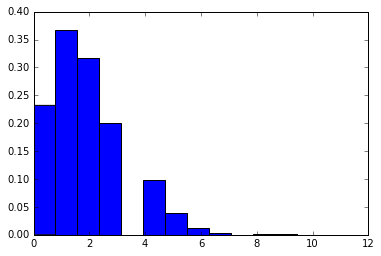

2
2
1
2
0
0
1
0
0
1
2
1
3
1
2
1
0
1
3
1
2
5
1
3
0
1
2
2
2
3
0
3
2
0
3
3
0
0
2
0
4
1
2
3
2
5
1
3
3
1
2
2
3
0
4
4
0
2
1
2
3
0
2
1
3
3
0
0
0
1
4
0
1
0
1
1
2
1
0
4
2
8
1
3
2
3
1
0
1
3
2
1
2
2
0
2
0
2
2
5
1
2
3
3
1
2
3
3
1
1
1
8
1
0
3
0
1
2
1
2
0
0
1
3
3
5
4
0
5
3
2
2
1
2
0
1
0
2
1
2
0
1
0
0
0
5
3
3
3
0
0
3
0
1
1
0
3
2
0
2
3
1
0
0
3
0
2
2
1
0
1
2
3
1
1
3
5
1
2
3
1
2
0
1
2
2
3
2
0
1
2
3
2
0
4
3
0
5
2
2
1
3
3
1
1
2
1
1
2
1
2
2
2
1
1
2
2
1
4
2
0
2
1
3
1
5
1
4
0
2
3
1
3
1
0
4
1
2
1
4
3
2
1
1
1
1
2
0
0
1
0
1
2
3
1
1
1
1
2
0
2
1
2
2
1
5
0
1
0
1
1
1
1
2
3
3
1
3
3
2
1
1
1
4
3
1
3
1
2
4
0
1
0
0
0
1
0
3
2
0
1
1
3
4
4
1
1
2
0
0
1
1
1
1
2
1
4
1
2
1
1
3
3
4
2
1
1
2
5
3
3
2
0
0
0
1
0
2
1
3
2
1
3
1
2
0
1
3
3
2
3
7
1
4
2
1
1
0
3
4
3
3
2
2
0
0
1
3
3
0
3
5
1
1
1
1
3
1
2
0
1
0
0
3
3
2
1
4
3
2
0
1
7
3
1
1
0
1
0
2
2
3
2
3
0
2
3
2
2
3
3
2
0
2
5
0
3
2
2
4
1
1
3
1
0
1
4
3
0
1
0
1
0
0
3
2
2
2
2
2
1
2
5
2
2
2
2
3
3
2
2
1
2
1
6
0
1
0
0
2
5
3
2
2
3
4
2
1
0
1
0
1
0
3
0
3
5
0
3
2
1
0
2
2
2
3
3
2
2
1
5
1
0
0
2
0
1
1
3
2


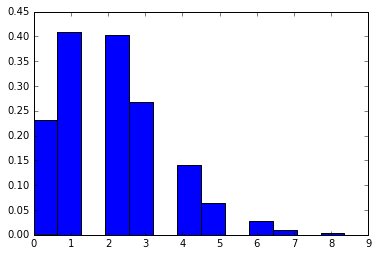

1
1
2
1
1
1
0
2
1
2
2
3
1
3
4
1
2
1
4
1
3
2
4
4
0
3
0
1
3
1
2
3
2
2
0
2
1
4
2
5
3
5
2
3
2
4
3
3
1
1
2
2
2
4
1
5
5
3
1
2
1
5
2
3
0
1
0
1
2
2
1
2
3
0
1
3
3
2
0
2
3
2
3
1
1
0
0
0
1
2
0
0
0
1
1
2
4
3
2
2
1
2
2
1
0
0
3
2
4
2
2
2
3
4
2
0
0
0
3
2
0
4
2
4
1
0
0
4
3
1
1
1
2
1
2
2
4
0
7
1
7
1
1
4
1
2
6
0
3
0
1
1
0
2
3
1
4
3
1
1
1
4
3
0
4
4
3
0
3
1
1
1
0
1
0
1
6
4
8
1
0
3
0
2
4
2
3
3
4
3
1
2
6
1
3
3
3
1
1
1
3
2
1
1
7
2
4
0
5
3
1
0
1
2
0
0
3
0
2
0
2
3
0
3
2
2
2
4
1
2
3
1
1
1
0
3
2
1
1
1
0
3
5
2
4
2
0
0
3
2
1
2
3
1
4
3
0
1
1
3
2
2
0
0
3
2
1
3
0
0
2
2
2
5
2
1
5
1
0
0
1
2
1
1
1
2
0
3
0
1
2
0
1
4
1
1
5
0
3
1
3
3
0
0
4
2
2
4
1
3
1
2
1
2
3
1
1
0
0
3
0
3
3
2
3
2
2
2
2
5
4
0
3
3
2
0
1
2
3
0
1
5
2
1
2
3
1
6
2
5
2
2
0
2
3
2
0
1
0
4
1
2
2
4
0
3
1
3
1
1
0
1
3
3
2
0
2
2
3
4
3
6
2
4
3
3
2
2
3
4
4
4
3
1
4
0
1
4
1
1
7
2
3
3
4
2
4
3
0
4
3
3
2
0
2
2
0
3
1
3
3
1
2
2
3
1
0
2
3
1
0
3
4
1
5
0
1
2
3
0
4
1
3
2
1
4
4
2
0
6
4
3
1
1
2
2
3
2
0
2
1
3
3
2
1
3
1
3
3
1
5
5
1
1
1
0
2
2
3
2
1
2
2
0
3
1
1
2
1
1
1
1
1
1
0
2
1
3
1
3


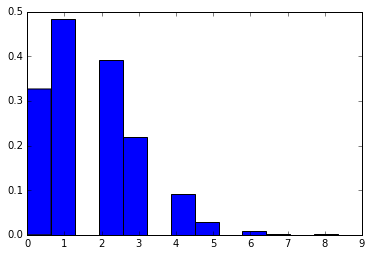

1
1
1
2
2
4
2
0
0
2
2
2
2
1
0
3
1
1
2
4
1
3
1
1
1
2
2
3
1
1
1
2
3
0
1
1
1
3
4
2
3
2
4
0
5
3
1
0
3
3
2
1
2
1
1
1
1
6
3
2
3
3
3
2
3
0
2
1
0
3
0
2
1
3
1
1
1
2
1
4
2
4
3
3
0
2
2
0
1
0
1
2
0
1
1
2
1
2
3
0
0
4
1
2
0
0
0
1
0
2
1
4
2
0
1
0
2
2
1
1
0
2
1
1
1
3
2
2
1
2
4
2
4
2
0
3
0
0
4
2
1
3
3
1
1
0
3
0
1
1
1
2
0
1
2
2
4
1
4
3
1
3
3
2
2
0
1
1
0
1
2
4
1
1
1
2
1
1
0
2
0
2
1
2
1
0
3
1
0
2
0
3
0
2
2
5
2
2
2
1
2
0
1
3
2
1
2
1
0
3
2
2
4
3
0
1
4
6
0
2
2
3
2
1
1
1
2
1
4
0
0
1
1
3
3
2
4
3
3
3
3
1
4
3
1
4
4
3
0
3
3
4
1
1
1
0
2
0
1
2
1
2
1
1
0
0
1
1
0
0
1
1
0
0
1
0
2
4
1
1
1
5
0
1
2
3
1
3
0
4
2
2
1
2
1
0
2
3
1
3
6
5
0
2
0
0
1
2
5
2
3
1
3
1
3
2
4
1
0
2
1
1
2
3
1
4
3
3
2
6
4
0
2
4
0
0
1
2
0
4
0
2
4
2
2
2
0
3
1
1
1
4
0
3
1
0
1
3
0
1
1
2
1
3
3
1
5
1
2
3
0
1
2
3
1
1
2
1
1
0
3
0
3
0
0
1
1
1
2
2
0
2
2
1
1
3
3
4
0
2
2
1
5
2
1
2
2
2
1
1
3
0
1
1
4
1
2
2
2
1
2
1
1
2
4
2
1
2
1
0
2
2
0
0
0
1
2
2
2
2
0
2
1
0
3
0
0
1
2
0
1
4
3
1
2
0
3
0
1
2
3
3
1
0
0
2
3
1
1
0
0
2
5
4
1
2
0
1
0
2
1
2
3
1
2
1
1
2
2
1
3
1
3
0
2
1
1
3
3
3


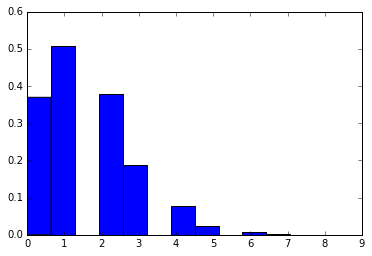

1
1
1
2
2
0
4
2
1
0
1
1
0
0
2
1
3
2
0
4
1
0
0
1
1
3
1
0
3
1
0
1
2
1
0
1
0
1
1
0
2
0
0
1
1
4
2
3
0
3
3
5
1
1
2
4
1
4
3
2
1
5
4
1
1
1
0
0
1
0
0
1
2
0
1
2
2
0
1
1
1
1
1
0
2
3
0
2
1
0
3
1
4
3
0
2
1
2
1
2
0
0
4
1
0
1
0
0
1
1
3
3
1
4
0
0
0
2
1
2
1
0
1
0
3
0
2
1
4
0
6
2
0
1
0
0
1
3
2
0
0
1
2
2
0
1
1
3
0
0
4
0
0
2
3
1
0
0
3
5
0
1
0
2
2
0
0
1
0
0
2
0
1
1
0
3
7
1
2
0
2
3
1
2
3
1
2
1
1
1
2
0
4
1
3
2
3
2
1
0
0
2
1
1
1
3
4
1
2
3
4
0
1
2
1
1
1
1
2
0
0
0
2
0
2
1
1
1
0
1
2
0
1
1
2
0
0
1
3
6
2
2
2
2
2
2
2
3
1
1
3
0
1
0
0
0
1
0
1
0
0
0
0
3
2
1
1
2
4
2
0
4
0
1
2
0
3
2
2
2
3
3
1
0
0
0
0
1
1
0
2
3
1
2
3
0
2
1
1
2
0
0
2
0
0
0
4
2
2
0
0
2
3
1
2
4
0
1
1
2
3
0
3
2
3
2
1
2
2
3
1
3
0
2
1
1
2
0
0
2
0
2
1
1
1
2
0
1
2
1
4
0
0
0
0
1
0
1
2
5
1
1
2
1
0
1
1
1
3
2
4
1
2
1
3
2
4
1
3
2
1
0
3
3
1
3
7
1
1
0
3
4
1
0
0
1
3
2
0
2
3
3
0
2
0
0
2
0
1
2
0
3
0
1
3
2
0
1
3
1
6
3
2
2
2
2
4
3
3
0
2
0
3
0
1
1
3
0
3
0
5
4
1
1
1
3
2
1
1
3
2
2
1
1
5
4
0
1
3
2
0
0
0
1
2
3
2
1
1
3
1
2
0
5
2
1
0
1
2
0
2
1
1
0
1
0
1
1
1
1
1
0
0
0
1
0
1
2
1
1


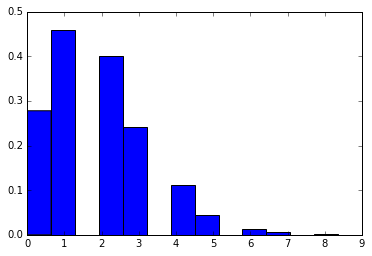

2
2
2
0
0
1
0
0
0
0
3
2
2
2
2
1
8
2
1
0
1
3
1
3
1
1
1
2
4
0
0
2
0
3
2
2
2
2
0
2
2
4
2
0
0
2
1
6
2
2
3
2
3
2
1
1
2
0
1
2
4
2
2
3
1
1
1
0
2
3
4
4
3
1
1
1
4
0
1
2
4
4
3
1
4
0
1
0
1
2
1
2
5
3
0
0
0
0
2
5
2
3
1
1
1
0
2
3
1
1
1
5
1
4
2
3
2
1
0
3
1
2
1
1
3
2
2
0
0
3
5
4
5
0
3
2
1
3
0
1
2
3
0
1
2
1
5
3
0
1
1
1
3
1
0
1
1
1
1
3
0
3
0
2
2
2
0
0
1
3
0
1
1
1
1
3
6
3
4
0
6
1
2
2
6
4
3
3
3
1
2
4
2
0
1
2
2
2
3
1
2
1
4
0
2
0
3
1
2
1
1
2
1
2
2
3
1
2
1
2
2
2
2
0
1
2
1
2
0
1
2
1
2
2
0
1
4
3
2
3
3
1
1
4
0
3
0
0
0
3
0
1
1
1
2
1
1
3
0
2
0
2
2
3
4
1
2
0
0
2
1
2
2
1
3
1
1
1
2
1
2
1
1
2
1
3
0
2
2
3
0
1
1
2
1
3
0
2
1
1
2
2
1
2
0
2
0
4
1
0
3
0
1
3
1
1
2
3
2
1
1
3
1
1
1
0
2
1
1
3
1
0
3
1
0
0
1
3
1
0
4
0
2
1
0
0
3
2
2
2
2
1
3
3
1
0
2
1
0
3
1
1
1
2
3
3
1
2
3
1
1
3
0
0
0
1
0
3
1
3
2
0
1
2
1
1
1
3
3
2
0
3
0
0
2
1
4
1
1
4
2
4
2
2
1
1
1
1
0
2
1
1
2
1
1
1
2
4
2
2
2
0
1
3
3
3
1
1
3
2
1
2
0
2
1
0
2
0
0
1
3
2
4
4
1
4
2
1
2
2
2
3
2
0
1
3
2
2
2
2
0
0
1
5
0
3
3
2
1
4
2
3
0
2
2
2
3
4
0
4
1
2
3
2
1
3
0
1
2
3
1
1
0
3
1
1
0
3
2
2


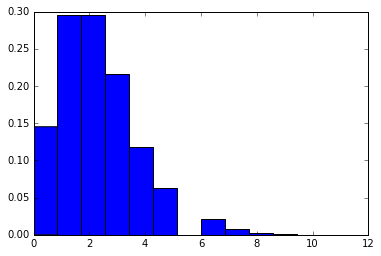

5
4
5
1
7
1
1
0
3
4
5
1
2
0
1
3
2
2
2
1
4
2
1
4
5
1
3
2
1
2
1
1
4
2
3
2
2
1
3
3
0
3
0
0
3
1
0
5
3
4
1
0
4
1
6
3
6
3
2
3
2
1
3
3
1
1
1
2
0
4
4
4
1
3
5
4
3
7
2
3
6
4
2
0
2
1
5
2
2
1
3
3
2
1
1
1
1
2
2
1
3
1
5
4
1
2
2
5
1
4
2
4
3
2
2
3
1
1
2
3
0
3
0
3
0
3
1
3
3
3
4
1
0
3
0
0
1
5
2
1
1
1
3
2
3
0
3
3
1
2
0
3
2
0
1
2
2
3
2
1
3
4
2
4
2
0
2
1
2
0
2
3
3
0
2
2
3
2
1
2
1
4
1
1
0
2
2
4
2
2
2
1
1
0
1
2
3
3
0
1
2
2
0
2
4
2
3
1
3
2
0
2
2
2
1
1
1
0
0
0
1
1
5
3
1
3
0
2
4
1
2
1
0
2
4
1
2
1
3
2
0
3
3
2
1
2
4
5
1
1
5
3
1
3
5
1
0
3
0
1
1
0
1
3
1
2
0
1
0
2
0
2
4
0
2
3
2
1
4
1
4
4
1
1
2
0
3
4
2
3
1
2
0
3
2
2
3
1
4
3
0
2
2
2
2
5
2
4
4
3
0
0
0
1
2
1
3
5
3
3
4
1
3
0
0
2
2
3
1
4
5
1
5
6
1
2
1
5
3
2
3
2
1
2
3
2
2
0
2
3
3
1
1
5
1
1
3
3
3
3
3
3
1
0
3
2
4
2
4
0
1
3
2
4
5
1
5
3
1
1
5
3
1
1
1
1
5
2
3
3
2
2
3
4
0
0
2
2
2
1
2
2
5
1
2
2
0
2
4
2
1
1
3
3
2
4
4
2
3
3
1
6
2
2
1
1
2
1
5
1
3
5
1
3
3
1
1
2
2
1
2
1
0
1
2
0
5
5
4
2
3
2
4
5
1
0
2
2
1
4
0
1
4
5
2
1
4
4
2
4
8
3
2
4
3
2
2
0
1
3
3
1
1
3
0
1
2
3
3
1
2
7
2
2
2
3
2
1
2
2


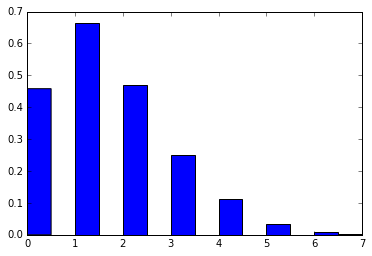

4
1
0
0
0
1
0
1
1
0
2
0
2
1
4
3
2
1
1
2
2
4
2
0
1
1
2
0
2
2
0
2
0
1
0
2
1
2
1
1
0
1
0
2
1
4
3
1
5
2
2
4
2
3
2
0
1
1
1
0
2
1
5
1
1
0
2
1
3
0
3
3
1
0
1
2
2
2
4
2
0
2
1
0
3
0
2
1
0
1
1
0
1
0
0
1
3
2
1
1
4
2
2
1
2
2
2
2
0
2
0
1
2
3
3
0
0
4
3
3
0
0
3
0
1
1
1
2
0
1
1
0
1
2
2
0
0
2
3
1
6
3
4
2
3
1
2
1
1
0
0
1
0
2
1
1
1
0
2
2
1
1
1
1
3
2
3
0
2
0
3
0
3
1
2
1
3
3
3
4
2
1
1
2
3
3
1
2
3
1
4
1
0
2
2
1
2
0
0
0
2
0
1
0
0
1
1
0
1
3
2
2
0
0
1
0
1
2
0
0
1
1
1
0
0
2
1
1
2
0
0
1
3
0
1
0
2
0
1
2
0
0
0
1
1
0
2
1
0
2
2
0
3
0
0
1
0
1
2
2
1
4
2
0
1
4
2
0
2
0
1
0
2
0
1
1
0
3
0
0
3
2
3
1
0
1
3
2
5
1
0
3
0
0
1
1
0
0
3
1
1
2
0
0
0
2
0
3
3
1
1
2
1
1
1
0
2
1
1
1
3
2
3
2
2
2
5
0
1
2
1
3
3
3
1
1
2
2
0
1
1
2
1
0
0
0
1
2
0
1
1
3
1
3
1
2
0
0
1
2
1
2
1
2
1
1
0
3
2
3
2
0
0
2
1
2
2
0
0
3
2
1
1
1
1
3
0
0
2
1
3
1
1
3
4
0
2
1
1
2
3
1
3
1
1
4
2
0
1
0
1
2
4
3
1
4
1
1
1
0
1
3
1
0
2
1
3
2
0
0
0
0
1
1
1
3
1
1
0
0
1
1
1
2
2
1
2
1
4
0
2
2
2
4
1
1
0
1
2
1
3
0
0
2
0
1
3
0
1
1
4
3
2
4
1
0
0
3
0
3
0
0
0
0
2
1
2
0
0
1
2
0
1
0
1
0
1
2
2
1


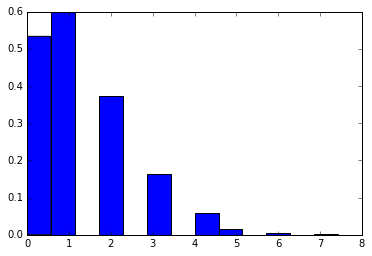

1
1
1
0
0
3
0
0
2
1
1
0
0
1
1
2
0
3
2
2
2
3
2
0
3
1
3
0
3
3
0
1
1
1
3
0
0
3
1
0
0
2
0
3
0
2
0
2
2
0
2
2
3
2
0
0
0
1
2
2
0
2
3
1
3
0
0
0
1
2
2
3
2
1
0
1
0
2
1
3
2
1
2
1
1
1
0
0
3
2
3
1
1
1
1
0
0
1
0
2
4
0
1
1
1
0
2
2
1
3
2
3
2
0
2
1
0
1
2
1
0
2
2
3
3
1
1
0
2
4
1
1
0
2
1
1
1
3
1
0
0
2
0
1
1
1
0
1
0
3
0
2
2
0
1
1
1
3
1
0
0
1
1
0
0
0
0
1
1
0
1
0
1
0
0
1
2
0
0
1
0
3
1
3
0
2
1
1
3
5
4
2
2
1
3
1
1
2
1
1
2
0
2
0
0
3
4
1
1
2
1
1
0
0
0
0
2
1
3
1
2
1
0
1
1
1
0
0
3
1
0
1
0
3
2
1
0
0
4
1
1
1
0
0
6
1
0
2
1
0
2
3
2
1
0
0
0
0
3
1
1
1
1
2
1
0
0
2
0
0
3
0
1
2
1
0
0
1
2
1
0
4
0
0
0
2
2
1
2
0
1
2
1
3
2
2
1
2
1
0
2
1
1
1
0
1
2
0
0
2
3
1
2
1
2
1
2
1
0
3
2
2
2
3
0
0
2
0
2
1
4
4
3
1
0
1
0
1
2
0
1
2
0
2
1
0
3
3
0
0
1
1
0
0
2
2
1
2
1
3
1
1
0
2
0
2
2
1
1
5
3
2
1
2
2
1
2
1
1
3
1
1
4
1
1
0
1
2
3
4
1
0
1
1
2
0
0
0
2
0
3
1
0
4
1
3
3
1
1
0
2
1
2
0
3
0
5
1
0
0
1
2
2
2
0
0
2
3
2
3
0
3
0
0
2
0
0
0
1
1
2
0
1
0
2
2
0
0
0
0
1
2
1
0
0
0
2
0
2
0
2
2
4
2
2
1
0
1
0
0
1
3
2
0
0
0
3
2
0
0
0
0
1
1
0
2
1
2
4
2
0
1
0
2
1
1
0
0
1
2


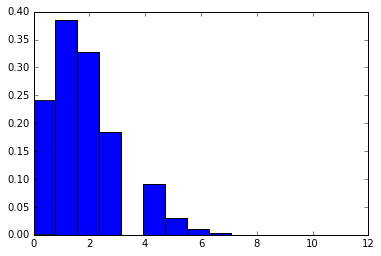

3
0
4
0
0
2
2
1
1
4
0
2
3
1
0
3
0
2
2
1
1
1
2
0
3
1
2
2
1
0
1
3
3
1
2
1
1
2
3
5
3
2
0
4
4
3
2
1
1
2
2
2
1
2
2
1
2
4
3
2
1
2
4
1
4
2
2
1
4
2
2
2
0
3
4
0
2
0
1
2
4
1
1
1
2
0
0
1
1
4
0
1
0
0
2
0
1
1
0
1
1
2
1
4
1
0
2
3
1
4
1
1
5
1
1
1
0
2
0
1
2
3
2
4
2
1
2
2
2
0
2
2
1
0
0
1
1
1
3
5
1
0
3
3
1
2
2
1
0
2
1
2
1
2
3
0
1
6
2
3
2
3
2
2
5
1
1
3
1
1
1
0
4
1
0
2
2
4
3
3
0
1
3
1
3
2
1
3
4
3
2
3
1
2
0
4
2
3
2
0
0
1
2
2
3
3
2
2
0
0
0
2
1
0
1
3
2
2
4
5
1
3
2
3
1
1
0
2
1
0
3
3
0
2
3
1
2
0
2
0
1
3
1
1
2
1
1
2
4
4
4
2
1
3
1
3
1
1
0
0
2
2
2
1
1
1
2
1
2
0
1
3
1
2
1
0
1
1
1
3
1
0
0
1
0
3
2
2
0
1
2
3
2
1
1
0
2
0
0
0
1
1
1
0
3
3
0
0
2
3
1
4
2
1
3
1
4
5
2
1
1
5
1
1
2
0
1
3
1
4
2
7
1
2
1
1
0
1
1
1
2
2
1
2
0
4
2
0
2
0
4
1
0
2
1
1
0
1
1
2
4
4
3
1
2
4
2
1
2
1
1
0
2
3
3
3
3
1
2
1
2
3
3
2
3
0
4
1
4
1
2
1
0
2
2
3
2
3
3
3
6
3
0
1
1
1
1
1
0
2
3
3
1
3
0
1
1
0
2
3
2
1
4
5
2
1
1
1
5
6
3
6
3
4
3
2
2
2
2
1
2
0
3
2
1
2
2
3
3
1
2
0
3
1
0
2
3
0
2
2
2
1
2
1
1
3
2
2
2
1
2
1
2
0
1
2
5
2
2
3
1
3
4
2
2
2
1
1
4
2
1
0
4
3
1
0
5
1
5
0


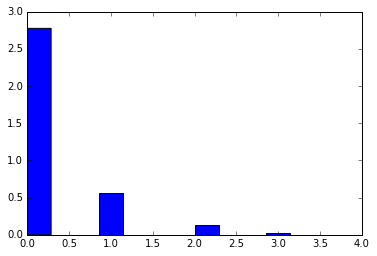

1
0
2
1
0
0
0
1
0
1
1
0
0
1
0
0
2
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
2
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
1
0
0
3
1
1
2
2
1
0
0
0
0
0
0
0
2
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
2
0
0
0
2
0
0
0
0
0
0
0
1
0
0
1
1
2
3
0
0
0
0
0
0
0
0
0
0
0
1
2
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
2
0
1
2
1
0
1
3
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
2
0
1
2
1
0
2
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0


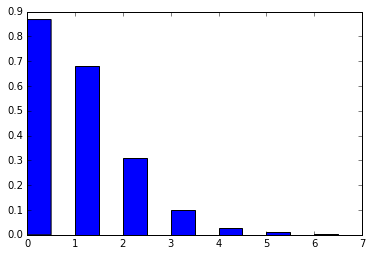

3
1
0
1
2
1
2
1
4
1
1
1
1
2
1
0
0
1
1
2
1
3
1
0
1
1
1
1
2
1
1
1
0
1
0
1
1
0
0
0
0
0
1
1
2
2
2
0
0
0
0
1
0
0
1
0
2
3
1
3
1
1
1
0
0
0
0
3
0
1
0
1
0
0
0
0
1
0
0
0
1
1
1
2
1
0
2
1
0
2
0
1
1
0
0
2
3
1
2
0
1
0
0
1
1
0
0
1
0
0
2
1
0
2
1
2
0
0
1
1
2
0
2
1
0
1
0
0
2
1
0
0
1
1
0
0
0
1
0
0
0
0
0
2
0
0
0
2
2
1
1
1
0
0
1
0
1
0
4
1
1
2
1
1
1
0
0
1
1
1
2
1
2
0
0
1
1
0
1
1
1
2
1
1
0
1
0
0
0
1
0
1
1
0
1
0
1
3
0
1
0
1
3
2
0
0
1
4
0
1
0
2
1
3
0
0
1
1
1
1
1
1
4
4
0
0
3
2
3
1
4
1
0
1
1
0
0
1
2
3
2
0
1
3
0
4
0
2
1
1
2
2
3
1
0
2
1
1
2
1
1
0
1
1
1
0
1
0
0
1
0
3
0
2
1
0
1
2
0
0
0
0
1
0
2
1
1
0
1
4
0
0
0
2
1
0
1
0
2
0
2
4
0
1
0
0
0
3
1
2
1
1
0
0
2
0
0
0
2
1
1
0
3
3
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
2
2
1
2
1
0
0
2
0
1
2
2
1
1
2
0
2
3
0
2
0
2
0
0
0
0
0
1
2
2
0
2
0
1
2
0
0
2
1
1
0
0
1
0
1
1
0
0
1
0
0
4
3
0
1
0
1
1
0
0
2
0
0
1
0
1
1
0
0
1
0
1
1
0
3
1
2
1
1
2
0
0
0
1
0
0
2
0
1
0
2
0
0
1
1
0
1
2
1
2
3
0
0
2
1
1
1
2
1
1
1
0
1
1
1
0
2
2
0
0
0
2
3
0
0
0
0
0
3
4
0
1
1
0
2
1
0
1
1
0
0
1
2
2
1
0
2
1
1
3
0
0
0
0
2
1
0


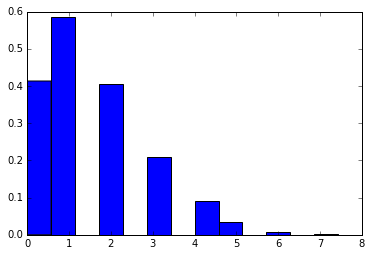

0
1
2
1
1
2
0
1
4
4
3
4
3
0
2
1
6
3
0
1
2
0
3
4
3
5
1
3
2
2
2
2
5
1
0
3
0
1
2
4
2
1
1
0
1
0
0
3
2
1
1
1
1
0
1
1
2
2
5
2
3
1
1
2
0
2
0
1
1
1
2
2
0
1
3
1
1
1
0
2
1
3
2
0
1
2
0
5
2
0
1
3
5
2
3
1
2
2
0
4
0
3
0
1
3
1
1
2
0
3
2
3
1
1
0
2
0
1
1
2
5
3
1
0
0
3
2
0
1
2
2
4
2
1
2
1
1
0
1
3
6
3
3
1
2
1
0
2
1
2
0
0
1
3
3
1
2
2
3
3
3
3
6
1
1
2
1
1
1
0
0
1
2
1
1
3
1
1
2
2
2
2
1
1
2
2
3
2
0
0
1
2
1
4
2
2
1
3
4
1
3
2
1
1
3
2
4
2
3
3
2
1
1
2
0
0
2
1
0
2
0
3
1
0
4
1
1
0
0
0
0
0
0
1
5
1
3
3
1
2
2
1
2
1
1
0
2
0
4
2
1
2
0
1
1
4
0
1
1
0
0
1
2
0
1
0
2
3
1
1
1
2
0
0
1
1
1
0
2
2
3
2
0
3
2
2
2
4
5
5
2
3
2
4
5
1
3
1
3
1
2
0
3
0
0
0
2
1
2
2
0
3
1
0
0
3
0
1
1
0
1
1
1
1
0
1
3
0
1
2
2
0
0
0
2
0
0
1
3
0
0
1
4
1
3
1
2
0
1
0
0
0
2
3
1
0
2
2
1
2
3
1
1
3
1
3
2
1
2
4
3
0
0
0
0
1
3
2
5
1
3
5
3
2
0
1
1
1
2
3
2
2
0
0
0
1
0
4
2
1
0
2
3
1
6
3
1
3
3
0
2
1
3
4
4
0
2
3
4
1
1
2
0
0
1
2
0
2
3
6
1
2
2
1
1
1
1
1
3
3
3
1
1
2
2
1
1
1
1
1
0
0
2
1
1
2
2
1
2
1
4
4
0
4
2
1
0
2
0
1
2
3
1
0
2
0
1
1
0
3
7
3
0
1
0
5
2
1
4
1
2
2
1
4
0
0
2
1
1
1


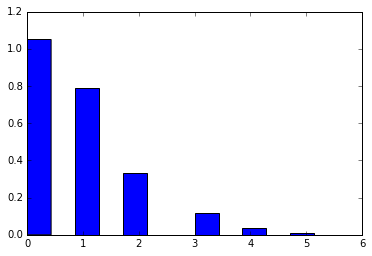

0
1
3
0
1
1
0
1
0
0
2
1
0
0
1
2
2
4
0
2
3
1
0
0
0
0
1
0
1
4
0
1
1
0
0
0
2
2
3
1
0
1
0
0
0
0
0
0
0
2
0
1
0
1
1
0
0
0
0
2
0
2
0
1
2
2
0
0
1
0
0
0
0
0
0
1
0
1
0
0
4
1
0
0
2
1
0
0
1
2
2
1
2
3
3
3
2
1
0
0
0
1
0
0
0
1
2
0
2
2
1
1
1
2
0
2
0
1
0
0
0
1
0
0
2
0
4
1
0
1
0
0
0
1
0
0
0
2
2
1
1
0
0
0
1
0
0
2
3
0
1
1
1
0
0
0
1
1
1
1
1
0
1
1
0
2
0
1
1
1
2
1
0
2
2
0
0
2
1
0
2
1
0
0
0
0
0
0
0
0
0
0
0
3
0
1
0
1
1
0
0
0
2
1
1
2
2
0
1
4
2
0
1
1
1
1
1
5
0
0
1
1
1
0
2
2
1
0
0
0
1
0
0
2
0
0
0
1
0
0
0
1
0
0
0
1
1
4
2
0
1
0
0
1
0
1
0
0
0
0
1
1
2
0
2
0
2
1
2
1
0
0
1
0
0
0
1
1
2
0
0
0
1
0
2
0
0
0
1
1
1
1
3
2
0
1
1
1
1
0
1
1
1
0
3
0
0
1
1
0
0
2
1
1
0
3
0
0
1
0
1
1
0
2
1
1
1
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
1
2
3
1
1
0
0
1
0
2
2
3
0
2
0
0
0
1
1
0
1
1
1
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
2
2
1
0
1
1
1
1
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
1
2
1
0
1
1
0
0
0
0
2
2
0
1
1
2
0
0
1
0
0
0
0
3
0
1
0
1
1
1
0
3
2
0
1
1
2
0
1
0
0
1
1
0
0
0
2
1
0
0
1
0
0
0
2
0
0
1
0
1
1
1
1
2
1
0
1
2
0
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
0
3
2
1
0
0


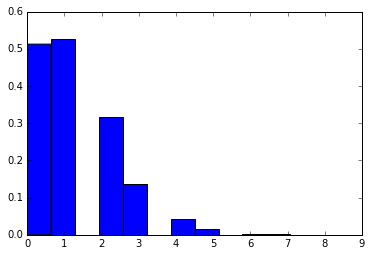

0
2
1
5
3
1
0
0
1
3
1
1
2
0
3
0
2
2
1
0
1
0
4
3
3
0
4
0
1
0
1
1
2
3
1
0
4
0
3
1
3
1
2
3
0
0
0
1
2
3
3
1
2
2
1
2
2
0
0
3
0
2
2
3
2
1
1
0
0
1
0
1
0
4
0
2
0
0
0
0
0
2
1
2
2
4
1
1
0
3
1
3
1
0
1
3
1
1
2
1
1
0
2
2
1
3
1
2
0
2
0
0
1
0
3
1
3
1
1
1
3
3
0
1
0
0
2
0
0
0
3
1
1
3
2
1
0
1
1
1
1
0
2
3
1
1
1
1
0
0
0
0
1
0
2
1
1
1
3
2
0
2
1
1
5
3
2
5
2
3
1
1
0
1
0
0
1
0
0
0
2
2
2
1
1
1
0
2
0
4
0
1
1
3
2
1
3
0
1
0
2
0
2
1
1
2
3
2
1
1
1
1
4
2
1
3
1
1
2
1
2
0
0
2
0
2
2
3
1
0
0
0
3
0
1
0
0
0
1
0
0
2
0
0
0
1
0
0
0
1
2
2
3
1
3
3
1
2
0
0
2
0
1
1
3
2
1
1
2
3
1
1
0
0
0
4
0
1
0
2
3
1
3
3
0
0
3
2
0
0
2
5
0
0
0
1
3
0
0
4
1
2
2
0
5
2
0
0
0
1
4
2
2
4
0
1
0
1
2
0
3
2
2
5
1
1
3
2
1
1
0
0
0
0
0
0
0
0
0
1
1
1
2
3
4
0
1
4
1
0
0
1
0
0
1
1
2
3
1
1
2
0
1
1
1
4
2
0
0
1
1
0
0
1
1
1
0
0
1
1
1
0
0
1
1
1
1
0
2
1
1
3
1
0
3
5
0
0
1
0
2
0
0
1
1
1
2
2
0
3
2
0
0
2
2
0
3
0
0
3
4
0
3
0
0
0
1
1
3
2
0
1
1
2
2
0
2
0
2
2
3
2
1
2
1
3
2
1
2
4
0
3
2
2
0
2
1
2
3
2
4
1
1
3
0
0
3
0
1
2
4
1
4
0
0
1
0
2
2
0
2
1
1
0
0
2
0
0
3
1
2
1
4
0
1
2
1
2
1
3


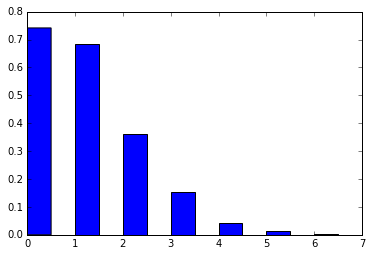

3
2
2
1
2
2
2
0
1
2
0
0
3
0
0
0
0
2
3
0
0
1
0
3
1
2
2
2
1
0
0
1
1
0
3
0
1
0
2
0
1
0
2
0
2
1
0
0
0
2
0
0
1
0
1
0
0
0
0
1
1
4
3
1
0
0
3
2
1
0
0
3
1
0
0
1
1
1
0
0
0
0
1
2
4
0
1
1
1
1
1
1
4
1
1
0
0
1
1
1
0
1
2
1
3
1
2
1
0
0
1
2
0
2
2
2
0
0
0
3
1
2
0
1
1
1
0
0
0
1
0
2
1
2
2
1
2
2
0
0
0
0
1
3
3
0
1
1
0
0
0
2
2
1
0
0
1
0
1
0
2
0
0
1
0
1
0
0
2
2
3
0
0
1
2
1
2
0
0
0
1
1
2
1
1
0
0
0
2
0
1
0
2
2
2
1
1
1
0
1
2
0
0
5
1
1
5
3
2
0
1
0
1
0
0
3
1
2
3
2
2
1
3
0
3
2
2
2
0
3
1
2
3
0
2
2
4
0
5
0
0
0
0
1
1
1
0
1
1
3
0
1
0
3
1
0
1
0
2
2
2
1
1
0
1
0
3
2
5
1
2
1
0
1
0
2
0
2
1
2
3
2
0
1
1
3
3
0
0
0
1
0
1
1
1
1
0
1
0
0
1
2
5
4
1
0
0
2
1
1
4
1
0
2
3
3
3
0
4
0
0
0
1
1
0
0
1
2
1
1
1
4
0
0
0
0
0
0
1
0
1
1
0
2
0
1
2
2
2
1
1
3
0
0
1
0
2
0
0
2
1
1
1
0
1
3
0
0
2
0
1
0
0
0
1
0
3
1
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
1
2
3
2
0
1
3
1
0
1
1
0
0
1
2
1
2
3
1
2
1
1
1
0
1
0
1
0
1
0
3
0
0
0
0
0
3
3
1
0
1
1
2
2
2
1
0
2
2
3
0
0
3
1
0
1
1
0
1
1
0
1
3
1
1
1
2
0
3
0
0
1
3
0
2
1
2
1
1
1
1
2
0
3
2
1
5
1
1
3
3
2
0
3
1
3
2
4
1
1
0
1
2
0
0
1
0


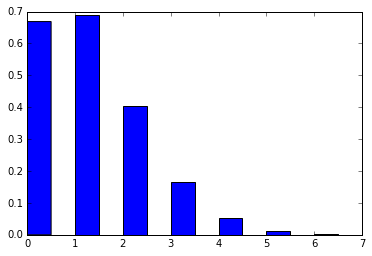

1
0
3
0
0
0
3
0
1
1
0
2
1
0
0
1
0
0
2
0
3
2
2
0
1
0
1
3
2
0
2
1
0
1
1
1
0
1
3
1
0
0
1
2
1
1
0
2
0
1
1
6
2
1
1
2
0
1
0
3
1
1
1
1
2
2
0
0
0
3
2
0
0
3
1
2
0
3
1
0
1
0
1
1
0
2
0
0
0
1
1
1
1
3
5
3
2
3
2
1
1
2
2
0
1
1
4
0
2
3
0
2
0
1
1
0
1
0
1
1
0
1
0
1
1
3
1
0
2
1
2
3
1
2
3
2
0
1
0
2
3
0
1
0
2
2
4
2
0
0
1
1
0
0
1
2
0
1
1
0
0
1
1
3
0
0
1
1
2
1
2
2
1
0
1
2
0
0
0
0
1
2
0
1
0
0
1
0
1
0
1
2
4
2
1
1
1
0
3
2
5
0
0
0
1
2
0
3
2
0
0
0
1
0
1
1
0
1
0
2
4
0
1
1
2
2
3
1
4
1
3
3
0
0
0
0
1
0
1
1
0
1
0
0
1
1
2
1
3
1
1
2
2
0
0
0
1
1
1
0
1
1
2
3
2
2
0
0
0
0
2
1
0
1
2
0
0
2
2
0
1
3
2
0
0
0
1
1
2
1
0
1
2
0
0
1
2
1
1
1
1
0
3
2
0
4
1
2
0
1
1
2
2
0
2
1
0
2
0
1
3
1
2
3
0
0
1
1
1
1
2
3
4
0
1
0
0
1
0
0
3
2
1
2
1
3
1
1
1
0
0
2
2
2
2
1
2
2
1
2
1
3
1
0
0
0
1
1
1
2
1
1
0
0
0
2
0
0
1
1
1
1
1
1
0
2
0
1
2
2
0
4
2
1
3
0
0
0
0
1
2
0
2
1
2
2
2
3
2
0
2
0
0
2
0
1
0
2
0
0
1
3
0
1
1
1
1
0
0
0
0
0
0
1
1
1
3
2
1
1
0
1
2
2
0
0
1
1
1
4
2
1
0
0
1
0
3
2
0
1
3
1
0
0
0
2
1
2
0
3
1
1
1
2
1
1
0
2
0
2
2
0
0
1
0
1
1
0
1
1
0
1
0
1
0
0
1
1
2
2


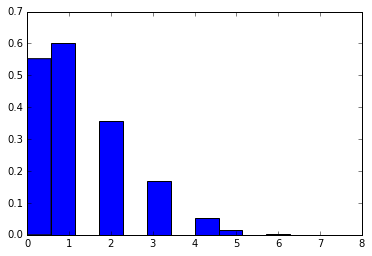

1
0
4
2
4
4
0
0
2
3
1
3
3
2
3
2
3
0
1
0
0
3
0
3
4
0
0
1
4
0
2
4
1
0
1
0
1
0
3
1
0
6
0
0
2
0
3
1
0
0
1
2
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
2
0
1
1
1
1
1
0
0
0
1
0
1
3
1
1
1
0
2
0
0
0
0
0
2
0
1
2
0
1
5
4
1
3
1
3
3
2
0
0
4
2
1
2
0
3
0
1
0
2
1
1
2
4
0
1
2
0
2
1
0
0
3
0
2
1
0
1
2
1
0
0
1
1
3
3
5
1
0
1
2
1
1
1
2
0
1
0
2
3
2
3
0
0
1
1
4
1
2
3
4
2
1
1
0
0
1
3
0
0
1
1
1
1
1
1
0
1
1
2
2
0
2
1
0
0
0
1
3
0
3
0
2
3
1
4
1
1
0
3
2
1
1
0
2
1
1
2
0
1
1
1
0
0
1
4
1
5
4
0
2
1
5
1
1
1
0
4
3
1
4
2
0
1
1
0
1
0
3
2
3
2
0
0
3
1
2
1
3
1
1
0
0
1
0
0
2
2
1
1
2
2
2
1
2
4
0
2
2
1
3
2
1
4
1
1
0
1
2
0
2
0
0
1
1
1
1
1
0
1
2
0
1
2
0
1
3
2
1
0
4
3
4
2
1
2
2
2
1
0
0
0
0
0
0
1
1
0
0
2
0
0
1
2
1
0
1
0
1
0
1
0
0
4
0
0
0
1
0
2
2
0
1
3
2
0
1
2
4
0
3
3
5
3
1
1
0
0
1
1
0
1
2
1
2
1
1
2
0
1
2
0
2
0
0
1
1
2
0
0
0
0
0
2
0
2
2
0
1
1
1
2
0
0
0
0
1
2
2
3
4
1
0
1
1
0
2
3
3
2
0
4
3
1
0
0
0
0
2
1
2
2
1
0
5
0
1
0
1
1
2
1
1
3
2
1
2
0
1
1
0
2
3
3
0
1
0
0
0
0
2
1
1
1
2
0
1
0
0
0
0
0
1
1
1
0
1
2
2
1
1
2
2
0
0
2
3
0
1
2
0
0
2
1
1
0
2
0
2
1
0
0
0


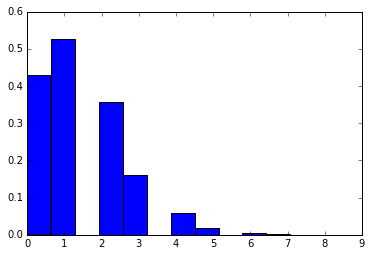

2
3
1
0
3
4
4
0
1
3
0
1
1
1
1
2
1
2
1
1
2
1
4
1
1
2
2
2
2
1
2
2
4
4
2
2
1
1
0
2
1
1
0
1
1
2
1
1
3
1
3
2
0
2
4
1
1
0
0
0
0
2
0
0
2
1
0
3
0
1
1
0
1
2
0
1
0
1
2
2
3
2
1
1
1
2
0
1
0
2
1
1
1
1
1
2
1
3
1
2
1
3
2
1
0
0
1
2
1
2
3
1
2
0
3
2
1
0
2
1
2
3
0
0
1
2
3
1
1
1
3
1
0
0
1
3
1
1
4
1
1
1
0
1
5
3
0
0
2
1
1
0
1
1
2
2
1
1
1
1
2
1
0
2
1
3
1
4
2
2
2
1
1
0
0
1
0
2
3
1
5
1
1
2
1
1
1
0
1
1
0
1
0
1
1
0
3
2
2
1
0
1
0
1
1
1
2
2
1
2
2
2
0
1
2
3
1
0
0
2
3
0
2
0
1
2
1
2
1
0
2
1
0
2
2
3
3
0
2
1
1
0
0
1
1
1
3
2
1
2
1
3
2
3
4
3
2
3
4
1
0
3
1
0
0
3
0
1
2
2
3
1
0
1
0
1
1
0
0
1
2
0
0
0
2
4
3
2
3
4
1
2
2
0
2
0
0
1
2
0
2
2
2
1
2
1
0
2
2
0
2
2
1
1
0
0
0
1
1
2
1
0
1
2
2
0
1
1
1
1
3
5
1
3
2
0
1
0
0
0
2
1
1
2
0
3
2
2
2
0
1
0
2
0
2
0
3
1
1
1
2
0
0
1
0
3
2
1
2
0
1
0
0
1
0
0
1
4
0
0
0
2
0
1
2
3
4
2
2
0
2
1
2
1
2
1
0
0
1
1
0
0
2
0
0
2
1
3
2
0
2
3
1
3
3
3
2
0
1
2
3
1
2
2
0
2
0
0
4
0
1
1
0
1
1
1
1
2
3
2
2
4
3
0
1
1
3
2
3
2
0
1
2
0
0
1
1
0
3
2
2
2
2
1
2
1
0
2
0
0
0
1
2
0
2
0
1
2
2
2
3
1
3
1
1
1
2
1
1
0
0
2
1
3
1
0
2
2
2
1


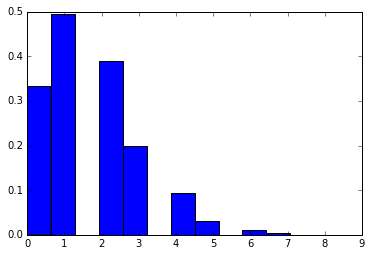

3
1
1
1
1
0
2
1
2
2
1
1
2
1
1
3
2
2
0
2
1
1
0
1
0
0
1
1
0
1
2
2
0
4
3
0
2
2
1
3
3
1
1
4
1
2
0
0
3
0
3
0
1
2
3
1
0
1
1
2
3
0
2
1
2
1
0
0
0
3
0
1
0
2
1
1
0
2
0
1
1
2
2
1
2
1
1
0
2
2
3
0
4
6
0
0
1
0
2
1
2
0
2
1
1
1
2
1
3
1
3
1
2
1
2
2
0
2
2
0
2
0
0
1
3
1
0
0
1
1
1
2
4
0
2
2
3
2
3
3
0
4
2
7
3
2
2
0
2
0
1
0
0
2
2
1
3
0
3
2
1
1
0
5
2
1
1
3
3
2
1
0
0
0
1
0
1
2
1
0
1
1
2
3
3
2
1
2
3
1
2
1
2
5
0
4
2
1
2
4
3
2
5
2
2
7
4
1
3
2
1
5
0
1
4
3
0
2
0
0
2
1
0
0
3
2
1
2
0
2
1
2
3
1
1
3
2
1
0
3
1
0
1
1
0
1
1
3
1
0
2
2
0
2
4
1
3
1
1
1
0
1
2
0
2
1
2
3
4
2
1
4
4
1
1
3
2
2
0
0
1
1
1
1
3
0
1
2
7
1
1
3
1
1
0
2
1
2
3
2
3
2
4
5
2
1
2
2
3
2
3
2
1
0
2
1
0
0
1
1
1
0
3
0
0
1
4
2
3
2
5
2
2
1
1
1
1
1
4
4
2
1
1
0
1
3
1
1
3
3
1
1
2
3
1
1
2
2
2
2
3
1
2
1
0
2
1
1
0
1
0
2
2
2
1
1
1
4
1
1
2
2
2
2
1
1
2
1
1
1
2
4
1
8
0
4
0
2
3
2
0
0
0
1
3
0
2
1
2
1
1
2
0
1
0
0
2
1
1
2
0
1
2
2
1
1
2
1
1
1
2
3
3
2
3
2
1
4
1
2
2
1
1
0
2
2
2
3
1
2
1
1
1
1
1
4
1
2
2
3
3
0
3
0
3
1
2
1
1
2
1
1
0
3
2
2
1
2
2
1
0
4
2
1
2
5
1
1
2
2
1
1
2
2
3
2
1
0
3
1


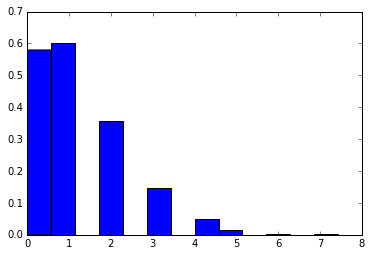

1
2
3
0
2
2
1
0
3
3
3
4
2
2
0
1
1
2
0
1
0
1
0
1
1
0
0
0
3
1
1
1
2
0
0
3
0
0
1
1
1
3
1
0
0
3
1
1
0
1
0
0
0
1
2
1
0
1
0
1
2
0
0
3
2
1
2
3
0
1
1
1
0
2
1
3
2
0
0
0
1
1
0
1
0
3
0
0
0
2
0
1
0
0
2
2
2
1
1
1
3
2
2
1
4
3
0
0
1
0
2
3
0
0
1
3
0
0
1
2
1
2
1
3
1
1
1
2
1
0
3
5
1
0
1
0
1
3
0
0
1
0
3
2
0
1
1
0
0
0
1
0
4
0
3
2
0
1
0
2
1
1
3
2
1
2
0
2
2
4
0
0
3
1
0
2
0
2
0
2
1
1
2
0
0
0
1
0
0
0
0
1
0
0
2
2
2
1
1
2
2
0
2
1
2
1
3
2
0
2
0
0
3
4
2
3
5
5
1
0
2
3
1
5
3
3
1
0
3
0
0
1
0
0
0
0
2
1
1
2
1
4
2
2
2
2
1
1
1
1
1
1
0
1
2
1
1
1
0
0
2
0
0
1
0
0
4
0
5
1
2
0
0
0
3
0
1
2
2
0
1
0
1
1
1
0
1
1
0
0
2
2
2
5
1
3
4
0
0
0
1
0
0
0
0
0
1
2
5
2
1
3
1
0
2
0
0
2
0
2
1
4
0
2
3
2
0
1
1
0
0
0
1
1
1
1
1
1
2
1
0
0
2
0
3
0
1
1
2
0
1
4
0
1
2
0
2
0
2
3
3
2
0
0
0
0
0
1
2
3
1
1
1
1
0
0
2
1
1
2
0
2
0
0
1
0
0
0
1
0
2
0
1
2
1
4
0
1
2
1
0
1
1
2
3
0
1
1
3
2
2
2
1
0
1
1
0
1
2
2
1
0
1
0
0
3
1
0
2
1
1
1
2
1
0
1
2
1
1
2
3
3
2
1
2
2
1
1
0
2
1
2
0
0
2
0
3
0
2
0
1
2
2
1
2
1
0
1
3
1
1
5
0
0
4
0
3
3
1
2
4
1
1
1
0
2
0
0
0
1
1
2
1
2
1
2
1
1
0
0


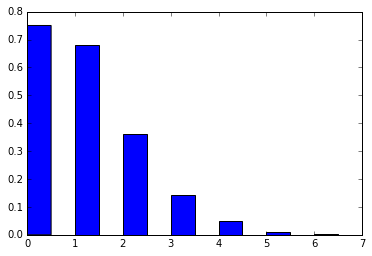

2
1
3
2
0
1
2
2
2
0
1
1
4
2
1
1
3
1
2
1
0
0
3
0
2
2
0
2
0
2
0
3
2
1
1
0
0
1
1
2
1
2
2
2
0
1
0
0
1
0
0
2
0
3
2
3
0
3
2
1
1
1
2
3
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
2
1
2
1
1
1
2
2
0
1
1
2
1
2
1
1
0
0
1
0
1
0
1
0
1
1
0
1
0
4
1
0
1
1
1
1
1
0
2
1
1
0
0
0
1
0
1
0
0
0
0
2
0
1
1
3
1
1
0
0
0
2
0
1
0
1
0
1
1
1
1
0
1
4
1
0
3
1
0
0
1
0
1
2
1
0
0
0
1
0
0
0
0
0
1
0
0
2
0
0
2
0
1
1
0
1
0
0
1
3
2
3
1
2
1
0
2
2
0
2
2
4
1
0
2
1
1
1
0
1
4
1
1
2
0
0
1
2
0
1
1
0
0
0
0
1
1
2
0
2
0
1
0
1
1
2
3
2
1
1
0
2
0
1
1
1
0
0
1
1
0
3
1
1
2
1
0
0
1
0
1
1
0
2
3
2
2
1
2
1
0
0
2
1
0
0
2
1
2
1
0
2
0
3
1
2
0
1
1
0
1
0
0
1
0
1
2
2
3
1
0
1
4
1
1
0
2
2
1
1
2
0
0
0
1
1
0
4
0
0
2
1
0
2
0
3
4
0
1
2
3
0
0
0
2
2
0
1
0
1
0
0
0
0
1
1
2
1
0
0
1
1
1
2
0
0
2
0
0
2
1
1
0
0
0
1
1
1
0
0
1
1
1
3
3
0
1
0
0
1
2
0
0
1
1
0
2
2
0
0
2
0
0
1
0
0
1
1
0
2
1
1
1
0
2
0
0
0
1
1
1
1
1
0
1
1
1
1
0
1
0
1
0
0
3
1
2
2
2
0
0
3
1
1
1
0
0
1
0
1
1
2
1
0
2
0
1
1
0
2
0
0
0
1
0
0
2
0
0
1
2
0
0
1
1
1
1
1
1
0
0
1
1
0
1
1
2
0
0
2
0
0
2
1
1
1
1
1
2
1
0
2
1
3
0


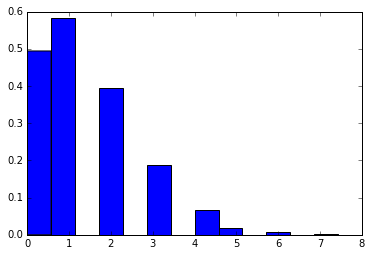

2
3
2
1
0
1
0
0
0
0
0
2
3
1
2
3
0
6
0
3
1
1
1
1
1
3
0
0
3
1
0
2
2
1
2
0
0
0
0
1
2
0
0
3
3
2
1
1
0
2
0
0
2
1
0
2
2
1
2
1
2
1
3
1
1
1
1
2
0
4
1
1
2
2
0
1
1
0
0
0
1
0
1
2
4
0
3
0
0
1
0
4
1
6
1
1
4
4
2
0
0
1
1
3
3
2
1
0
3
1
1
1
1
0
1
1
1
0
5
2
2
3
0
1
1
2
1
0
3
3
1
0
1
1
1
0
1
1
0
2
2
1
2
1
2
1
4
1
1
0
0
2
0
3
1
3
1
0
1
2
3
1
0
1
1
0
2
1
3
1
1
0
2
1
2
1
2
1
1
1
2
1
0
0
2
1
2
1
0
0
3
3
1
0
0
0
0
2
0
2
0
0
2
0
3
1
3
0
0
2
3
1
1
2
0
4
1
2
0
2
1
1
4
1
4
2
4
1
1
3
0
4
1
4
2
1
3
4
3
0
1
0
0
0
0
3
1
0
1
2
2
0
0
0
2
1
0
0
3
1
2
0
2
0
2
1
0
3
2
1
2
0
2
1
0
4
1
2
1
1
1
2
0
1
2
2
1
4
1
1
3
1
3
1
3
2
3
1
1
2
2
3
3
3
0
0
0
2
1
1
1
1
1
4
0
2
0
0
1
1
0
0
2
1
1
2
1
3
0
2
2
1
0
0
1
1
1
0
1
0
0
0
2
1
1
3
1
2
3
1
0
3
1
0
1
0
0
0
2
3
1
1
1
1
1
0
4
2
2
1
3
1
1
0
2
0
1
0
2
1
2
4
1
2
1
1
0
0
2
0
1
0
1
0
2
2
1
1
0
1
5
1
1
0
2
1
0
1
0
1
3
0
1
1
0
0
1
2
1
0
1
1
1
4
3
1
2
3
3
1
0
2
2
3
0
5
0
1
0
4
7
3
0
3
3
1
4
2
2
3
1
2
1
0
0
0
1
1
0
2
0
0
0
3
2
1
0
2
0
0
2
2
0
1
0
1
3
1
0
3
3
2
1
2
1
1
2
3
2
1
1
0
2
3
3
1
2
4
3
1


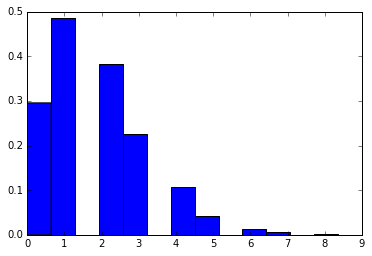

1
2
1
4
1
3
5
3
1
1
3
1
2
2
0
0
1
3
2
1
1
4
2
6
4
0
1
0
0
1
0
3
3
1
1
3
0
1
1
1
2
1
0
2
2
7
3
3
2
1
2
0
3
0
1
0
1
1
1
1
0
3
4
1
2
1
1
3
0
1
0
1
2
0
1
1
1
2
0
1
4
3
0
1
1
1
1
1
0
1
2
5
0
2
2
1
1
1
2
4
2
2
0
2
2
2
2
1
2
2
0
2
0
2
1
3
1
0
2
1
2
1
4
1
2
0
3
0
3
3
2
0
1
0
2
2
4
4
0
1
2
0
1
0
1
1
3
1
0
1
0
1
1
2
3
3
1
2
2
1
3
4
5
1
1
2
0
0
2
2
3
4
3
2
2
1
3
1
2
1
0
0
3
0
1
0
3
1
1
0
2
0
1
2
2
0
2
2
1
2
0
1
0
2
4
0
4
1
2
0
1
2
1
2
1
1
0
1
0
1
3
0
2
2
0
4
2
0
0
3
0
2
1
1
2
0
1
2
2
1
3
1
2
2
2
2
2
3
0
2
0
1
2
3
2
0
2
0
1
3
1
1
3
1
2
0
1
1
6
2
2
0
3
4
0
0
5
1
5
0
2
1
5
2
8
5
1
0
3
3
0
2
0
5
2
0
0
0
1
2
3
2
2
2
2
0
2
1
3
3
0
3
1
1
2
0
0
1
1
2
0
1
2
4
1
2
2
1
1
2
0
0
2
1
3
0
1
1
0
0
3
1
2
1
4
0
1
5
0
1
2
2
3
0
0
2
1
3
4
0
2
3
3
2
4
3
1
2
1
0
2
3
2
3
1
0
1
0
1
0
1
3
3
2
1
2
4
2
1
2
0
2
1
2
2
1
3
0
1
2
4
2
1
3
3
3
1
3
1
1
2
1
2
1
3
1
0
0
2
3
3
1
0
2
1
0
3
2
2
2
1
1
1
0
3
3
3
4
2
3
1
4
4
5
2
1
2
3
3
1
0
1
1
0
5
0
2
1
1
0
3
1
0
2
0
2
0
3
5
2
3
5
0
1
1
2
2
1
0
3
3
1
1
4
1
2
0
1
4
1
2
0
2
4
1
0
2
1
1
2


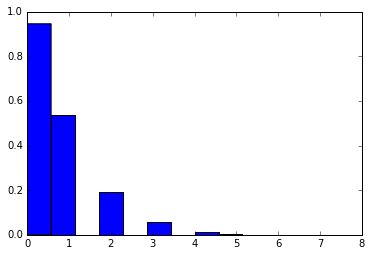

0
1
0
0
0
1
0
0
0
1
0
1
1
0
2
3
1
3
1
0
3
2
1
0
0
0
0
0
0
2
1
2
0
1
3
0
2
0
0
0
0
0
0
1
2
0
1
0
0
2
1
1
0
1
1
2
2
0
0
3
0
3
3
0
0
1
1
2
0
1
1
1
0
1
1
4
0
0
0
1
1
3
0
0
2
0
0
0
0
2
0
1
0
0
0
0
0
4
1
2
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
1
1
1
0
0
2
1
2
0
0
0
0
0
1
0
0
1
0
0
1
1
0
0
1
1
1
0
0
0
1
1
1
0
0
0
0
2
0
0
2
1
3
0
1
0
1
0
2
0
1
3
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
3
1
2
1
1
0
0
1
3
1
0
0
0
1
1
0
0
2
0
2
2
1
0
1
1
0
0
1
1
0
1
2
0
1
1
1
2
1
3
2
1
0
0
1
0
2
2
1
0
1
1
3
0
0
0
0
0
2
1
1
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
2
1
1
2
0
0
2
0
1
1
0
0
0
1
5
1
2
0
1
2
1
0
6
2
1
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
2
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
1
0
1
1
2
1
0
2
0
1
0
0
0
1
0
0
0
0
0
0
0
1
3
1
0
1
0
1
1
1
1
0
0
0
0
2
2
2
1
1
1
1
0
0
0
0
0
1
0
2
1
0
0
2
1
1
2
3
1
0
0
1
1
1
1
1
0
1
0
0
0
0
1
1
1
1
0
0
0
1
0
2
2
1
3
2
0
1
0
0
2
1
2
0
1
2
0
0
0
0
0
0
0
1
1
0
1
1
2
1
0
0
0
0
3
1
0
1
1
0
2
0
0
0
0
0
1
1
0
1
0
1
0
1
2
0
0
0
0
0
1
0
2
0
0
1
1
0
1
2
2
0
0
2
0
0
1
1
1
1
1
0
0
1
0
0
0
1
0
0
2
0
1
0
1
1


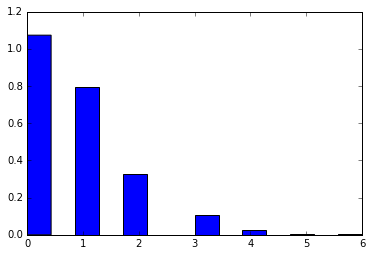

1
0
0
0
1
3
3
1
1
1
1
1
0
1
1
2
2
0
0
1
2
1
1
2
1
0
0
0
0
0
1
0
1
0
4
2
0
2
3
2
0
0
0
3
1
0
0
1
0
0
0
0
0
2
0
1
0
0
0
1
2
1
0
1
0
0
1
2
0
1
1
1
1
0
0
0
0
2
0
1
0
3
1
0
4
0
0
0
0
1
0
3
2
1
0
1
1
1
2
2
0
2
1
0
0
0
1
1
2
1
1
0
1
0
0
1
1
1
1
3
3
0
1
1
0
0
0
1
1
0
2
1
1
0
0
1
1
2
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
3
1
0
0
2
1
1
0
0
0
1
0
0
1
1
2
1
0
0
2
2
0
2
0
0
1
0
0
0
0
0
1
0
0
0
1
2
0
0
2
1
1
2
1
3
2
3
2
2
0
1
4
0
1
1
1
1
3
1
2
1
2
2
1
0
2
1
5
0
3
0
0
0
0
1
1
1
1
1
0
1
1
2
0
0
0
1
3
0
2
0
0
0
0
0
1
2
1
0
1
3
0
0
0
1
0
1
1
0
1
0
0
0
0
2
1
2
0
0
0
0
0
2
1
1
0
1
0
0
1
0
0
1
0
0
1
2
0
2
5
1
0
1
3
4
1
1
1
0
2
0
0
3
1
0
0
0
1
0
0
1
0
2
0
1
1
0
1
0
3
0
1
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
2
1
0
1
0
0
1
0
3
2
2
1
2
0
2
0
4
2
4
3
2
1
1
0
1
1
0
2
4
0
0
1
1
1
1
0
1
0
1
1
0
1
0
2
0
1
1
1
1
2
1
1
0
1
0
1
0
0
1
1
1
2
1
1
0
1
1
0
0
0
0
1
1
0
1
1
2
0
1
0
1
0
1
0
1
0
2
0
2
2
2
0
1
1
1
4
0
0
1
1
0
1
1
2
0
0
1
0
0
2
4
0
1
0
2
1
2
3
1
0
0
0
0
1
0
1
2
1
1
0
2
0
2
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0


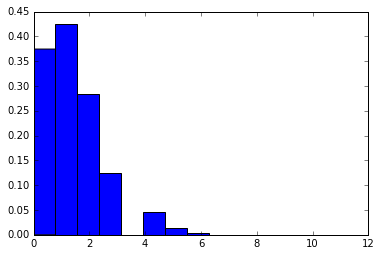

3
2
1
2
2
1
0
1
2
0
1
1
5
0
2
1
0
4
1
1
2
1
0
2
2
2
0
0
0
1
1
1
0
3
1
2
0
2
2
2
1
2
1
2
3
2
0
1
1
2
2
1
4
4
1
2
2
1
1
4
1
3
1
0
0
2
0
1
0
1
1
0
2
0
1
2
0
1
1
1
2
2
3
0
1
1
0
3
0
2
1
2
6
1
5
3
3
1
1
2
0
2
0
1
1
1
3
0
0
2
0
0
0
0
1
1
2
0
1
2
1
1
2
2
0
1
2
0
1
0
0
0
0
1
0
2
0
0
0
3
2
1
0
0
1
1
1
0
2
4
1
4
3
1
2
3
2
2
4
4
1
0
0
1
0
3
2
3
2
0
1
1
2
1
0
0
1
1
0
1
1
1
2
1
0
0
0
1
2
1
0
0
0
0
0
0
2
3
2
1
3
1
1
3
1
2
3
2
0
2
6
0
1
1
3
3
1
1
0
0
1
2
1
2
6
0
1
3
3
2
0
0
0
0
0
2
1
0
2
1
1
3
2
2
0
2
2
1
1
1
3
0
0
0
1
1
0
1
2
2
0
3
1
0
2
1
0
1
2
1
1
0
2
2
2
0
1
0
0
0
2
1
2
1
2
1
2
1
4
2
4
3
2
2
2
0
5
2
1
2
1
3
0
1
1
1
1
2
3
3
0
3
0
3
1
2
0
0
0
2
0
1
0
0
2
1
0
1
1
2
0
6
3
2
1
0
0
0
0
0
1
2
1
0
0
2
2
2
2
1
4
0
1
0
2
1
0
1
0
3
0
1
0
1
0
5
0
0
1
1
2
1
2
1
3
0
0
2
2
3
3
3
2
1
3
1
0
1
1
1
0
1
3
1
2
0
2
2
1
4
0
1
0
1
2
4
0
0
2
1
3
1
1
1
0
2
2
1
1
0
0
0
1
0
1
2
3
2
0
1
1
1
3
2
3
4
2
0
2
3
1
2
3
0
1
1
1
2
1
4
2
1
1
0
2
1
0
2
1
4
0
1
1
0
1
1
0
0
2
0
2
2
5
1
2
3
1
3
2
0
2
1
0
3
1
2
0
2
3
1
0
0
4
1
0
1
3
0
1
1


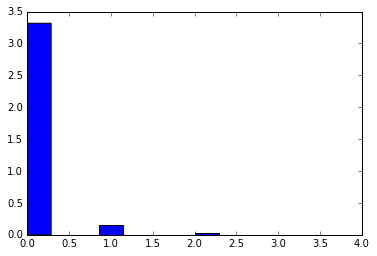

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
3
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
3
2
3
1
0
1
0
0
0
2
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


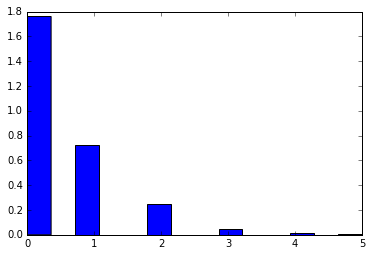

0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
1
1
0
1
2
1
1
0
5
2
2
3
1
1
1
1
0
0
0
0
0
1
0
0
0
0
1
4
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
2
0
1
0
0
2
0
1
4
1
0
3
1
3
3
2
0
0
0
0
1
0
1
2
1
0
1
1
0
0
2
1
1
1
0
0
0
0
0
1
0
0
1
0
0
1
2
1
1
0
3
3
2
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
2
2
2
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
1
2
2
1
0
0
1
0
0
1
2
0
1
1
2
2
2
2
0
1
0
1
0
2
4
0
1
0
1
0
0
0
2
2
0
1
1
3
1
1
1
0
1
2
0
0
0
0
0
0
0
0
0
1
3
2
1
0
0
1
0
0
0
0
0
1
3
0
2
0
1
0
2
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
2
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
2
1
1
3
1
1
0
0
0
1
0
0
0
0
0
0
2
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
2
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
3
0
0
0
2
0
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
0
1
0
1
0
0
3
2
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
2
1
0
2
0
2
1
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
2
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
3
2
2
0
1
0
1
0
0
1
0
0
0
0
0
2
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
3
1
1
0
1
2
0
4
0
1
0
2
2
0


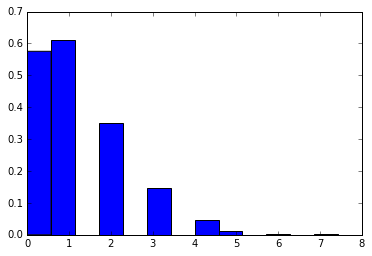

3
0
1
0
0
1
2
2
1
2
1
2
0
2
2
2
1
0
0
1
1
2
3
4
2
1
2
2
2
1
3
0
4
0
3
3
1
1
1
0
2
1
1
1
2
4
0
0
3
2
0
0
0
1
0
0
2
4
1
1
2
0
1
2
2
0
1
2
1
2
0
3
1
3
4
2
1
3
1
4
3
3
5
2
2
0
2
2
2
3
3
1
1
1
2
0
2
1
3
2
1
0
1
0
0
1
0
1
1
1
0
2
1
1
1
0
1
0
0
2
1
0
0
0
0
0
2
0
2
3
3
1
2
1
1
2
1
0
1
2
2
2
1
3
1
2
2
1
4
1
1
2
2
1
1
1
1
1
2
2
1
0
0
0
1
0
1
2
0
0
1
0
2
1
2
2
3
0
3
1
1
2
2
3
4
2
2
4
1
1
1
1
1
2
3
0
2
1
2
2
0
0
0
1
2
2
2
1
4
2
3
3
2
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
2
0
0
2
2
3
3
0
2
0
1
2
1
1
2
1
1
0
1
1
0
3
1
2
0
1
0
1
1
0
1
1
1
3
0
1
1
1
0
0
2
0
2
2
2
0
2
1
1
0
2
1
0
3
2
1
1
3
1
2
1
2
1
0
0
0
2
1
1
0
1
0
1
1
0
0
3
1
1
1
1
3
3
0
0
0
3
1
2
0
1
1
1
2
1
2
2
0
1
0
0
1
3
0
2
1
3
1
2
2
1
0
1
1
0
1
0
1
0
0
1
1
1
1
2
0
1
0
0
0
1
0
0
1
1
1
0
0
2
3
3
1
1
0
1
2
2
1
1
0
0
1
1
2
1
1
1
0
3
0
0
3
4
2
2
1
1
5
1
8
3
0
1
2
1
2
2
0
1
1
2
0
1
0
0
0
2
0
3
2
0
0
1
2
2
0
1
0
0
1
1
0
0
2
2
2
1
3
1
1
0
0
1
4
1
2
0
1
0
0
0
1
2
1
2
2
1
1
1
1
1
0
1
1
0
1
1
1
1
0
0
1
2
1
2
2
1
2
3
5
1
1
2
1
2
0
1
2
0
1
2
4
2
0
2


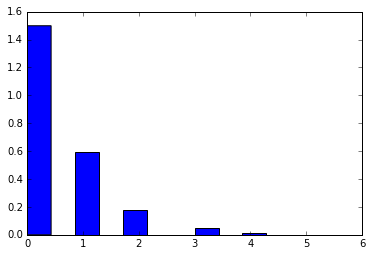

2
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
4
1
4
0
3
0
1
2
0
2
1
1
0
0
1
1
1
1
1
1
1
2
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
3
1
1
0
0
1
1
0
2
1
0
0
0
0
1
0
2
0
1
1
0
1
0
0
1
3
0
0
2
2
0
2
1
2
2
1
0
0
1
0
1
0
2
0
0
0
2
2
1
0
0
2
0
0
3
1
2
0
2
0
0
0
3
4
1
1
1
1
1
0
0
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
3
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
2
1
3
0
0
0
3
1
3
2
1
1
2
3
2
0
2
1
0
0
1
1
0
0
0
1
1
2
0
0
0
1
0
0
0
1
0
1
3
1
0
2
0
2
3
0
2
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
1
1
2
0
0
0
0
0
0
0
0
2
0
0
1
0
0
0
0
0
0
0
0
2
0
0
0
0
0
1
0
0
1
4
1
0
1
0
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
2
0
0
2
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
2
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
2
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
2
1
0
1
2
1
0
1
0
0
1
0
0
1
3
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
2
3
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
1
1
2
2
1
2
3
2
0
0
2
1
1
0
0
0
0
1
0
0
0
0
1
2
2
0
2
0
0
0
0
2
1
0
0
0
0
0
0


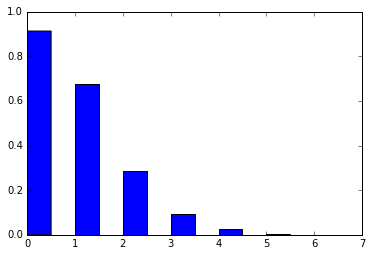

0
2
0
0
1
0
2
1
0
0
0
1
0
0
1
1
0
1
0
2
2
0
1
0
0
0
1
0
0
1
0
1
1
1
0
1
3
0
4
1
4
0
1
0
0
0
0
0
0
1
0
0
0
0
2
0
2
1
0
1
1
3
0
1
0
3
0
0
2
2
1
0
0
1
2
3
3
1
0
1
1
2
2
1
2
2
0
2
0
3
1
0
0
0
2
3
0
0
0
2
1
1
1
1
1
0
2
1
1
0
1
3
1
1
0
1
1
2
0
1
2
1
1
0
0
2
2
0
1
0
2
1
2
0
0
1
1
0
2
1
0
1
0
0
0
2
0
3
0
1
3
0
0
0
2
0
0
1
0
0
0
1
1
0
0
0
1
3
1
6
1
0
0
1
1
0
1
1
0
1
1
0
1
0
0
0
2
2
3
2
1
3
2
0
0
0
2
0
2
3
3
1
3
0
2
1
1
3
1
2
1
0
0
2
3
1
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
2
1
0
0
0
0
4
1
0
1
2
1
2
3
2
2
1
1
0
5
2
1
2
1
3
0
1
2
1
1
0
2
0
0
0
0
1
0
0
1
1
0
1
0
0
0
0
0
3
0
1
1
1
0
2
0
0
0
1
1
0
2
0
0
2
0
0
2
4
2
4
1
1
1
1
0
0
3
4
0
0
0
3
2
2
1
1
3
2
0
3
1
1
1
0
0
2
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
2
0
1
1
1
1
0
0
0
1
0
0
2
1
1
0
1
0
0
0
1
0
1
0
1
2
0
0
0
0
2
2
0
1
0
0
0
0
0
1
2
0
0
0
0
0
0
0
0
2
1
1
0
0
1
1
0
4
0
0
2
1
3
2
2
2
1
2
0
2
3
2
3
1
2
2
3
2
1
1
0
0
2
1
0
0
2
2
2
1
0
1
0
2
0
2
2
2
0
1
0
0
0
0
1
2
0
0
1
0
1
0
0
1
0
0
1
0
3
0
2
0
0
3
1
2
0
1
1
1
2
0
1
1
0
0
1
0
0
1
0
0
2
2
1
1
1
0
2
4
1
1
0
0
0
0


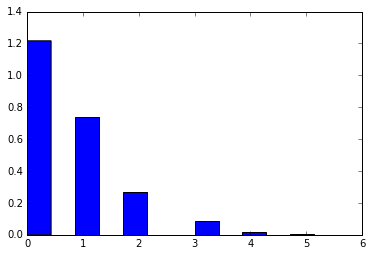

1
0
0
1
1
1
0
0
0
1
2
0
0
2
0
1
1
0
0
0
0
1
4
0
1
0
1
1
0
0
3
1
0
2
1
2
1
2
0
1
0
1
0
0
2
0
0
0
0
1
1
1
0
0
0
0
0
1
1
1
2
0
1
2
1
0
2
1
0
0
0
1
6
0
0
0
0
1
0
0
2
1
0
0
1
0
1
1
2
1
2
0
3
1
1
1
0
0
2
1
0
1
0
0
0
1
0
2
0
2
1
0
1
2
1
0
1
1
0
0
0
0
0
0
0
0
1
0
2
1
0
3
0
0
1
3
3
3
3
1
0
0
0
0
0
1
4
0
0
1
1
1
0
1
0
1
0
0
1
0
3
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
2
2
3
1
1
1
0
0
2
2
1
0
2
0
2
2
2
1
2
1
1
0
1
1
1
0
1
1
0
1
1
4
2
1
0
0
0
0
1
0
1
3
2
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
2
1
1
1
1
0
2
1
0
1
2
1
1
2
3
0
0
3
0
3
0
0
0
2
1
1
3
1
1
0
2
4
0
0
1
1
5
1
0
0
1
1
0
0
0
4
2
1
2
1
0
0
0
1
0
1
0
0
1
0
0
0
2
1
2
2
2
0
0
0
0
1
0
0
0
0
0
2
2
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
2
1
2
1
0
0
3
0
0
2
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
1
0
0
0
0
0
0
1
0
1
2
2
2
2
2
0
0
0
0
0
0
1
0
1
1
0
1
0
1
1
2
0
0
1
2
0
0
0
0
0
1
1
4
1
2
0
0
1
0
0
1
0
0
0
0
1
1
0
1
1
1
1
1
0
1
1
1
3
0
1
0
1
0
1
0
1
0
0
1
1
1
0
0
1
1
2
1
0
1
0
1
0
1
0
0
3
0
0
2
0
3
1
0
0
1
0
0
4
1
1
0
1
0
1
1
1
0
1
1
1
2
2
1
1
0
0
0
0
0


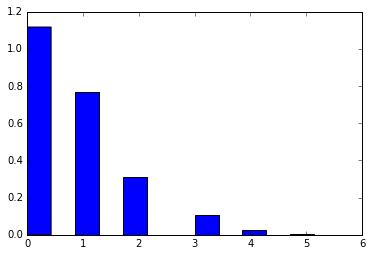

2
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
2
1
0
1
1
2
0
0
0
0
2
1
0
0
0
0
1
1
0
0
0
1
0
0
0
4
2
1
0
0
0
1
0
1
1
0
2
0
3
1
0
1
1
0
2
0
1
1
3
0
2
1
0
0
1
0
2
3
1
1
0
1
2
2
3
1
1
1
0
1
1
1
3
3
2
1
0
0
0
1
1
3
0
3
1
1
1
0
3
2
4
0
2
2
1
0
1
0
1
1
1
0
1
2
1
1
0
3
1
1
0
3
3
1
0
2
2
1
2
2
0
0
3
0
1
0
0
0
2
4
0
3
1
6
0
0
2
1
1
0
0
0
0
0
0
0
1
2
0
0
0
0
0
0
0
0
1
1
3
1
1
1
1
1
1
3
1
1
1
1
2
0
0
0
0
4
1
1
0
1
3
0
3
2
0
1
1
2
0
0
2
2
1
0
1
1
1
0
2
4
2
2
1
1
0
0
1
3
1
1
1
2
2
0
0
1
0
1
0
1
2
1
2
1
1
0
1
0
1
2
1
0
1
0
3
0
0
0
1
0
1
1
1
1
0
0
1
2
1
0
0
0
0
0
0
0
0
0
2
3
1
1
1
1
1
0
0
1
0
1
0
0
0
0
1
0
1
2
0
0
1
1
1
1
4
0
1
2
1
4
3
1
0
2
0
0
0
1
3
0
1
0
1
0
2
0
2
0
1
0
1
0
0
1
1
2
0
0
0
1
0
0
0
1
0
0
1
1
1
0
3
1
0
1
0
3
1
1
1
0
0
1
2
1
0
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
1
3
1
0
0
0
1
2
3
0
0
0
0
0
0
0
1
0
1
0
0
4
3
1
1
0
0
0
1
0
0
1
0
1
1
3
3
1
0
1
2
1
0
0
0
0
2
1
0
1
0
0
1
0
2
1
1
0
0
0
0
1
1
1
0
0
0
0
2
0
0
1
1
1
1
1
1
2
1
0
2
0
0
2
0
1
3
2
0
0
3
0
0
0
0
1
4
1
0
1
0
3
4
1
1
0
1
0
1
0
1
1
0
1
2
0
0
1
0
2
1
0
0


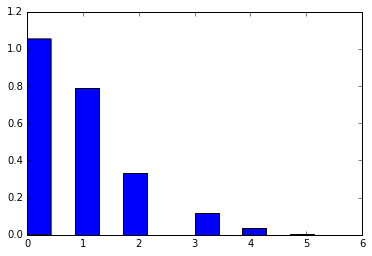

1
2
0
0
1
0
0
1
0
0
1
3
0
0
2
1
0
1
3
1
0
4
1
1
3
1
3
0
1
2
1
0
2
0
1
1
1
1
0
0
1
1
0
1
0
0
1
2
0
0
1
1
1
1
2
0
1
1
0
0
0
0
2
1
0
0
2
0
1
3
3
0
1
0
2
1
0
0
0
0
1
0
1
2
2
4
1
0
0
2
0
0
1
0
1
0
1
1
1
0
0
2
1
1
0
0
0
0
0
0
0
2
1
0
2
0
0
0
1
0
1
0
0
0
1
0
0
2
1
1
2
2
1
1
2
1
0
2
2
0
0
1
2
2
1
0
1
2
0
2
2
0
1
0
0
1
0
0
0
0
0
0
2
0
0
0
0
0
2
0
0
1
3
3
0
0
3
1
0
1
2
3
1
2
1
0
1
1
1
0
4
1
0
0
0
0
2
0
3
1
0
1
3
0
0
0
1
0
1
1
0
4
3
1
0
0
0
3
1
1
1
0
0
1
1
3
0
0
0
0
1
2
1
1
1
0
0
0
1
0
1
0
0
1
1
3
2
0
2
1
1
0
0
1
1
0
1
0
0
2
1
2
0
1
1
1
1
2
1
1
1
3
1
1
2
1
0
1
1
0
2
1
2
2
0
0
1
2
4
1
1
2
2
1
2
2
1
2
2
2
0
0
0
0
1
1
1
2
2
2
3
0
0
2
0
0
0
0
0
0
1
2
2
0
0
0
1
0
1
3
2
0
0
1
2
1
1
1
0
0
1
3
0
1
2
0
2
1
0
2
1
2
2
1
2
1
0
2
1
2
0
0
2
0
0
1
2
0
0
1
0
0
1
0
1
0
1
2
1
0
1
0
1
0
0
0
1
0
1
0
2
1
1
1
1
4
2
0
0
1
0
2
1
2
1
1
1
1
1
1
1
5
4
1
2
0
0
0
1
1
0
0
0
2
0
1
0
1
0
0
0
1
0
1
2
2
0
1
0
0
2
0
0
1
0
0
0
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
0
0
1
2
1
3
0
0
0
0
0
1
1
2
1
3
1
0
0
1
0
1
0
0
3
2
1
0
1
0
1
2
0
0
0
1
0
0


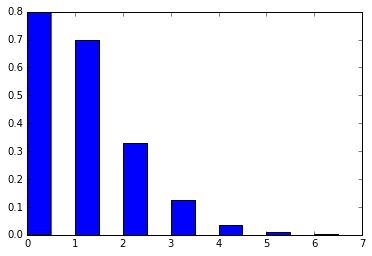

2
0
1
0
2
0
0
0
0
0
2
1
0
0
0
2
1
0
0
3
1
1
0
1
1
1
0
0
2
0
1
1
0
1
3
1
0
0
1
3
1
0
1
0
0
1
2
1
2
0
0
0
1
0
0
0
1
1
3
0
0
1
2
3
1
1
1
2
1
2
2
1
2
2
0
1
0
0
2
1
0
5
1
2
1
2
2
1
1
0
2
1
1
0
2
0
3
1
0
0
0
1
0
1
1
0
0
0
2
2
2
2
1
1
0
0
0
1
1
0
2
1
1
0
0
0
1
1
2
0
1
3
1
0
4
0
0
0
2
2
2
1
1
1
0
0
3
2
1
1
0
1
0
1
1
1
0
0
1
2
0
0
2
1
0
2
2
1
0
0
1
0
1
0
0
1
0
2
0
2
1
0
3
1
1
1
0
0
1
0
0
2
3
1
0
1
2
0
2
1
2
1
3
0
0
1
0
0
0
1
3
2
2
1
3
2
0
1
0
1
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
0
0
2
2
1
3
1
0
0
2
1
2
4
2
0
1
0
0
1
1
0
0
2
1
0
2
1
2
2
2
2
0
0
0
1
0
1
1
0
1
2
1
0
0
3
2
1
1
2
1
1
0
0
0
0
1
1
0
0
1
3
4
1
0
1
0
1
0
1
0
0
1
0
0
2
0
0
1
1
2
2
1
0
3
3
1
0
1
0
0
0
0
2
0
0
0
1
3
0
4
0
1
2
1
1
0
2
4
0
0
0
1
3
1
2
0
1
2
0
0
2
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
0
1
1
0
2
2
0
1
1
0
0
1
0
0
2
2
3
5
1
0
0
0
1
4
1
1
1
4
1
0
3
3
0
2
1
2
0
4
2
0
1
2
0
3
2
4
3
2
1
0
1
0
0
1
1
0
2
1
0
0
3
0
0
0
0
3
3
1
1
2
1
0
0
1
0
0
0
1
1
0
2
2
0
1
4
1
2
3
1
2
1
1
1
0
0
2
2
0
1
1
0
0
1
1
0
2
1
1
1
0
3
0
0
0
1
0
1
1
0
1
0
1


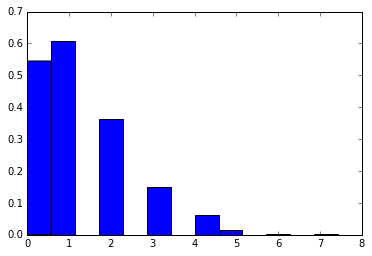

2
1
0
2
0
1
3
0
1
1
2
2
1
0
1
1
1
1
3
0
4
1
0
1
2
2
1
0
1
2
1
2
2
0
1
1
0
2
4
2
0
3
1
0
1
2
0
0
0
1
0
1
1
2
1
0
1
1
4
3
2
4
1
3
0
0
1
4
0
3
0
1
0
1
0
1
2
1
0
1
0
0
4
1
0
1
1
2
0
1
2
2
2
3
0
2
1
1
2
2
0
0
1
0
0
0
1
1
5
2
0
2
1
3
0
3
0
3
0
0
1
1
2
1
0
1
1
1
0
1
1
0
2
2
0
2
3
2
4
0
0
6
1
2
1
2
2
1
3
1
1
0
1
1
0
0
1
2
1
3
1
1
0
2
0
0
2
0
0
1
1
1
0
4
1
1
2
0
2
1
3
0
3
4
0
4
1
0
1
0
0
5
5
1
2
3
0
0
2
2
3
2
0
1
4
1
1
2
1
6
1
2
4
2
2
0
3
2
1
1
1
0
3
0
2
0
0
0
1
1
2
1
0
3
1
1
1
1
0
0
0
0
0
0
1
1
0
0
0
1
0
0
4
1
0
2
2
1
1
0
1
1
3
2
2
2
1
2
0
1
2
1
5
1
0
1
2
2
1
0
1
0
0
0
1
1
1
0
0
1
1
1
0
0
1
0
6
1
1
1
3
1
0
0
2
0
0
2
1
1
0
1
4
0
0
1
0
0
1
0
0
1
1
1
1
2
0
1
1
2
0
1
0
1
2
0
1
1
1
1
0
2
2
1
2
2
3
2
0
1
0
0
0
2
2
3
0
1
4
0
1
3
0
0
0
1
2
1
2
2
2
1
1
0
1
1
0
1
2
0
2
0
1
2
1
1
0
0
1
2
1
1
2
0
3
1
4
2
1
1
4
1
1
1
2
2
2
0
4
1
1
6
1
2
2
0
0
2
0
0
3
1
0
2
0
1
0
3
0
1
0
3
1
2
1
0
1
0
1
0
1
1
0
2
0
1
1
1
1
1
0
0
0
1
0
0
2
2
1
1
2
1
1
1
0
0
0
2
1
2
2
1
1
0
0
1
0
2
2
0
0
1
1
0
1
3
0
0
2
3
2
1
0
2
0
1
0
0
4
0


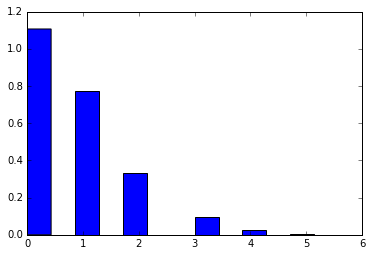

0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
2
0
1
1
0
0
0
0
3
0
1
0
0
0
1
1
1
0
2
1
2
1
1
0
1
1
2
0
2
0
0
0
0
1
0
0
0
1
0
0
1
0
2
1
0
0
0
0
0
1
0
1
0
2
0
0
0
0
0
0
0
0
0
3
2
1
3
1
1
1
0
1
1
0
2
3
0
1
0
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
2
0
3
1
1
0
0
1
1
2
1
0
0
5
1
0
0
2
2
1
1
1
2
0
0
1
0
0
0
1
0
0
0
0
0
0
2
0
0
0
2
0
2
0
1
0
0
1
3
1
1
1
0
0
0
0
0
0
1
1
0
0
0
2
0
1
0
3
2
3
1
1
0
2
0
1
0
1
0
1
0
1
1
2
1
2
0
1
2
1
1
1
0
0
0
1
0
1
0
0
0
3
2
1
1
2
0
1
0
0
0
0
1
0
1
1
0
0
1
1
2
1
1
0
0
0
1
0
1
2
1
2
1
1
0
2
0
1
0
1
1
0
0
0
3
1
2
0
3
1
0
3
0
1
0
1
1
1
0
0
0
1
0
2
0
1
1
0
0
1
0
1
0
0
0
0
0
2
0
1
1
1
0
0
3
0
2
0
4
2
0
0
0
0
0
0
1
0
0
1
1
1
1
1
1
1
1
0
1
1
0
2
2
2
2
1
0
0
0
2
1
1
0
0
2
0
1
0
0
0
1
0
1
1
0
1
1
2
1
1
1
0
0
1
1
0
0
1
1
0
1
0
0
1
3
0
0
0
1
0
1
2
2
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
1
1
3
3
0
2
0
0
0
0
0
0
2
1
1
3
2
0
1
1
1
0
2
1
1
1
4
1
0
0
1
0
0
0
1
0
1
0
0
0
2
0
0
1
0
1
0
0
4
0
0
0
0
0
0
0
1
0
0
0
2
0
1
0
0
0
0
3
0
3
0
2
0
3
2
0
0
0
0
1
1
0
3
0
1
0
2
0
1
1
0
0
0
1
2
1
0
0
2
1
1
0
0
0
1
0
0
0


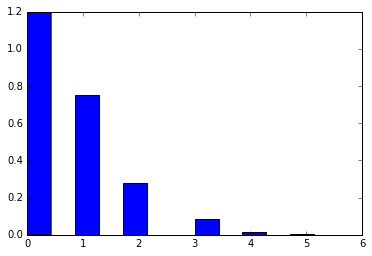

0
0
5
1
0
1
0
0
0
1
1
2
0
3
1
1
0
1
2
1
0
1
0
3
2
2
0
4
1
0
0
2
3
2
2
2
1
1
1
1
0
0
0
0
0
1
0
1
0
0
0
1
2
1
2
3
1
2
0
3
0
0
0
1
0
4
0
1
1
0
0
0
0
0
0
0
0
0
0
2
0
0
1
2
1
2
5
1
2
2
1
2
0
2
1
1
1
1
0
0
1
2
1
0
0
1
0
2
0
0
2
3
0
1
1
1
2
0
0
2
0
2
1
0
0
0
1
0
2
0
2
1
1
0
2
2
1
0
3
1
0
2
2
0
0
1
2
0
0
1
1
1
3
0
0
0
0
1
0
0
1
0
0
0
2
1
1
0
0
1
1
1
2
0
0
0
0
0
0
0
2
0
0
0
0
1
0
2
1
1
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
0
1
1
0
3
0
3
0
0
1
1
1
1
1
1
0
1
3
0
1
0
0
0
0
0
2
1
0
1
0
0
0
2
3
2
1
1
1
2
1
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
2
1
3
1
0
2
3
0
1
2
0
2
1
0
1
0
1
1
0
1
0
0
1
1
0
0
0
1
1
0
1
0
4
2
0
1
0
0
1
0
0
1
0
1
0
0
0
3
0
1
0
0
0
1
0
1
1
0
0
1
2
2
3
0
1
2
1
2
0
1
1
0
1
3
0
0
0
2
0
0
1
0
0
0
0
1
0
0
3
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
2
0
0
2
1
0
0
0
0
0
0
0
1
1
0
1
0
1
3
0
0
0
0
1
1
0
1
0
0
0
0
1
1
1
2
0
1
2
0
0
1
0
1
0
0
0
2
1
1
0
1
1
1
0
0
0
1
0
2
0
3
0
1
0
0
2
0
1
1
1
1
1
0
1
1
1
2
0
0
0
1
2
0
0
1
1
0
1
1
1
0
2
0
0
1
0
0
0
0
1
2
1
0
1
2
1
2
3
1
1
0
0
0
0
0
1
2
1
0


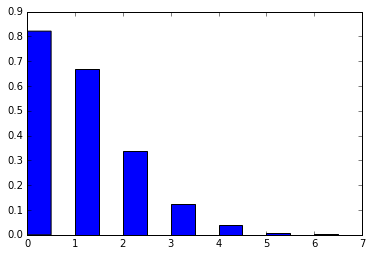

0
0
0
1
0
0
0
0
0
0
0
1
1
1
2
3
0
0
0
0
0
4
2
2
2
2
3
3
1
2
0
1
0
2
0
1
2
2
0
0
0
0
1
0
0
0
4
1
2
0
0
0
0
1
0
0
0
0
0
1
0
1
1
2
0
0
1
1
1
2
2
0
3
0
3
1
1
0
1
2
2
3
2
1
1
2
3
1
1
1
0
3
0
3
1
3
3
5
2
1
2
2
1
1
0
1
1
0
1
1
0
0
2
1
0
0
2
1
1
3
0
3
2
0
0
1
1
0
0
3
4
5
1
2
1
2
2
2
2
0
2
2
1
0
2
1
3
3
1
1
3
0
2
0
0
1
0
0
2
0
1
1
0
0
1
0
0
1
0
0
0
0
1
4
2
1
0
1
1
1
3
0
1
3
2
2
0
0
3
0
2
2
2
2
4
1
2
1
1
0
0
0
3
0
2
2
2
0
3
2
0
1
2
1
1
3
0
3
2
1
1
0
0
0
3
2
0
0
1
0
1
0
1
1
0
1
0
2
3
1
1
1
1
0
0
1
1
2
0
1
1
1
0
1
1
0
2
0
2
1
1
3
1
1
1
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
1
0
2
0
0
0
3
1
4
3
2
0
1
0
0
0
2
3
2
1
3
1
1
0
3
1
0
1
0
1
0
0
1
2
0
0
1
1
0
0
0
1
1
0
1
1
0
0
0
2
2
1
0
0
0
0
0
2
0
0
1
0
0
2
0
1
2
1
2
1
2
1
1
2
1
0
0
3
0
0
0
0
1
1
0
4
1
4
1
2
2
0
0
0
3
0
0
0
1
0
0
2
2
1
1
0
2
0
2
1
0
0
2
1
0
1
1
1
0
0
2
4
2
0
1
1
0
0
2
2
0
0
0
2
3
0
0
0
0
3
2
0
0
4
1
1
0
1
3
2
3
1
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
2
1
0
0
1
1
1
0
0
0
2
1
4
1
1
1
0
1
2
0
0
0
0
0
1
2
1
1
0
0
2
0
1
0
2
0
0
1
4
2
2
0
1
3
2
1
2
3
1
1
2
0
1


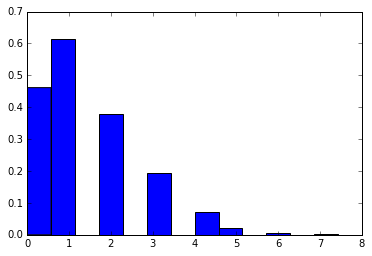

1
1
1
2
0
0
0
0
0
3
0
4
2
0
0
1
0
1
2
1
3
0
4
2
2
0
2
0
1
0
4
2
0
0
2
1
1
1
2
1
0
1
2
0
2
1
2
5
0
1
0
0
0
1
2
1
0
0
0
0
1
3
2
3
1
2
3
2
4
3
1
1
0
2
1
1
2
1
1
3
3
4
2
1
1
2
2
3
2
6
1
3
3
4
1
1
2
2
1
0
1
0
1
2
1
1
0
1
3
3
1
3
2
1
0
1
1
3
1
2
1
0
2
1
2
1
0
0
4
2
1
1
2
0
1
0
1
2
1
0
2
0
2
1
1
0
1
1
1
3
2
0
1
0
1
4
4
0
1
4
1
2
0
1
1
1
1
0
0
0
3
2
0
2
1
2
0
2
1
0
2
3
0
4
2
3
0
0
1
0
0
1
3
0
1
0
2
0
1
1
1
0
2
0
0
2
2
1
0
2
1
0
0
0
2
2
0
1
3
0
0
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
4
2
3
1
1
5
3
2
2
3
2
0
2
1
2
2
1
0
0
0
1
0
0
2
2
1
2
1
1
0
1
0
0
1
1
1
0
0
0
1
2
2
2
1
1
1
2
1
2
1
1
1
2
1
0
1
2
3
0
1
1
3
1
2
0
2
1
1
1
1
0
0
1
0
0
2
0
2
0
0
1
1
3
1
0
4
1
3
1
5
2
1
1
2
4
1
1
0
3
3
2
2
4
1
1
1
2
1
1
1
2
3
0
2
1
0
1
0
1
3
3
1
1
1
2
2
3
1
1
0
1
3
5
1
3
0
0
2
4
0
0
2
2
1
1
1
0
0
1
1
4
4
2
0
1
4
5
3
0
2
2
2
6
3
1
2
3
1
4
1
1
1
1
0
1
1
1
0
1
0
0
1
2
1
1
0
1
0
2
1
1
1
0
1
3
3
2
0
1
0
3
2
0
2
2
0
1
1
1
1
0
0
1
1
2
1
2
1
0
2
1
1
1
0
1
4
1
2
0
1
0
1
0
0
2
2
2
2
1
2
3
2
3
0
0
2
1
3
2
0
3
1
1
2
1
0
2
1
2
2
1
2
4


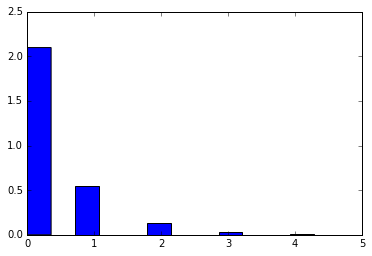

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
4
1
0
0
1
0
0
1
3
2
1
0
2
2
5
0
0
4
2
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
3
0
0
1
0
0
0
0
0
1
0
0
0
0
0
2
1
0
0
1
1
1
0
0
0
1
1
1
2
1
2
2
0
2
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
2
3
1
1
0
2
0
1
1
2
1
0
0
2
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
2
3
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
2
0
2
1
1
1
0
3
1
3
0
0
0
0
0
0
0
0
0
2
0
0
0
0
1
2
2
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
3
1
1
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
2
0
1
1
0
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
3
1
0
0
2
0
1
0
0
0
0
0
0
0
1
0
0
0
0
2
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
3
0
1
3
1
0
0
0
0
0
0
2
1
1
1
0
3
1
0
0
0
0
0
1
2
1
0
2
0
0
0
0
2
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0


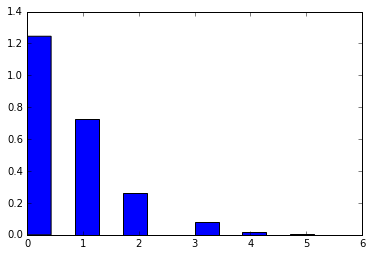

0
2
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
0
2
1
1
0
3
0
0
2
0
2
1
0
2
1
1
1
0
3
0
0
0
0
0
0
0
0
2
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
2
0
0
1
1
1
1
1
0
0
1
0
1
3
1
2
1
1
0
1
2
1
1
2
0
1
2
2
2
1
0
1
0
0
1
4
0
1
1
0
0
0
2
1
0
2
4
1
2
3
0
1
0
0
0
1
2
0
0
2
1
0
0
0
0
3
1
0
2
1
2
0
1
3
3
2
2
0
2
0
0
2
0
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
4
0
0
0
1
2
0
2
3
1
2
1
1
0
0
1
0
1
0
1
0
3
2
0
0
0
1
1
0
2
0
3
0
0
0
2
0
0
1
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
1
0
2
0
0
1
1
0
1
2
0
1
1
1
0
0
0
0
0
0
1
0
0
2
0
5
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
2
0
1
0
3
3
0
1
0
0
1
0
1
0
0
1
1
1
0
1
0
0
0
0
1
0
0
0
2
0
0
1
1
1
3
0
1
0
1
0
0
3
0
1
0
1
2
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
2
0
1
0
0
0
0
0
2
1
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
1
1
1
1
0
0
1
0
0
0
3
0
1
0
0
1
0
1
0
1
0
1
0
0
1
0
0
1
1
1
2
2
0
1
0
1
1
1
1
1
3
1
1
3
0
0
0
0
1
1
0
0
0
0
1
0
0
2
0
0
0
0
1
2
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
2
1
0
0
0
0
0
1
0
0
1
0
0
0
0
2
1
2
1
0
0
1
0
0
1
2
0
4
0
0
0
1
1
0
0
0


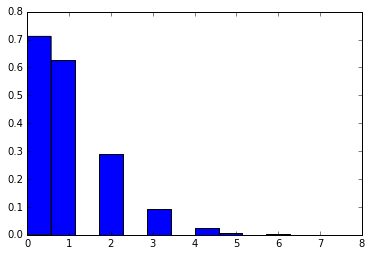

0
2
1
1
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
3
3
0
1
1
2
0
3
2
1
0
1
1
0
1
0
5
3
0
2
1
2
0
1
1
0
1
1
1
0
4
1
0
0
1
1
0
0
1
0
1
0
3
1
5
1
1
0
3
4
1
1
0
0
1
1
2
1
0
1
1
0
3
1
0
0
1
0
1
0
1
1
2
3
1
0
0
2
1
1
0
0
0
1
2
1
1
3
2
0
1
1
1
1
2
1
1
0
1
1
1
1
0
0
0
1
1
0
2
1
1
0
0
1
0
2
1
2
0
0
3
1
1
0
1
2
3
4
1
3
2
0
3
0
1
2
1
2
0
0
3
3
2
0
0
1
0
0
0
1
1
1
3
0
1
0
2
0
0
2
0
2
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
2
1
1
2
1
0
2
1
1
1
0
1
1
1
2
1
1
1
3
2
1
1
0
1
0
0
2
1
2
0
2
0
1
1
1
0
0
0
0
1
0
1
0
0
1
0
1
1
1
1
1
2
0
2
2
2
0
1
0
1
1
0
1
0
1
0
1
0
0
0
1
1
0
3
1
0
1
0
0
1
2
0
0
0
0
3
4
2
1
2
1
0
0
0
2
0
1
4
2
1
1
1
1
0
0
1
0
1
0
1
3
1
0
1
0
0
2
1
0
0
0
0
1
1
0
0
2
2
3
2
0
0
3
1
0
2
0
0
0
0
0
1
0
1
0
0
0
0
1
1
3
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
2
1
0
1
2
0
2
1
1
0
0
5
0
1
1
6
0
0
0
0
0
2
0
0
0
0
0
0
1
0
3
1
3
3
4
0
0
1
0
0
1
0
0
1
2
0
4
0
0
1
0
1
1
1
2
0
0
1
0
2
2
1
0
0
0
1
1
0
0
0
0
2
0
1
1
1
1
0
1
2
2
1
0
0
1
0
0
0
0
3
0
0
0
2
1
1
3
0
2
0
2
0
2
0
0
0
0
1
1
1
2
1
0
1
0
0
1
1
0
1
2
3
2
0
0
0
0
0
0
2
2


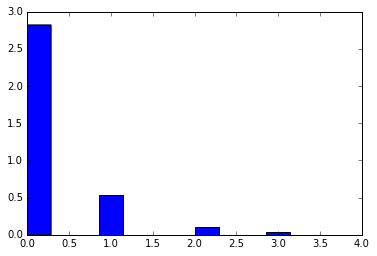

0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
2
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
3
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
2
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
2
0
0
1
1
0
2
0
0
0
0
0
1
0
0
0
0
0
0
1
3
1
1
0
2
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
0
4
1
0
0
0
0
2
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
2
1
3
2
0
1
1
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
1
1
0


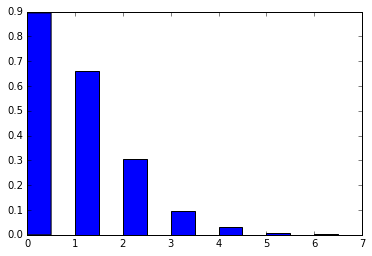

0
0
0
2
1
0
0
0
0
1
2
1
1
1
0
1
1
2
0
0
0
0
0
3
1
1
2
0
3
4
1
1
1
2
2
0
1
1
1
4
0
3
1
2
0
0
0
0
0
0
2
0
1
1
2
3
0
1
0
4
0
0
1
1
0
2
1
1
2
1
0
1
2
1
1
2
1
1
0
0
0
0
0
0
0
1
0
0
3
0
0
0
0
1
0
3
0
3
1
0
0
0
0
0
0
0
0
1
0
0
2
0
0
2
0
0
0
1
1
1
1
0
2
0
2
0
1
2
0
0
1
1
0
2
1
0
0
2
1
1
1
0
0
0
2
2
5
4
1
0
1
1
1
1
2
2
0
2
1
0
0
2
1
0
1
0
0
0
0
1
0
0
0
0
0
1
2
1
1
2
2
0
0
1
1
1
2
2
0
0
1
0
0
2
2
1
0
1
0
0
2
1
0
1
1
1
0
0
0
2
0
1
2
0
1
0
1
1
0
1
0
0
4
1
1
3
1
0
5
3
1
0
1
1
1
2
0
0
0
0
1
1
3
2
2
1
1
2
0
2
1
2
1
1
2
1
0
2
2
0
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
1
1
2
1
2
2
1
0
3
2
1
0
0
0
0
0
1
2
0
0
0
0
0
1
1
1
5
0
0
0
0
1
0
2
2
0
0
0
0
1
0
0
2
1
1
0
0
1
1
0
2
4
0
0
2
2
0
1
1
2
3
1
4
1
1
1
1
1
1
2
0
0
1
1
0
0
0
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
1
2
2
1
0
0
2
0
1
0
0
0
2
0
0
2
3
1
0
0
0
0
0
1
2
2
1
0
1
0
2
3
1
0
1
0
0
0
0
0
0
0
0
0
1
2
2
2
1
1
1
1
1
1
0
1
0
0
0
0
0
1
2
0
1
1
2
2
0
1
0
1
0
2
0
0
0
1
5
0
3
1
1
2
0
0
3
0
1
3
0
2
0
0
0
0
0
1
1
0
1
1
1
0
1
1
3
1
0
0
0
1
0
0
0
0
1
0
0
1
1
2
1
0
2
0
1
1
0
1
1


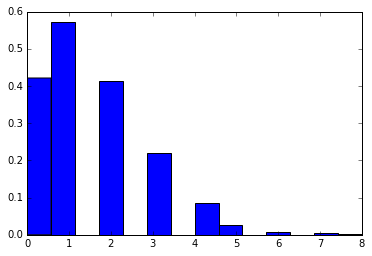

1
1
0
6
1
1
2
2
2
0
1
4
3
2
0
1
0
0
2
3
2
3
1
1
2
1
2
0
4
3
4
0
0
1
1
2
1
3
1
3
2
1
2
2
2
0
2
0
1
1
1
0
0
3
0
0
4
2
3
3
2
1
2
2
2
3
2
2
2
0
1
0
0
3
2
0
2
1
0
2
2
1
0
3
4
2
2
2
3
1
0
2
1
2
2
2
0
1
1
3
1
0
0
0
0
1
2
1
0
2
0
1
0
1
0
1
1
1
1
1
3
2
0
1
0
0
1
0
1
2
2
0
1
2
2
5
2
1
2
6
4
1
0
1
4
2
3
3
2
2
2
0
2
3
2
5
3
4
1
1
1
5
1
2
1
1
2
1
1
1
2
0
2
2
2
1
3
0
3
2
0
1
1
1
4
2
1
3
1
3
1
0
0
2
4
2
2
0
2
0
3
2
1
0
1
1
5
0
2
0
1
2
0
4
1
4
1
1
1
0
0
0
0
1
1
1
0
0
0
2
1
0
0
0
1
1
1
1
1
1
1
3
3
0
0
0
2
1
2
1
3
2
2
4
2
1
1
2
3
1
3
0
2
1
1
3
2
2
1
2
3
2
3
3
0
1
0
0
2
2
1
1
1
0
0
2
1
2
0
2
1
3
1
2
2
1
1
1
0
0
0
1
1
0
0
5
1
1
3
2
1
2
2
1
2
0
0
2
0
2
0
0
4
3
2
0
1
1
3
1
2
3
1
0
1
0
2
3
8
1
1
1
1
0
2
0
2
2
2
3
0
2
1
3
1
0
3
2
2
4
1
3
1
0
1
3
2
2
0
3
2
2
2
0
1
0
2
1
1
1
2
4
0
3
1
1
1
2
1
1
2
2
2
2
1
2
1
2
3
2
4
1
3
1
2
3
0
1
1
0
1
2
0
0
1
2
0
0
3
1
0
1
2
2
0
0
2
1
3
0
2
2
1
0
1
1
2
2
4
1
4
2
0
1
4
1
3
3
1
5
2
2
2
2
3
4
1
0
2
1
1
4
4
2
2
2
1
1
2
0
2
1
1
1
1
0
1
1
0
0
2
2
0
3
0
0
0
1
0
4
2
0
0
0
0
3
0
0
0
3


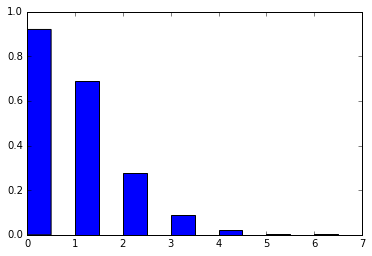

0
2
0
2
1
1
1
2
2
0
3
1
2
1
1
0
3
2
0
1
1
1
2
2
1
1
0
0
1
0
0
2
1
0
0
0
2
0
2
0
1
1
2
0
1
0
2
1
1
1
0
0
0
1
1
0
0
2
1
1
1
2
2
1
5
1
1
3
1
0
3
1
0
1
0
2
0
1
1
2
1
2
0
0
1
2
0
0
0
0
0
0
0
0
2
2
0
2
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
4
1
0
0
0
1
0
0
1
1
1
1
0
0
0
1
1
1
4
4
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
0
0
1
0
1
2
0
0
1
1
2
0
1
1
0
0
0
2
1
0
0
1
0
0
0
1
0
2
1
0
0
0
0
1
0
0
1
1
2
0
0
1
1
1
1
1
1
1
1
2
0
0
1
1
1
0
1
1
0
2
0
1
1
0
0
0
0
0
1
1
0
5
0
0
1
0
1
0
0
1
2
2
0
0
1
0
1
2
0
0
1
0
0
1
0
0
0
1
0
2
0
1
4
1
0
0
1
2
1
0
1
1
1
2
3
1
0
1
0
1
0
0
2
2
0
0
0
0
0
1
0
0
0
1
2
2
1
2
1
0
1
2
0
1
0
0
0
0
0
1
1
1
0
0
1
1
2
1
1
1
2
1
0
2
0
2
2
0
1
1
2
1
1
1
1
1
1
1
2
1
2
2
0
0
1
3
0
0
0
2
0
1
0
2
1
0
0
0
3
2
0
0
0
1
0
1
0
0
2
0
1
0
0
1
2
2
2
2
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
1
1
3
1
1
0
1
0
1
1
0
1
0
0
0
0
0
1
1
0
3
0
0
2
1
1
0
1
0
2
1
1
0
1
0
1
2
0
0
1
0
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
2
1
0
0
1
1
1
3
3
1
2
2
3
4
2
1
1
2
2
0
1
2
1
1
3
0
3
0
0
0
1
0
0
0
3
0
0
2
1
1
1
0
1
0
1
2
1
3
0
0
2
1
1
1
3


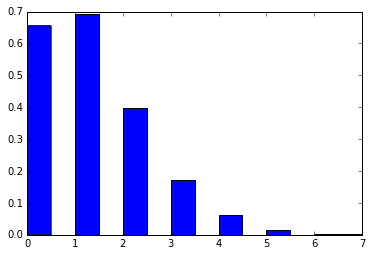

1
1
0
2
3
0
1
2
3
1
0
1
4
2
1
3
1
1
0
0
1
1
1
0
3
1
0
3
0
1
0
2
1
2
2
2
1
1
1
3
2
5
2
0
3
4
3
1
0
2
0
0
0
2
1
4
3
0
1
3
3
2
1
5
3
2
3
2
2
0
0
3
0
0
0
2
1
0
1
1
0
1
0
2
0
2
3
1
0
0
0
0
1
1
0
1
0
0
0
3
3
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
1
1
1
1
1
0
2
0
1
0
0
1
1
0
2
0
0
1
0
0
3
2
1
0
2
0
0
1
0
2
0
0
0
2
1
0
0
3
2
2
0
2
0
2
1
0
1
4
2
1
4
1
2
0
1
1
0
2
0
2
1
0
0
2
2
0
3
0
2
0
0
2
0
2
1
0
3
1
1
0
2
0
0
2
1
0
2
0
2
1
1
2
1
0
0
1
1
2
0
1
1
1
2
2
1
0
0
1
0
0
1
0
1
1
2
1
0
0
2
0
1
0
1
1
1
1
3
0
0
0
3
3
1
0
1
0
2
2
1
1
0
0
1
1
0
0
2
1
0
3
1
1
0
0
2
2
0
0
0
1
1
1
0
1
0
3
1
0
3
0
1
0
1
0
1
0
2
1
0
2
1
1
2
2
0
1
1
1
2
3
5
0
0
2
3
3
1
1
1
3
1
0
0
1
0
3
1
1
1
2
2
0
0
3
2
1
0
1
2
0
1
2
1
1
2
2
2
1
0
0
1
0
1
0
1
1
0
1
4
1
1
0
2
1
2
1
0
2
4
1
0
0
5
0
2
0
0
1
2
1
1
1
0
0
1
2
0
0
0
2
0
2
1
2
2
0
0
0
0
1
0
0
3
0
1
4
1
5
0
0
2
1
2
1
1
2
0
4
1
1
2
0
0
5
1
2
1
3
1
0
1
1
0
1
0
0
1
0
1
1
1
1
0
0
3
1
2
3
2
4
2
3
1
1
4
0
0
2
1
4
3
0
0
2
2
4
3
2
1
2
1
1
0
1
0
0
0
0
1
1
1
2
1
3
1
1
0
3
2
0
1
2
0
2
1
0
2
1
3
4
3


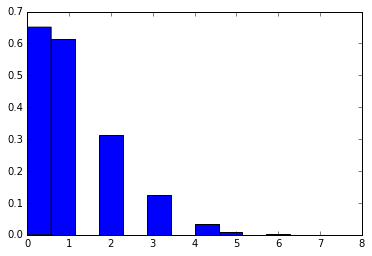

2
0
1
1
0
1
3
0
0
2
0
2
2
2
1
2
0
0
1
2
1
1
3
2
0
0
0
2
0
2
1
0
0
2
1
2
2
1
3
0
2
2
3
1
2
1
1
0
0
2
1
1
0
0
0
1
0
1
0
2
0
2
2
3
0
1
3
4
0
0
3
2
0
1
3
0
1
0
2
0
1
1
4
0
1
0
2
0
0
1
1
0
0
1
0
0
2
1
2
2
2
3
0
0
1
0
1
0
0
1
1
0
1
1
2
2
0
1
0
2
0
5
1
0
0
0
1
2
0
1
0
0
0
1
2
3
3
4
2
1
1
0
2
0
1
0
0
0
1
1
1
0
3
2
1
0
6
3
1
0
2
0
0
1
0
0
0
0
3
0
3
1
1
3
0
0
3
0
0
1
0
1
1
1
2
0
1
1
0
0
0
2
0
2
0
4
3
1
5
1
0
0
3
0
0
3
2
1
1
2
0
0
0
1
0
1
1
0
0
1
0
2
0
0
3
4
1
0
1
2
1
1
0
5
0
1
0
0
1
0
0
1
2
3
1
3
2
2
4
1
0
1
2
0
0
1
2
2
1
2
3
3
2
1
0
0
1
2
1
1
0
6
2
3
1
1
1
0
0
1
4
2
2
2
0
0
1
1
1
0
1
2
1
0
2
0
2
0
2
3
0
1
2
1
0
0
1
3
0
3
2
1
2
1
1
3
0
1
1
0
1
1
0
1
1
2
2
1
2
1
1
0
1
5
1
1
1
0
0
0
2
0
1
1
2
3
1
1
1
0
0
2
0
1
1
0
0
3
2
0
0
3
1
0
0
1
1
1
1
2
0
0
0
2
0
1
1
0
1
0
0
3
3
4
0
0
0
2
3
0
1
1
1
3
0
0
0
1
0
0
1
2
0
0
0
1
0
0
0
0
0
0
0
0
2
1
1
1
2
0
1
2
1
1
2
1
0
2
1
1
1
0
0
2
1
0
0
3
3
3
3
0
1
3
2
1
0
1
1
1
1
2
2
1
3
2
2
3
2
0
0
0
2
3
1
1
1
1
0
0
0
1
1
0
2
1
1
0
1
2
1
3
2
3
1
4
1
1
0
0
4
0
2
1
0
0
1
1
0
3


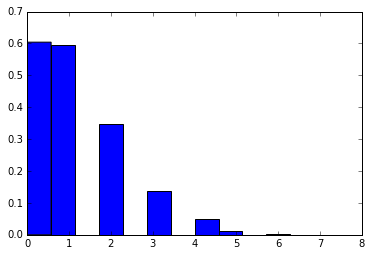

2
0
1
0
2
0
0
1
2
3
0
0
2
1
0
1
0
0
1
1
0
0
0
2
3
1
1
1
3
1
5
2
2
2
1
0
0
1
1
1
0
0
2
0
1
0
0
0
2
2
1
2
3
2
2
1
1
1
0
2
1
0
4
2
2
2
3
1
1
1
3
2
0
4
1
5
1
1
2
0
2
2
0
1
1
0
0
0
1
2
0
0
0
2
3
2
0
4
1
1
3
2
0
0
0
0
2
0
0
1
0
1
0
0
0
0
1
1
0
1
2
1
1
1
0
1
0
0
2
3
2
0
1
3
3
0
2
2
1
3
1
2
2
4
0
0
0
0
1
0
5
1
1
2
4
3
0
0
1
0
1
0
1
2
0
0
0
1
0
2
2
3
3
2
0
1
2
3
1
1
1
2
0
0
0
1
0
1
1
2
2
4
0
0
1
2
1
2
2
2
0
1
0
0
2
0
0
2
1
0
2
0
2
1
0
2
2
2
1
0
2
0
1
0
0
2
3
3
1
4
0
0
1
1
0
0
1
0
2
1
0
0
0
1
1
2
0
1
4
3
0
0
1
3
4
0
2
3
3
0
1
0
1
0
1
1
1
1
1
1
1
0
1
0
3
1
2
0
2
1
1
1
1
1
0
0
1
1
2
0
0
3
2
0
0
1
2
1
1
0
0
0
1
0
1
3
1
1
2
3
3
3
1
0
1
0
2
1
0
0
0
1
0
2
0
0
0
1
3
0
3
0
1
2
2
2
0
2
0
1
0
0
1
0
0
0
1
1
1
3
1
0
0
2
2
0
1
0
0
2
0
1
0
1
0
0
1
0
5
0
3
2
0
1
1
3
2
2
3
1
0
1
0
1
0
0
0
0
1
0
1
3
2
2
2
1
1
1
0
0
2
1
2
0
2
0
1
1
2
0
0
3
2
3
1
0
3
3
0
5
1
0
0
1
2
0
0
1
0
2
0
0
0
1
0
0
0
2
0
2
3
2
0
1
0
0
0
0
3
2
3
0
0
0
2
0
2
1
2
2
2
1
2
2
0
0
1
2
1
0
0
4
1
1
0
0
0
1
1
2
1
1
0
1
2
0
1
4
0
0
1
0
0
2
2
1
0
1
0
0


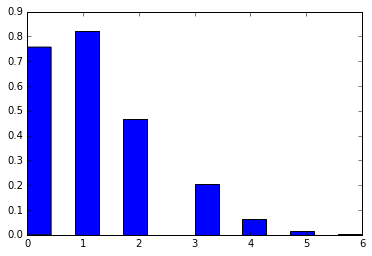

1
1
0
1
0
2
0
0
2
1
0
0
1
1
1
0
2
2
0
0
0
0
4
0
2
2
1
4
1
1
2
2
0
1
0
1
0
1
2
2
0
2
0
0
1
2
0
2
2
1
1
1
0
0
0
0
0
0
0
0
0
1
1
2
1
0
2
0
1
1
1
1
1
2
3
0
0
0
0
0
1
1
1
0
1
1
0
1
0
0
1
0
0
1
0
3
0
2
4
2
2
1
0
2
0
1
0
0
0
0
3
0
0
0
0
1
1
0
0
1
0
0
3
1
0
0
0
1
1
2
1
2
2
1
1
2
2
1
3
0
0
2
2
0
2
1
2
2
1
0
0
1
1
0
0
1
2
2
1
0
1
3
4
1
1
1
2
1
1
3
2
2
2
1
4
1
1
2
3
2
0
1
1
1
1
0
1
1
1
1
0
2
1
0
0
0
0
0
0
0
2
2
3
0
0
3
0
0
2
1
1
1
0
3
2
2
1
0
1
0
1
3
1
1
0
1
0
1
2
3
0
1
1
1
0
2
1
2
2
0
4
2
1
0
1
0
0
1
2
1
0
3
0
1
1
3
0
1
0
0
0
1
2
1
1
2
0
3
1
1
1
3
3
4
1
2
1
1
2
1
2
4
0
1
3
0
3
2
0
0
1
2
2
1
0
2
2
2
3
0
2
1
0
1
3
0
0
2
3
1
0
1
0
1
2
2
1
0
0
0
1
0
1
2
2
1
2
2
1
2
0
2
2
0
2
1
1
0
2
0
3
0
1
0
1
2
1
1
0
2
0
2
2
2
2
0
2
0
3
2
1
0
1
1
1
3
1
3
2
2
1
2
1
0
1
0
0
2
0
1
0
0
2
1
0
0
1
0
2
1
2
2
3
4
0
1
2
4
1
3
0
2
3
2
2
0
2
0
2
2
1
0
2
1
0
1
2
1
2
1
0
3
1
3
0
3
1
2
1
2
1
2
1
2
3
1
1
2
1
2
0
1
0
0
2
1
0
2
3
5
2
2
1
3
1
2
3
4
1
3
2
1
3
2
1
0
1
1
0
1
1
0
0
0
5
3
2
1
2
1
2
1
3
4
1
1
0
1
1
0
0
1
1
3
0
2
0
2
1
0


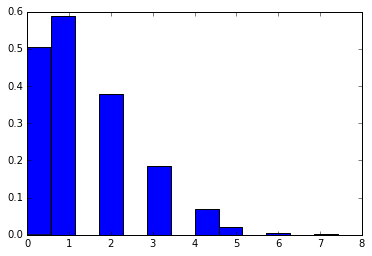

3
2
1
2
0
0
1
1
2
0
0
3
1
0
3
2
2
0
1
0
2
2
2
1
0
2
2
3
3
2
0
1
1
2
0
2
3
0
2
0
0
1
1
1
1
1
0
1
1
0
1
0
0
1
1
1
2
1
1
0
1
0
2
0
0
3
2
0
3
0
2
0
2
2
1
1
0
2
3
3
3
1
1
2
3
0
1
1
3
0
1
0
0
0
1
0
0
1
3
4
2
2
0
1
0
1
0
0
1
0
0
0
0
1
0
1
1
1
1
0
1
2
0
0
2
1
1
0
0
3
0
1
1
1
4
2
2
2
2
0
4
2
3
1
1
3
3
0
2
2
1
1
3
0
2
2
3
2
0
3
1
2
1
1
6
2
2
1
2
1
1
1
0
1
1
0
1
1
1
2
2
1
2
2
3
3
0
0
0
1
2
2
1
1
2
0
1
2
3
2
1
0
1
0
0
1
1
0
1
1
0
3
1
1
1
3
1
0
1
2
4
0
1
3
0
2
0
0
1
1
1
2
2
0
2
1
2
3
0
0
1
1
0
3
1
2
1
1
0
0
0
2
0
2
1
0
4
2
1
2
1
0
1
1
1
1
1
1
0
0
1
1
2
1
0
3
0
0
2
1
3
0
0
4
1
1
1
3
1
3
1
0
2
0
1
2
0
0
1
4
1
1
3
1
0
4
1
2
0
1
1
1
1
0
0
0
0
0
1
1
0
3
1
0
1
2
0
0
3
0
4
2
6
4
1
1
0
2
1
4
1
2
1
1
0
1
0
2
2
3
1
3
3
1
0
2
1
2
2
3
0
1
1
0
4
2
2
2
0
0
1
4
2
1
0
2
0
1
1
2
0
3
0
1
0
2
3
0
0
0
0
1
1
1
3
1
1
1
1
1
1
5
1
3
0
2
4
2
0
5
1
4
1
2
2
1
1
4
2
3
0
3
2
1
1
2
2
1
1
2
0
0
0
3
0
0
0
1
2
1
0
1
2
2
2
2
1
0
2
1
2
2
4
0
3
1
1
1
1
2
1
0
2
1
2
0
1
3
1
2
2
2
2
0
1
0
0
0
0
0
1
0
0
3
2
1
2
0
3
2
0
2
0
4
2
0
3
2
2
0


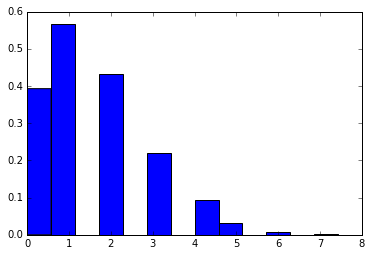

2
1
2
2
2
1
0
0
4
2
1
1
1
3
1
0
1
2
2
3
2
2
1
2
2
1
4
2
0
3
2
2
1
3
0
5
1
1
1
4
3
4
3
2
3
4
1
0
1
1
3
2
0
0
2
0
0
0
1
3
0
0
1
3
0
4
2
1
4
5
3
2
3
2
0
0
3
1
0
2
0
0
2
0
0
1
1
1
1
0
2
3
0
1
0
0
0
2
2
1
2
1
3
2
1
1
1
2
0
0
1
4
1
1
3
4
1
1
2
3
0
0
1
2
0
1
3
1
1
4
2
1
1
1
3
1
2
2
1
3
0
2
3
1
2
0
0
2
0
1
2
0
0
4
4
1
2
2
4
3
0
0
2
2
2
3
2
3
1
2
1
1
0
1
1
3
1
0
4
4
0
1
3
1
2
1
2
1
1
2
0
0
1
0
3
2
0
2
4
4
5
2
3
3
1
0
1
1
1
1
5
1
3
1
3
3
1
1
0
1
1
1
1
1
5
3
1
0
2
0
2
3
2
1
4
1
1
2
1
0
0
1
1
1
2
0
0
0
1
2
0
2
3
0
2
2
3
4
2
1
0
0
1
2
0
2
1
0
3
2
2
3
3
2
4
3
0
0
2
2
2
1
2
1
2
2
1
0
3
1
2
1
1
1
2
1
1
0
2
2
0
1
2
3
1
1
1
0
1
1
3
0
2
2
0
0
0
1
1
2
1
1
0
2
1
0
2
3
3
2
0
2
0
0
2
3
1
1
2
1
0
2
3
1
2
1
0
4
2
1
2
3
2
1
2
0
1
2
1
2
0
2
0
1
0
3
3
4
2
2
2
1
2
1
1
2
1
4
3
2
2
3
0
0
0
2
1
3
2
1
3
1
3
4
2
2
3
2
1
1
3
3
1
0
1
1
4
1
2
0
4
1
1
1
2
0
1
2
0
0
4
4
0
1
2
3
0
0
2
1
2
1
1
3
3
1
2
2
3
0
0
0
2
0
4
0
3
3
1
3
0
2
3
2
1
4
2
6
1
3
3
1
1
0
1
2
3
4
3
2
3
0
0
1
1
1
1
3
2
1
0
1
1
2
1
1
0
3
4
2
3
1
4
3
1
3
1
0
1
2


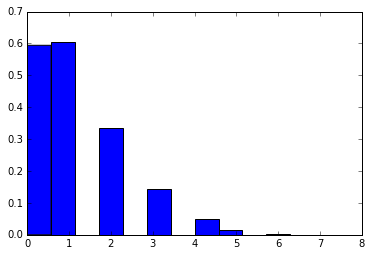

1
0
0
1
2
1
0
2
3
1
0
1
0
3
1
1
3
1
1
1
0
2
0
1
0
5
0
1
0
0
3
1
1
0
0
1
1
2
3
1
3
2
3
3
3
0
1
0
0
1
0
0
0
1
0
1
2
1
0
0
1
0
2
0
4
0
4
2
0
1
3
3
0
2
2
2
1
0
1
0
2
1
0
1
1
1
1
0
1
0
1
0
0
1
0
0
0
1
3
0
0
0
0
0
0
0
0
0
0
2
0
1
0
2
2
1
1
1
0
2
0
2
0
1
0
1
1
0
2
2
0
0
0
2
1
0
1
0
0
1
1
0
0
1
3
1
0
1
1
2
2
0
4
0
2
1
2
1
1
1
1
2
6
2
0
2
2
1
2
1
1
3
3
2
1
2
0
0
1
0
0
0
1
1
1
1
0
0
1
1
0
1
2
2
2
2
0
2
0
1
1
1
0
0
0
1
2
1
2
3
1
0
0
1
3
1
5
1
2
3
2
2
0
0
1
1
0
1
1
0
1
1
3
5
2
1
2
0
2
1
1
0
3
0
1
3
4
0
0
0
2
3
1
0
3
1
1
1
1
0
2
0
2
0
1
1
1
0
3
3
0
4
2
2
2
1
4
0
1
1
1
0
0
2
0
0
0
1
0
1
3
0
1
4
1
2
1
2
1
3
1
1
0
1
1
0
1
2
1
2
3
0
1
0
1
1
0
0
0
1
1
0
2
1
1
3
1
0
0
0
4
2
2
0
1
0
0
2
2
0
1
0
1
1
2
0
0
3
1
2
2
5
2
1
1
1
0
2
0
1
1
1
1
0
1
0
1
2
0
2
2
2
1
4
1
1
0
1
1
0
0
1
0
1
1
0
1
0
2
1
1
2
4
3
1
4
1
1
1
1
0
0
1
2
3
1
0
1
0
1
1
0
0
2
0
0
2
0
0
1
1
1
1
1
1
0
0
2
2
0
0
2
1
2
0
0
2
2
2
3
1
2
0
2
0
0
0
1
2
1
1
1
0
1
1
3
1
2
1
2
0
1
0
0
0
0
4
3
0
2
4
0
1
1
4
1
0
2
0
2
0
1
1
0
1
2
0
0
0
0
2
4
1
2
0
2
1
2
2
1


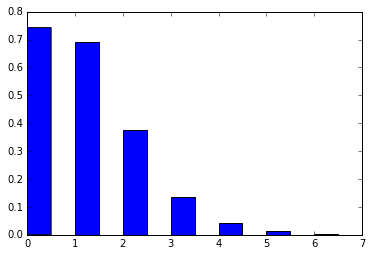

3
3
2
3
1
0
0
1
2
0
0
2
1
0
3
0
1
2
1
0
0
1
3
1
0
0
1
1
2
0
0
2
1
0
0
1
1
0
0
0
0
2
2
0
3
1
2
0
1
0
0
2
1
3
1
1
1
3
2
1
2
1
2
0
1
1
0
3
2
2
0
1
1
0
0
2
0
0
2
0
0
2
0
0
0
0
0
1
0
0
1
1
0
1
0
0
0
2
1
1
3
0
0
0
0
0
0
0
0
0
0
2
0
0
1
1
1
1
3
1
1
3
1
0
0
0
0
1
0
0
2
0
1
0
1
2
1
2
0
1
0
2
0
1
1
0
0
2
1
2
0
0
1
0
2
2
3
3
1
1
1
3
0
1
3
1
2
1
1
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
1
0
1
3
0
1
1
0
2
2
1
3
1
0
0
0
2
2
0
2
0
1
1
0
1
1
2
1
4
0
1
3
2
2
0
1
2
1
1
0
1
0
0
1
2
1
0
1
0
1
0
1
4
1
0
2
1
0
4
2
2
3
1
0
0
2
3
0
1
1
3
2
0
1
1
1
1
1
2
3
0
1
4
2
1
0
3
1
1
1
1
0
1
2
0
0
2
1
0
0
0
1
2
0
1
1
0
1
1
0
0
0
1
1
0
2
0
0
1
0
1
0
0
1
2
1
0
1
1
0
3
0
0
1
4
1
2
0
2
2
1
0
2
1
0
1
2
2
1
1
1
4
2
1
4
2
0
1
0
0
0
0
0
1
0
0
1
2
2
1
0
1
2
1
3
0
0
0
1
1
0
1
0
0
3
1
4
0
0
1
1
0
2
2
1
0
3
0
0
2
2
1
1
1
0
0
0
0
2
1
1
0
1
1
1
1
1
1
0
0
0
0
2
3
0
0
1
2
0
1
0
1
0
3
0
3
1
1
0
2
1
0
1
2
2
1
0
2
2
0
2
1
2
2
1
1
2
1
1
0
1
2
1
2
4
3
1
2
1
1
2
0
0
1
0
0
0
0
3
3
0
3
2
4
1
4
0
2
3
0
1
2
0
1
0
1
4
1
1
0
1
1
0
1
1
1
2
0
0
0
1
0
2


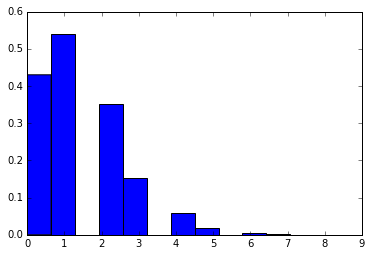

1
1
2
2
0
0
0
2
0
0
1
1
2
3
1
3
1
0
2
0
1
1
4
3
3
0
1
0
6
0
0
1
0
0
2
1
1
2
1
2
1
1
1
2
3
1
4
3
2
1
3
3
3
0
1
2
0
1
1
2
1
0
3
1
1
1
2
3
0
5
1
4
2
4
2
2
0
1
0
1
1
2
1
3
2
1
4
0
2
0
1
1
1
0
1
1
0
2
3
1
3
1
0
0
0
1
2
0
0
2
1
0
2
1
0
1
1
3
1
3
0
1
2
2
0
1
4
0
1
1
1
1
0
2
1
1
1
4
0
4
4
0
1
1
4
3
1
0
4
1
2
1
1
0
3
4
1
0
3
0
1
2
1
3
0
1
1
0
2
2
1
4
0
1
2
1
3
3
0
0
2
0
2
1
0
0
1
0
0
0
4
5
2
1
1
1
1
1
1
3
0
0
2
1
2
0
1
1
1
2
1
1
2
3
1
3
1
3
1
0
2
1
0
1
2
1
1
1
2
2
0
3
1
0
0
4
3
3
1
1
1
1
0
1
0
1
1
1
2
1
1
2
1
3
0
5
0
1
5
2
1
1
3
2
1
1
1
3
0
1
0
2
1
0
4
2
1
0
0
1
0
1
1
4
0
3
2
0
0
2
0
1
0
3
1
0
1
2
1
0
2
0
1
2
1
1
1
3
1
0
1
2
0
2
0
0
0
1
0
0
1
1
0
1
1
1
0
0
1
1
3
2
0
2
3
1
1
3
1
0
0
1
0
2
5
1
2
0
0
0
3
3
3
1
1
1
2
3
2
2
3
0
1
1
0
1
2
2
0
1
4
2
1
0
1
1
2
1
1
2
1
0
1
2
1
1
4
1
0
3
3
2
3
0
1
0
2
2
1
0
0
3
2
2
1
2
0
1
2
0
1
1
1
2
0
2
1
2
0
0
1
1
3
2
2
0
3
2
2
2
2
1
1
4
6
2
1
0
1
0
0
0
1
0
0
2
5
4
2
5
2
3
1
0
2
3
0
1
2
0
0
2
1
2
1
3
1
1
1
1
1
2
0
2
2
1
2
0
2
3
1
3
1
2
1
1
1
0
0
5
2
1
0
1
3
1
1
1
4
1


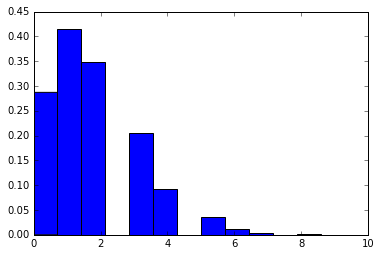

1
2
1
0
2
0
1
1
4
0
1
3
2
5
0
1
0
1
1
1
1
1
3
1
4
0
3
4
0
1
4
2
3
1
1
4
2
1
0
1
3
4
2
2
6
4
4
4
2
1
0
3
0
0
0
0
0
2
3
0
0
1
3
1
2
1
10
4
3
0
1
1
2
3
4
2
3
0
2
0
1
3
0
1
0
1
0
0
2
1
1
3
2
3
1
2
0
3
0
3
1
1
2
0
1
2
0
2
1
0
0
0
0
0
1
0
1
1
1
0
4
5
2
1
1
1
4
1
3
5
2
1
1
1
0
1
0
4
3
1
1
1
5
0
3
3
1
3
4
0
1
1
0
2
0
1
1
2
0
4
1
3
1
3
0
1
2
0
2
0
3
1
2
1
1
0
0
0
0
2
1
3
0
1
2
0
3
1
1
0
0
4
1
0
1
2
1
2
1
0
0
0
4
0
0
2
4
2
4
2
2
5
0
2
2
1
0
1
0
0
2
2
2
1
2
0
0
2
2
1
0
0
2
2
3
1
1
1
2
3
2
3
1
4
4
2
2
1
1
3
1
4
3
2
2
1
3
2
4
0
2
2
1
2
1
0
2
2
2
1
2
1
3
0
0
2
1
4
1
3
1
0
0
3
0
4
0
3
3
3
0
0
1
1
0
3
0
0
0
0
0
0
3
1
0
1
0
1
1
3
1
0
1
0
2
2
3
1
2
3
1
0
1
1
4
1
0
1
5
0
2
3
4
0
7
4
0
4
4
2
5
2
4
2
4
0
0
1
1
4
1
0
4
0
2
0
1
0
3
1
1
0
0
2
1
1
0
0
3
3
2
3
4
2
4
0
4
0
1
1
2
0
1
1
1
0
2
1
1
3
2
3
1
1
1
0
4
5
2
2
1
2
4
4
4
2
2
1
1
3
0
3
2
2
1
3
1
2
5
1
1
2
2
1
3
2
0
2
2
1
3
5
4
1
0
0
4
1
1
1
1
1
0
2
2
1
2
4
1
4
1
3
2
1
1
2
3
4
4
1
3
1
2
3
3
1
2
1
0
2
1
2
1
0
2
2
1
2
0
5
1
0
2
0
0
2
1
3
1
2
2
0
0
2
2
0
3
0
2
2

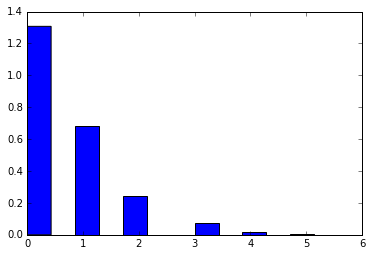

1
0
0
0
1
1
0
2
0
0
2
3
1
2
0
1
2
0
0
0
0
0
2
0
1
3
3
3
0
1
1
0
2
0
1
2
0
1
1
0
1
1
0
1
1
0
0
0
1
0
0
0
1
2
0
1
2
0
0
0
1
0
0
2
2
2
1
2
1
0
4
1
1
2
0
0
2
0
0
2
1
0
0
0
0
0
0
1
0
1
1
0
1
2
0
0
0
3
0
1
2
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
2
0
1
2
0
3
0
1
0
3
1
0
0
0
0
1
0
0
1
1
3
1
1
1
0
0
1
1
1
1
2
0
0
0
0
0
0
2
2
1
1
1
0
0
1
2
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
2
0
1
1
0
0
0
1
1
1
0
0
0
1
0
0
0
0
0
0
0
0
1
1
2
0
1
0
1
1
0
1
1
0
0
0
1
0
1
0
0
0
1
2
0
1
1
0
1
0
1
3
0
1
2
0
1
3
1
0
0
1
0
1
0
0
2
1
0
2
1
1
1
0
2
0
0
0
1
2
1
0
0
0
0
3
0
0
0
0
0
2
0
0
1
2
2
0
0
1
1
1
0
0
0
1
2
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
2
0
0
0
0
0
0
0
2
2
1
0
1
3
1
0
0
0
1
1
0
0
1
1
3
2
1
1
3
0
0
0
1
1
0
1
1
0
0
3
1
1
2
0
0
1
0
0
2
1
0
0
0
1
0
1
0
0
1
3
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
2
1
1
1
1
1
1
0
3
0
1
1
3
0
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
1
2
0
0
0
1
1
1
2
0
1
0
1
0
4
0
0
1
0
3
1
2
2
1
6
1
4
2
1
0
0
0
0
2
0
0
0
1
1
0
1
0
0
1
0
1
0
0
1
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
1
2


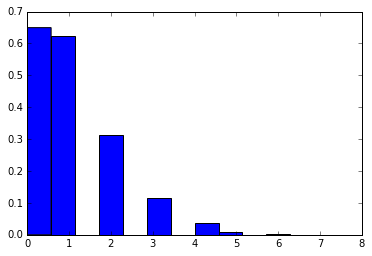

0
0
1
0
1
1
1
0
1
1
1
0
2
0
0
0
0
2
1
0
1
0
1
1
2
1
0
4
1
0
0
0
0
1
0
2
0
2
0
1
1
1
2
3
2
0
0
1
3
1
0
0
1
1
1
1
1
0
1
1
0
0
1
1
1
1
2
2
2
0
0
0
2
1
0
2
1
1
1
0
2
2
0
0
0
1
1
0
0
2
1
0
1
1
0
0
0
1
0
0
3
0
0
1
2
0
0
2
1
0
0
1
1
0
0
1
1
1
1
2
0
0
2
2
0
0
1
0
2
1
1
0
1
1
0
2
0
0
2
2
4
2
2
1
0
0
2
0
0
1
1
3
3
1
2
4
2
1
1
1
1
0
0
2
3
0
1
0
1
1
1
0
1
0
1
1
1
1
0
0
0
0
1
3
0
1
0
0
2
0
2
1
0
1
1
1
2
0
2
3
0
2
0
0
2
0
0
2
0
0
0
1
1
0
0
0
1
1
1
1
2
0
0
1
0
2
5
1
0
1
0
3
0
1
1
0
1
0
3
0
1
2
1
0
3
0
1
0
1
0
3
1
1
0
0
1
0
0
3
3
2
2
0
1
0
1
1
1
0
2
3
1
0
2
3
3
0
0
2
0
0
1
2
1
1
0
2
3
1
1
0
1
2
1
0
1
0
0
3
1
2
2
0
0
0
1
1
0
0
2
1
0
0
0
0
0
2
1
1
0
1
0
0
0
1
2
3
1
1
1
1
3
2
3
0
1
1
2
1
1
0
1
0
0
1
1
0
2
1
3
1
0
0
0
1
2
0
1
2
0
1
1
0
0
1
0
0
3
0
1
2
2
0
4
0
1
0
1
1
1
2
0
1
0
1
0
2
0
1
0
0
1
1
2
1
4
0
0
1
3
0
1
2
3
2
2
1
2
1
0
0
1
1
1
1
1
0
0
0
3
0
1
1
0
2
0
0
1
1
0
2
1
1
4
1
0
0
0
1
0
0
0
0
0
1
0
1
1
2
5
1
2
0
1
1
2
2
0
0
1
0
0
0
2
0
2
0
0
0
0
2
0
0
0
1
2
3
0
1
0
0
2
2
0
2
1
0
2
1
3
0
2
1
1
1
1
0
0
1
0


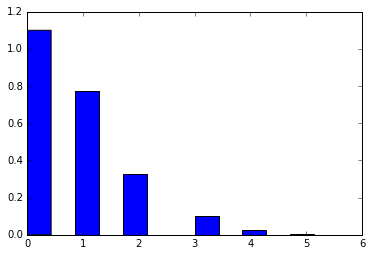

1
0
0
0
0
1
0
1
0
0
2
0
2
0
1
0
1
3
0
1
2
1
1
0
0
0
0
0
2
2
2
2
4
1
3
0
0
2
1
1
1
0
2
0
2
2
3
1
0
0
0
0
0
0
0
1
0
0
2
1
0
3
2
2
1
2
3
3
2
0
1
3
0
0
1
2
2
0
1
0
1
1
1
1
4
1
0
1
1
0
0
1
0
1
0
0
0
2
0
2
4
0
0
1
0
0
1
2
1
0
0
0
0
0
0
0
0
2
0
1
1
0
1
1
0
0
1
0
1
0
1
2
0
1
2
1
1
2
0
1
1
0
0
0
1
0
0
1
1
0
1
1
0
0
1
2
1
0
1
0
2
0
0
0
1
1
1
0
0
0
0
1
1
1
1
1
2
2
0
1
0
1
1
0
1
1
2
1
1
2
3
5
2
1
1
0
0
1
0
1
1
0
1
1
1
1
0
0
1
1
1
0
0
0
1
1
2
0
1
2
0
0
1
2
0
0
1
0
1
2
1
0
1
1
2
2
0
0
1
0
1
0
2
0
2
1
0
0
0
0
0
1
1
0
1
2
3
0
1
1
0
0
1
0
0
1
0
1
0
0
0
0
1
0
2
0
0
0
1
2
2
2
0
0
0
1
0
0
0
1
1
0
0
1
2
0
0
0
0
2
2
3
1
0
1
3
0
1
0
0
1
0
0
0
0
2
1
0
0
0
1
1
0
0
2
1
2
2
2
1
1
2
0
2
1
0
1
1
2
1
3
0
0
1
1
1
2
2
0
0
0
0
1
1
0
0
0
0
0
2
1
2
1
0
1
0
2
2
1
2
1
3
1
1
2
0
2
1
1
1
1
0
0
0
1
1
1
1
0
1
2
1
3
3
2
0
0
1
0
2
1
1
2
2
0
0
1
1
0
0
3
0
2
1
2
0
1
0
1
1
0
1
4
1
1
0
0
0
0
1
0
2
0
2
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
1
2
2
2
1
0
1
1
2
0
2
1
1
1
1
0
0
2
0
0
0
5
1
0
0
0
1
0
1
0
1
0
0
0
1
2
1
1
0
1
2
1
1
0
0
2
1


In [53]:
# sampling most probable results according to the model
#print_sample_results(most_probable=False)

# Sample results from a sample of the trace
nb_p, p, _ = print_sample_results(most_probable=True)

In [29]:
print "train data accuracy", float(p)/nb_p

train data accuracy 0.483660130719


In [202]:
# mean of offence strength
for i in top_club_ids: 
    print clubs[clubs.index==i]["Name"][i].decode('latin'), " ", mcmc.trace("offence%i"%i)[:].mean()

FC Bayern München   2.61818150136
VfL Wolfsburg   1.63611296027
Borussia Mönchengladbach   2.1095063413
Bayer Leverkusen   1.40589589347
FC Augsburg   1.36827055915
FC Schalke 04   1.49916833923
Borussia Dortmund   2.60840429884
1899 Hoffenheim   1.26463045598
Eintracht Frankfurt   1.28234855287
SV Werder Bremen   1.09433465798
1. FSV Mainz 05   1.37990683973
1. FC Köln   1.17095953996
Hannover 96   1.24353580345
VfB Stuttgart   1.4480128787
Hertha BSC   1.54378406301
Hamburger SV   1.10184125531
FC Ingolstadt 04   0.750762673346
SV Darmstadt 98   1.08287186619


In [31]:
# mean of defence strength
for i in top_club_ids: 
    print clubs[clubs.index==i]["Name"][i].decode('latin'), " ", mcmc.trace("defence%i"%i)[:].mean()

FC Bayern München   0.883859084127
VfL Wolfsburg   0.242786941228
Borussia Mönchengladbach   -0.38982217495
Bayer Leverkusen   0.263800119768
FC Augsburg   -0.0772410169326
FC Schalke 04   0.0739589058
Borussia Dortmund   -0.033614413101
1899 Hoffenheim   -0.0744761116696
Eintracht Frankfurt   -0.228427581449
SV Werder Bremen   -0.464399317865
1. FSV Mainz 05   -0.0284024999083
1. FC Köln   0.0742546929854
Hannover 96   -0.193564058967
VfB Stuttgart   -0.626649482769
Hertha BSC   0.460728041656
Hamburger SV   0.0757236777526
FC Ingolstadt 04   0.297294154872
SV Darmstadt 98   -0.161001658761


#### Sampling histograms

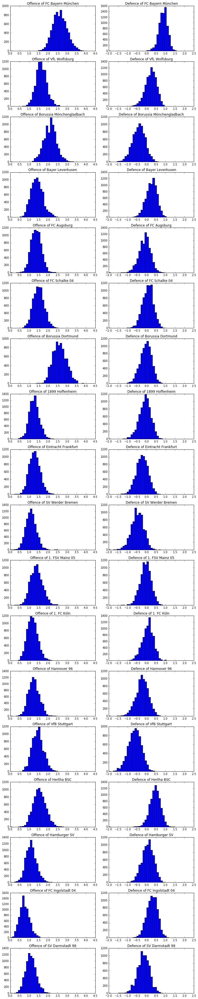

In [201]:
nb_clubs = top_club_ids.max() + 1
bins=40
fig, axes = plt.subplots(nrows=nb_clubs, ncols=2, figsize=(10, 50))

for i in top_club_ids: 
    title = "Offence of " + clubs[clubs.index==i]["Name"][i].decode('latin')
    axes[i, 0].set_title(title)
    axes[i, 0].hist(mcmc.trace("offence%i"%i)[:], bins=bins, range=(0,4.2))
    
    axes[i, 1].hist(mcmc.trace("defence%i"%i)[:], bins=bins, range=(-2.,2.2))
    title = "Defence of " + clubs[clubs.index==i]["Name"][i].decode('latin')
    axes[i, 1].set_title(title)

#fig.suptitle("Offence and defence distribution of the clubs.")
fig.subplots_adjust(hspace=0.5)
fig.tight_layout()

In [31]:
#toto_results_

In [80]:
def get_diffs(team_1, team_2):
    #TODO implement
    return d1, d2
    


In [97]:
d1, d2 = get_diffs(1, 4)
np.histogram?

In [154]:
def get_goal_distribution(diff):
    # TODO implement
    return goal_diff


1e-10

In [163]:
def plot_goal_diffs(team_1, team_2):
    
    bins=40
    (d1, d2) = get_diffs(team_1, team_2)
    
    goals_1 = get_goal_distribution(d1)
    goals_2 = get_goal_distribution(d2)
    
    plt.figure(figsize=(10, 5))
    ax = plt.subplot(121)
    title = "Goals of " + clubs[clubs.index==team_1]["Name"][team_1].decode('latin')
    ax.set_title(title)
    _ = ax.plot(np.arange(0,20), goals_1, "b*")
    ax.set_xlim(-0.5, 8.5)
    
    ax = plt.subplot(122)
    title = "Goals of " + clubs[clubs.index==team_2]["Name"][team_2].decode('latin')
    ax.set_title(title)
    _ = ax.plot(np.arange(0,20), goals_2, "k*")
    ax.set_xlim(-0.5, 8.5)

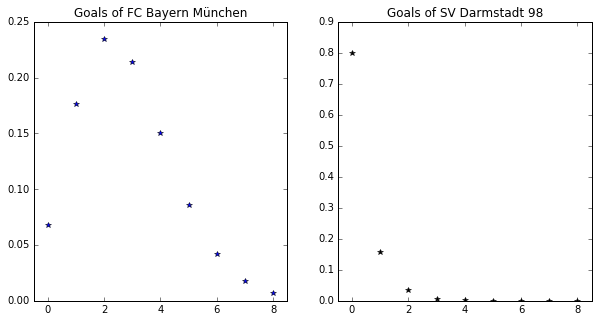

In [205]:
plot_goal_diffs(0, 17)

#### Exercise

To investigate the model sample from the model without using observed data. Adapt the prior to get senseful results.

#### Exercice: Extension of the model

Extend the model e.g. with
- home advantage
- take win/loose/draw into account
